In [1]:
rm(list=ls())
gc()
setwd("/hpc/group/pbenfeylab/CheWei/")

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,625275,33.4,1361470,72.8,1209572,64.6
Vcells,1159072,8.9,8388608,64.0,1802279,13.8


In [2]:
as.numeric(system("awk '/MemFree/ {print $2}' /proc/meminfo", intern=TRUE))

[1] 196300512

In [3]:
suppressMessages(library(Seurat))
suppressMessages(library(tricycle))
suppressMessages(library(cowplot))
suppressMessages(library(ggplot2))
suppressMessages(library(scattermore))
suppressMessages(library(scater))
suppressMessages(library(cowplot))
suppressMessages(library(RColorBrewer))
suppressMessages(library(grid))
suppressMessages(library(gplots))
suppressMessages(library(tidyverse))

prep <- function(seu){
seu$time.anno.Li.crude <- gsub("_.*$","",seu$time.celltype.anno.Li.crude)
seu$celltype.anno.Li.crude <- gsub("Distal Columella","Distal Columella_Columella",seu$time.celltype.anno.Li.crude)
seu$celltype.anno.Li.crude <- gsub("Distal Lateral Root Cap","Distal Lateral Root Cap_Lateral Root Cap",seu$celltype.anno.Li.crude)
seu$celltype.anno.Li.crude <- gsub("Proximal Columella","Proximal Columella_Columella",seu$celltype.anno.Li.crude)
seu$celltype.anno.Li.crude <- gsub("Proximal Lateral Root Cap","Proximal Lateral Root Cap_Lateral Root Cap",seu$celltype.anno.Li.crude)
seu$celltype.anno.Li.crude <- gsub("^.*_","",seu$celltype.anno.Li.crude)
    return(seu)
}
plot_anno <- function(rc.integrated){
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem","Protophloem", "Xylem", "Procambium","Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno.Li.crude <- factor(rc.integrated$celltype.anno.Li.crude, levels = order[sort(match(unique(rc.integrated$celltype.anno.Li.crude),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno.Li.crude),order))]
p1 <- DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno.Li.crude", cols=color)
p2 <- DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno.Li.crude", order = c("Distal Columella","Proximal Columella","Distal Lateral Root Cap","Proximal Lateral Root Cap","Maturation","Elongation", "Transition Domain", "Proliferation Domain"),
        cols = c('#F7E7B0','#FFC400','#2B871F','#005E3B',"#deebf7", "#3182bd", '#fee0d2','#de2d26'))
p3 <- DimPlot(rc.integrated, reduction = "umap", group.by = "consensus.time.group", cols=brewer.pal(10,"Spectral"))
p4 <- DimPlot(rc.integrated, reduction = "umap", group.by = "branch.anno")
options(repr.plot.width=16, repr.plot.height=12)
gl <- lapply(list(p1, p2, p3, p4), ggplotGrob)
gwidth <- do.call(unit.pmax, lapply(gl, "[[", "widths"))
gl <- lapply(gl, "[[<-", "widths", value = gwidth)
gridExtra::grid.arrange(grobs=gl, ncol=2)
}

In [4]:
sessionInfo()

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: AlmaLinux 9.3 (Shamrock Pampas Cat)

Matrix products: default
BLAS/LAPACK: /hpc/group/pbenfeylab/ch416/miniconda3/envs/seu4/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] forcats_0.5.2               stringr_1.5.1              
 [3] dplyr_1.1.3                 purrr_1.0.2                
 [5] readr_2.1.3                 tidyr_1.3.0                
 [7] tibble_3.2.1                tidyverse_1.3.2            
 [9] g

In [5]:
cc.genes.goldy <- read.csv("./tricycle/Goldy_2021_CycB1-1-sorted_Enriched_Depleted_G2M_rm-proto-genes.csv")
cc.genes.zhang <- read.csv("./tricycle/Zhang_2021_Dev_cell_Core_cell_cycle_genes.csv")
cc.genes.amigo.go <- as.character(read.table("./tricycle/GO_cell_cycle_annotation_arabidopsis.txt", header=F)$V1)
cc.genes.f <- unique(c(cc.genes.zhang$Gene, cc.genes.goldy$gene, cc.genes.amigo.go))
length(cc.genes.f)
pp.genes <- as.character(read.table("./CW_data/escoring/Root_sc/Protoplasting_DEgene_FC2_list.txt", header=F)$V1)

[1] 3241

In [6]:
table(cc.genes.zhang$Phase)


G1/G0    G2     M     S 
   18    95    77    53 

In [7]:
head(cc.genes.zhang)

,Gene,Phase,Symbol,Araport11,Function
,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT1G12845,G1/G0,NA,transmembrane protein;(source:Araport11),NA
2,AT3G26960,G1/G0,NA,Pollen Ole e 1 allergen and extensin family protein;(source:Araport11),NA
3,AT5G02260,G1/G0,ATEXP9,expansin A9;(source:Araport11),"member of Alpha-Expansin Gene Family. Naming convention from the Expansin Working Group (Kende et al, 2004. Plant Mol Bio)"
4,AT1G33930,G1/G0,NA,P-loop containing nucleoside triphosphate hydrolases superfamily protein;(source:Araport11),NA
5,AT5G01445,G1/G0,NA,hypothetical protein;(source:Araport11),NA
6,AT5G67260,G1/G0,CYCD3;2,CYCLIN D3;(source:Araport11),"Encode CYCD3;2, a CYCD3 D-type cyclin. Important for determining cell number in developing lateral organs. Mediating cytokinin effects in apical growth and development."


In [8]:
## Cell Cyle genes used
cc.gene.list <- as.list(cc.genes.f)

## Load reference

In [9]:
rc.integrated <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_18S_WT_cell_cycle_seu4_245genes_Goldy_Zhang_AMIGO_20230825.rds")

In [10]:
rownames(rc.integrated)

[1] "AT1G02730" "AT5G56120" "AT5G13840" "AT1G63100" "AT1G03780" "AT5G15510"
  [7] "AT1G16630" "AT3G51230" "AT4G35620" "AT4G02800" "AT4G05190" "AT3G55660"
 [13] "AT3G11520" "AT1G20610" "AT1G18370" "AT1G76310" "AT4G14330" "AT5G48310"
 [19] "AT5G55520" "AT4G01730" "AT1G44110" "AT5G45700" "AT4G38062" "AT3G56100"
 [25] "AT4G26660" "AT5G60930" "AT4G09060" "AT4G37490" "AT5G51600" "AT3G23670"
 [31] "AT3G44050" "AT1G11220" "AT2G22610" "AT1G04425" "AT4G11080" "AT4G17000"
 [37] "AT3G19050" "AT1G53140" "AT3G15550" "AT1G72670" "AT1G34355" "AT1G05440"
 [43] "AT2G44190" "AT3G54710" "AT5G67270" "AT4G21270" "AT1G72250" "AT3G58650"
 [49] "AT1G61450" "AT1G23790" "AT5G55830" "AT5G44040" "AT1G59540" "AT5G09500"
 [55] "AT5G43080" "AT4G18570" "AT5G23910" "AT3G57540" "AT1G69770" "AT4G28430"
 [61] "AT5G47500" "AT1G75640" "AT1G76740" "AT4G30860" "AT3G06840" "AT2G36200"
 [67] "AT3G25100" "AT1G33670" "AT4G05520" "AT5G60150" "AT4G21070" "AT3G26050"
 [73] "AT5G52220" "AT2G44580" "AT2G47920" "AT5G46740" "AT3G27640" "AT4G14150"
 [79] "AT3G12170" "AT5G42700" "AT3G48490" "AT3G24495" "AT1G06310" "AT5G01420"
 [85] "AT1G10780" "AT3G52115" "AT2G37420" "AT1G10400" "AT1G80190" "AT4G00020"
 [91] "AT2G38620" "AT1G77630" "AT4G21820" "AT1G29418" "AT5G55820" "AT2G42260"
 [97] "AT3G23740" "AT5G11780" "AT1G26330" "AT2G32590" "AT3G54750" "AT4G39590"
[103] "AT4G17240" "AT1G50240" "AT5G59240" "AT3G59550" "AT5G11510" "AT3G05740"
[109] "AT1G07270" "AT3G55340" "AT1G20720" "AT1G75150" "AT3G61150" "AT3G58100"
[115] "AT2G20980" "AT4G39630" "AT3G18680" "AT5G62170" "AT3G09080" "AT1G63650"
[121] "AT2G02680" "AT4G22970" "AT5G20850" "AT3G48160" "AT3G18730" "AT5G14660"
[127] "AT5G25380" "AT2G29680" "AT2G42290" "AT5G56220" "AT3G63480" "AT5G07810"
[133] "AT5G18570" "AT5G62410" "AT1G77550" "AT2G24970" "AT5G40840" "AT4G13370"
[139] "AT1G09700" "AT1G72480" "AT1G53542" "AT4G02150" "AT3G61610" "AT3G59430"
[145] "AT2G04530" "AT5G52170" "AT3G62110" "AT5G05900" "AT2G40570" "AT4G34960"
[151] "AT1G19520" "AT2G34450" "AT2G45590" "AT1G30960" "AT1G54960" "AT1G72820"
[157] "AT1G05520" "AT5G37630" "AT1G11125" "AT2G37560" "AT3G03810" "AT3G24430"
[163] "AT3G19720" "AT4G23510" "AT1G12800" "AT4G12540" "AT5G13830" "AT4G12740"
[169] "AT4G16700" "AT5G47400" "AT3G13150" "AT5G63920" "AT5G66770" "AT3G09410"
[175] "AT1G71060" "AT4G38230" "AT5G01470" "AT2G42190" "AT5G51560" "AT4G14980"
[181] "AT4G29170" "AT1G20410" "AT4G31400" "AT3G46020" "AT1G10300" "AT2G17670"
[187] "AT5G35520" "AT1G71760" "AT1G73180" "AT3G13060" "AT5G59740" "AT4G34360"
[193] "AT2G20810" "AT1G49910" "AT1G04710" "AT1G75140" "AT1G04130" "AT4G12620"
[199] "AT2G21800" "AT4G01810" "AT2G04660" "AT5G60840" "AT1G79740" "AT5G38880"
[205] "AT1G61000" "AT4G15890" "AT3G62620" "AT2G46380" "AT5G12440" "AT4G19710"
[211] "AT5G06590" "AT3G60740" "AT5G22340" "AT5G63120" "AT4G24175" "AT3G07630"
[217] "AT4G28020" "AT1G21150" "AT1G47230" "AT5G02820" "AT4G17430" "AT4G19130"
[223] "AT5G63690" "AT3G20780" "AT1G27060" "AT2G04940" "AT1G62150" "AT3G19570"
[229] "AT3G58580" "AT5G09380" "AT1G09280" "AT1G67780" "AT2G33610" "AT4G19185"
[235] "AT5G46850" "AT5G12360" "AT2G03670" "AT5G03415" "AT5G06180" "AT4G04190"
[241] "AT5G45760" "AT2G37680" "AT4G15850" "AT4G26720" "AT1G07020"

In [11]:
length(rownames(rc.integrated))

[1] 245

In [12]:
write.csv(data.frame("GeneID"=rownames(rc.integrated)),"./tradeseq/245_cell_cycle_related_genes_for_reference.csv")

In [10]:
## Prepare New Ref (All cells)
corrected.m <- rc.integrated@assays$integrated@data

In [12]:
# run PCA on the batch effects corrected matrix and get the rotaions scores for the top 2 PCs
pca.m <- scater::calculatePCA(corrected.m, ntop = 500)

In [13]:
new.ref <- attr(pca.m, 'rotation')[, seq_len(2)]

In [15]:
saveRDS(new.ref, "./tradeseq/Tricycle_Reference_Arabidopsis_Root.rds")

In [14]:
unique(rc.integrated$orig.ident)

[1] "dc1"      "dc2"      "sc_10_at" "sc_11"    "sc_12"    "tnw1"    
 [7] "sc_20"    "sc_71"    "sc_157"   "sc_158"   "sc_159"   "sc_169"  
[13] "sc_170"   "sc_171"   "sc_215"   "sc_221"   "sc_229"   "sc_235"

In [13]:
#suppressMessages(rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:8))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



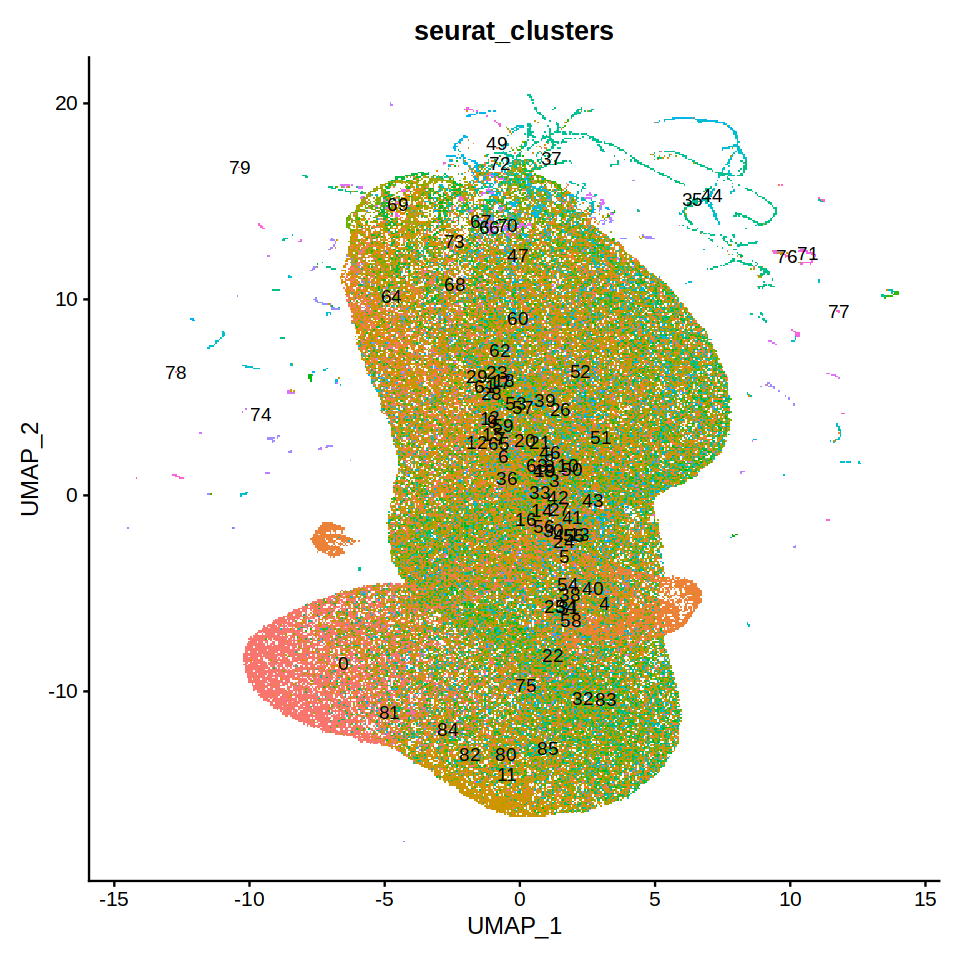

In [14]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "seurat_clusters", label = TRUE)+theme(legend.position="none")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



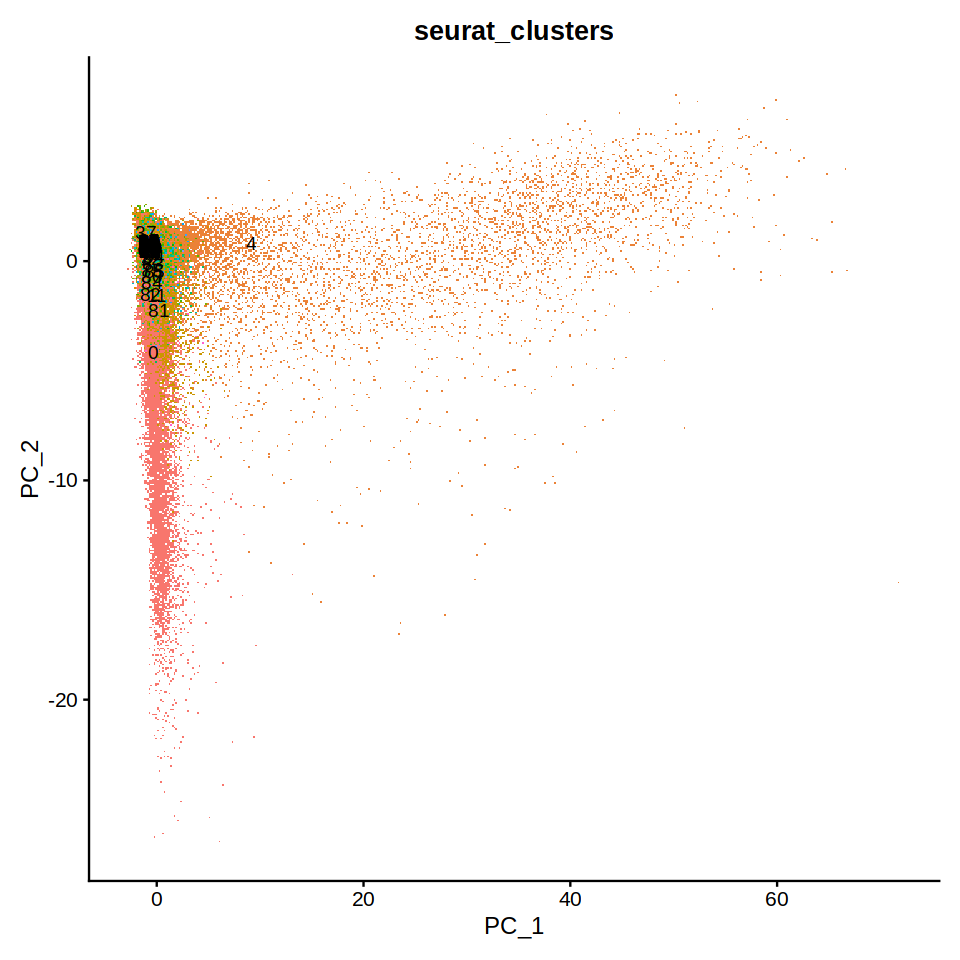

In [15]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "pca", group.by = "seurat_clusters", label = TRUE)+theme(legend.position="none")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



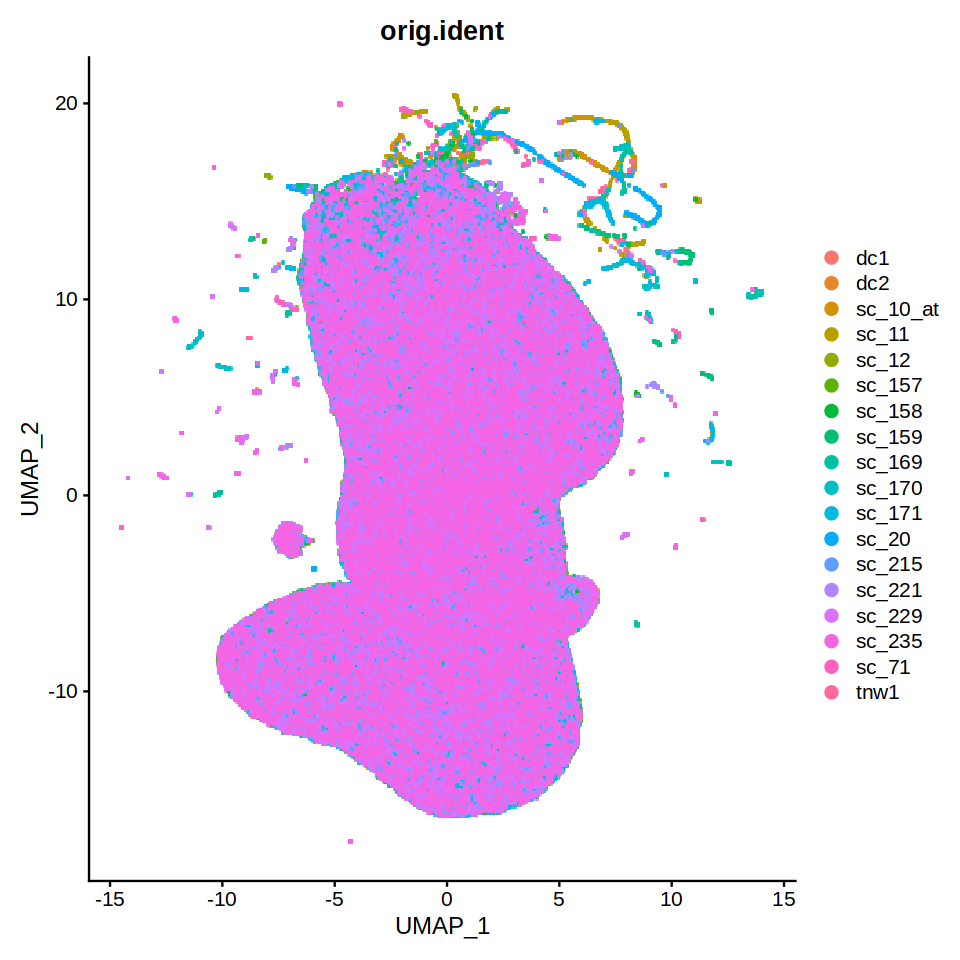

In [16]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "orig.ident", label = FALSE, pt.size=1, order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



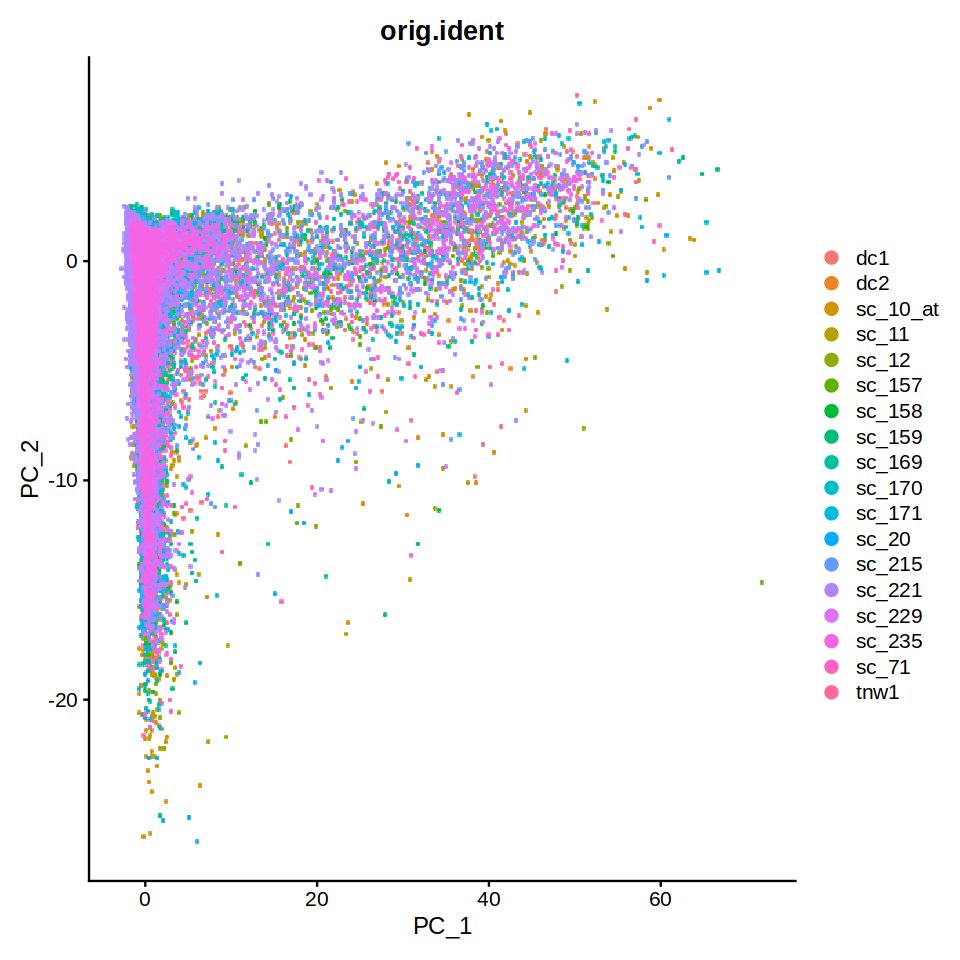

In [17]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "pca", group.by = "orig.ident", label = FALSE, pt.size=1, order=FALSE)

In [18]:
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem","Protophloem", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno.Li <- factor(rc.integrated$celltype.anno.Li, levels = order[sort(match(unique(rc.integrated$celltype.anno.Li),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno.Li),order))]

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



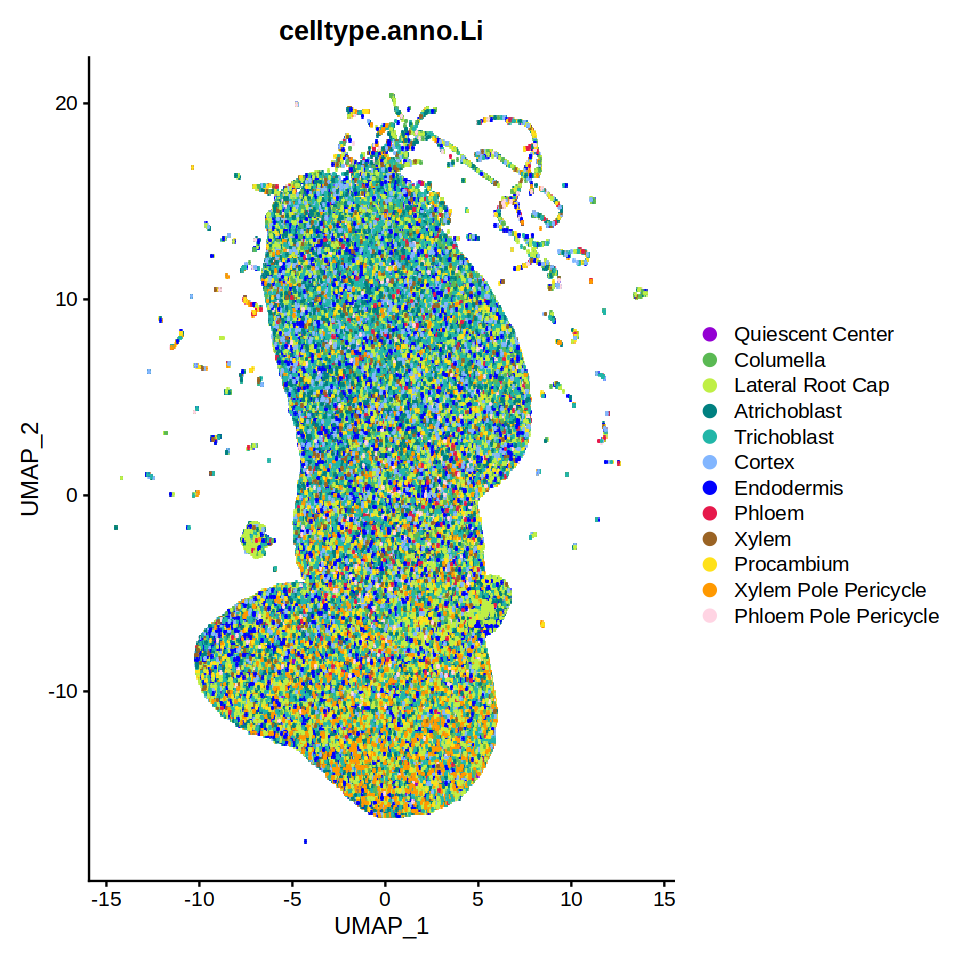

In [19]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno.Li", label = FALSE, cols=color, pt.size=1, order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



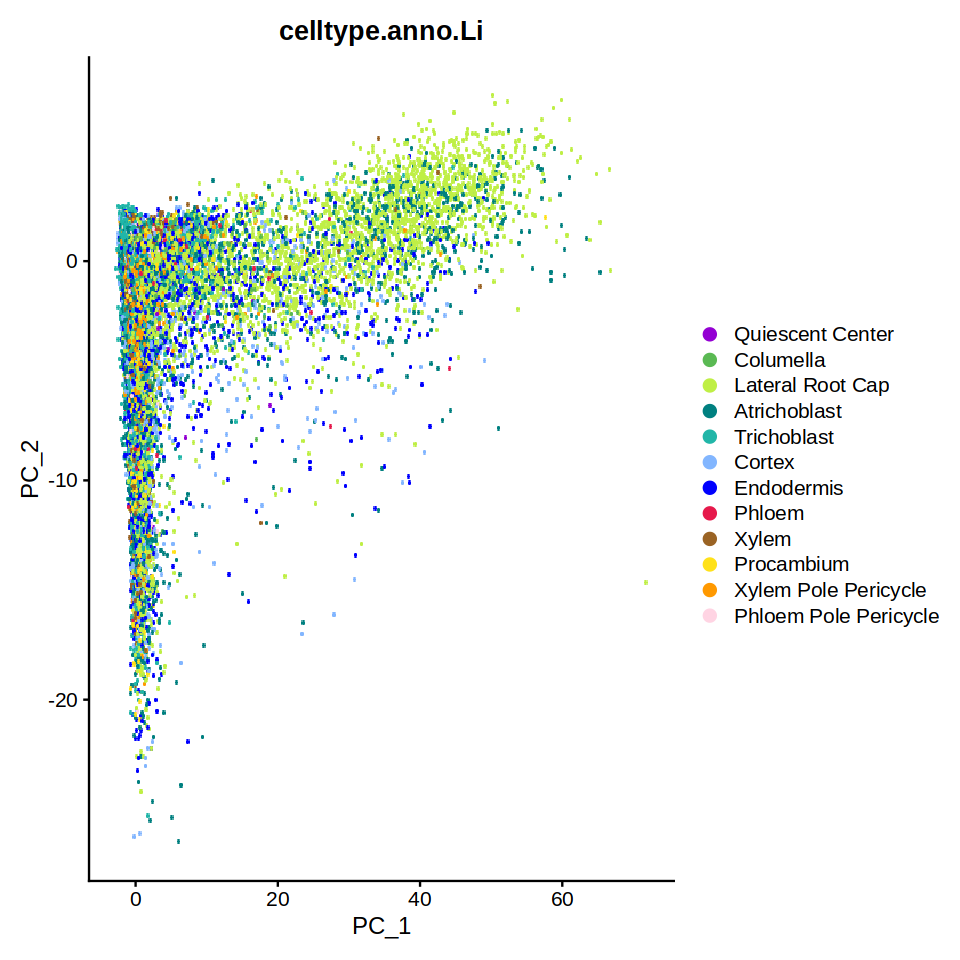

In [20]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "pca", group.by = "celltype.anno.Li", label = FALSE, cols=color, pt.size=1, order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



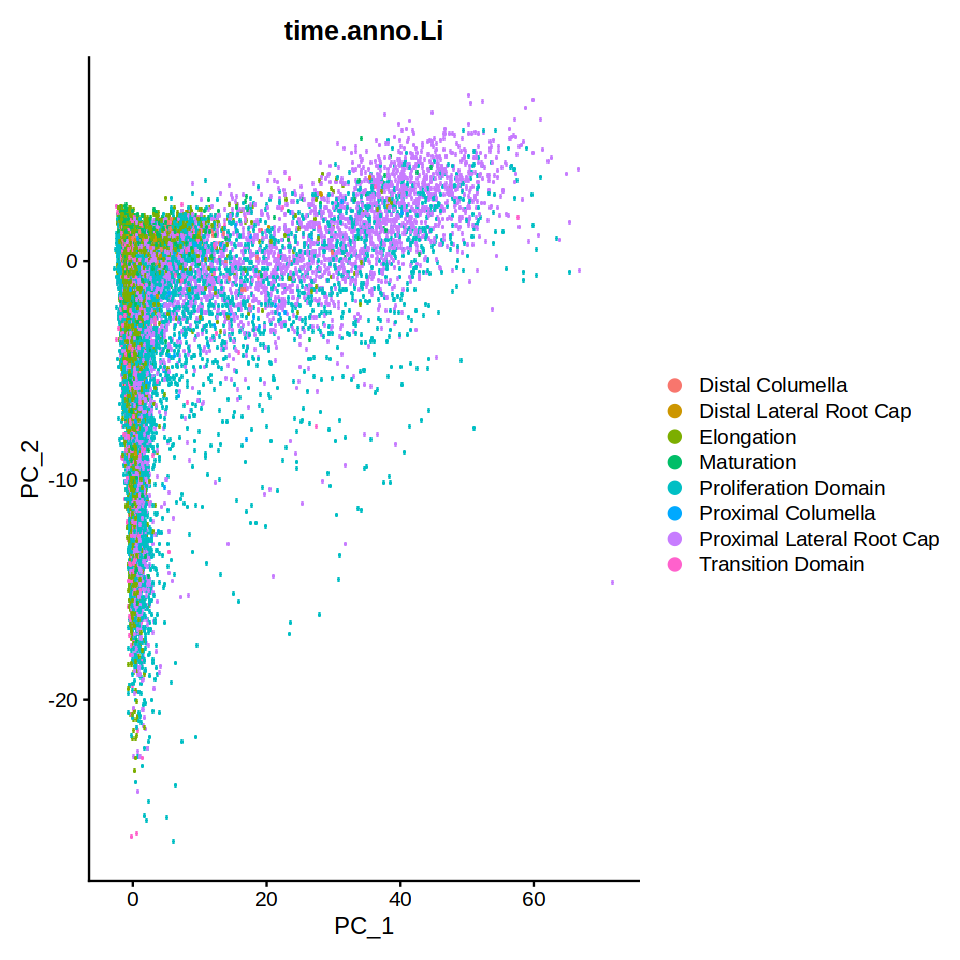

In [21]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "pca", group.by = "time.anno.Li", label = FALSE, pt.size=1, order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



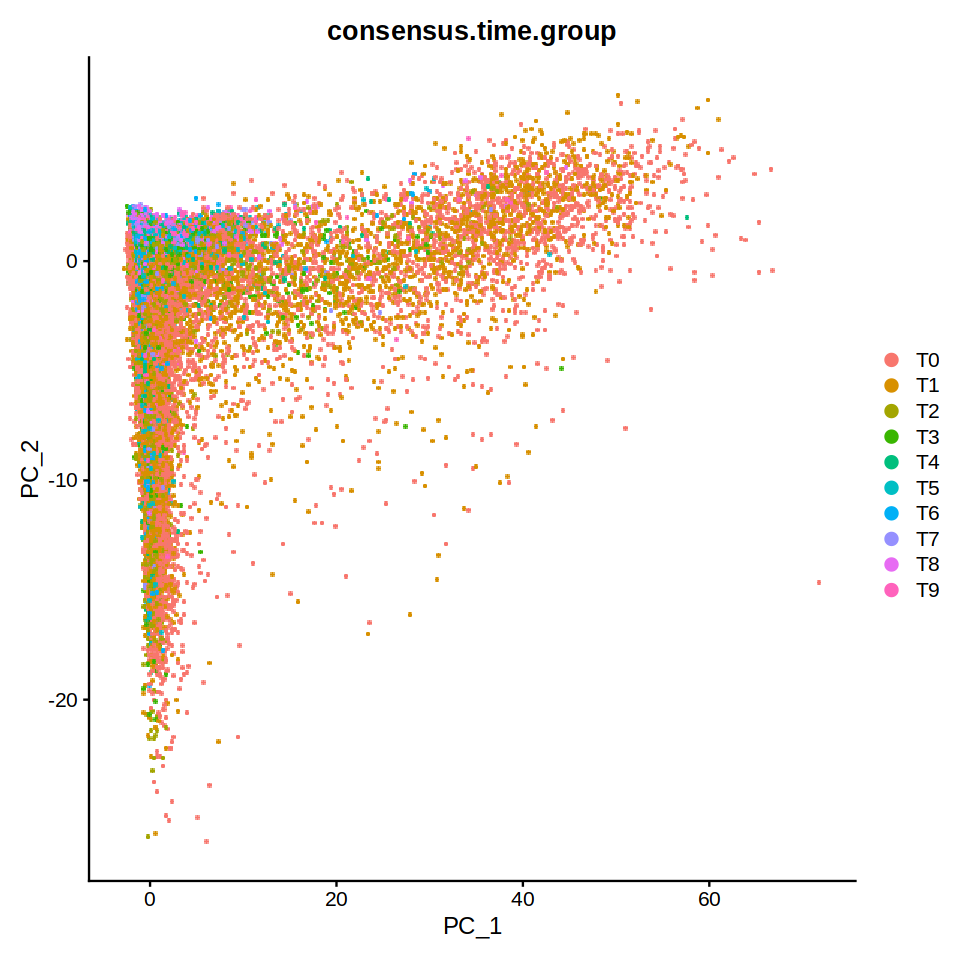

In [22]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "pca", group.by = "consensus.time.group", label = FALSE, pt.size=1, order=FALSE)

In [23]:
## S-phase cluster
sort(table(rc.integrated[,which(rc.integrated$seurat_clusters==0)]$celltype.anno.Li))


     Quiescent Center                Phloem Phloem Pole Pericycle 
                   38                   275                   323 
            Columella                 Xylem                Cortex 
                  331                   795                  1106 
           Procambium  Xylem Pole Pericycle            Endodermis 
                 1426                  1439                  1592 
         Atrichoblast           Trichoblast      Lateral Root Cap 
                 1646                  2546                  2879 

In [24]:
## S-phase cluster
sort(table(rc.integrated[,which(rc.integrated$seurat_clusters==0)]$time.anno.Li))


  Distal Lateral Root Cap          Distal Columella        Proximal Columella 
                      136                       161                       170 
               Maturation         Transition Domain Proximal Lateral Root Cap 
                      763                      1900                      2743 
     Proliferation Domain                Elongation 
                     3610                      4913 

In [25]:
## G2M-phase cluster
rev(sort(table(rc.integrated[,which(rc.integrated$seurat_clusters==4)]$celltype.anno.Li)))


     Lateral Root Cap          Atrichoblast            Endodermis 
                 2981                  1013                   790 
          Trichoblast                Cortex                 Xylem 
                  550                   429                   284 
            Columella  Xylem Pole Pericycle            Procambium 
                  275                   252                   249 
               Phloem Phloem Pole Pericycle      Quiescent Center 
                  233                   100                     8 

In [26]:
## G2M-phase cluster
rev(sort(table(rc.integrated[,which(rc.integrated$seurat_clusters==4)]$time.anno.Li)))


Proximal Lateral Root Cap      Proliferation Domain                Elongation 
                     2863                      1840                      1324 
               Maturation         Transition Domain          Distal Columella 
                      533                       211                       185 
  Distal Lateral Root Cap        Proximal Columella 
                      118                        90 

In [27]:
## G2M-phase cluster
rev(sort(table(rc.integrated[,which(rc.integrated$seurat_clusters==4)]$time.celltype.anno.Li)))


                       Proximal Lateral Root Cap 
                                            2863 
               Proliferation Domain_Atrichoblast 
                                             828 
                 Proliferation Domain_Endodermis 
                                             509 
                     Proliferation Domain_Cortex 
                                             264 
                Proliferation Domain_Trichoblast 
                                             210 
                 Elongation_Xylem Pole Pericycle 
                                             196 
                           Elongation_Endodermis 
                                             195 
                                Distal Columella 
                                             185 
                           Elongation_Procambium 
                                             176 
          Elongation_Metaphloem & Companion Cell 
                                             153 

## Top Genes contribute the most in each PCs

In [30]:
pc1r <- as.data.frame(rc.integrated[['pca']][,1]) %>% arrange(desc(PC_1)) %>% rownames(.)

In [31]:
pc1r[1:9]

[1] "AT1G18370" "AT1G02730" "AT5G15510" "AT1G16630" "AT5G56120" "AT3G55660"
[7] "AT4G14330" "AT4G05190" "AT3G19050"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



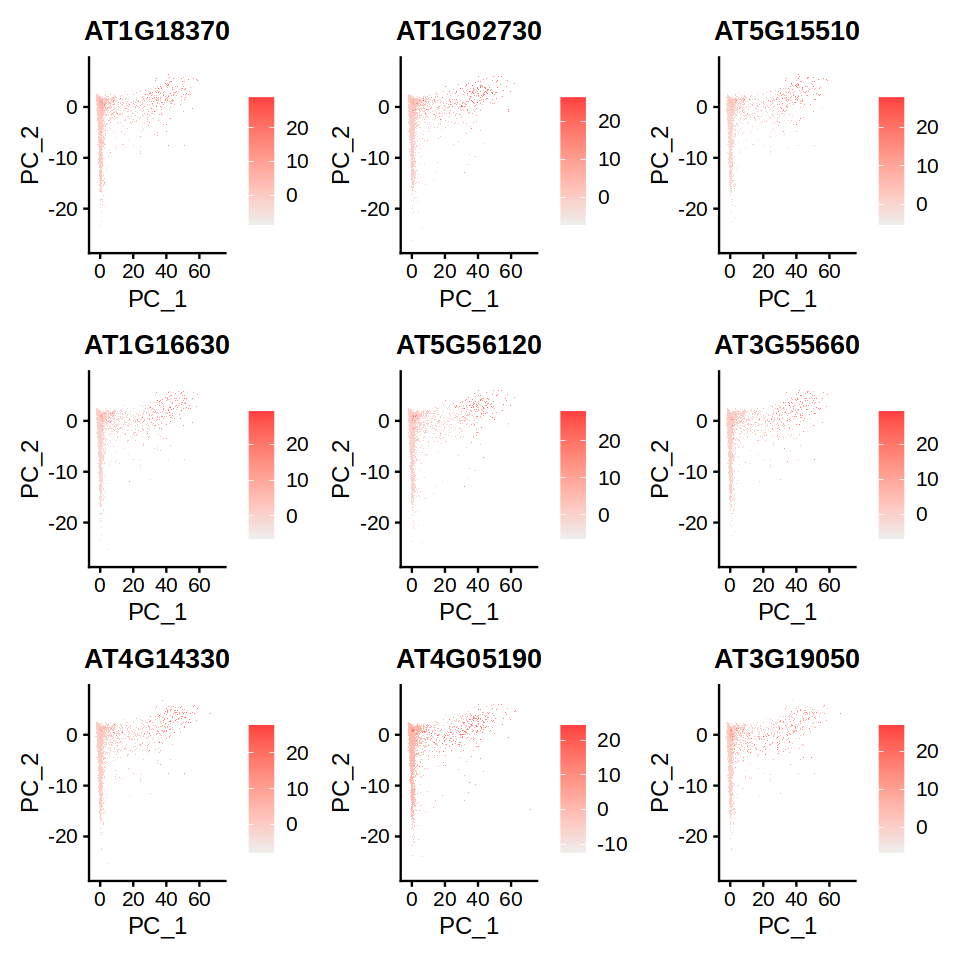

In [32]:
## PC1 positive
FeaturePlot(rc.integrated, reduction="pca", features = c(pc1r[1:9]), cols = c("#EEEEEE","#FF4040"), order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



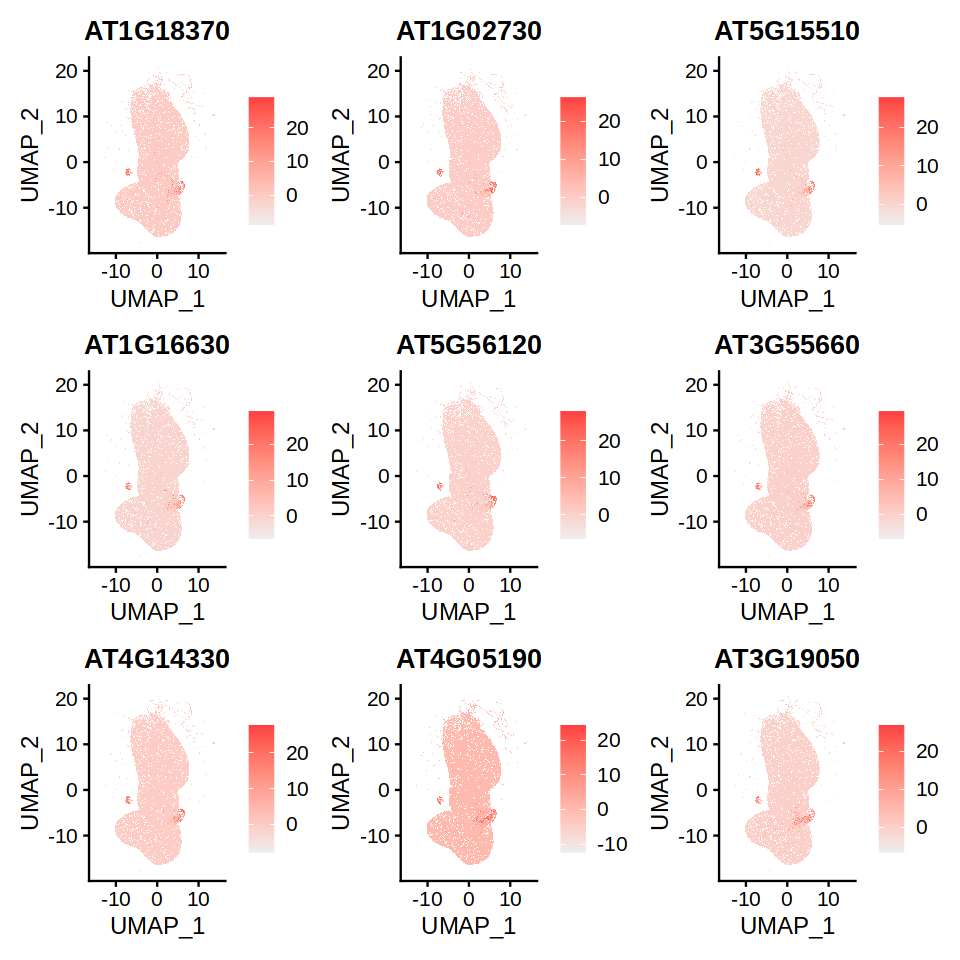

In [33]:
## PC1 positive
FeaturePlot(rc.integrated, reduction="umap", features = c(pc1r[1:9]), cols = c("#EEEEEE","#FF4040"), order=TRUE)

In [34]:
pc1r[1:20]

[1] "AT1G18370" "AT1G02730" "AT5G15510" "AT1G16630" "AT5G56120" "AT3G55660"
 [7] "AT4G14330" "AT4G05190" "AT3G19050" "AT4G26660" "AT1G63100" "AT1G03780"
[13] "AT5G13840" "AT5G60930" "AT5G55520" "AT3G44050" "AT1G20610" "AT4G02800"
[19] "AT4G09060" "AT4G38062"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



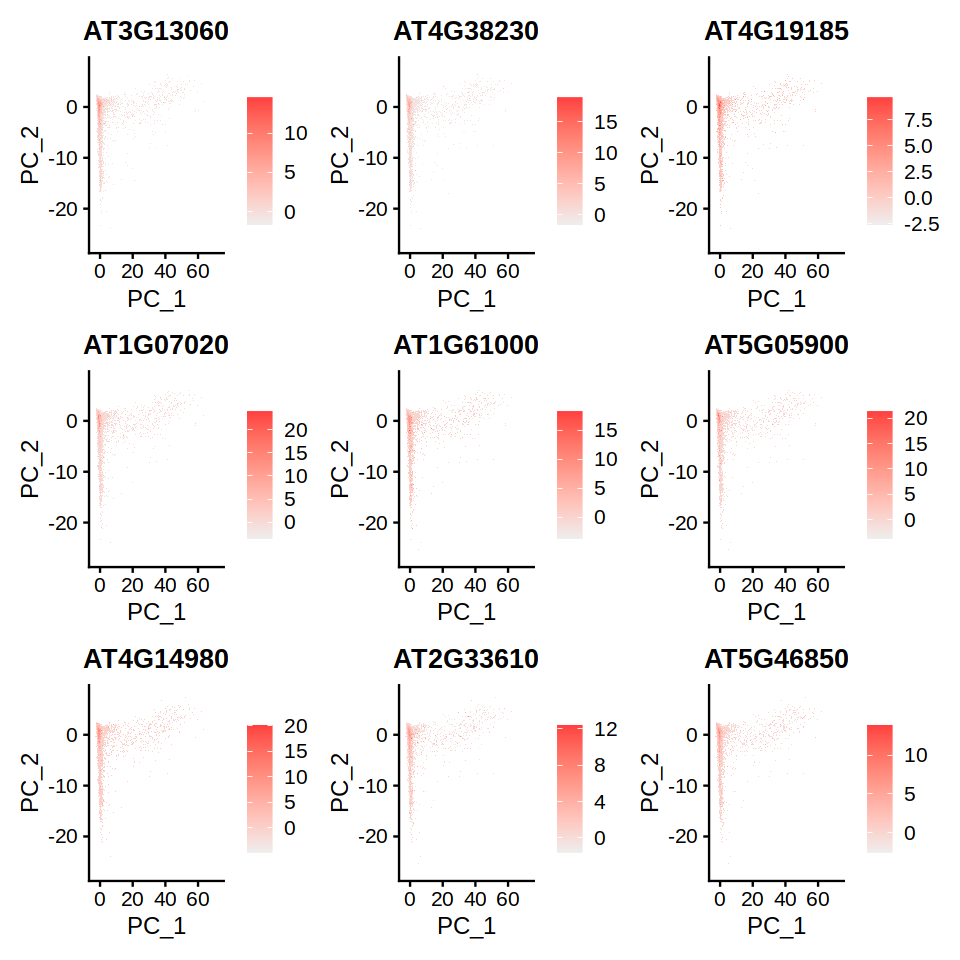

In [35]:
## PC1 negative
FeaturePlot(rc.integrated, reduction="pca", features = c(rev(pc1r)[1:9]), cols = c("#EEEEEE","#FF4040"),order=TRUE)

In [36]:
pc2r <- as.data.frame(rc.integrated[['pca']][,2]) %>% arrange(desc(PC_2)) %>% rownames(.)

In [37]:
pc2r[1:20]

[1] "AT5G56120" "AT5G15510" "AT1G02730" "AT4G26660" "AT1G03780" "AT3G55660"
 [7] "AT1G16630" "AT4G14330" "AT5G55520" "AT5G13840" "AT4G02800" "AT2G44190"
[13] "AT5G44040" "AT1G63100" "AT3G51230" "AT3G11520" "AT4G28430" "AT3G15550"
[19] "AT4G17000" "AT4G09060"

In [38]:
rev(pc2r)[1:20]

[1] "AT1G69770" "AT3G25100" "AT5G43080" "AT4G00020" "AT3G05740" "AT3G54750"
 [7] "AT3G27640" "AT4G30860" "AT1G80190" "AT3G52115" "AT5G46740" "AT4G21070"
[13] "AT2G44580" "AT3G12170" "AT2G29680" "AT5G20850" "AT3G24495" "AT5G52220"
[19] "AT3G18730" "AT2G42260"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



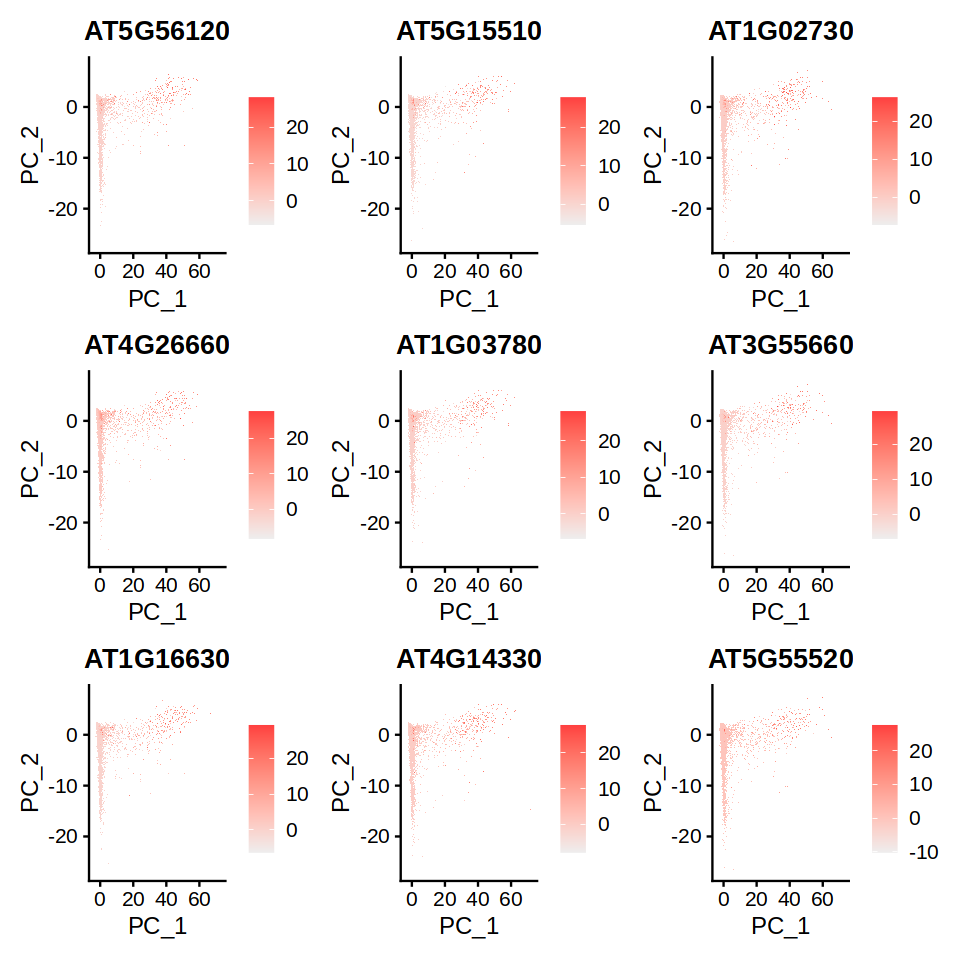

In [39]:
## PC2 positive
FeaturePlot(rc.integrated, reduction="pca", features = c(pc2r[1:9]), cols = c("#EEEEEE","#FF4040"),order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



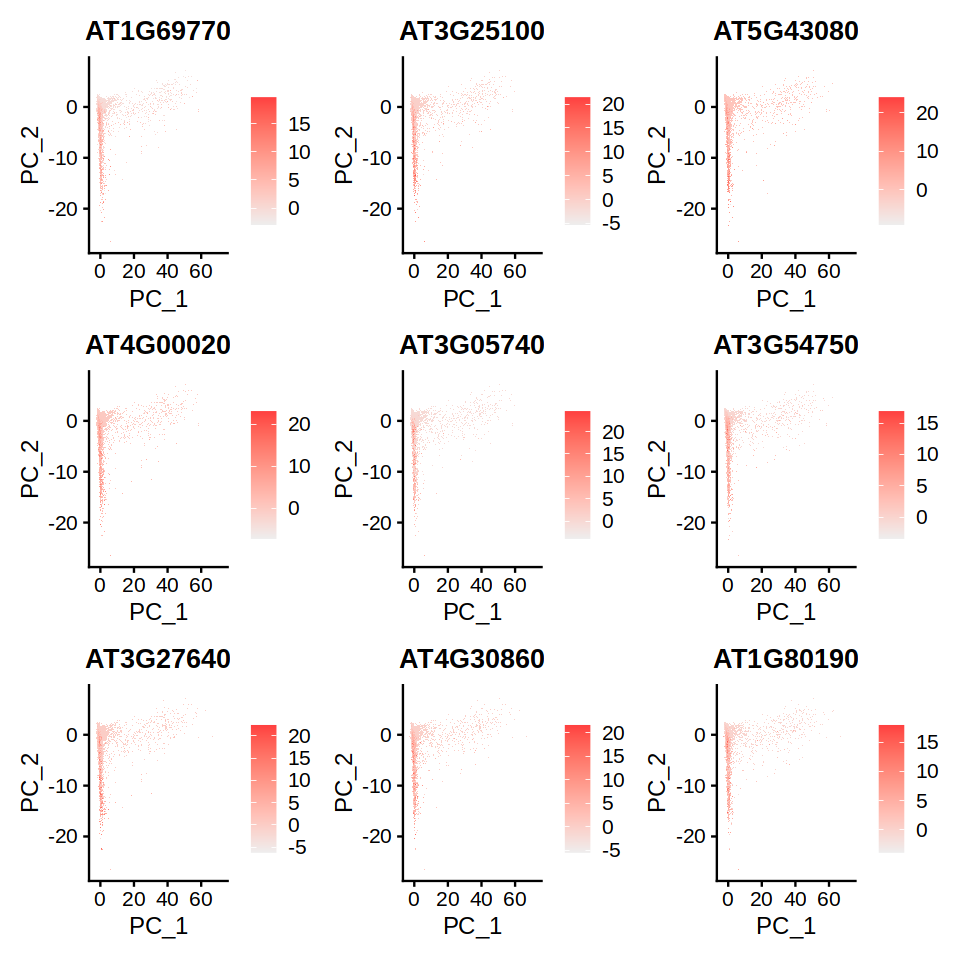

In [40]:
## PC2 negative
FeaturePlot(rc.integrated, reduction="pca", features = c(rev(pc2r)[1:9]), cols = c("#EEEEEE","#FF4040"),order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



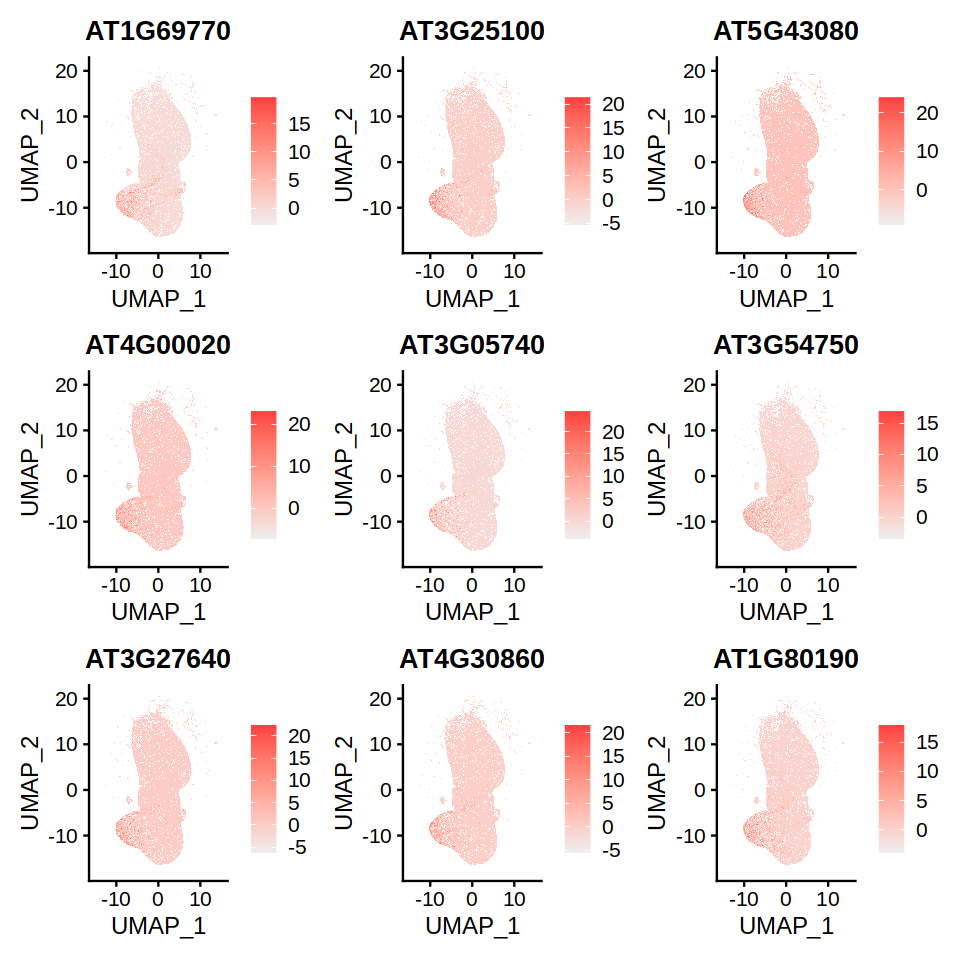

In [41]:
## PC2 negative
FeaturePlot(rc.integrated, reduction="umap", features = c(rev(pc2r)[1:9]), cols = c("#EEEEEE","#FF4040"),order=TRUE)

In [42]:
pc3r <- as.data.frame(rc.integrated[['pca']][,3]) %>% arrange(desc(PC_3)) %>% rownames(.)

In [43]:
pc3r[1:20]

[1] "AT1G29418" "AT5G59240" "AT3G55340" "AT5G60930" "AT1G73180" "AT1G77550"
 [7] "AT4G18570" "AT1G19520" "AT3G07630" "AT1G72670" "AT3G13150" "AT1G30960"
[13] "AT1G53542" "AT5G62410" "AT1G09700" "AT1G53140" "AT1G04710" "AT2G36200"
[19] "AT3G19050" "AT1G04130"

In [44]:
rev(pc3r)[1:20]

[1] "AT3G25100" "AT5G43080" "AT5G56120" "AT3G05740" "AT3G52115" "AT4G00020"
 [7] "AT3G27640" "AT3G51230" "AT4G30860" "AT2G29680" "AT1G03780" "AT1G63100"
[13] "AT1G02730" "AT4G02800" "AT5G15510" "AT3G18730" "AT4G26660" "AT4G21070"
[19] "AT4G17000" "AT5G46740"

## Phase signature

In [45]:
zscore <- function(x){(x-mean(x))/sd(x)}

#### Zhang's list

In [46]:
cc.genes.zhang <- cc.genes.zhang[match(intersect(rownames(rc.integrated),cc.genes.zhang$Gene),cc.genes.zhang$Gene),] %>% arrange(Phase)

In [47]:
head(cc.genes.zhang)

,Gene,Phase,Symbol,Araport11,Function
,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT1G16630,G2,NA,transmembrane protein;(source:Araport11),NA
2,AT4G05190,G2,ATK5,kinesin 5;(source:Araport11),ATK5 encodes a kinesin protein involved in microtubule spindle morphogenesis. It acts as a minus-end directed motor as well as a plus-end tracking protein (+TIP). Localizes to mitotic spindle midzones and regions rich in growing plus-ends within phragmoplasts.
3,AT1G20610,G2,CYCB2;3,Cyclin B2;(source:Araport11),NA
4,AT5G55520,G2,NA,kinesin-like protein;(source:Araport11),NA
5,AT4G01730,G2,NA,DHHC-type zinc finger family protein;(source:Araport11),NA
6,AT1G44110,G2,CYCA1;1,Cyclin A1;(source:Araport11),NA


In [17]:
head(cc.genes.zhang %>% filter(Phase == "S"))

,Gene,Phase,Symbol,Araport11,Function
,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT5G10400,S,H3.1,Histone superfamily protein;(source:Araport11),NA
2,AT5G22880,S,H2B,histone B2;(source:Araport11),"Encodes a histone 2B (H2B) protein. This protein can be ubiquitinated in planta, and this modification depends on the HUB1 and HUB2 E3 ubiquitin ligases."
3,AT5G59870,S,h2a.w.6,histone H2A 6;(source:Araport11),"Encodes HTA6, a histone H2A protein."
4,AT5G59690,S,NA,Histone superfamily protein;(source:Araport11),NA
5,AT5G65360,S,H3.1,Histone superfamily protein;(source:Araport11),NA
6,AT1G09200,S,H3.1,Histone superfamily protein;(source:Araport11),NA


In [48]:
msc <- c()
suppressWarnings(
for (i in as.character(unique(cc.genes.zhang$Phase))){
    if (length(cc.genes.zhang[which(cc.genes.zhang$Phase== i),]$Gene)>1){
    msc <- cbind(msc, as.numeric(apply(apply(as.matrix(rc.integrated@assays$integrated@data)[cc.genes.zhang[which(cc.genes.zhang$Phase== i),]$Gene,], 1, zscore), 1, mean)))       
    } else {
    msc <- cbind(msc, as.numeric(zscore(as.matrix(rc.integrated@assays$integrated@data)[cc.genes.zhang[which(cc.genes.zhang$Phase== i),]$Gene,])))      
    }

}
)
colnames(msc) <- as.character(unique(cc.genes.zhang$Phase))
rownames(msc) <- colnames(rc.integrated)

In [49]:
head(msc)

,G2,M,S
AAACCTGAGCGCCTCA_1,-0.028233902,0.02767077,-0.2789407
AAACCTGCACTTAACG_1,-0.085037611,-0.09186232,-0.3035347
AAACCTGCAGGACGTA_1,-0.128067505,-0.03061144,-0.2891731
AAACCTGGTATCACCA_1,-0.005055825,-0.07676504,-0.2121654
AAACCTGTCAGGTAAA_1,-0.082317857,-0.09259665,-0.1922454
AAACGGGCAATAGAGT_1,-0.154851348,-0.11182951,-0.3160343


In [51]:
#rc.integrated$G1_sig <- msc[,1]
rc.integrated$G2_sig <- msc[,1]
rc.integrated$M_sig <- msc[,2]
rc.integrated$S_sig <- msc[,3]

In [52]:
#FeaturePlot(rc.integrated, reduction="umap", features = "G1_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



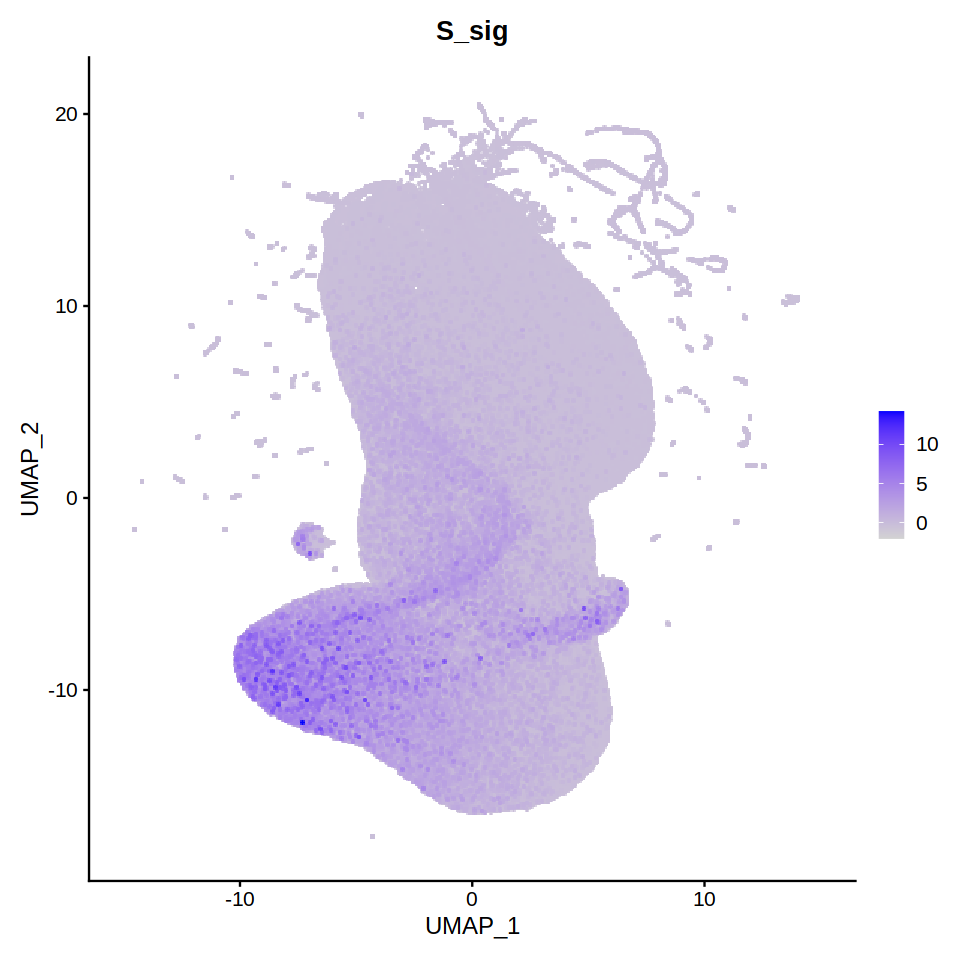

In [53]:
FeaturePlot(rc.integrated, reduction="umap", features = "S_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



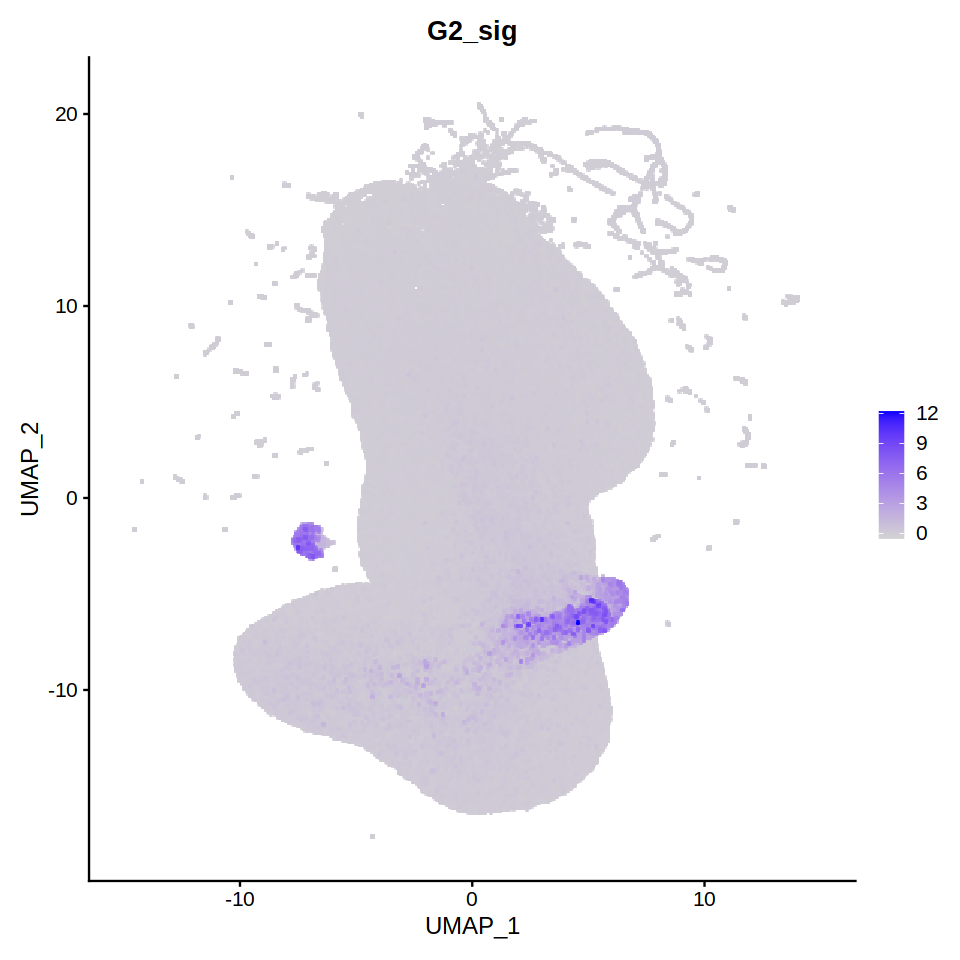

In [54]:
FeaturePlot(rc.integrated, reduction="umap", features = "G2_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



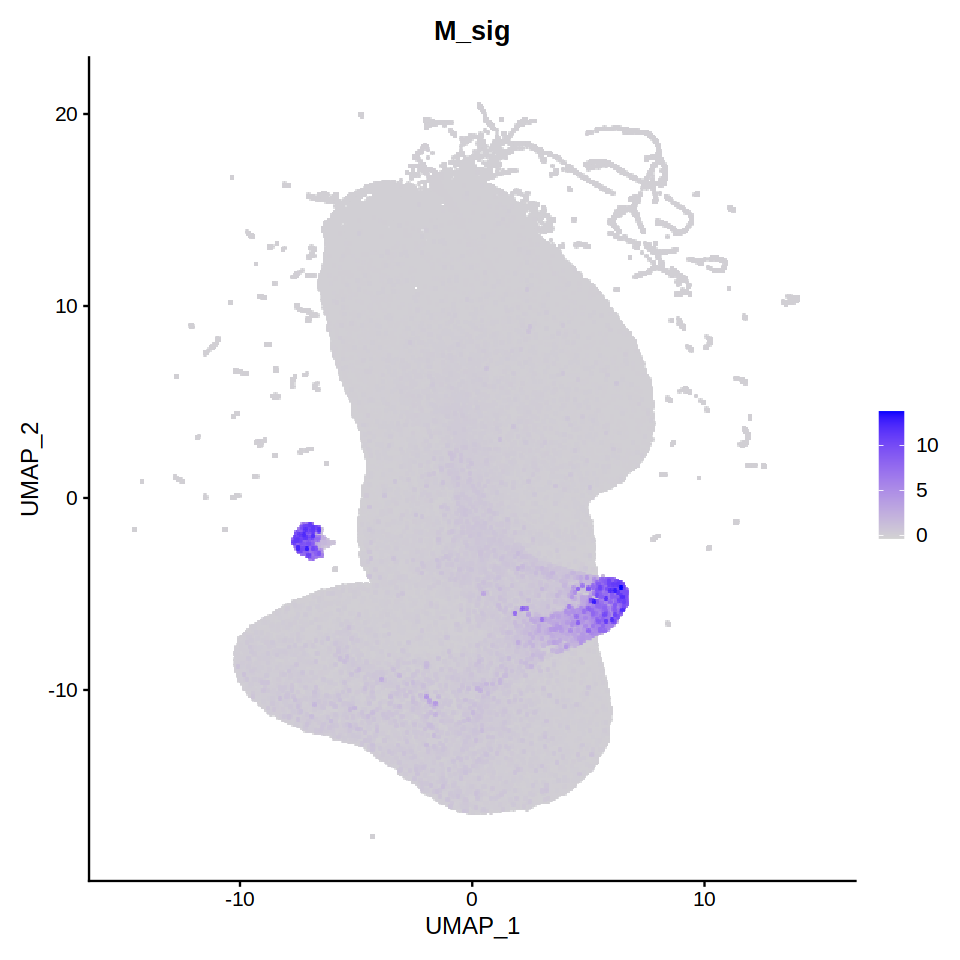

In [55]:
FeaturePlot(rc.integrated, reduction="umap", features = "M_sig", pt.size=1,order=TRUE)

In [56]:
#FeaturePlot(rc.integrated, reduction="pca", features = "G1_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



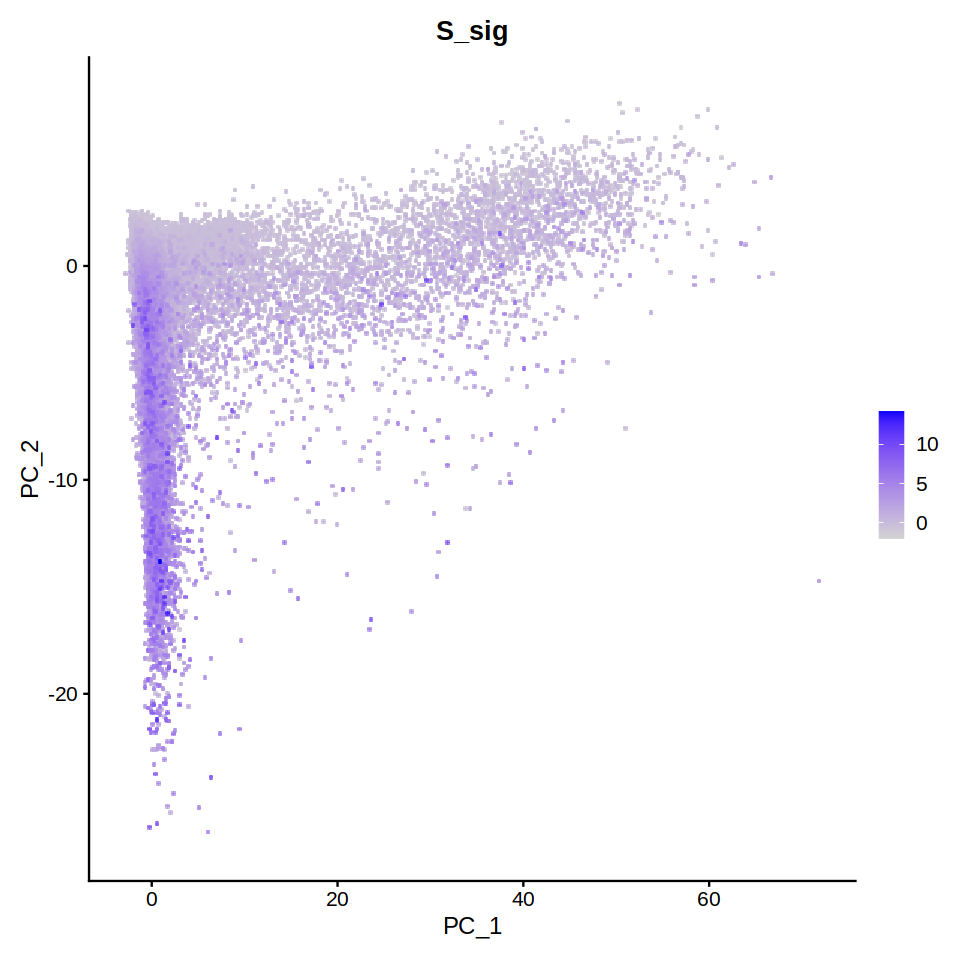

In [57]:
FeaturePlot(rc.integrated, reduction="pca", features = "S_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



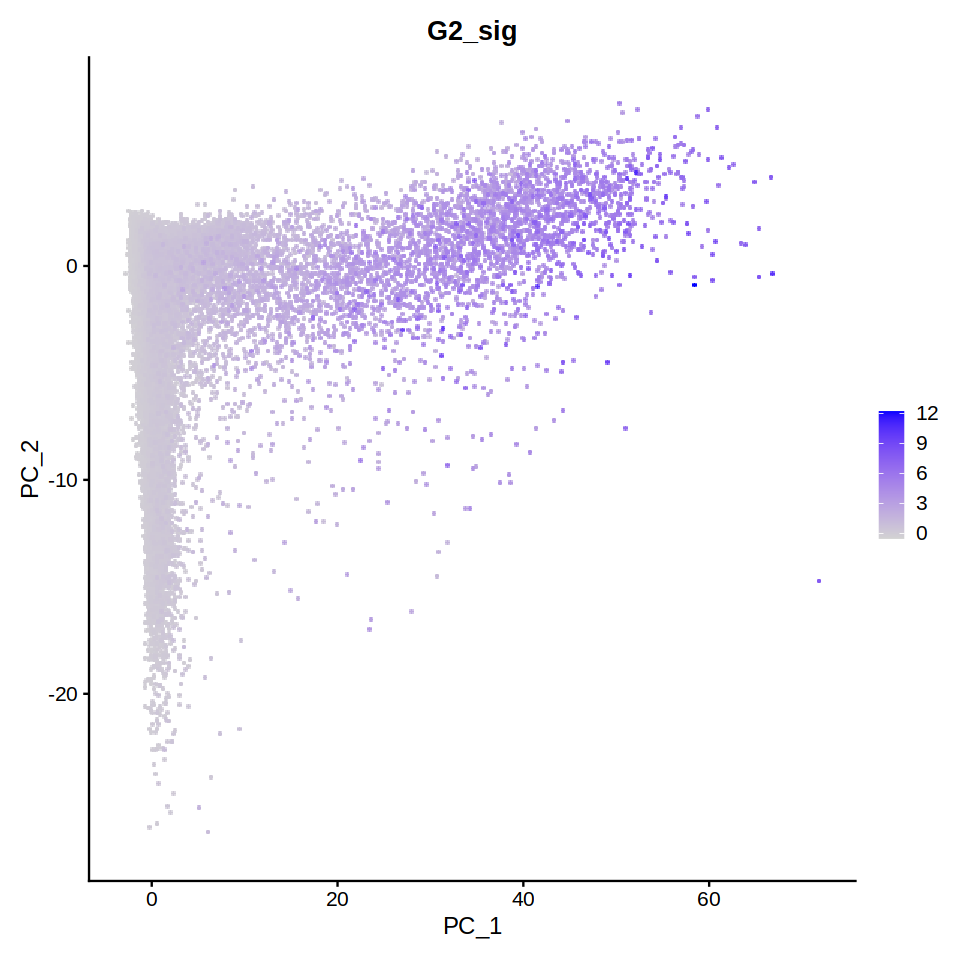

In [58]:
FeaturePlot(rc.integrated, reduction="pca", features = "G2_sig", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



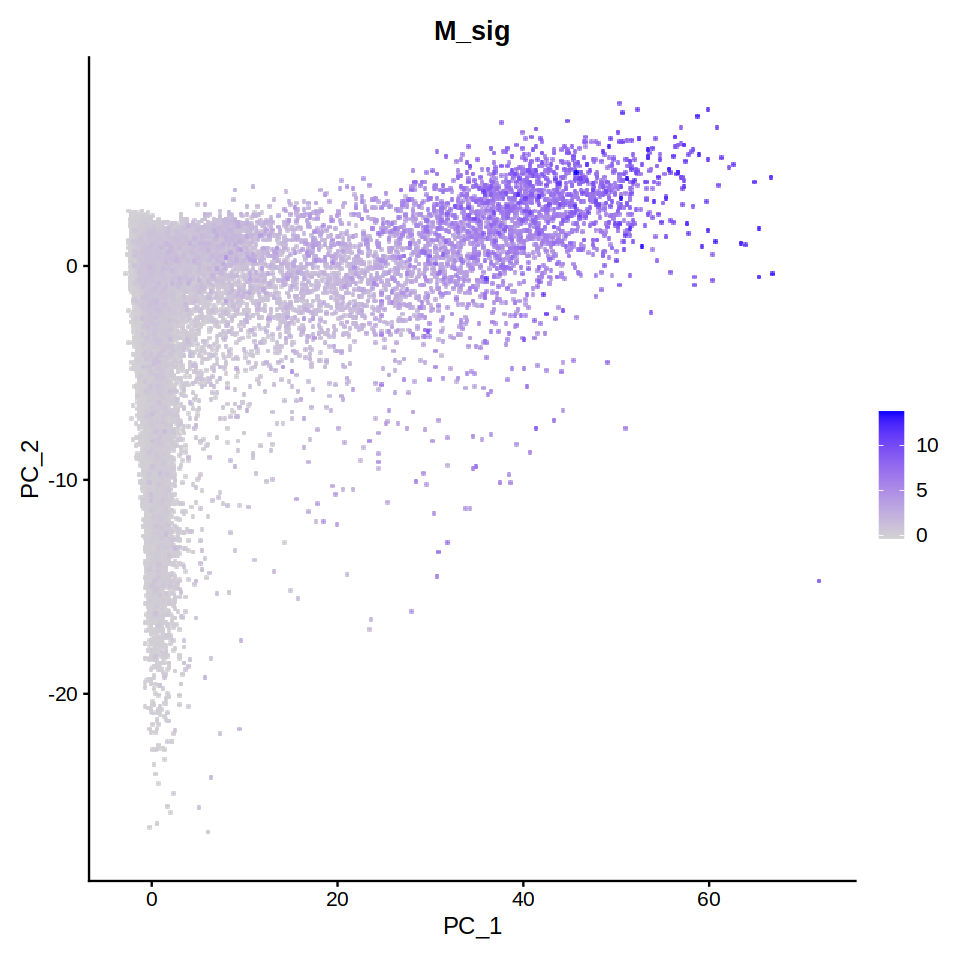

In [59]:
FeaturePlot(rc.integrated, reduction="pca", features = "M_sig", pt.size=1,order=TRUE)

#### Goldy's list

In [60]:
head(cc.genes.goldy)

,gene,phase
,<chr>,<chr>
1,AT2G23320,Enriched_G2M
2,AT4G17340,Enriched_G2M
3,AT5G27420,Enriched_G2M
4,AT5G54290,Enriched_G2M
5,AT5G08240,Enriched_G2M
6,AT5G06980,Enriched_G2M


In [61]:
cc.genes.goldy <- cc.genes.goldy[match(intersect(rownames(rc.integrated),cc.genes.goldy$gene),cc.genes.goldy$gene),] %>% arrange(phase)

In [62]:
msc <- c()
suppressWarnings(
for (i in as.character(unique(cc.genes.goldy$phase))){
    if (length(cc.genes.goldy[which(cc.genes.goldy$phase== i),]$gene)>1){
    msc <- cbind(msc, as.numeric(apply(apply(as.matrix(rc.integrated@assays$integrated@data)[cc.genes.goldy[which(cc.genes.goldy$phase== i),]$gene,], 1, zscore), 1, mean)))       
    } else {
    msc <- cbind(msc, as.numeric(zscore(as.matrix(rc.integrated@assays$integrated@data)[cc.genes.goldy[which(cc.genes.goldy$phase== i),]$gene,])))      
    }

}
)
colnames(msc) <- as.character(unique(cc.genes.goldy$phase))
rownames(msc) <- colnames(rc.integrated)

In [63]:
head(msc)

,Depleted_G2M,Enriched_G2M
AAACCTGAGCGCCTCA_1,-0.055274931,0.05566898
AAACCTGCACTTAACG_1,0.002564458,-0.10651000
AAACCTGCAGGACGTA_1,-0.072215184,-0.10086421
AAACCTGGTATCACCA_1,-0.161443430,0.01979224
AAACCTGTCAGGTAAA_1,0.028097562,-0.05966497
AAACGGGCAATAGAGT_1,0.092315593,-0.06260356


In [64]:
rc.integrated$Depleted_G2M <- msc[,1]
rc.integrated$Enriched_G2M <- msc[,2]

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



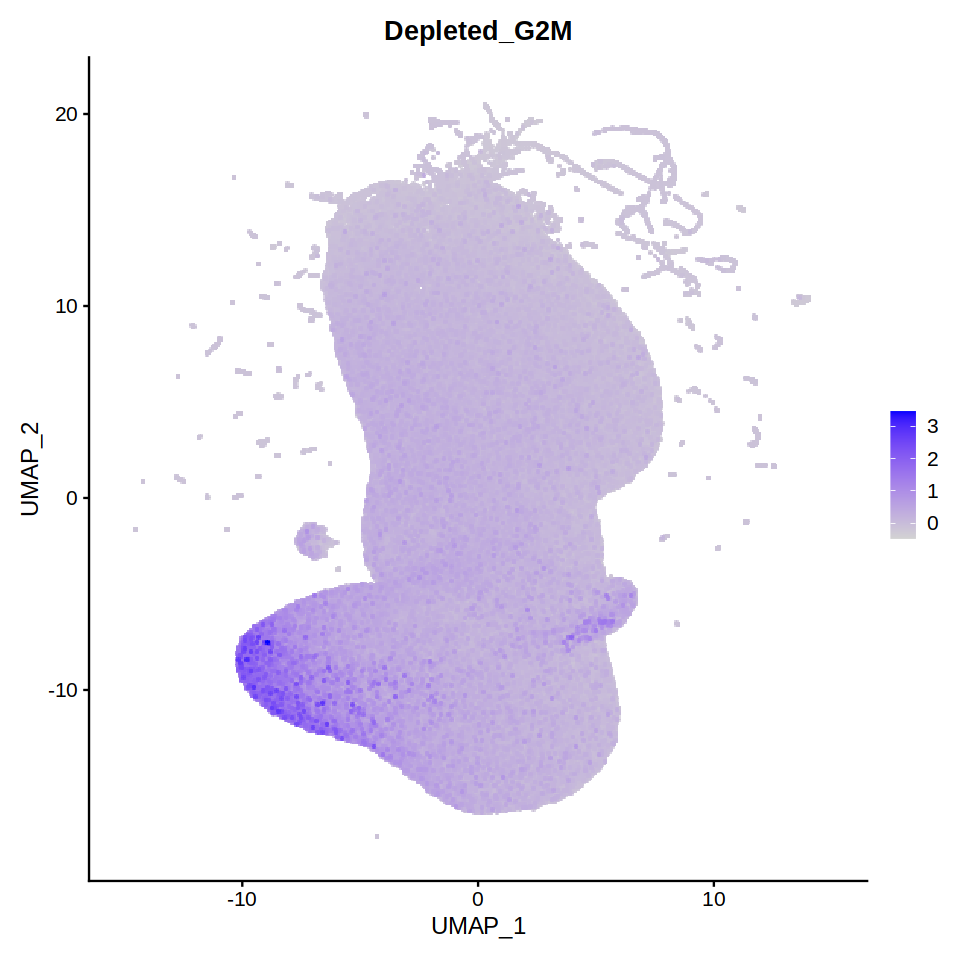

In [65]:
FeaturePlot(rc.integrated, reduction="umap", features = "Depleted_G2M", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



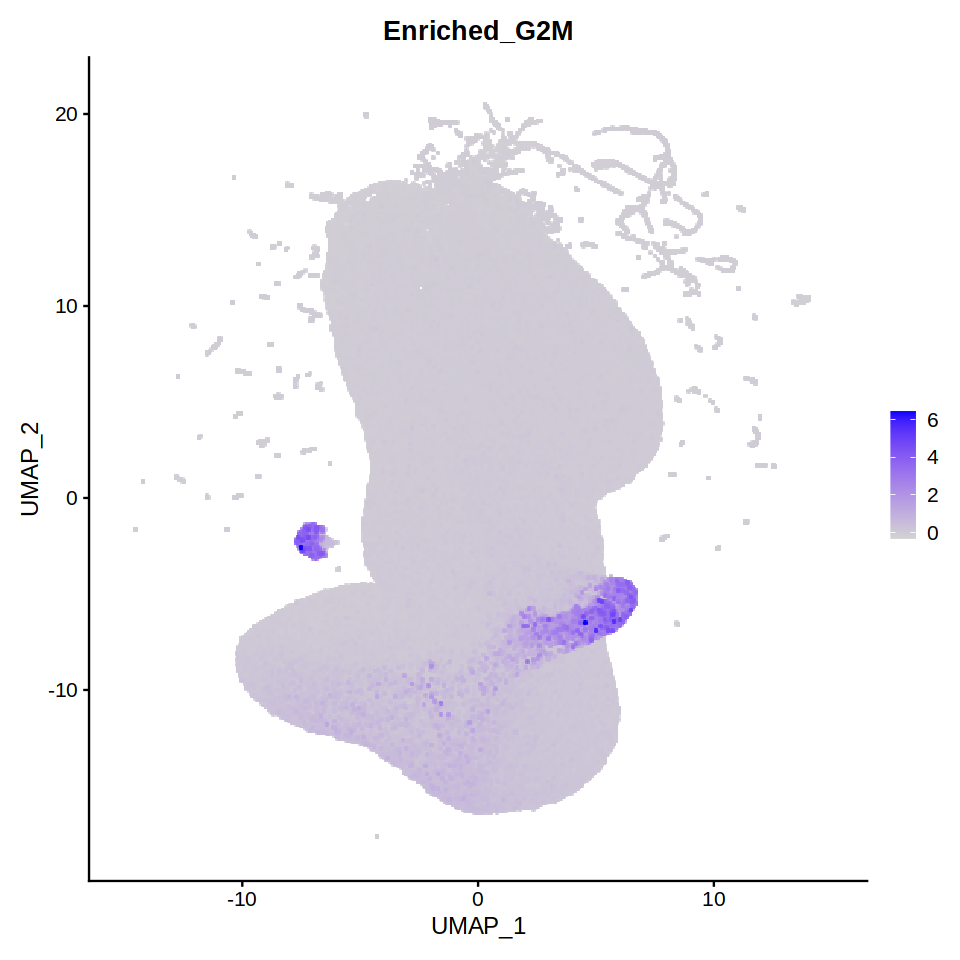

In [66]:
FeaturePlot(rc.integrated, reduction="umap", features = "Enriched_G2M", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



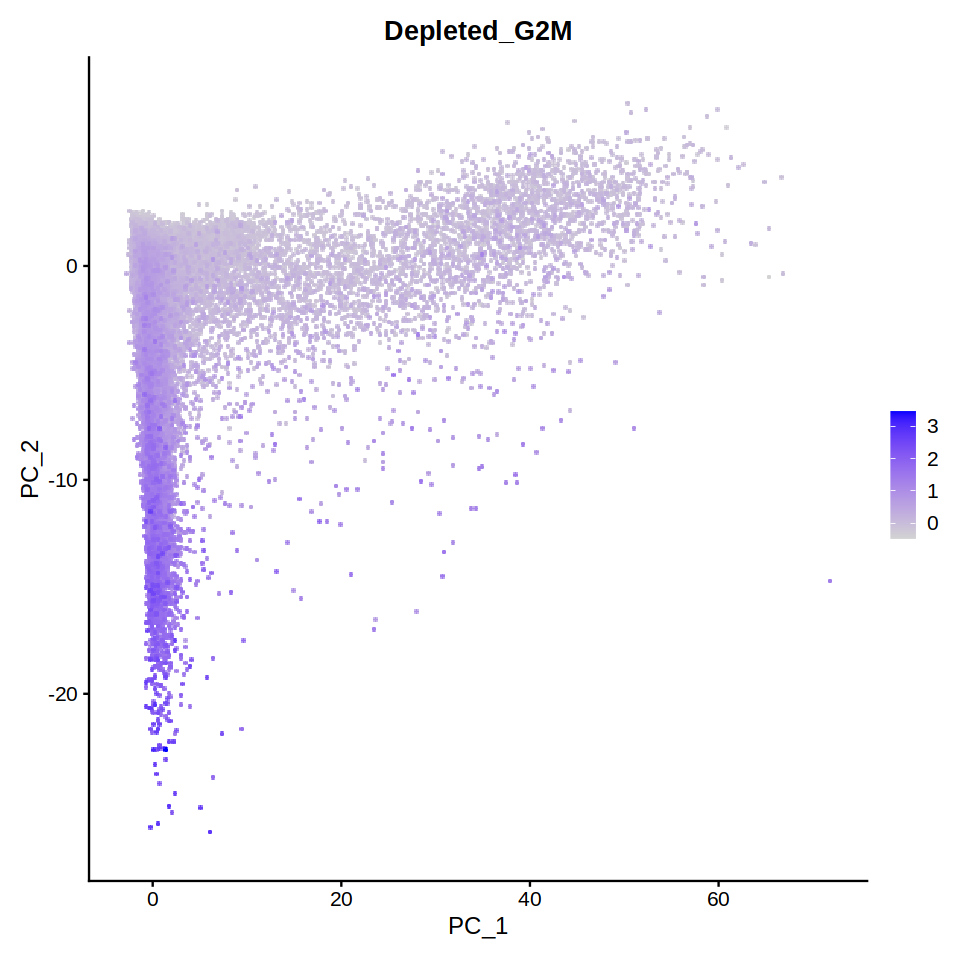

In [67]:
FeaturePlot(rc.integrated, reduction="pca", features = "Depleted_G2M", pt.size=1,order=TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



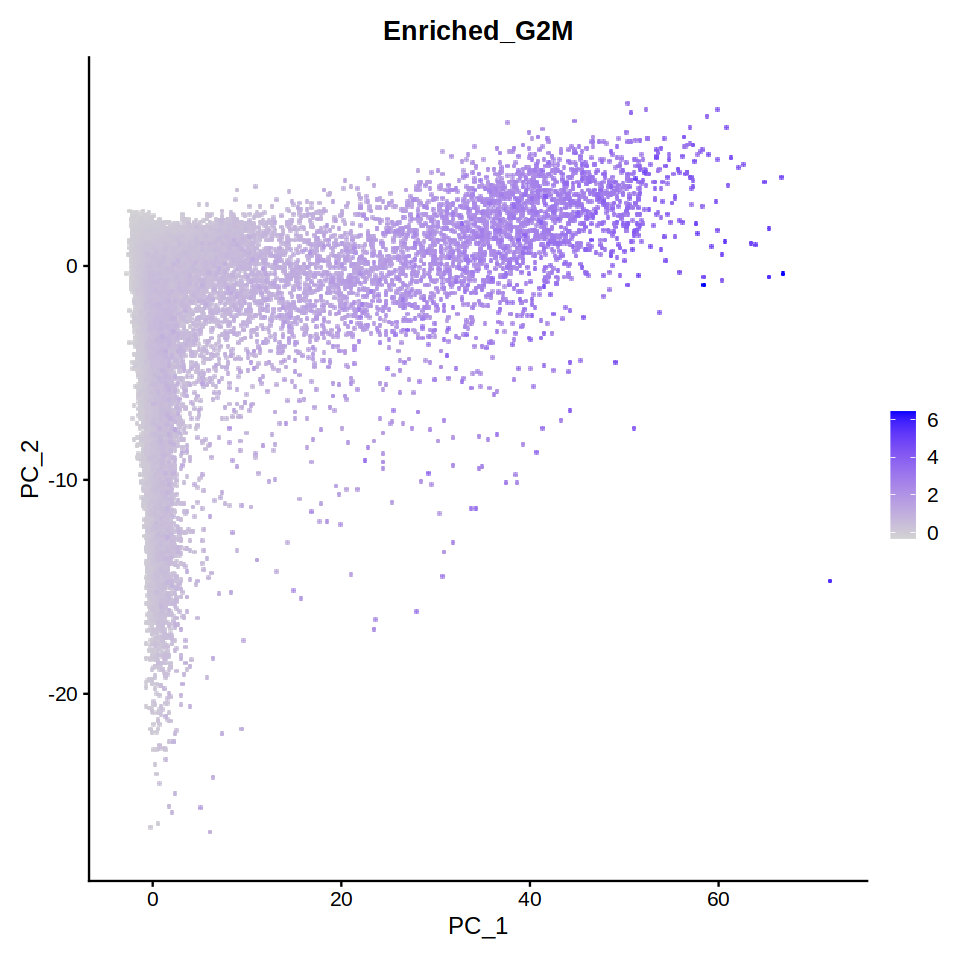

In [68]:
FeaturePlot(rc.integrated, reduction="pca", features = "Enriched_G2M", pt.size=1,order=TRUE)

#### Check Seurat Cluster 0 and 4

In [76]:
rc.integrated$G2M_clust <- rep("others", ncol(rc.integrated))
rc.integrated$G2M_clust[which(rc.integrated$seurat_clusters==4)] = "G2M"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



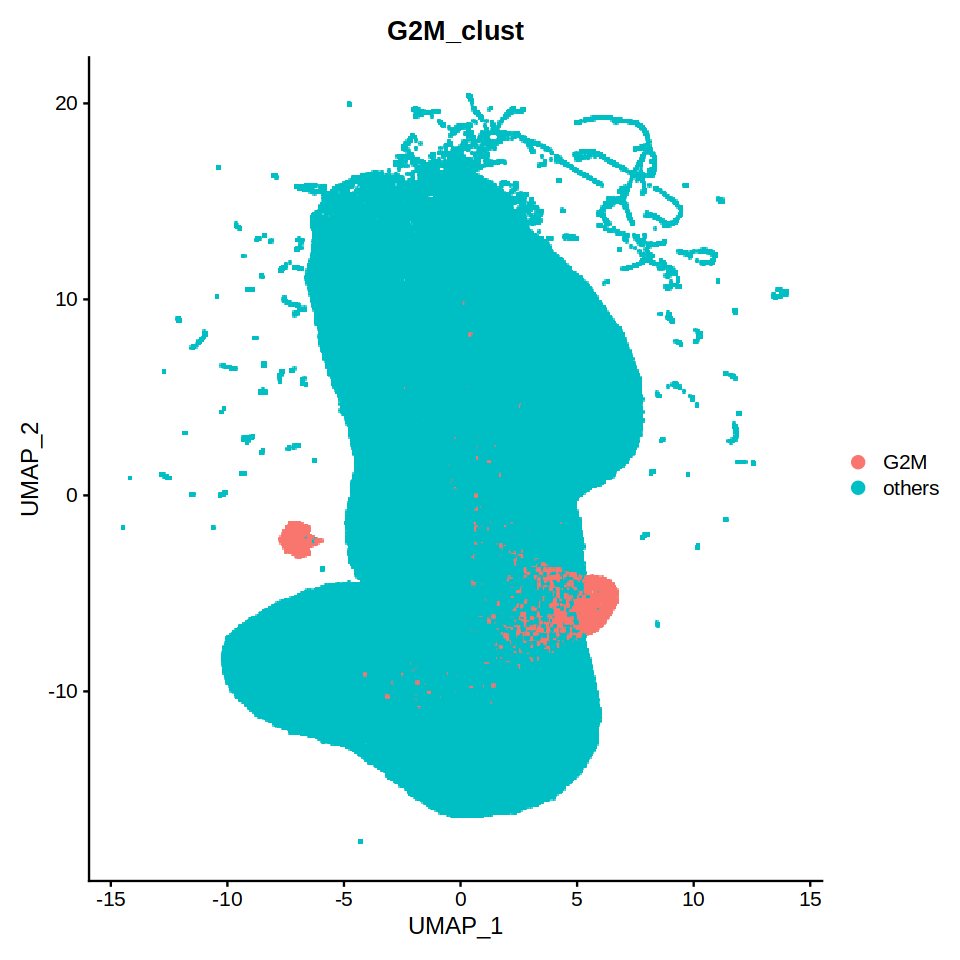

In [77]:
DimPlot(rc.integrated, reduction="umap", group = "G2M_clust", pt.size=1,order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



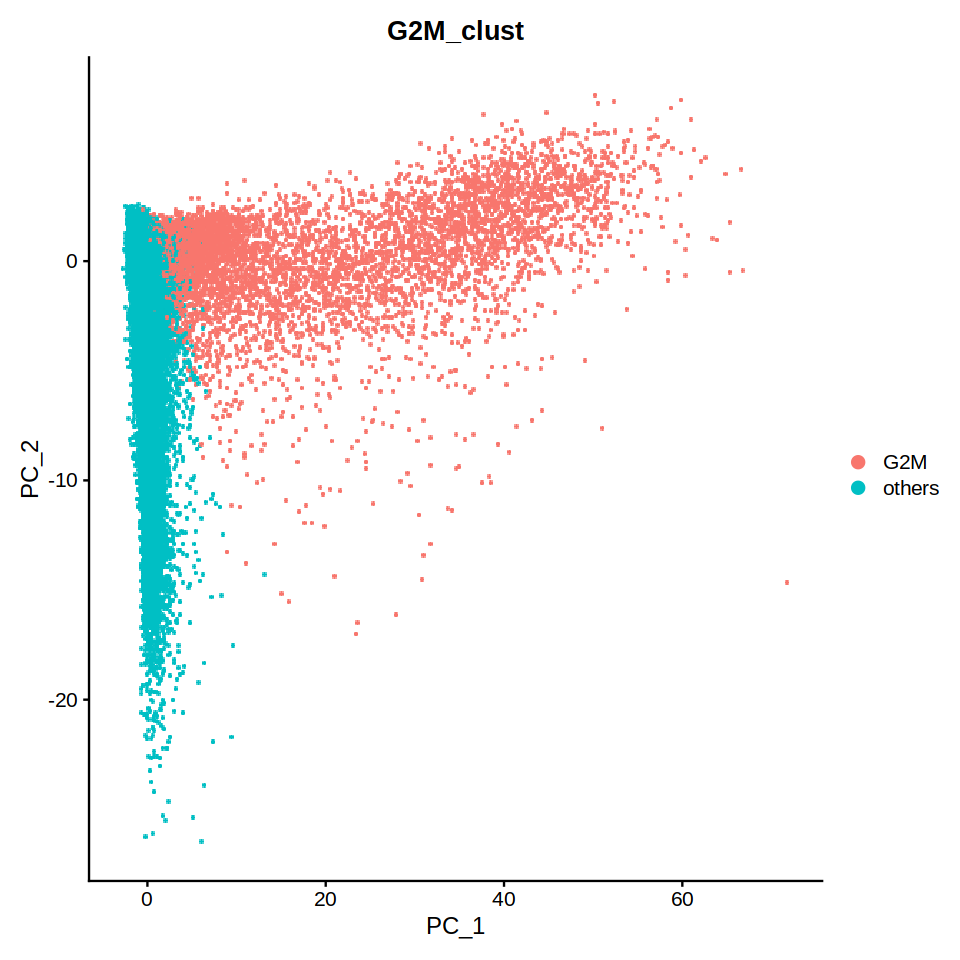

In [81]:
DimPlot(rc.integrated, reduction="pca", group = "G2M_clust", pt.size=1,order=FALSE)

In [78]:
rc.integrated$S_clust <- rep("others", ncol(rc.integrated))
rc.integrated$S_clust[which(rc.integrated$seurat_clusters==0)] = "S"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



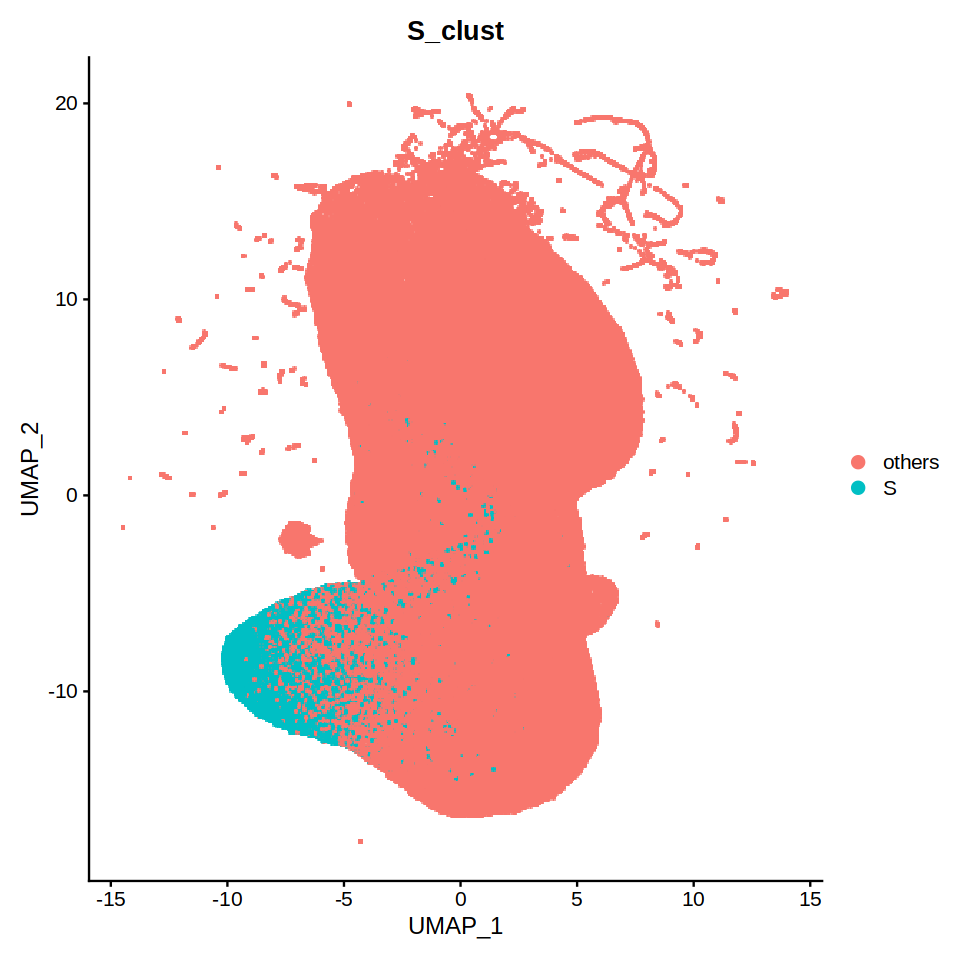

In [79]:
DimPlot(rc.integrated, reduction="umap", group = "S_clust", pt.size=1,order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



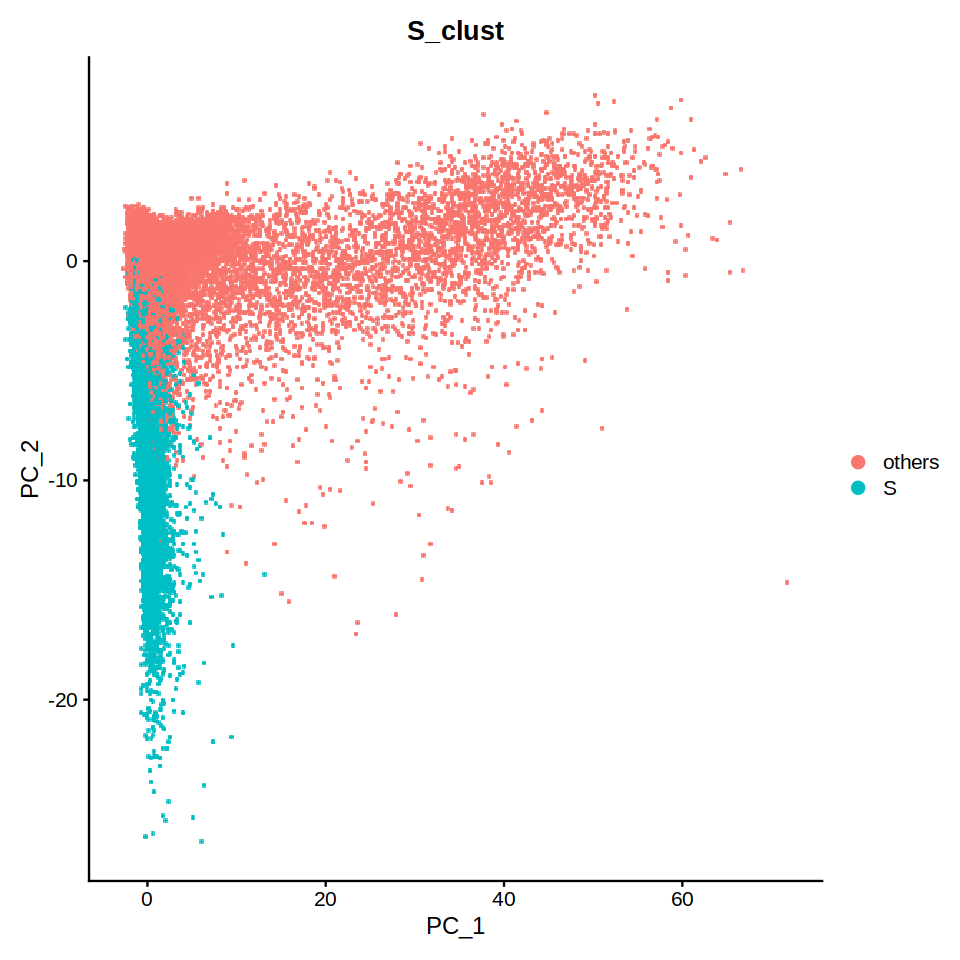

In [82]:
DimPlot(rc.integrated, reduction="pca", group = "S_clust", pt.size=1,order=FALSE)

### Convert to single cell experiment

In [10]:
new.ref <- readRDS("./tradeseq/Tricycle_Reference_Arabidopsis_Root.rds")

In [11]:
sce <- as.SingleCellExperiment(rc.integrated)

In [12]:
sce$geno <- rep("WT",length(sce$orig.ident))

The number of projection genes found in the new data is 245.

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


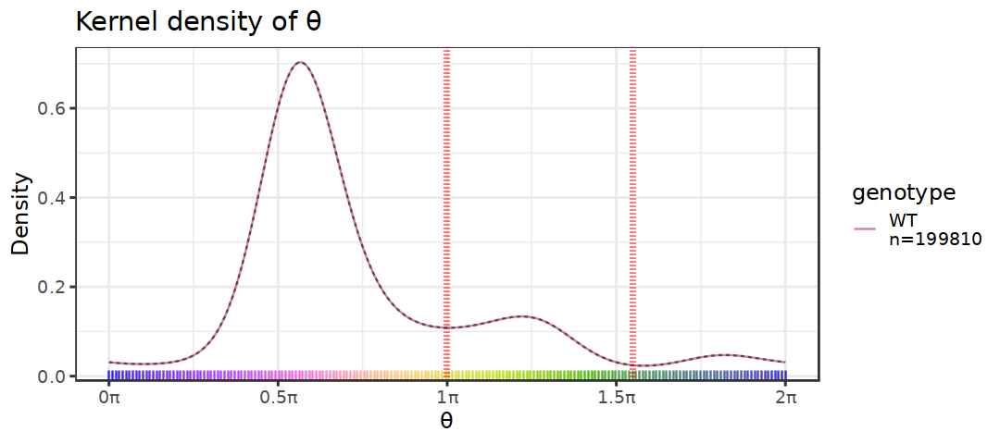

In [13]:
## Tricycle estimation
sce <- project_cycle_space(sce,ref.m = new.ref)
sce <- estimate_cycle_position(sce)

sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
sce$tricyclePosition <- sce$tricyclePosition*pi

## Plot
options(repr.plot.width=9, repr.plot.height=4)
print(plot_ccposition_den(sce$tricyclePosition,
                sce$geno, 'genotype',
                bw = 10, fig.title = "Kernel density of \u03b8", palette.v=colorRampPalette(brewer.pal(11, "Spectral"))(18)) +
  theme_bw(base_size = 14)+ geom_vline(xintercept = 1*pi, linetype="dotted", 
                color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
                color = "red", size=1.5))

In [14]:
grDevices::cairo_pdf("./pdfs/Density_Plot_CC.pdf",width=9, height=4)
print(plot_ccposition_den(sce$tricyclePosition,
                sce$geno, 'genotype',
                bw = 10, fig.title = "Kernel density of \u03b8", palette.v=colorRampPalette(brewer.pal(11, "Spectral"))(18)) +
  theme_bw(base_size = 14)+ geom_vline(xintercept = 1*pi, linetype="dotted", 
                color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
                color = "red", size=1.5))
dev.off()

png 
  2

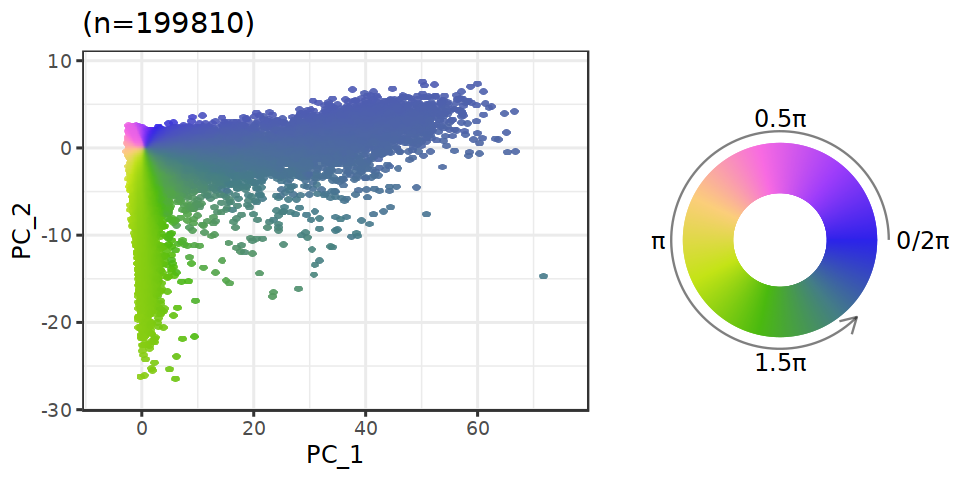

In [16]:
p <- plot_emb_circle_scale(sce, dimred = 1,
                           point.size = 5, point.alpha = 0.9) +
  theme_bw(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
options(repr.plot.width=8, repr.plot.height=4)
plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.6))

In [17]:
grDevices::cairo_pdf("./pdfs/PCA_CC.pdf",width=8, height=4)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.6)))
dev.off()

png 
  2

The number of projection genes found in the new data is 245.



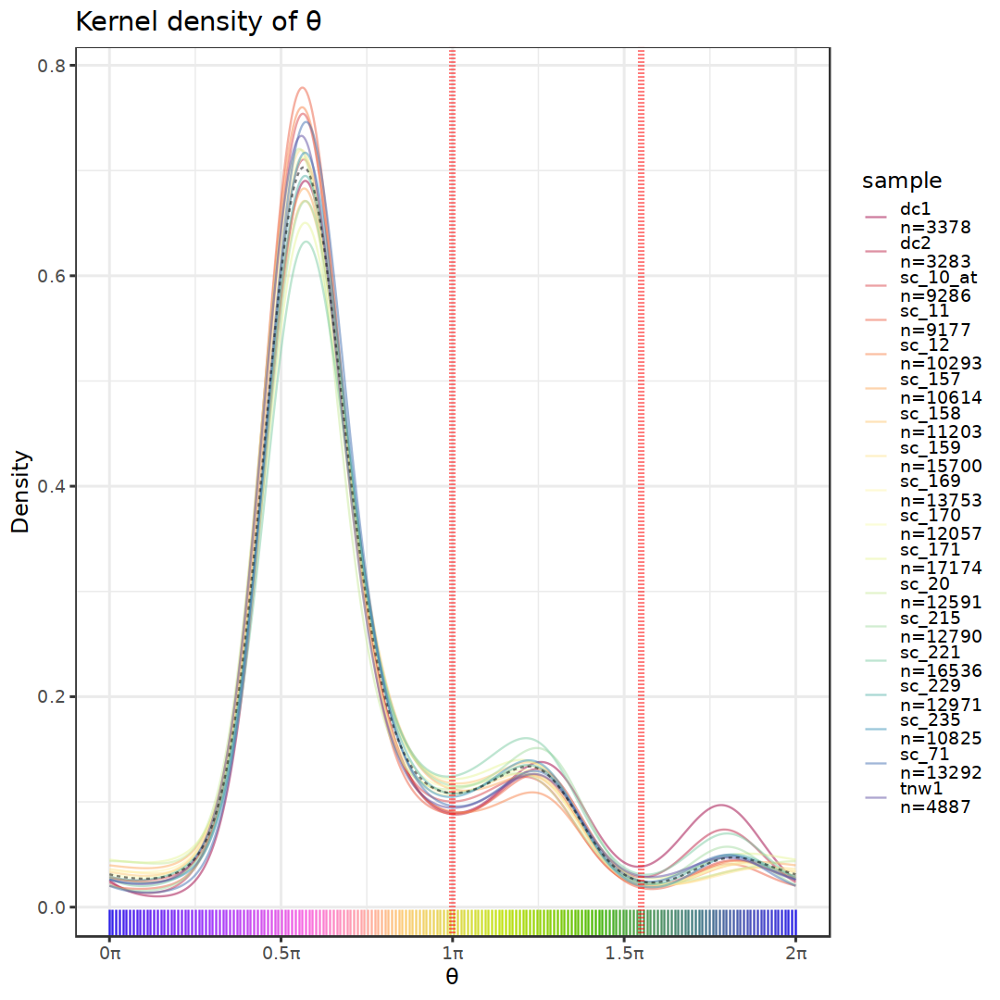

In [16]:
## Tricycle estimation
sce <- project_cycle_space(sce,ref.m = new.ref)
sce <- estimate_cycle_position(sce)

sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
sce$tricyclePosition <- sce$tricyclePosition*pi

## Plot
options(repr.plot.width=9, repr.plot.height=9)
print(plot_ccposition_den(sce$tricyclePosition,
                sce$orig.ident, 'sample',
                bw = 10, fig.title = "Kernel density of \u03b8", palette.v=colorRampPalette(brewer.pal(11, "Spectral"))(18)) +
  theme_bw(base_size = 14)+ geom_vline(xintercept = 1*pi, linetype="dotted", 
                color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
                color = "red", size=1.5))

In [85]:
## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    rc.integrated$tricyclePosition <- sce$tricyclePosition
    rc.integrated$tricycleCCStage <- tricycleCCStage

In [92]:
saveRDS(rc.integrated,"./scRNA-seq/Integrated_Objects/rc.integrated_18S_WT_cell_cycle_seu4_245genes_Goldy_Zhang_AMIGO_20230825.rds")

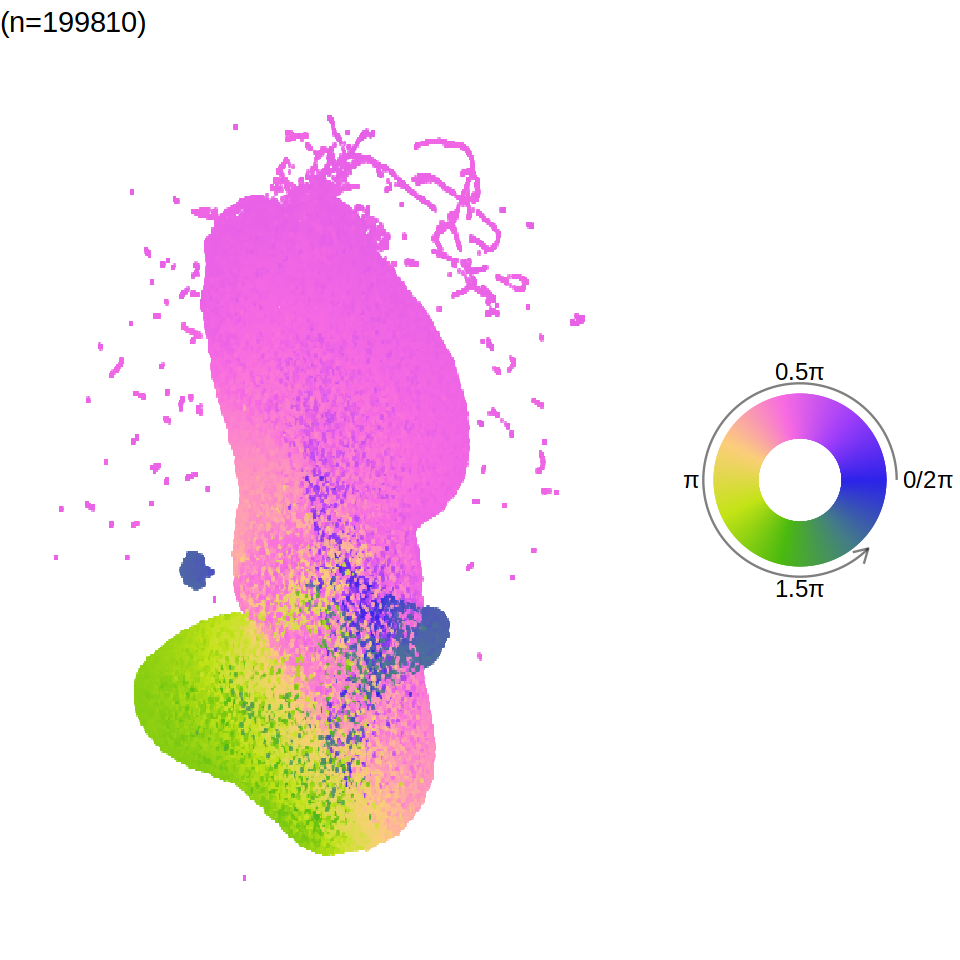

In [86]:
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 1, point.alpha = 0.9) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



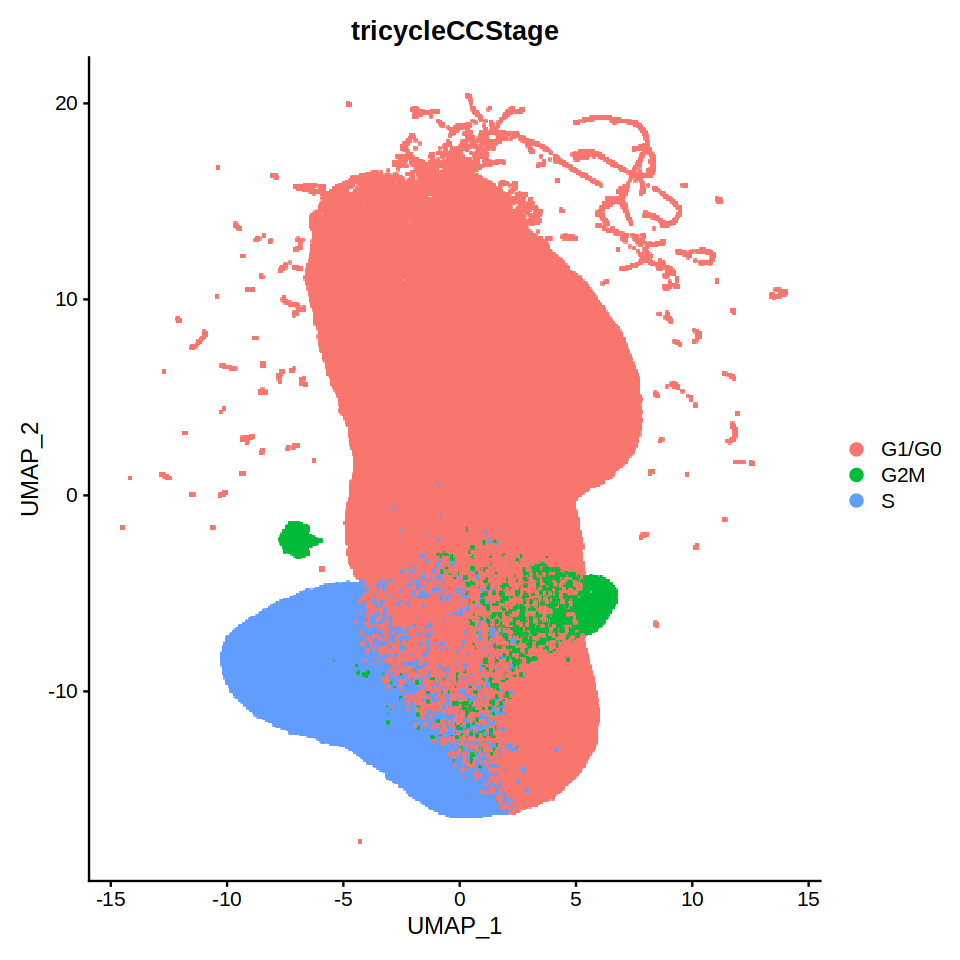

In [87]:
DimPlot(rc.integrated, reduction="umap", group = "tricycleCCStage", pt.size=1,order=FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



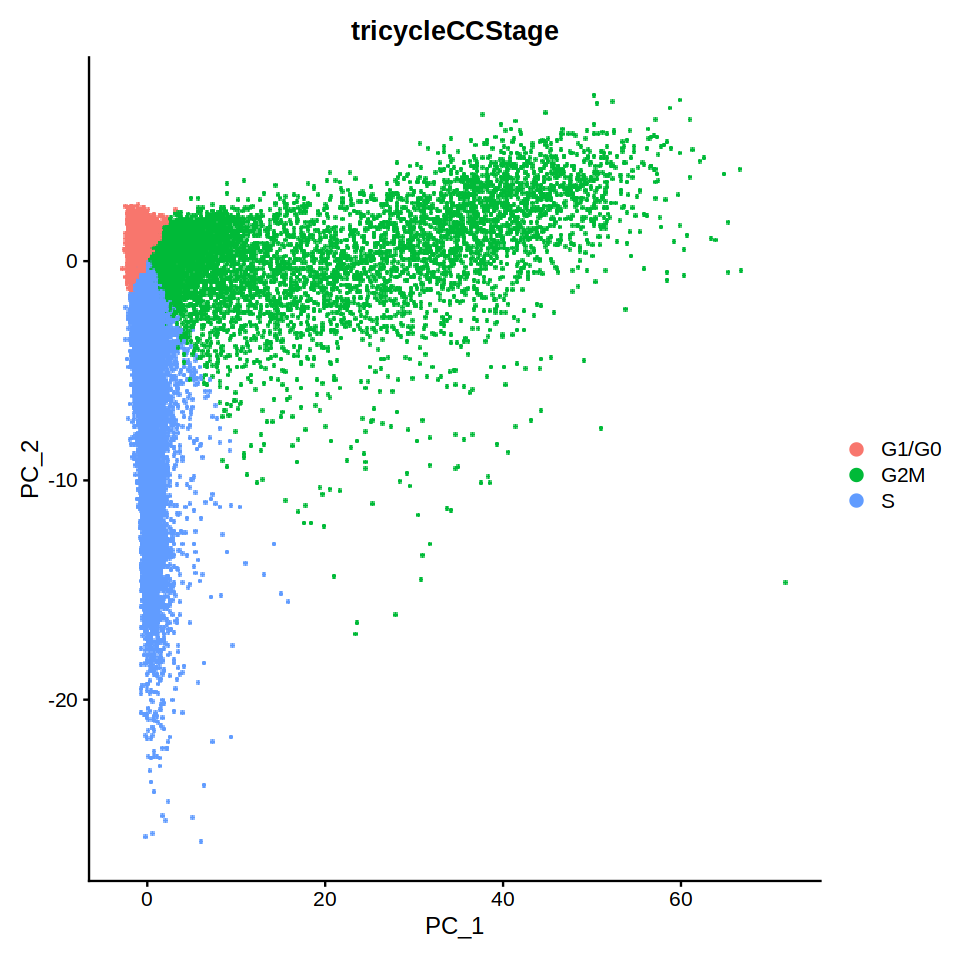

In [88]:
DimPlot(rc.integrated, reduction="pca", group = "tricycleCCStage", pt.size=1,order=FALSE)

In [89]:
rc.integrated$CCclust <- rep("others", ncol(rc.integrated))
rc.integrated$CCclust[which(rc.integrated$seurat_clusters==0)] = "S"
rc.integrated$CCclust[which(rc.integrated$seurat_clusters==4)] = "G2M"
table(rc.integrated$tricycleCCStage, rc.integrated$CCclust)

       
           G2M others      S
  G1/G0    920 154117   1510
  G2M     6101   4126    117
  S        143  20007  12769

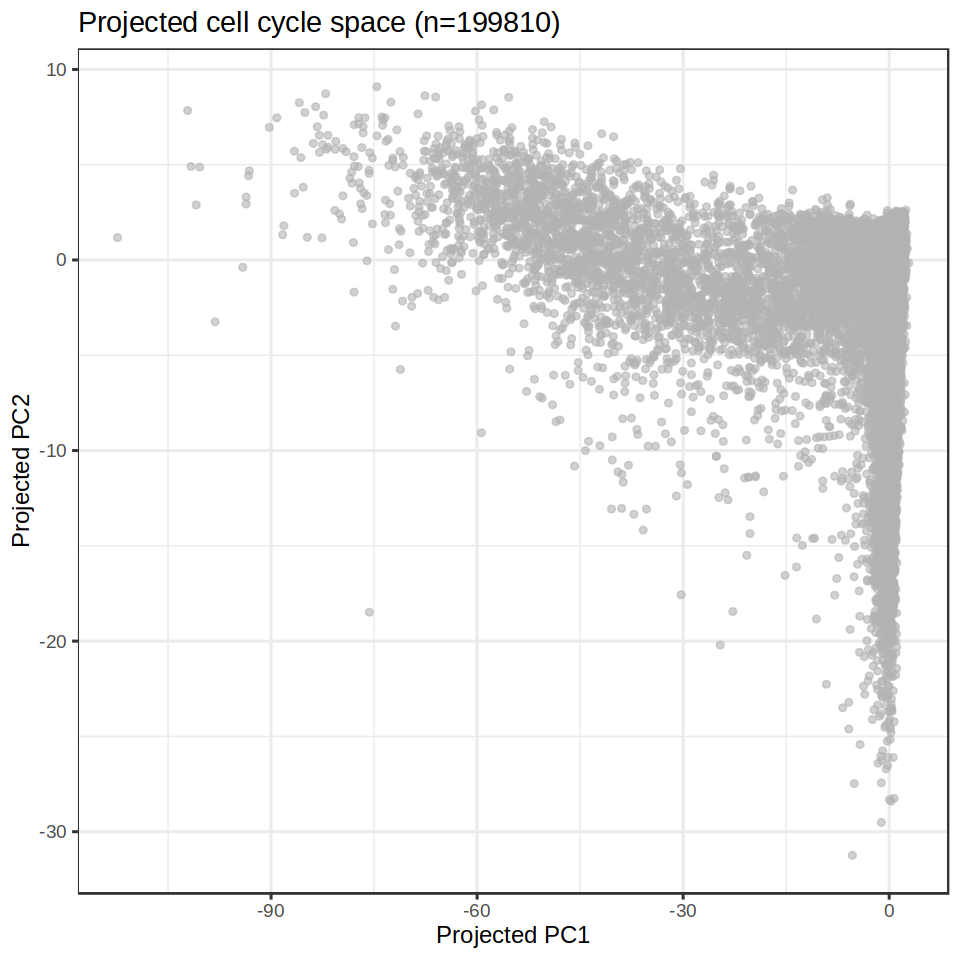

In [90]:
scater::plotReducedDim(sce, dimred = "tricycleEmbedding") +
    labs(x = "Projected PC1", y = "Projected PC2") +
    ggtitle(sprintf("Projected cell cycle space (n=%d)",
                    ncol(sce))) +
    theme_bw(base_size = 14)

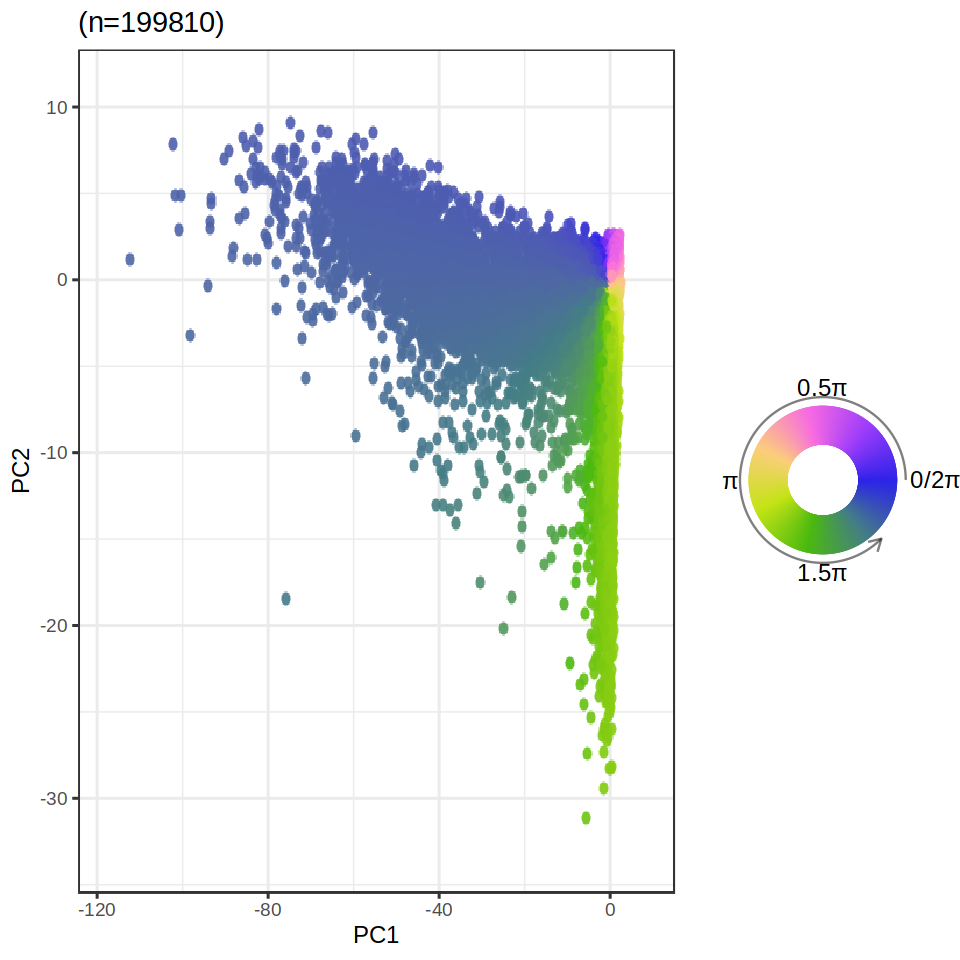

In [91]:
p <- plot_emb_circle_scale(sce, dimred = "tricycleEmbedding",
                           point.size = 3.5, point.alpha = 0.9) +
  theme_bw(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.4))

In [ ]:
## Total RNA content
#fit.l <- fit_periodic_loess(sce$tricyclePosition,
#                            log2(sce$nCount_RNA),
#                            plot = TRUE, span=0.3,
#                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(Total UMIs)",
#                       fig.title = paste0("Expression of key gene along \u03b8 (n=",
#                                          ncol(sce), ")"))

#fit <- fit.l$pred.df
#options(repr.plot.width=8, repr.plot.height=6)
#ggplot(fit, aes(x=x,y=y)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "log2(total UMIs)", title = "") + 
#            scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
#                pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
#                0.5, 1, 1.5, 2), "π"), name = "θ")+
#  theme_bw(base_size = 14)+
#  theme(legend.title=element_blank())

In [11]:
table(rc.integrated$time.anno.Li)


         Distal Columella   Distal Lateral Root Cap                Elongation 
                     6526                      4904                     83690 
               Maturation      Proliferation Domain        Proximal Columella 
                    21054                     21913                      3063 
Proximal Lateral Root Cap         Transition Domain 
                    27495                     31165 

In [12]:
sub <- subset(rc.integrated, cells=colnames(rc.integrated)[which(rc.integrated$time.anno.Li=="Proliferation Domain"|
                                                                rc.integrated$time.anno.Li=="Proximal Columella"|
                                                                rc.integrated$time.anno.Li=="Proximal Lateral Root Cap")])

In [13]:
sub

An object of class Seurat 
57118 features across 52471 samples within 3 assays 
Active assay: integrated (245 features, 245 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, umap_2D

In [14]:
table(sub$time.anno.Li)


     Proliferation Domain        Proximal Columella Proximal Lateral Root Cap 
                    21913                      3063                     27495 

In [15]:
# Run PCA
sub <- RunPCA(sub, npcs = 10, verbose = FALSE, approx = TRUE)

# Find nearest neighbors
#rc.integrated <- FindNeighbors(rc.integrated, reduction = "pca",dims = 1:50)

Warning message:
“Number of dimensions changing from 50 to 10”
Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
20:27:45 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

20:27:45 Read 52471 rows and found 5 numeric columns

20:27:45 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

20:27:45 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

In [23]:
# Run 2D UMAP
sub <- RunUMAP(sub, reduction = "pca", dims = 1:3, n.neighbors = 30, min.dist=0.3)

20:40:15 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

20:40:15 Read 52471 rows and found 3 numeric columns

20:40:15 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'spam'

Also defined by ‘BiocGenerics’

20:40:15 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:40:28 Writing NN index file to temp file /tmp/Rtmpu0VjyG/file317db92623cbe

20:40:28 Searching Annoy index using 1 thread, search_k = 3000

20:40:57 Annoy recall = 100%

20:40:59 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

20:41:00 18 smooth knn distance failures

20:41:06

In [49]:
my_cols = brewer.pal(8,"Set2")

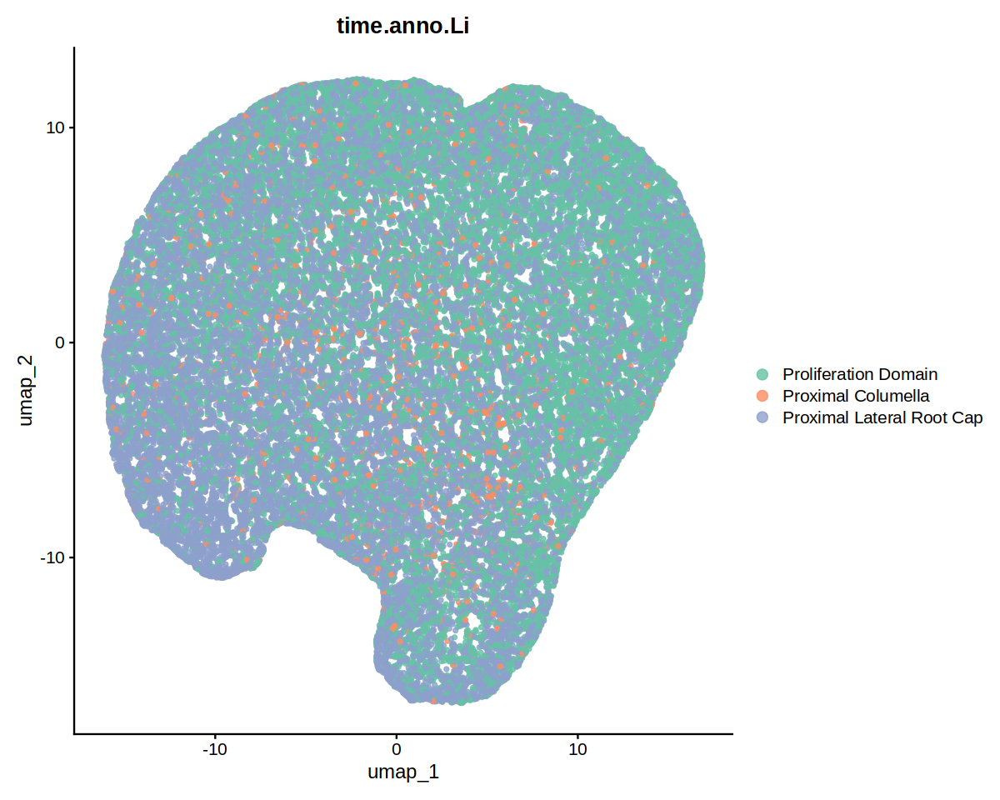

In [50]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(sub, reduction = "umap", group.by = "time.anno.Li",cols=alpha(my_cols,0.8), label = FALSE, pt.size=1)

In [24]:
sce <- as.SingleCellExperiment(sub)

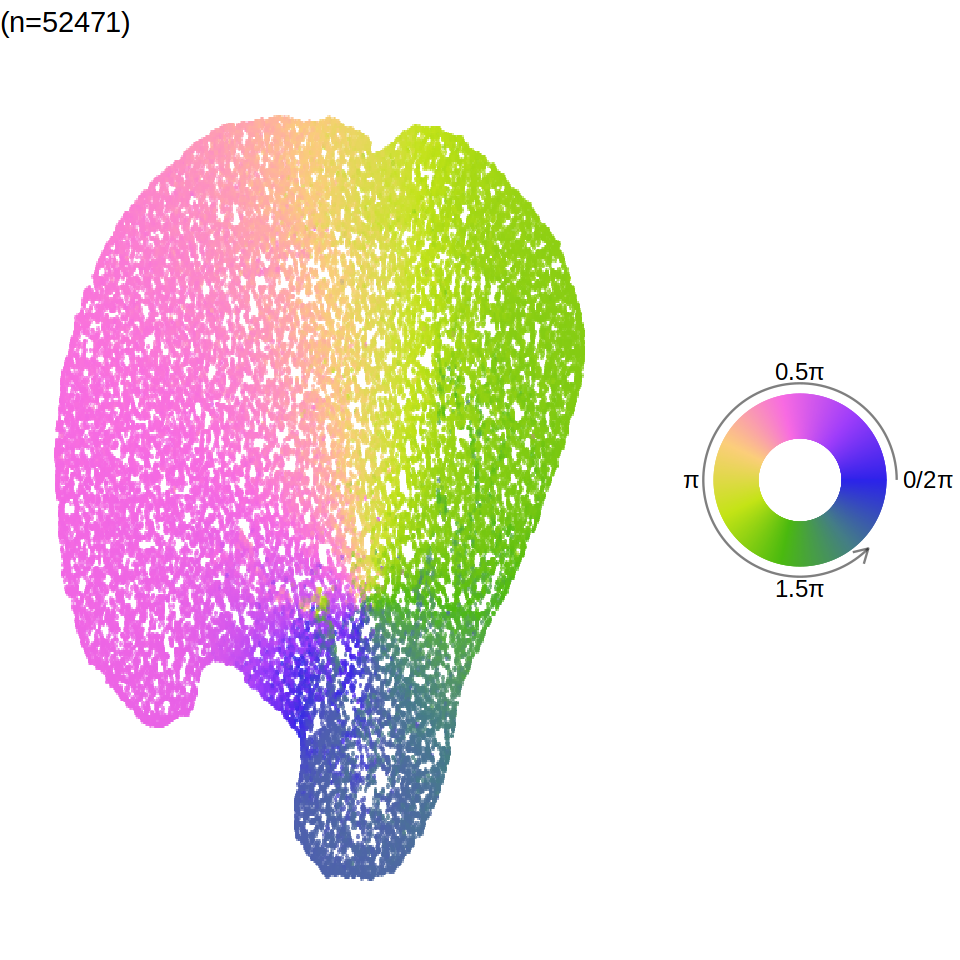

In [30]:
# dims = 3
options(repr.plot.width=8, repr.plot.height=8)
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 2, point.alpha = 0.8) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

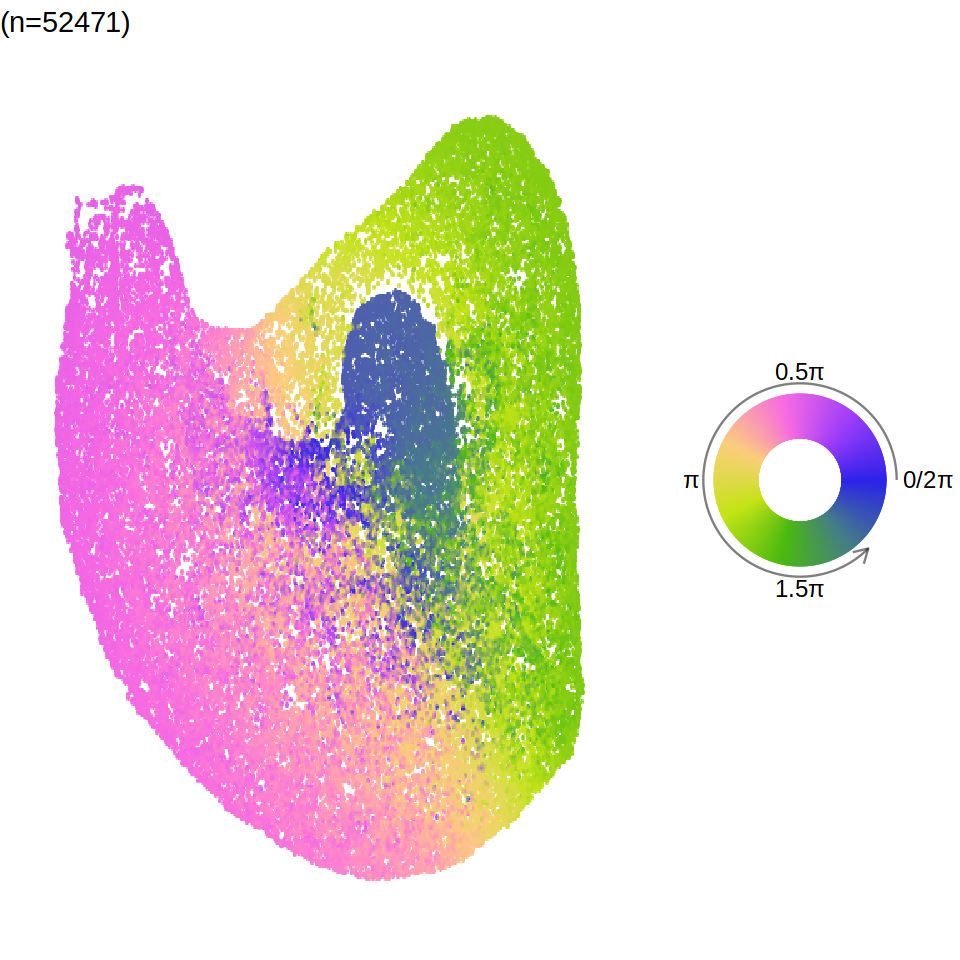

In [22]:
# dims = 4
options(repr.plot.width=8, repr.plot.height=8)
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 2, point.alpha = 1) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

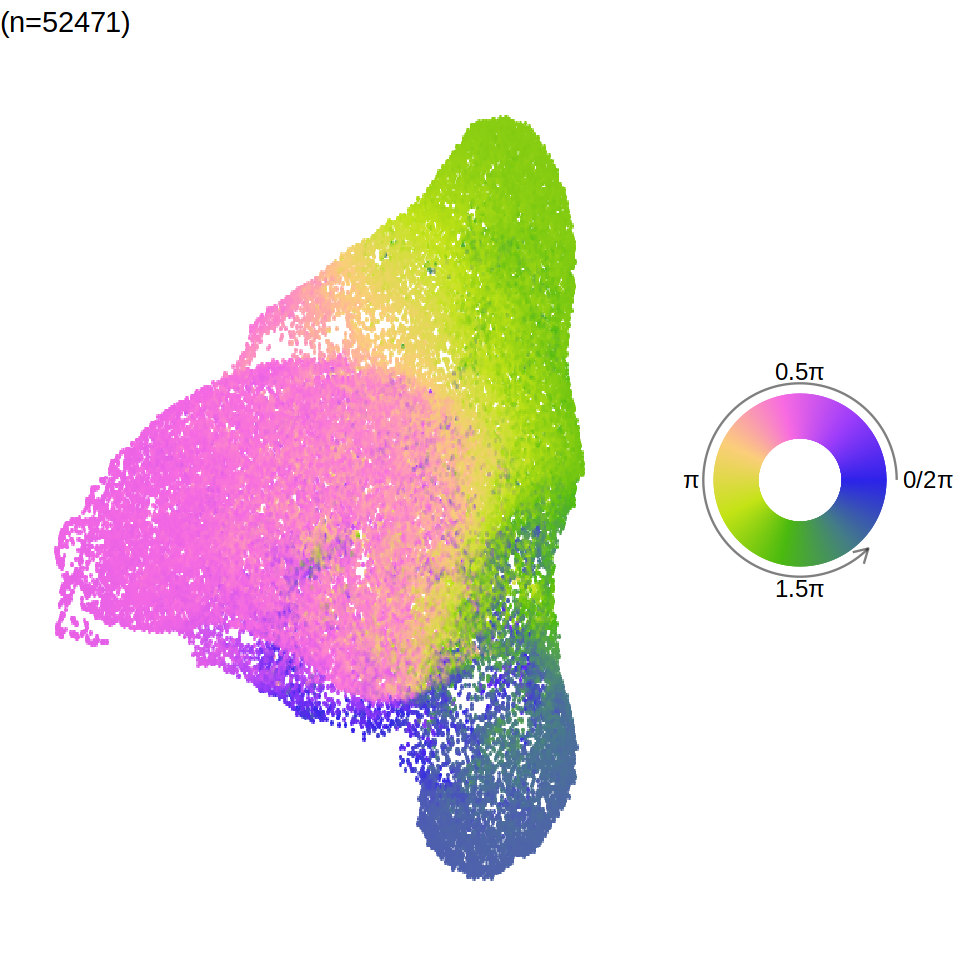

In [19]:
# dims = 5
options(repr.plot.width=8, repr.plot.height=8)
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 2, point.alpha = 1) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

In [ ]:
# dims = 5
options(repr.plot.width=8, repr.plot.height=8)
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 2, point.alpha = 1) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

## Tricycle inference

In [91]:
run_tricycle <- function(sample){
    seu <- readRDS(paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT.rds"))
    sce <- as.SingleCellExperiment(seu)
    
    ## Tricycle estimation
    sce <- project_cycle_space(sce,ref.m = new.ref)
    sce <- estimate_cycle_position(sce)
    
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage
    
    ## Tricycle position on umap
    p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                           point.size = 1, point.alpha = 0.9) +
      theme_void(base_size = 14)
    legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
    print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))
    
    ## Write annotations as csv
    write.csv(seu@meta.data[,c("tricyclePosition", "tricycleCCStage")], paste0("./tricycle/",sample,".csv"), quote=FALSE)
    #saveRDS(seu,paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT_seu4.rds"))
}

In [92]:
sample.list <- c("sc_130","sc_131","sc_132","sc_133","sc_134","sc_135","sc_136","sc_137")

The number of projection genes found in the new data is 230.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


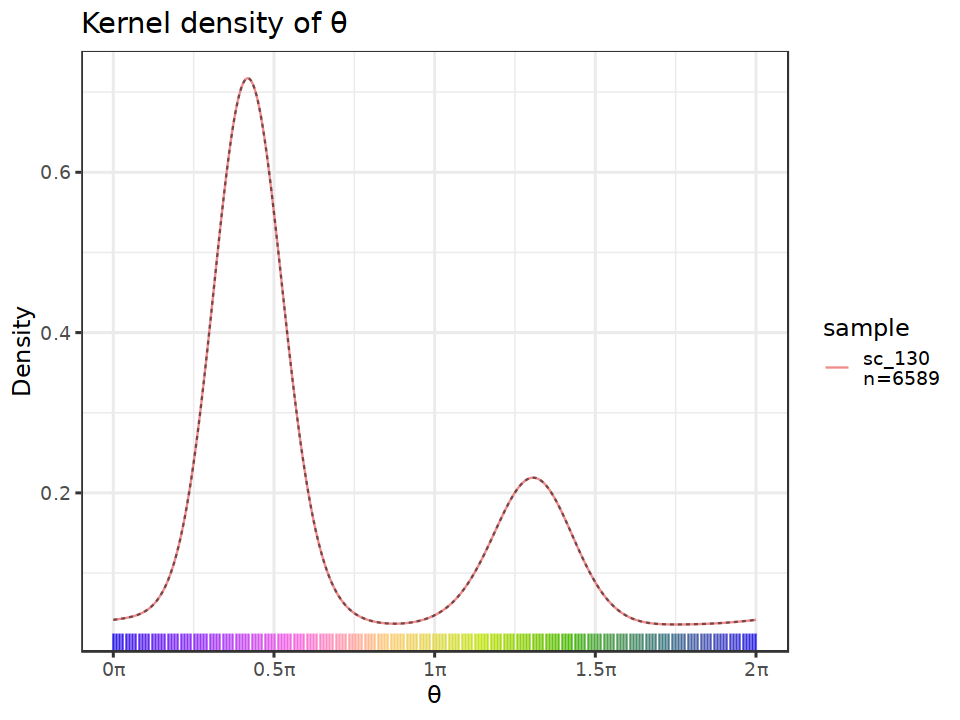

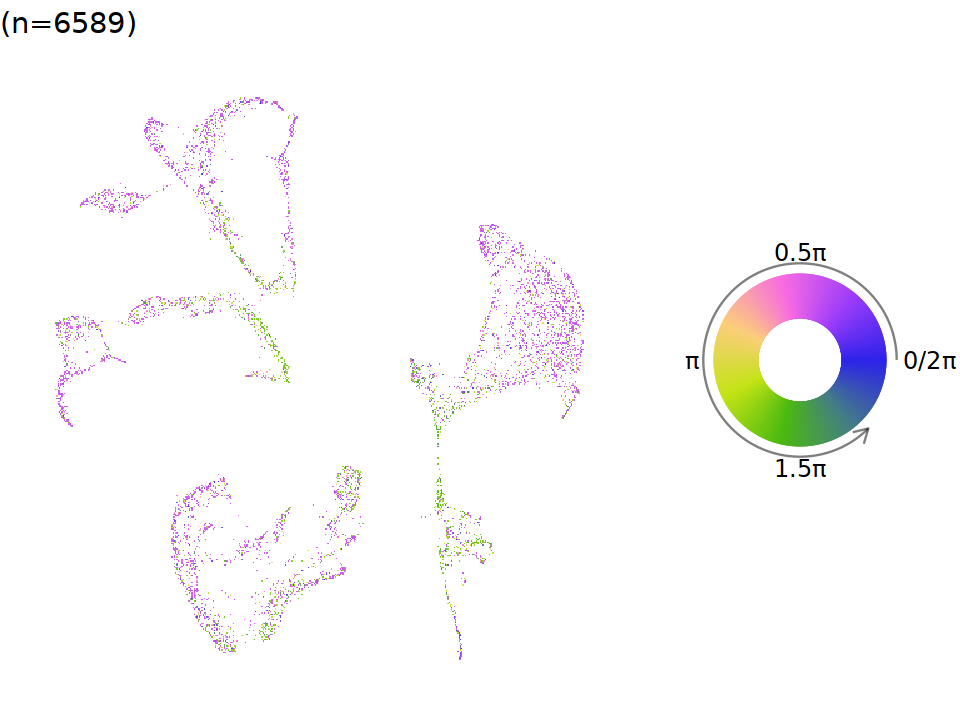

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


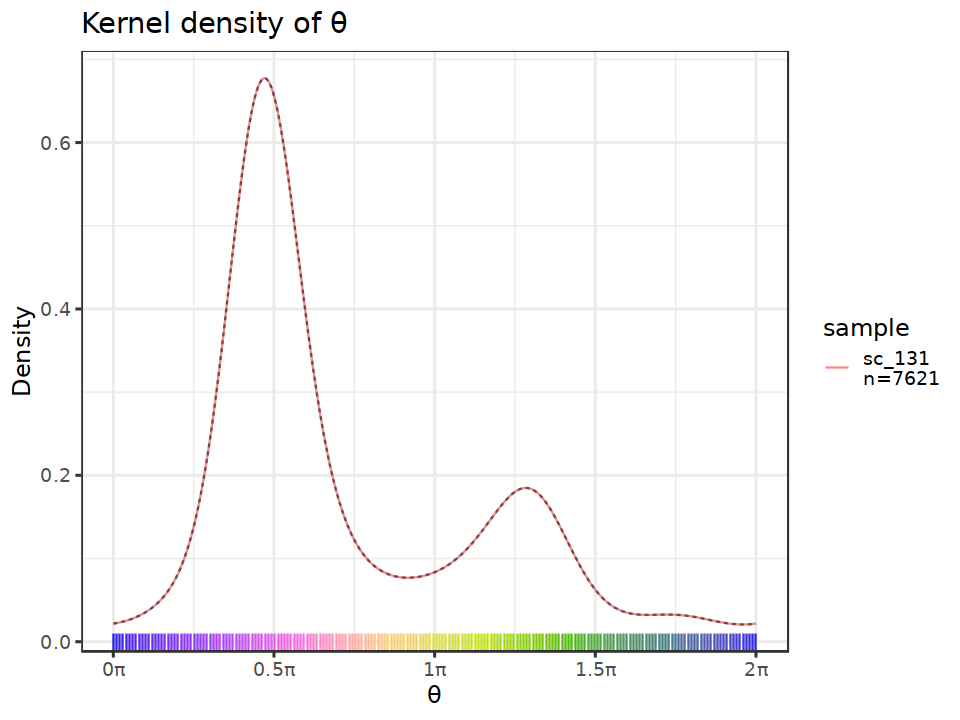

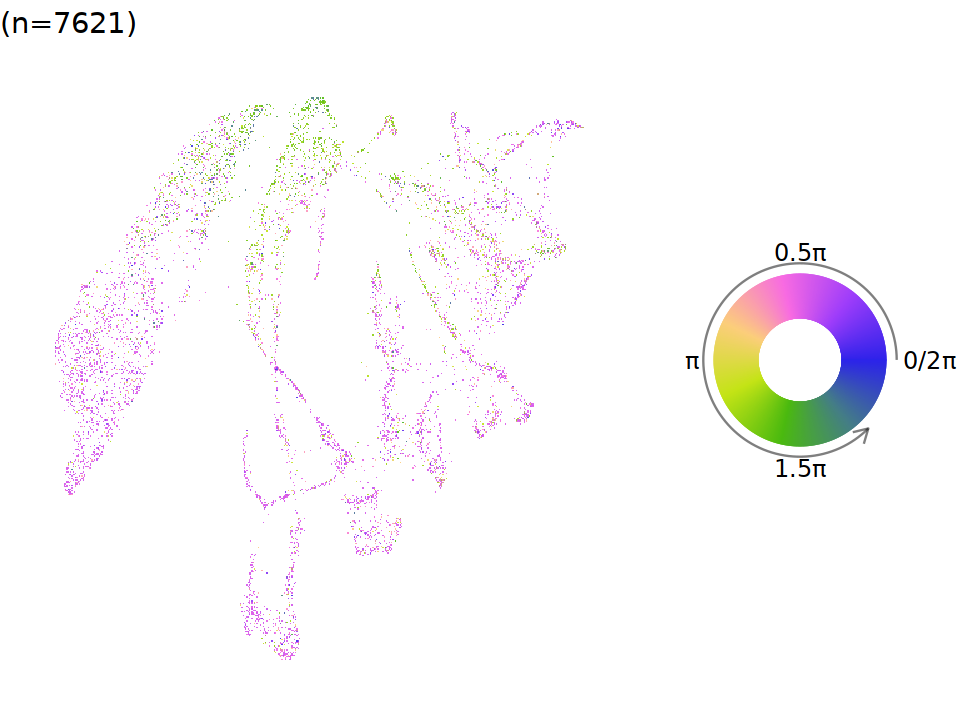

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


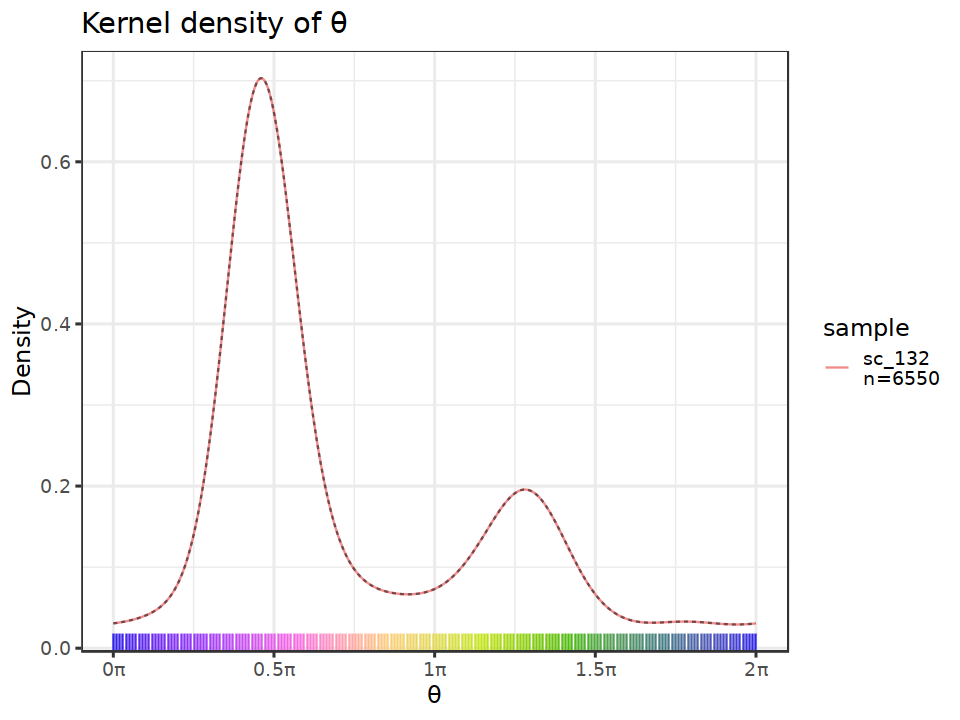

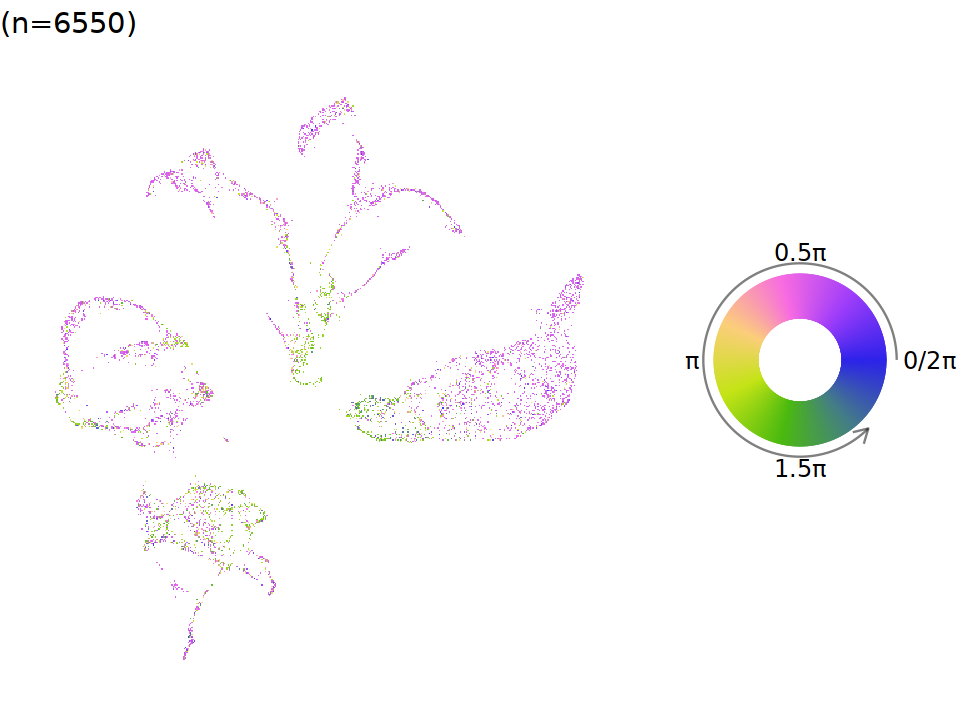

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


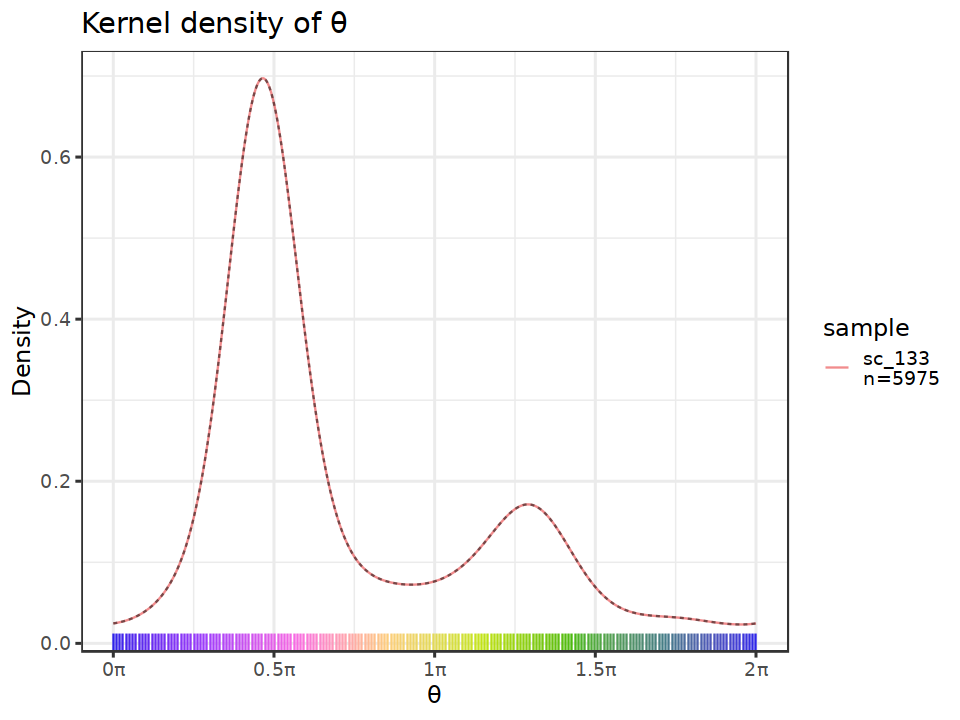

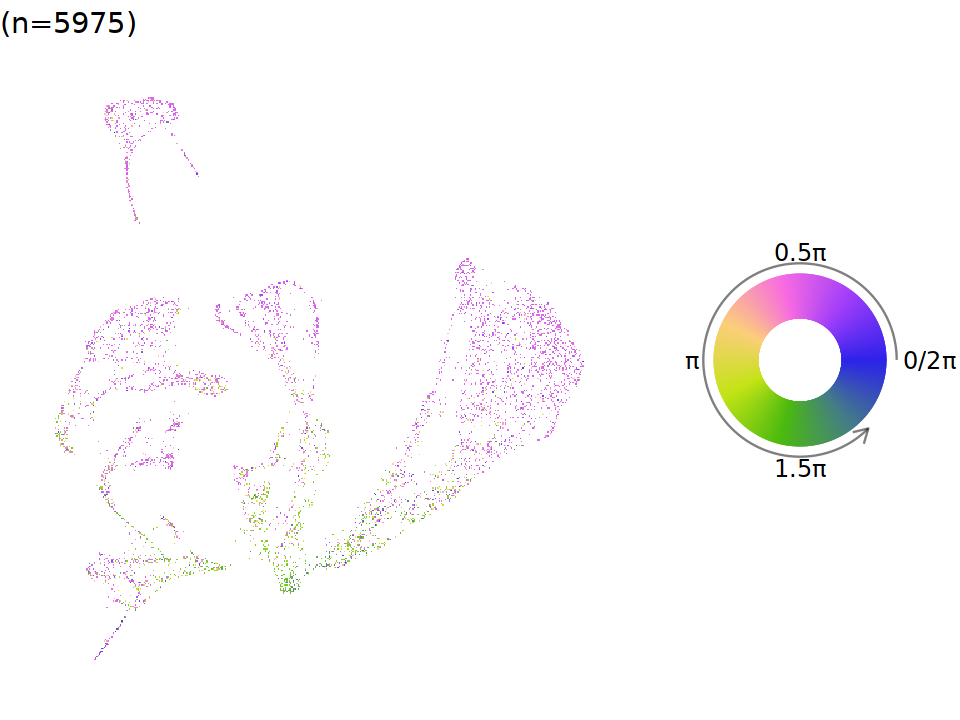

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


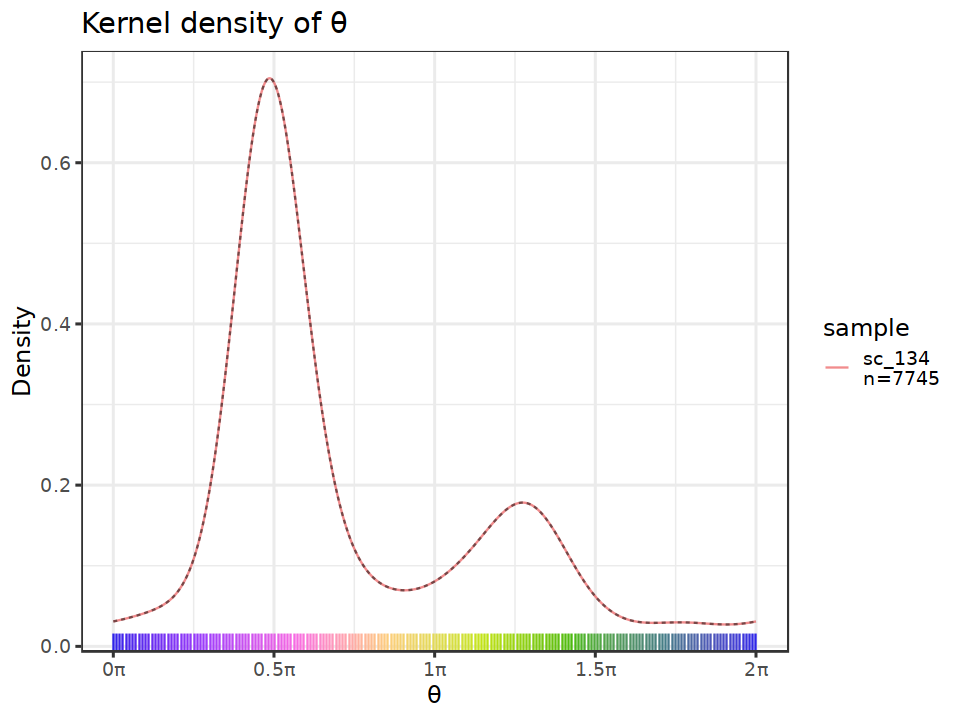

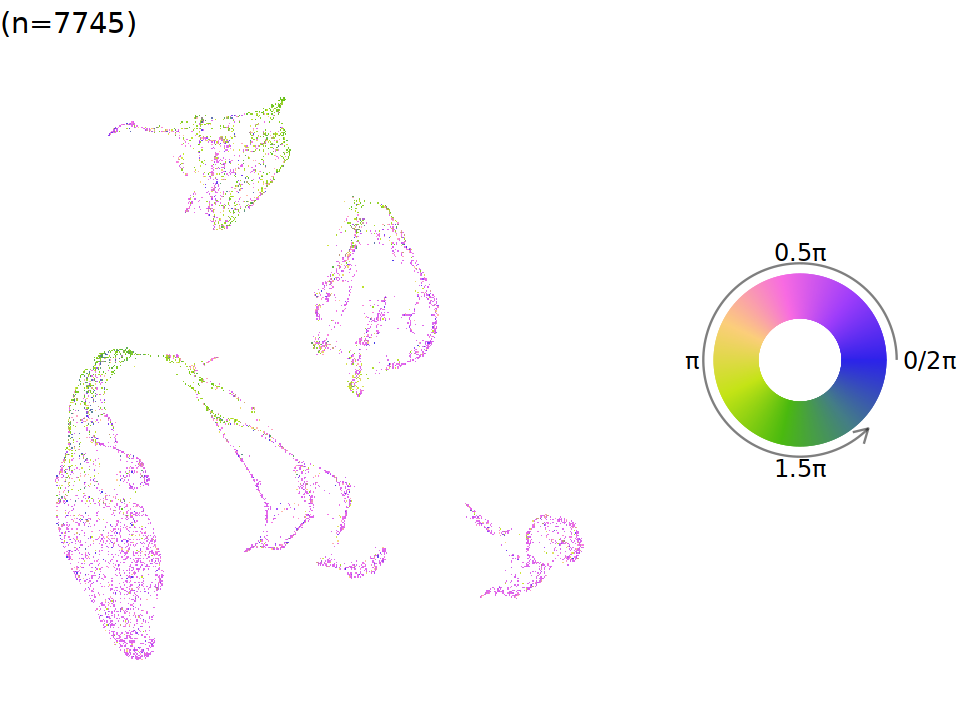

The number of projection genes found in the new data is 237.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


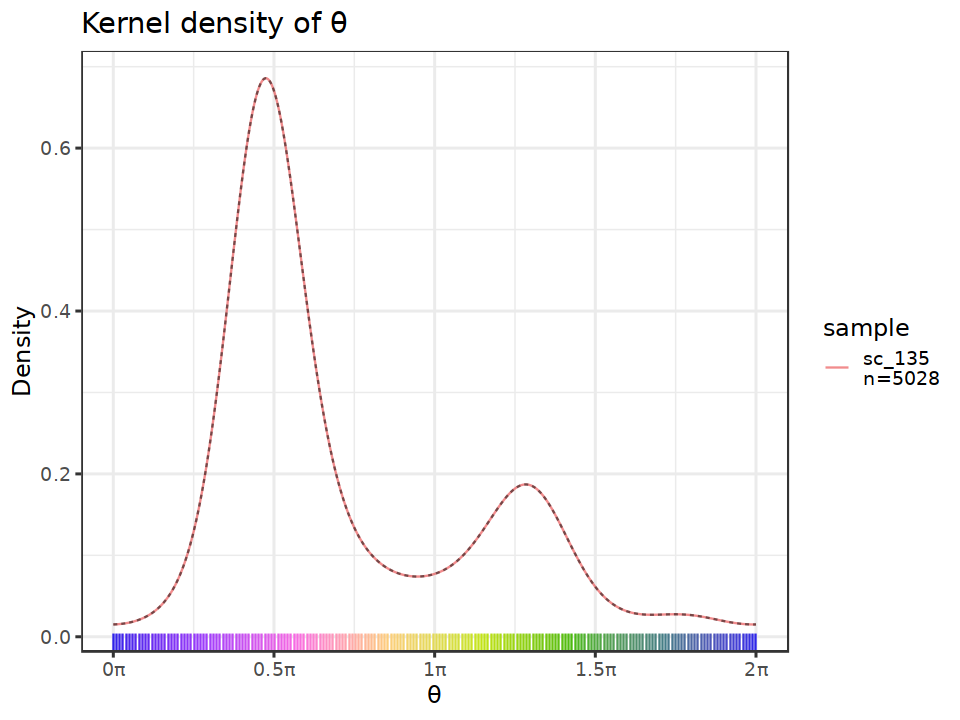

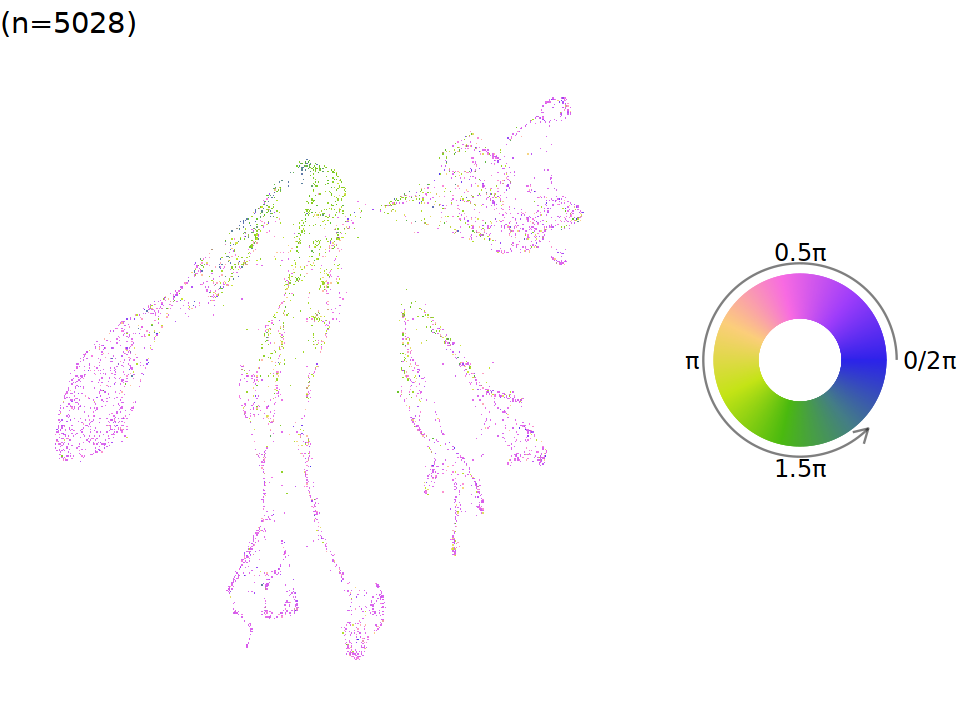

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


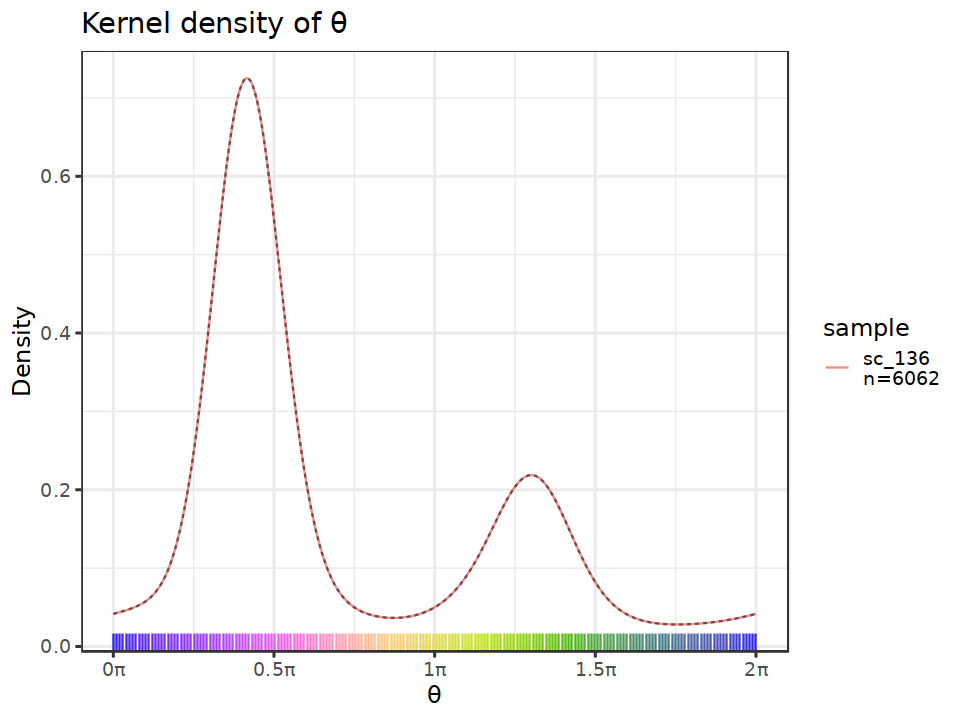

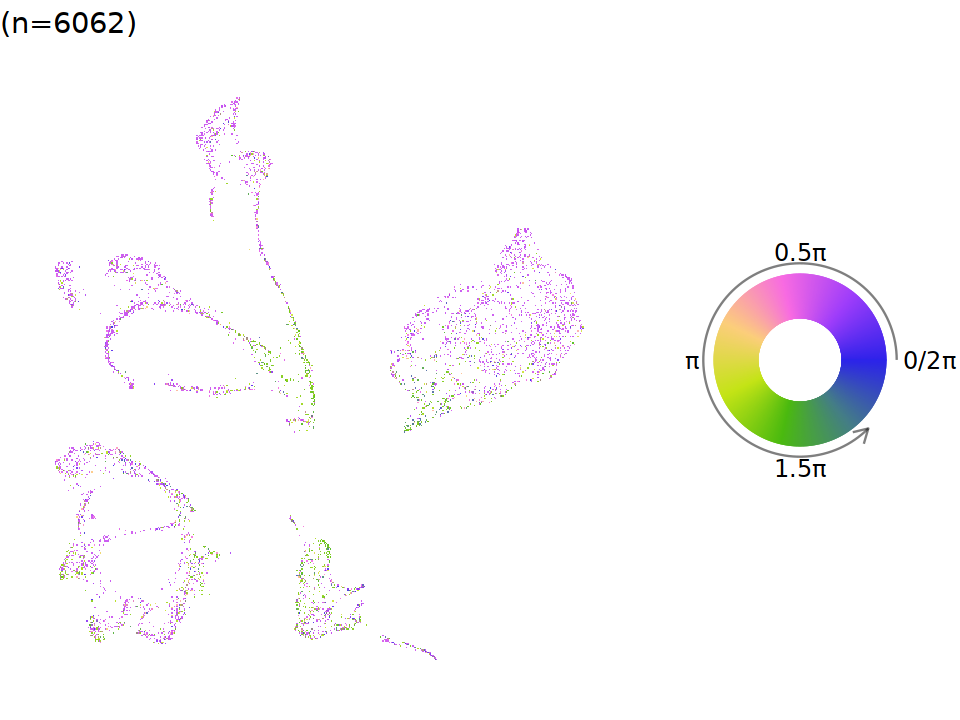

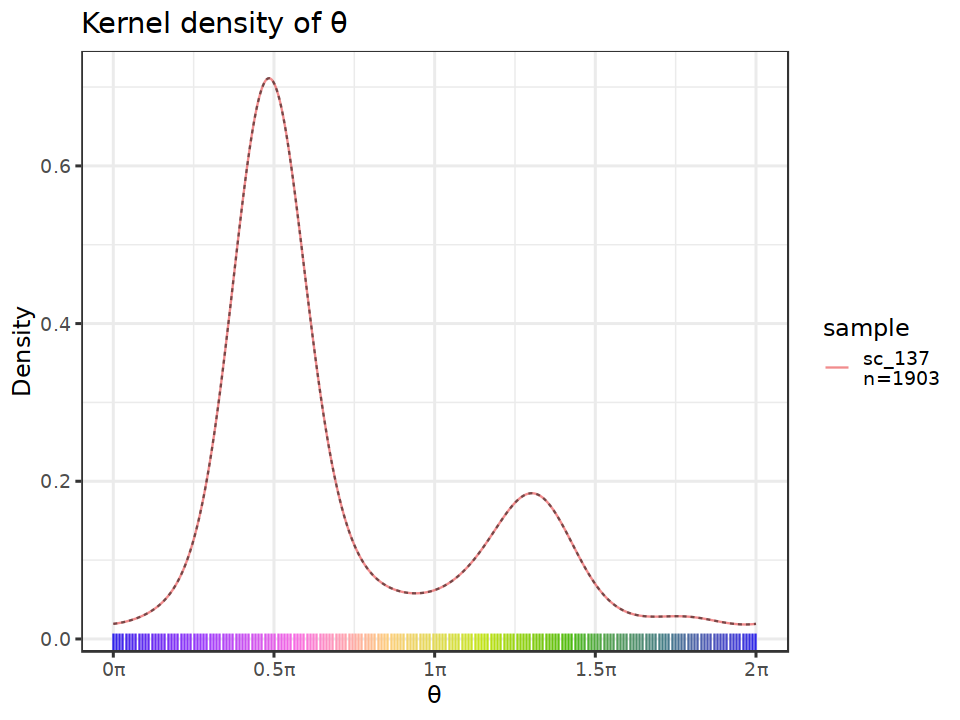

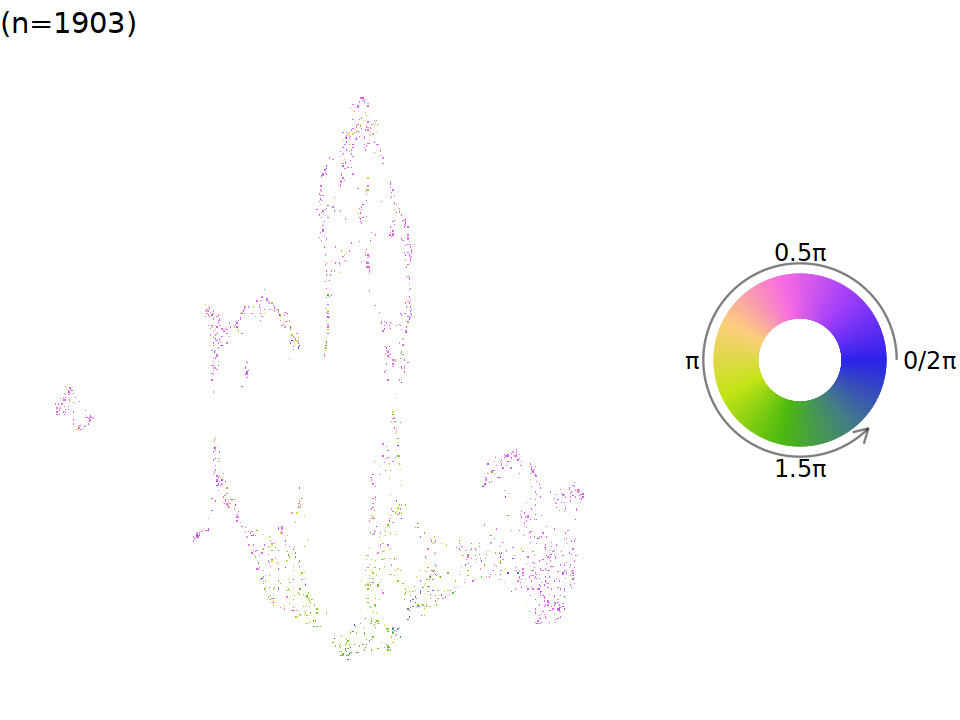

In [93]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

In [94]:
sample.list <- c("sc_5")

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


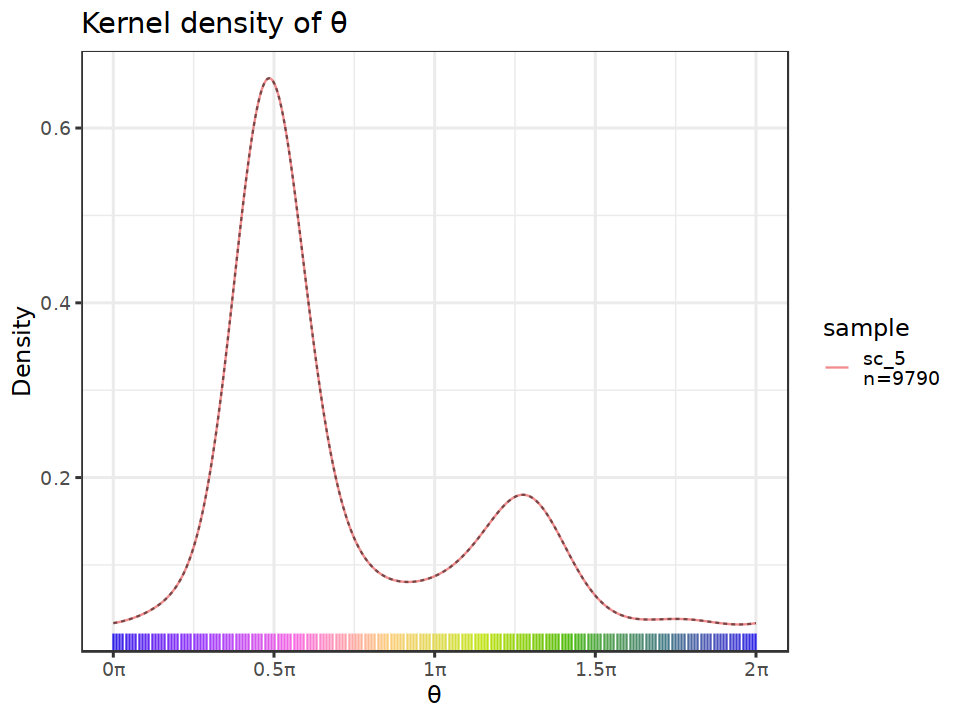

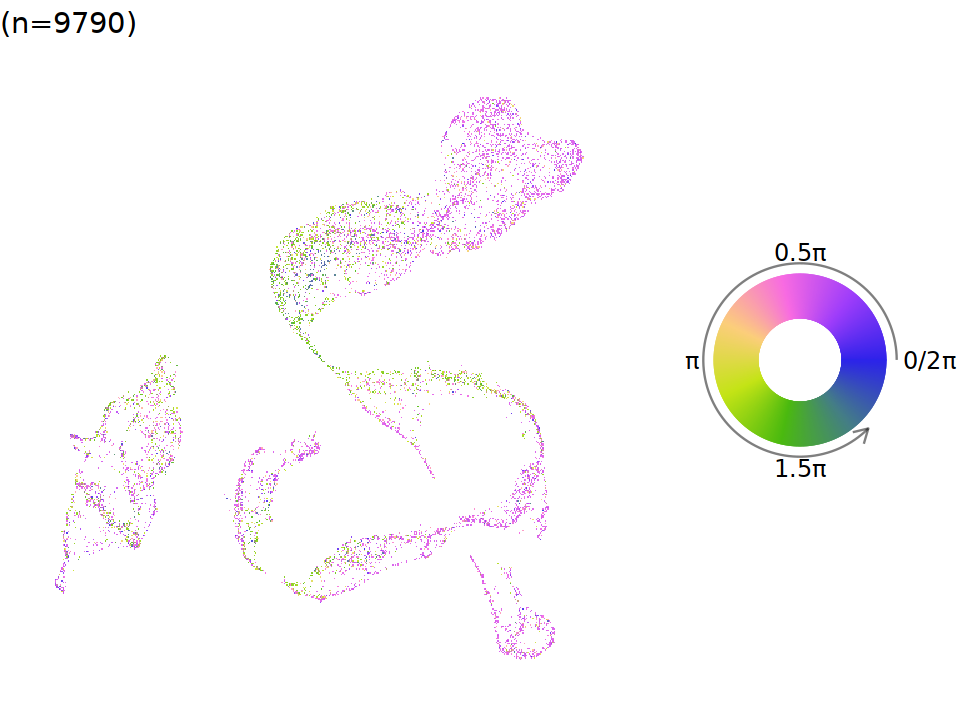

In [95]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

In [96]:
sample.list <- c("sc_1","sc_2","sc_111","sc_112","sc_113","sc_114")

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


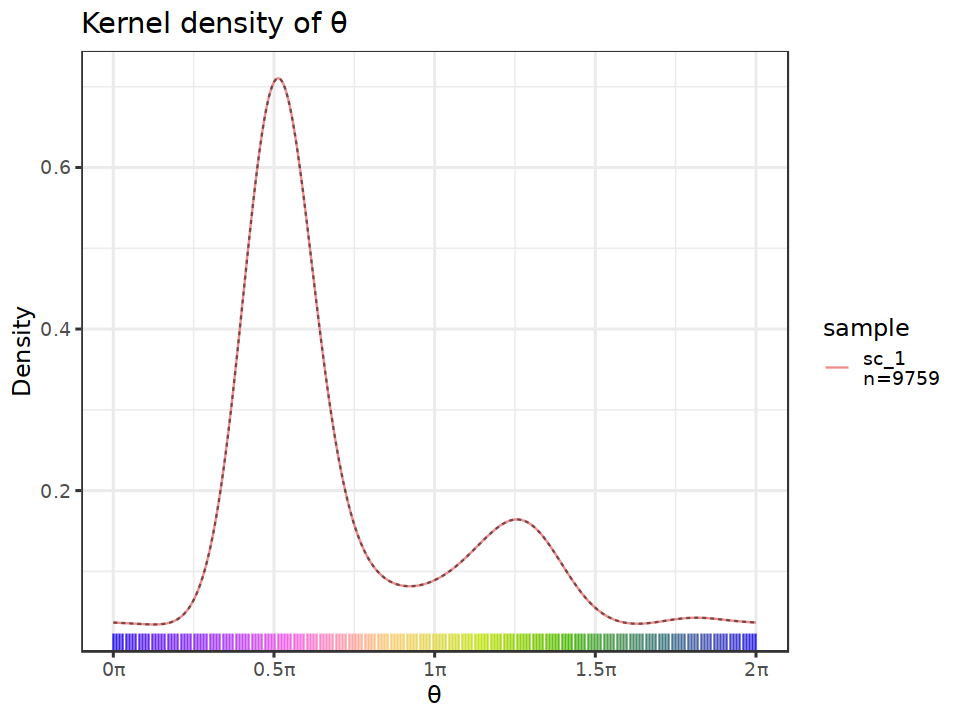

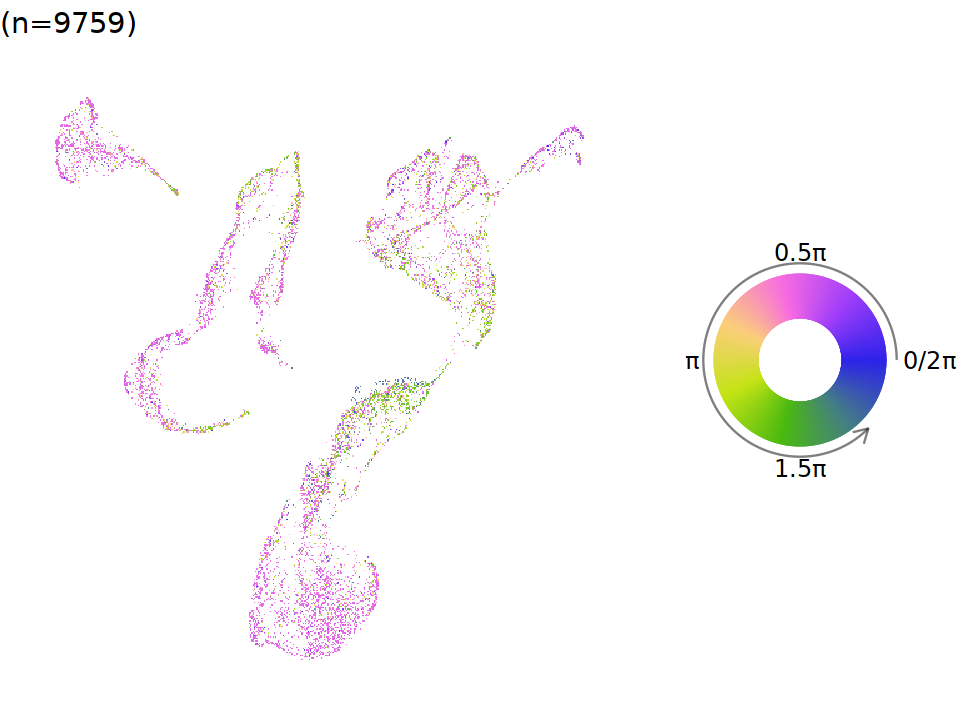

The number of projection genes found in the new data is 243.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


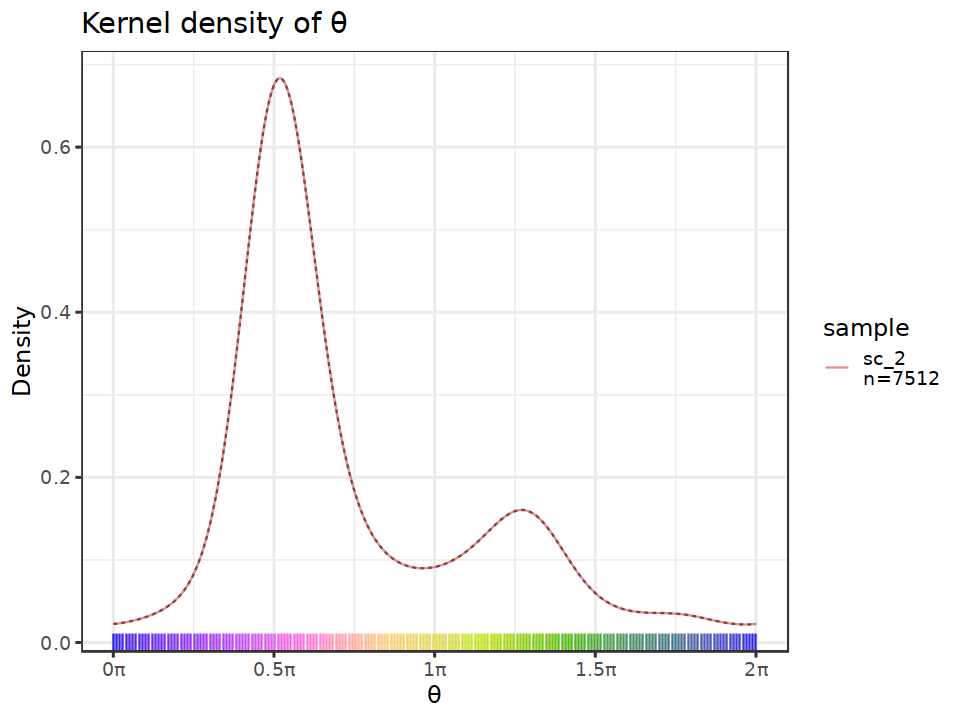

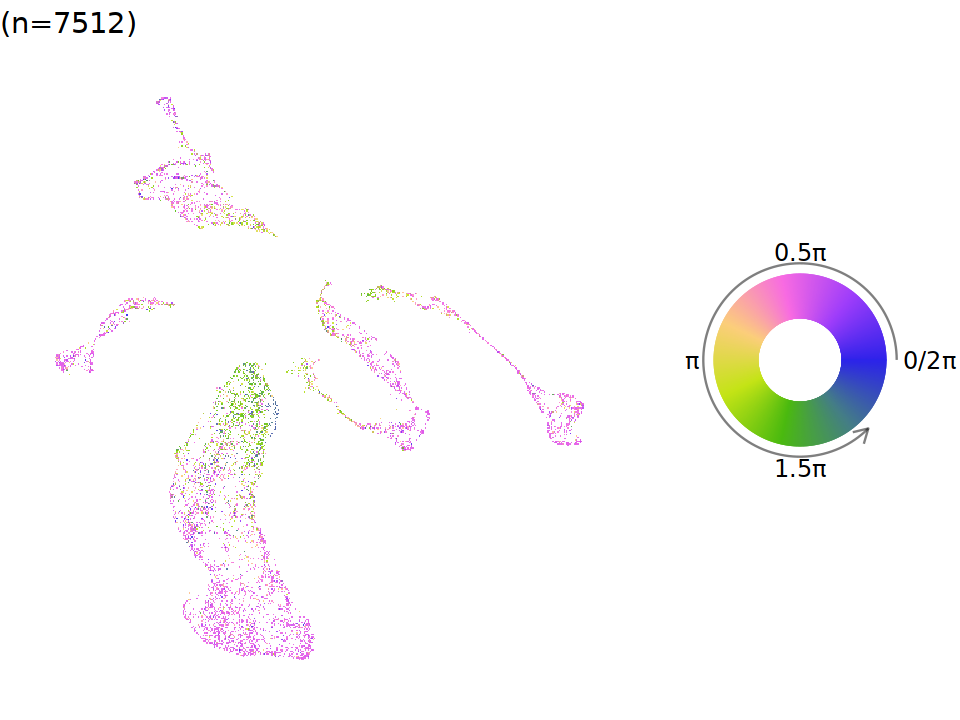

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


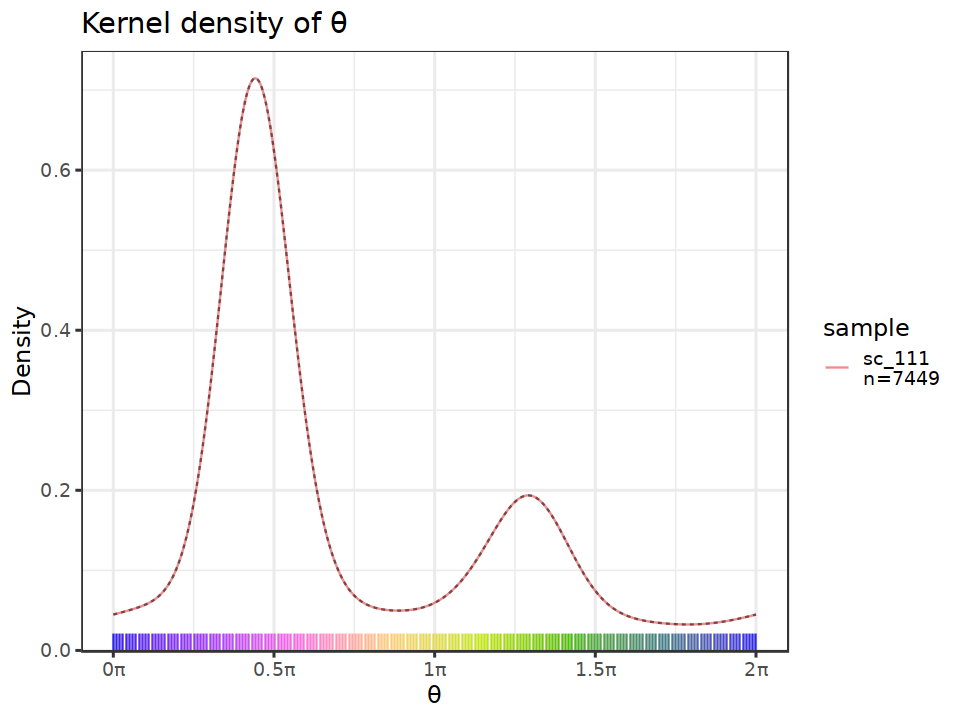

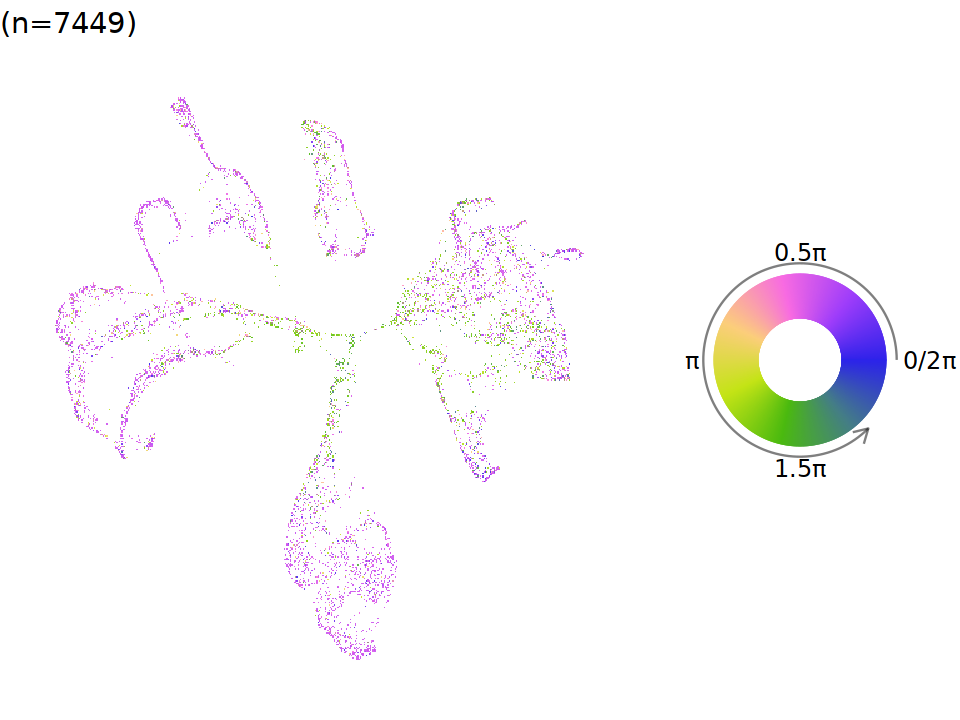

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


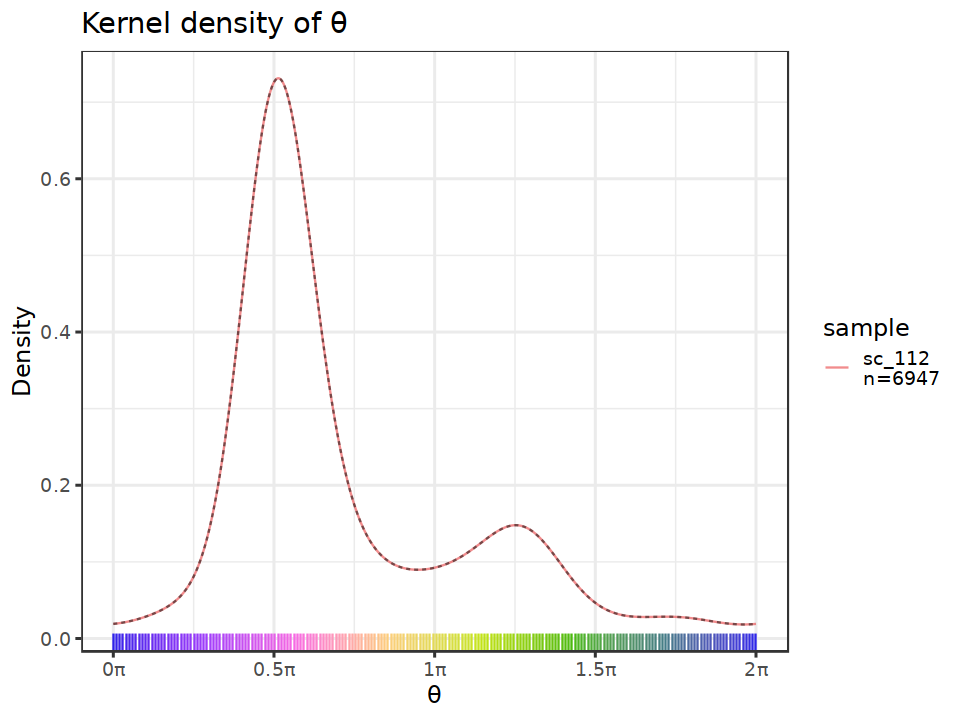

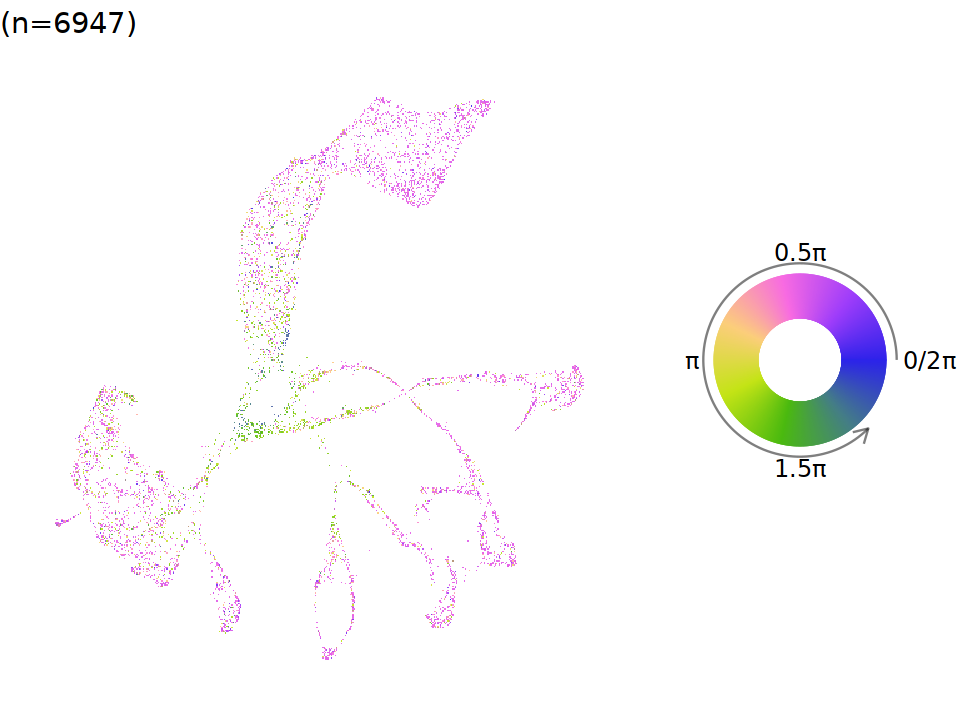

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


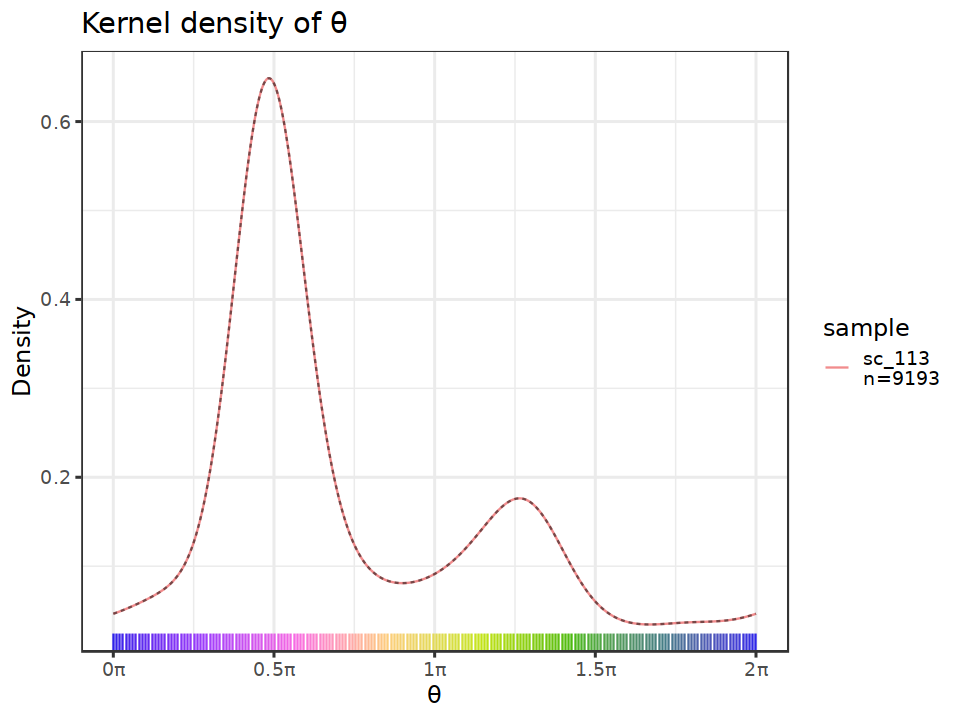

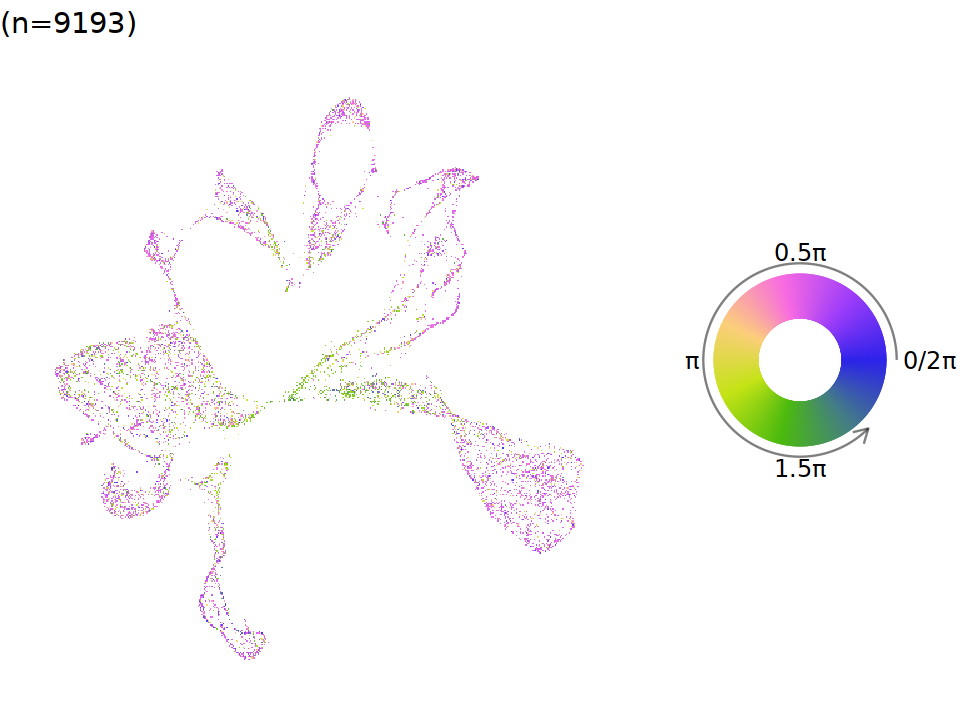

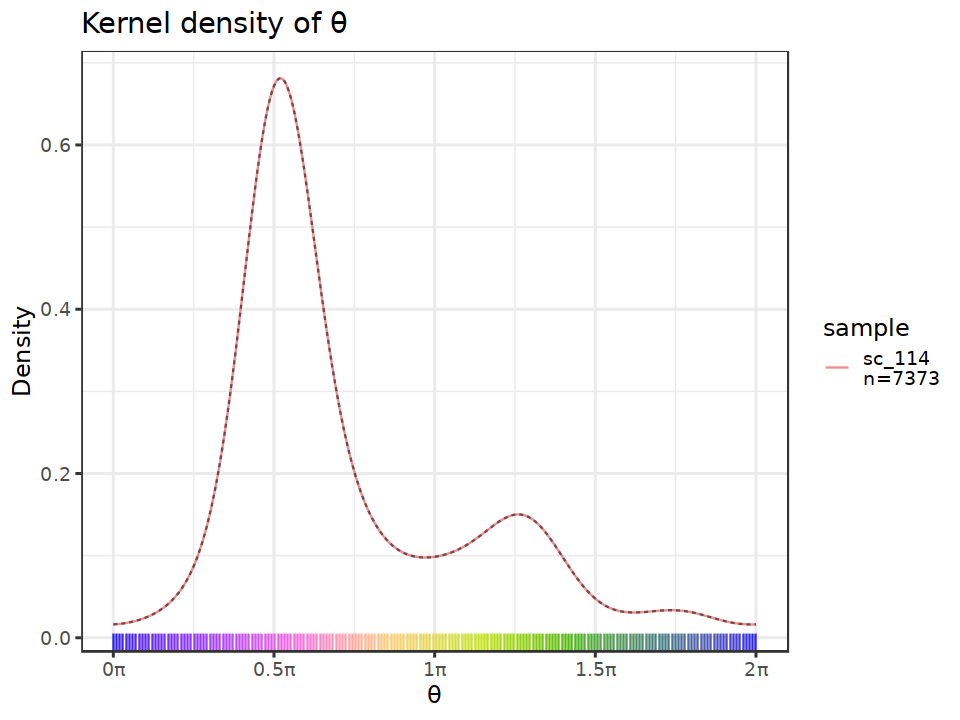

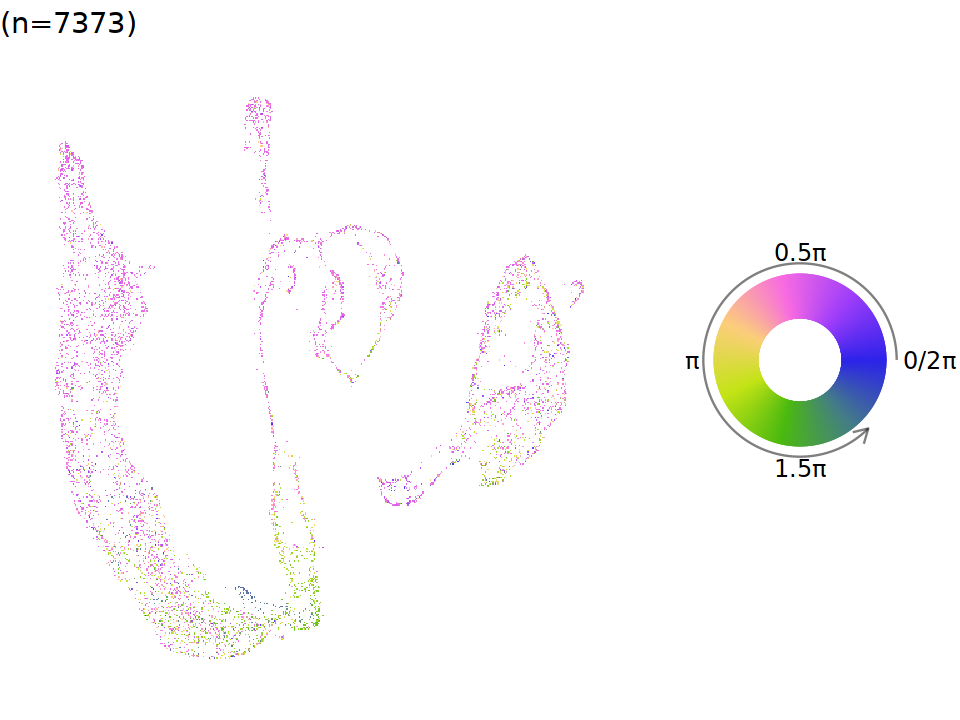

In [97]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

In [98]:
sample.list <- c("sc_151","sc_152","sc_153","sc_154")

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


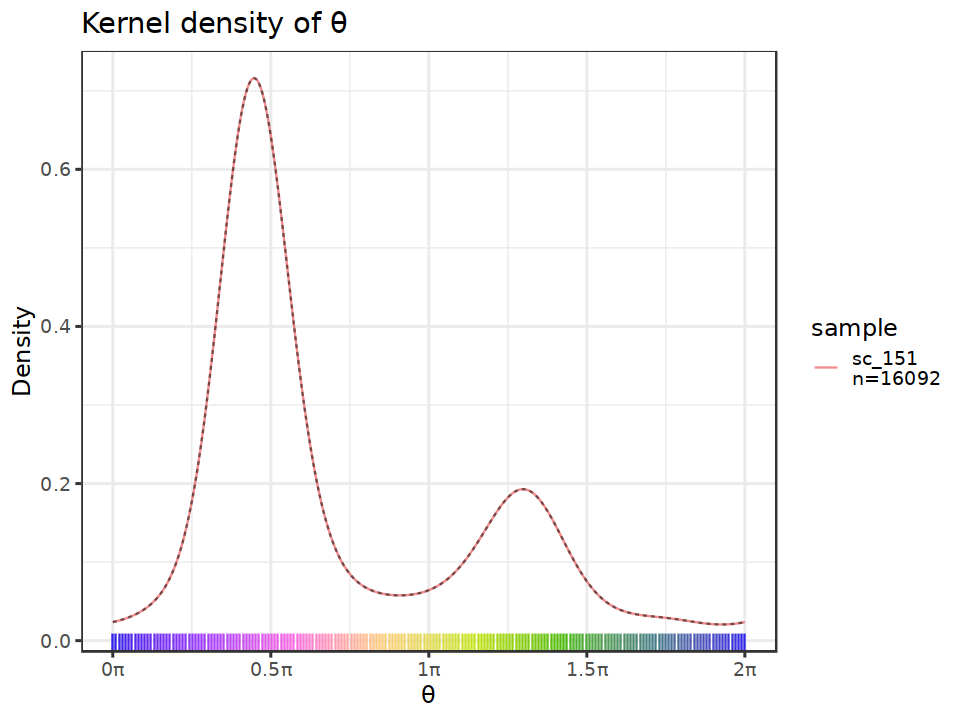

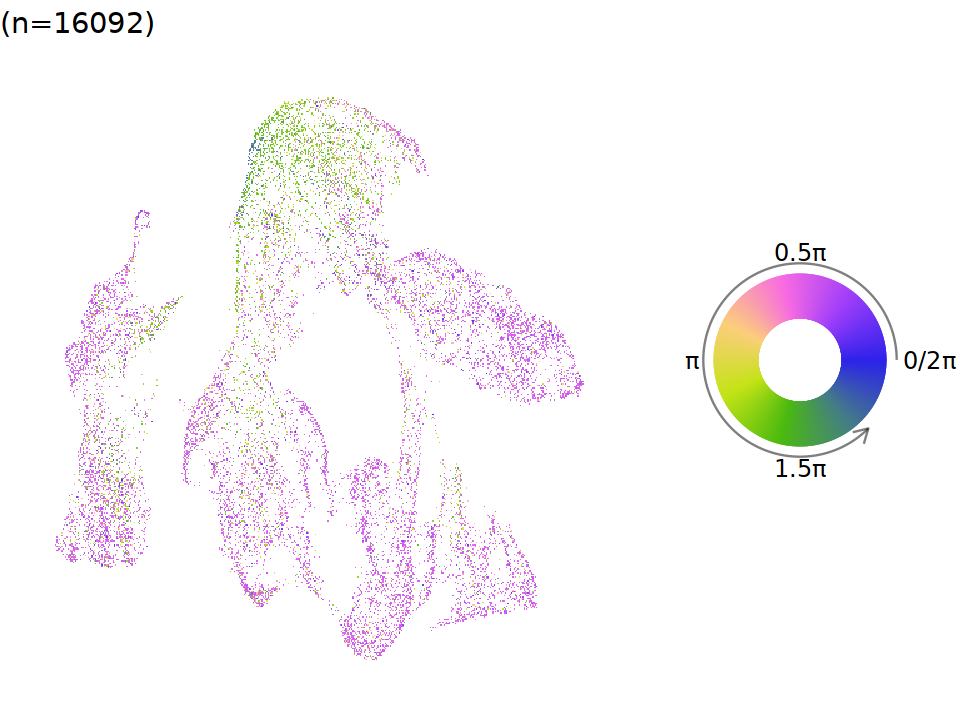

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


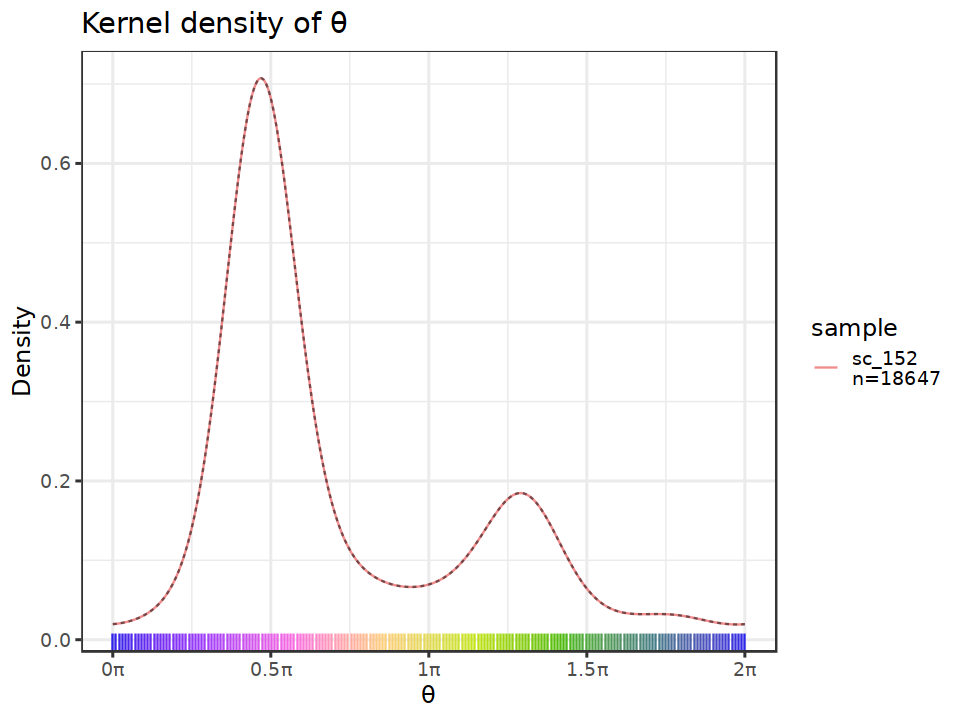

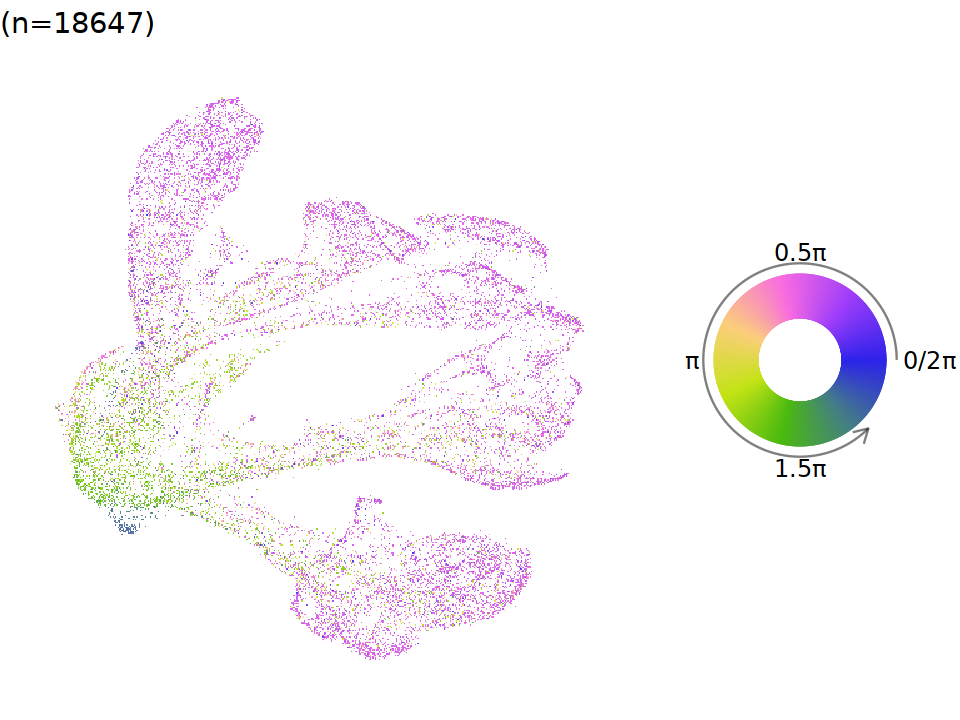

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


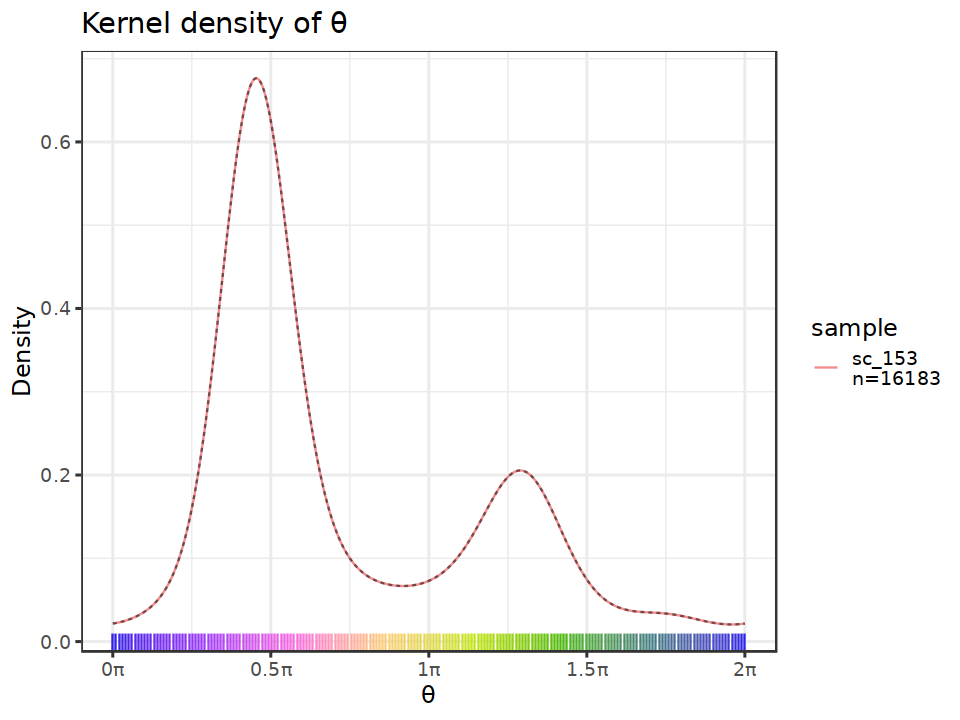

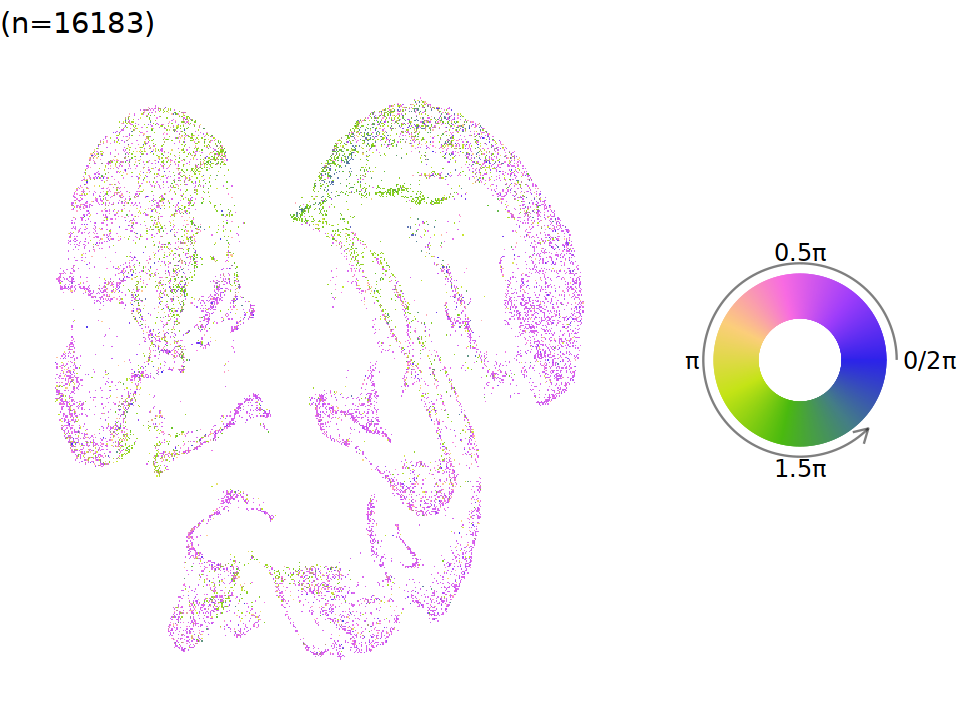

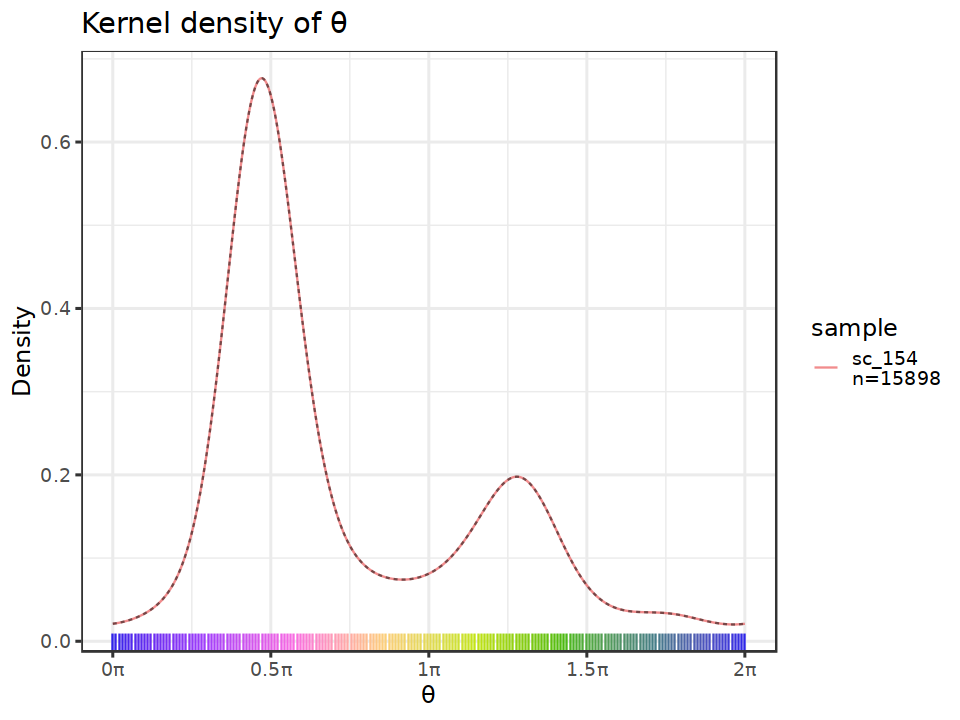

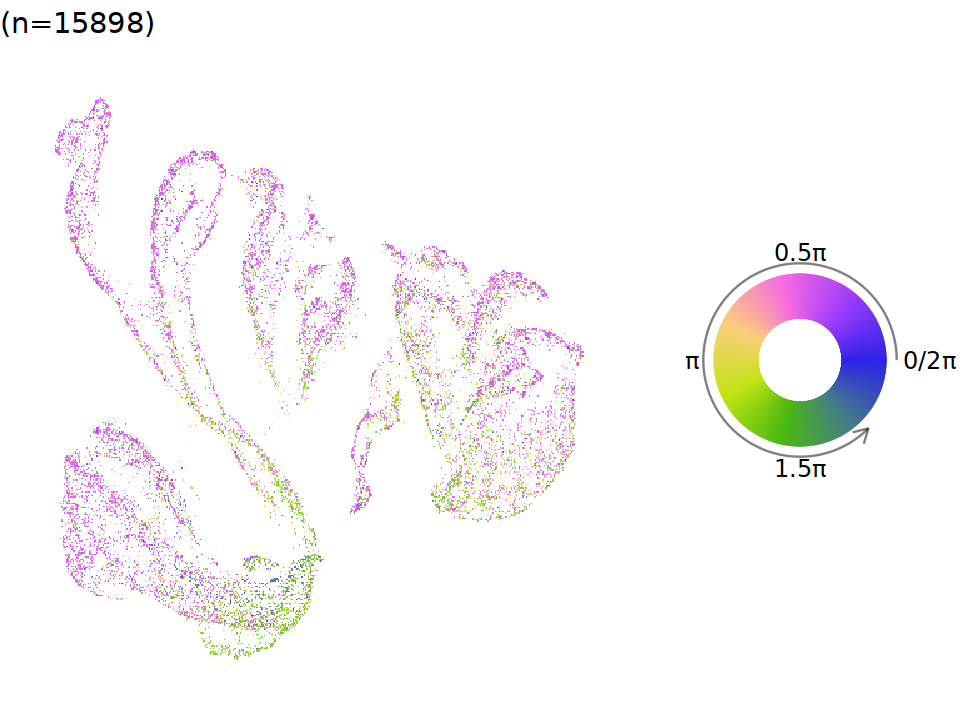

In [99]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

In [100]:
sample.list <- c("pp1","col0","tnw2","sc_1","sc_9_at","sc_30", "sc_31", "sc_37", "sc_40", "sc_51")

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


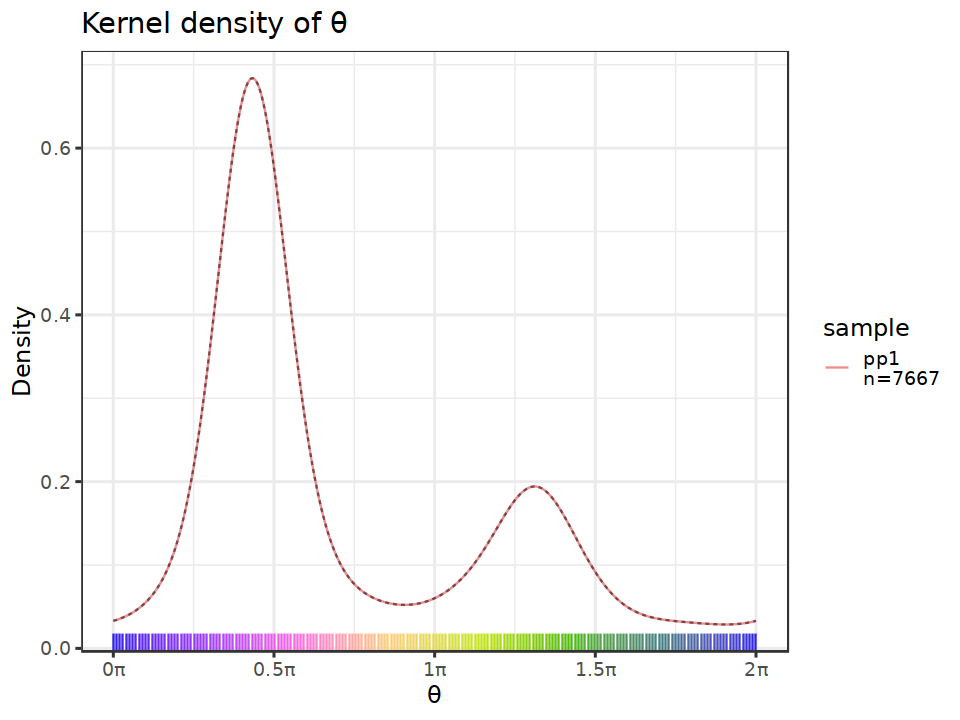

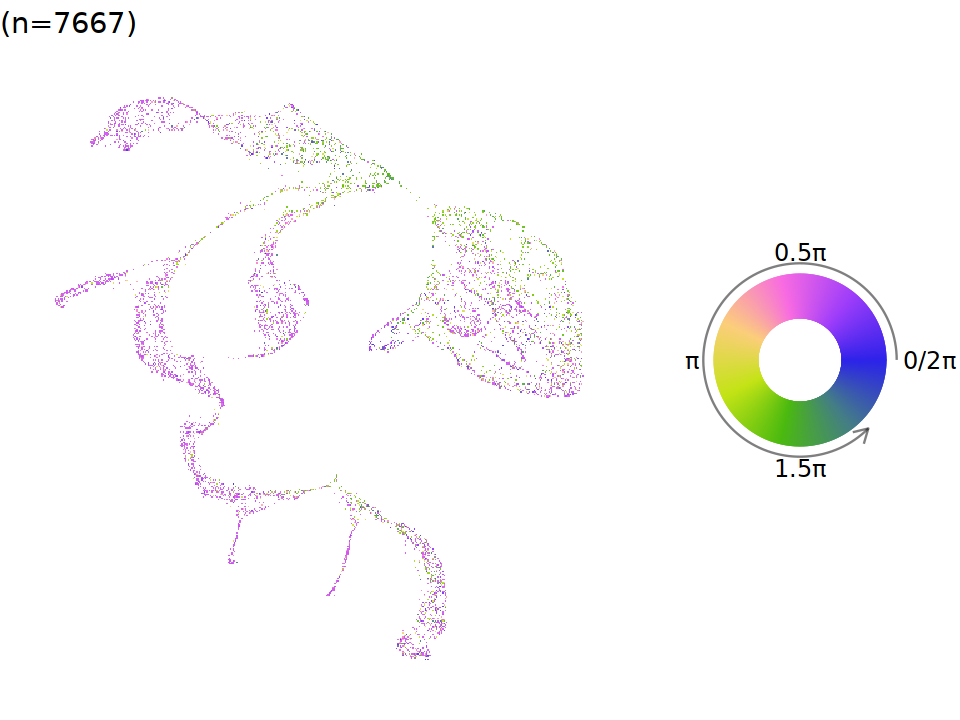

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


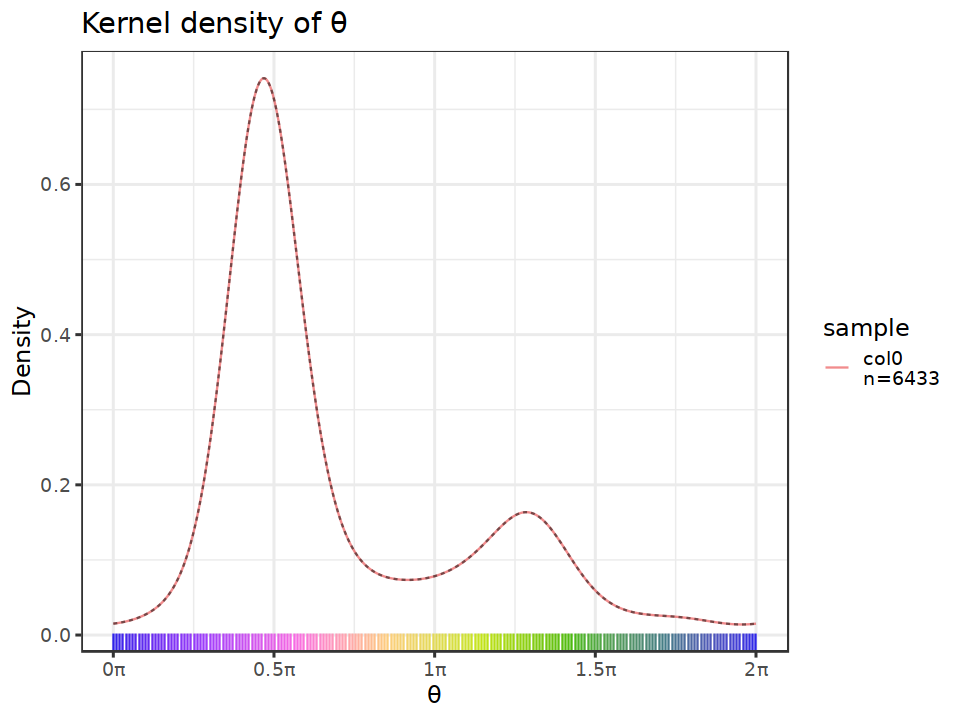

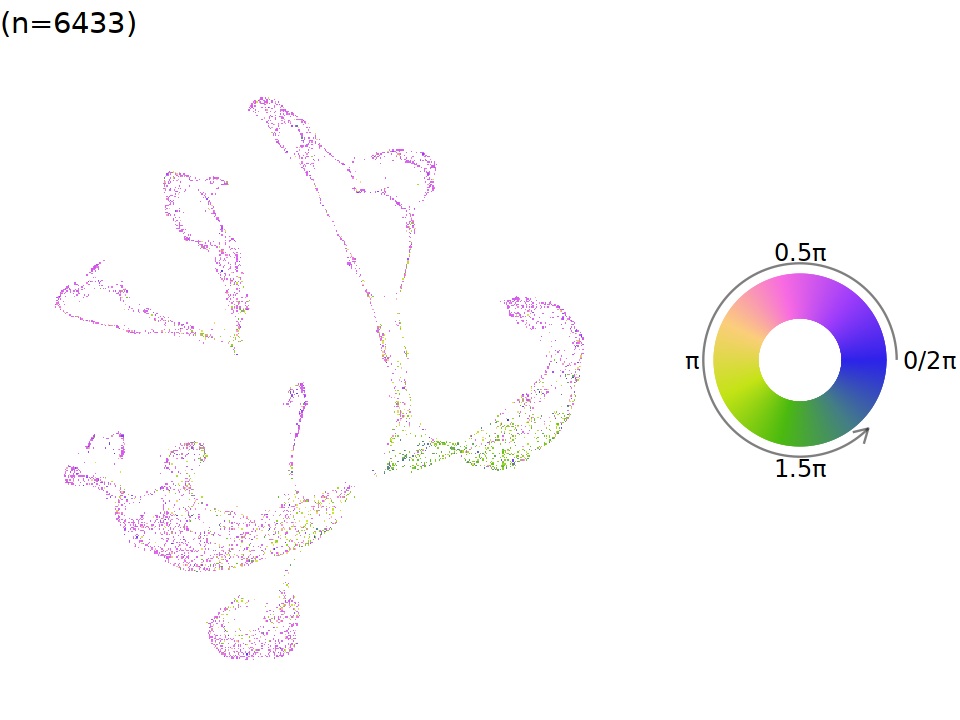

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


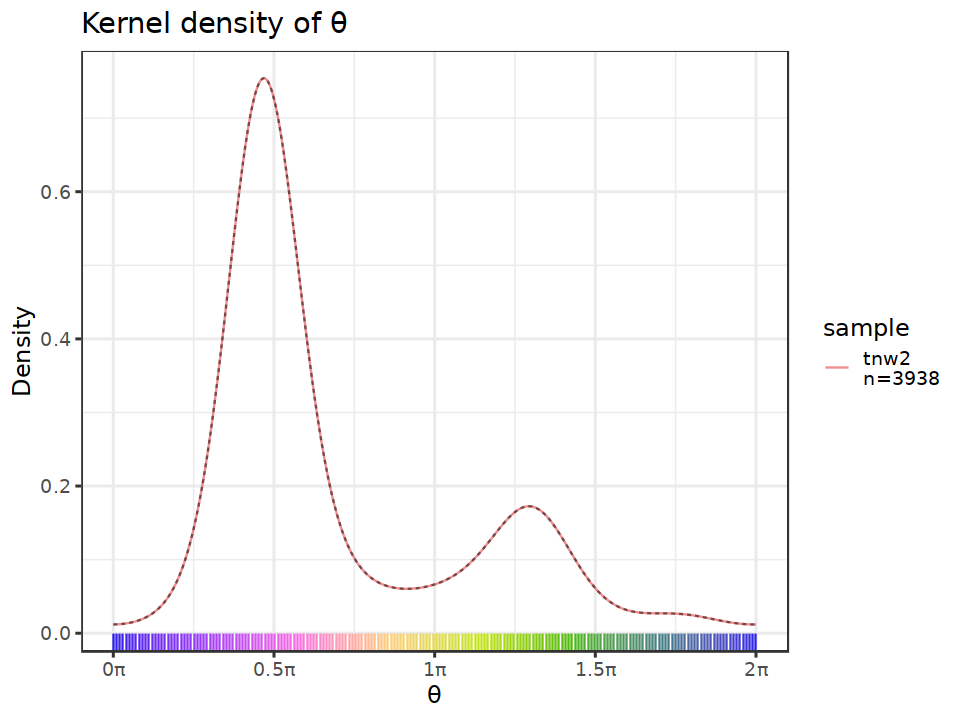

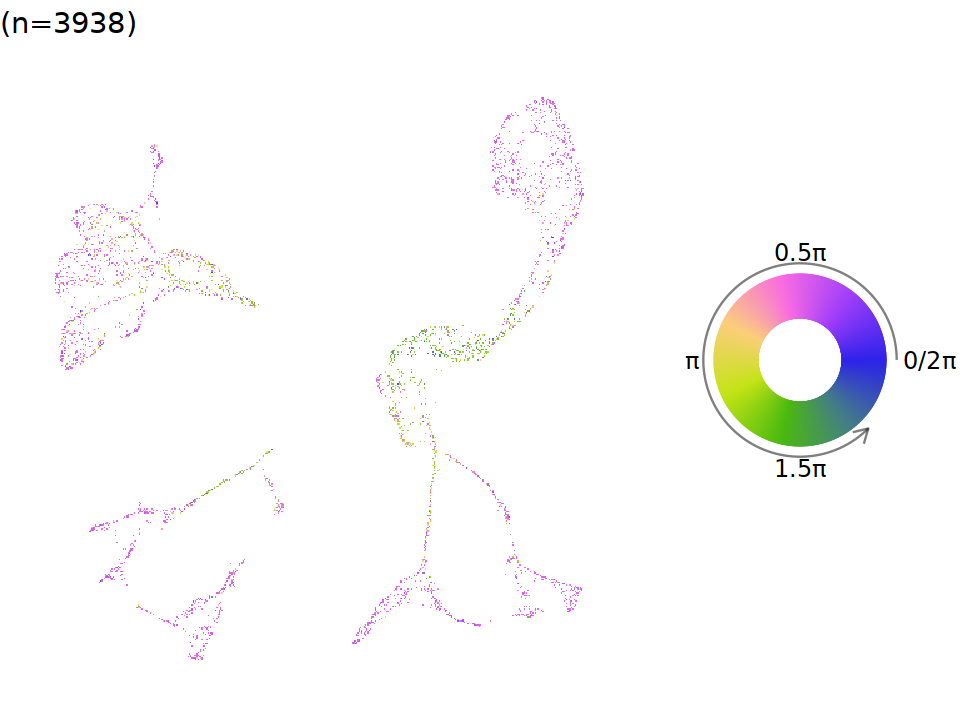

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


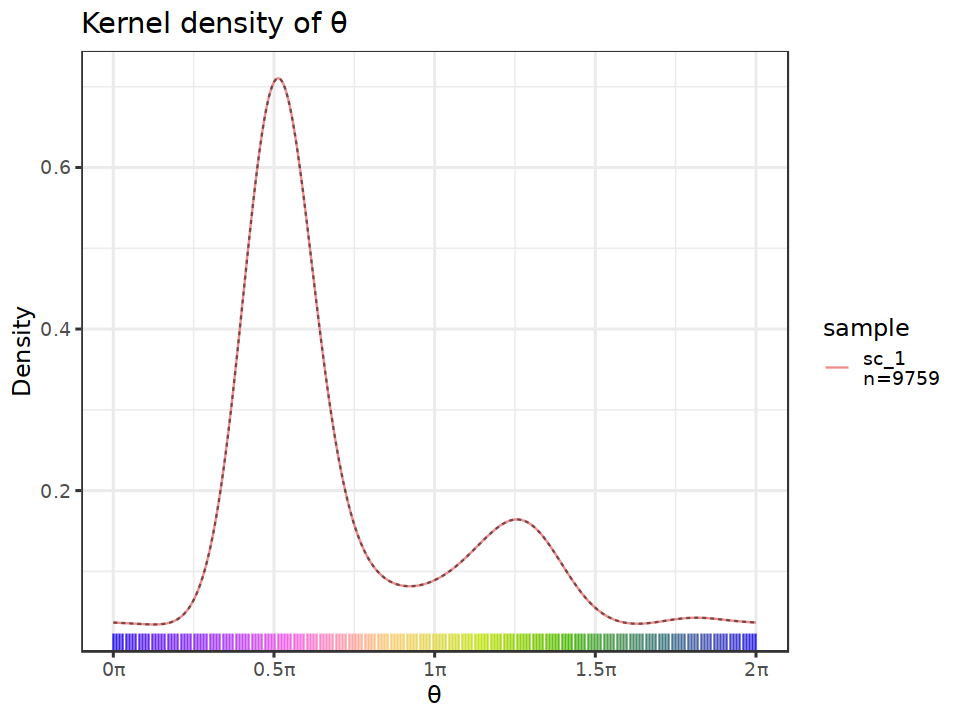

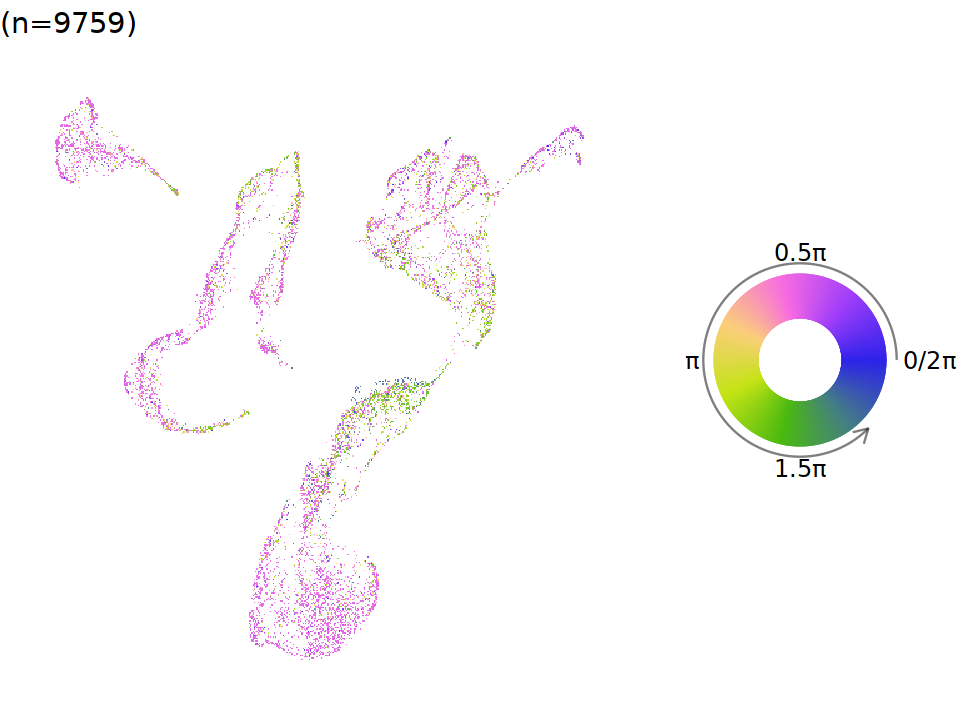

The number of projection genes found in the new data is 243.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


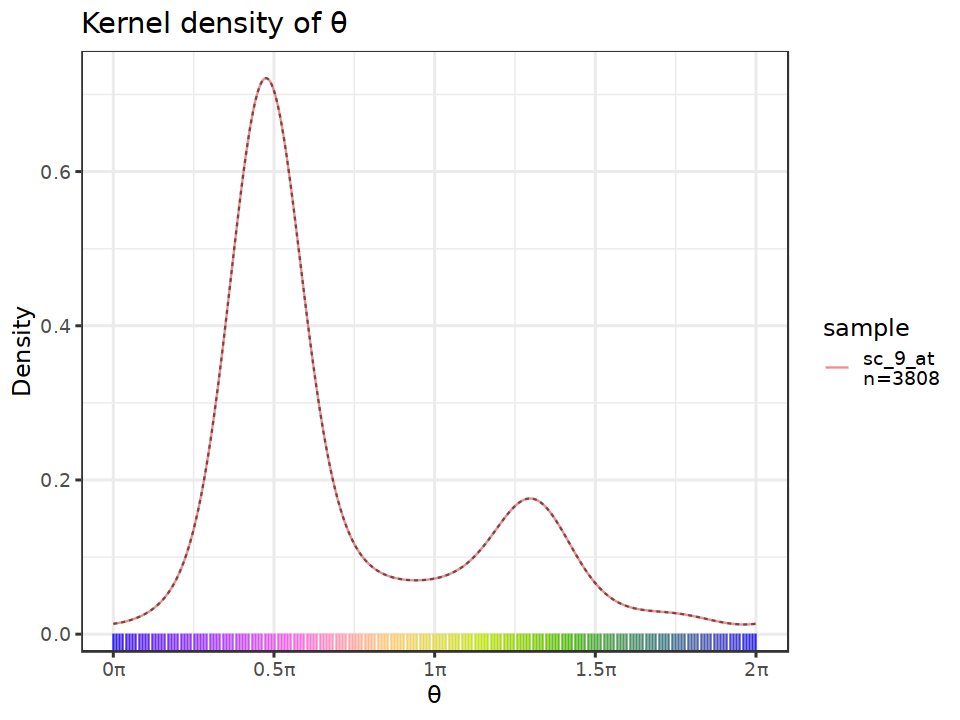

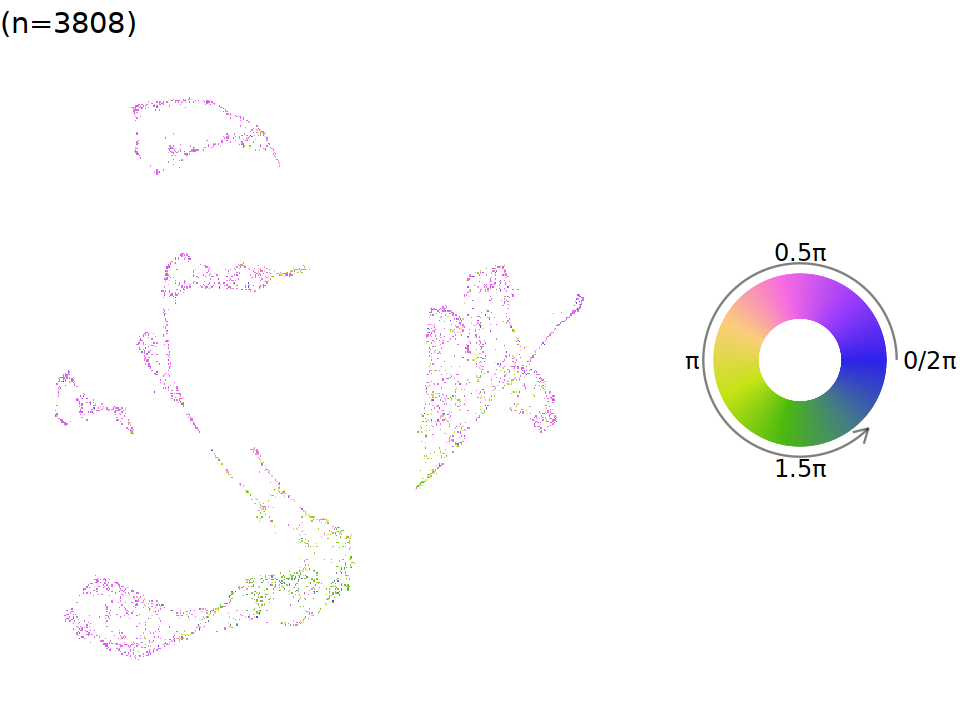

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


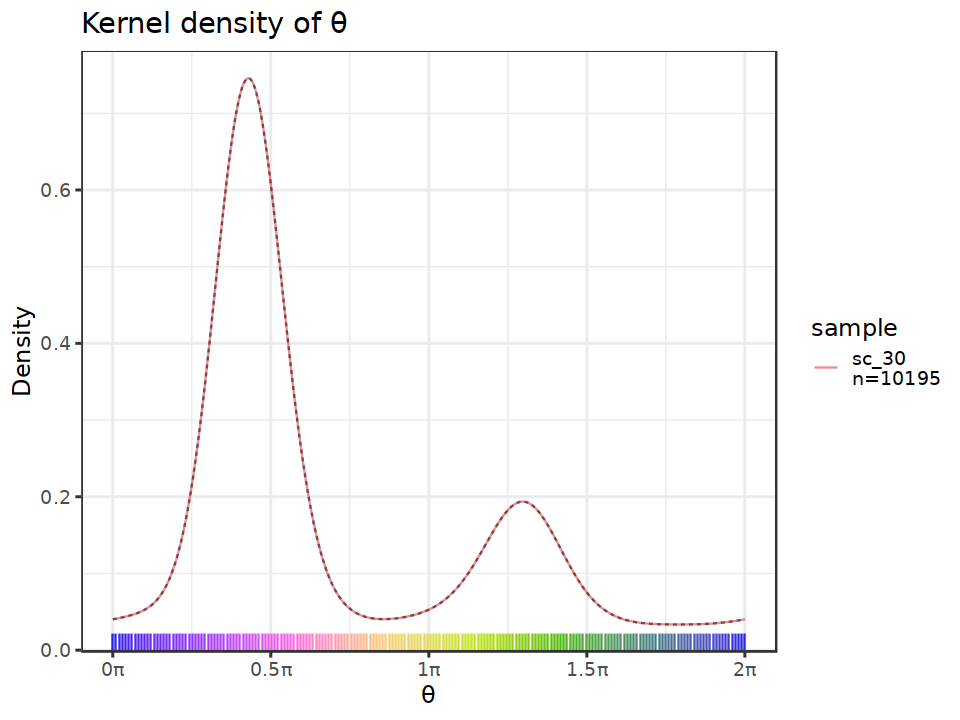

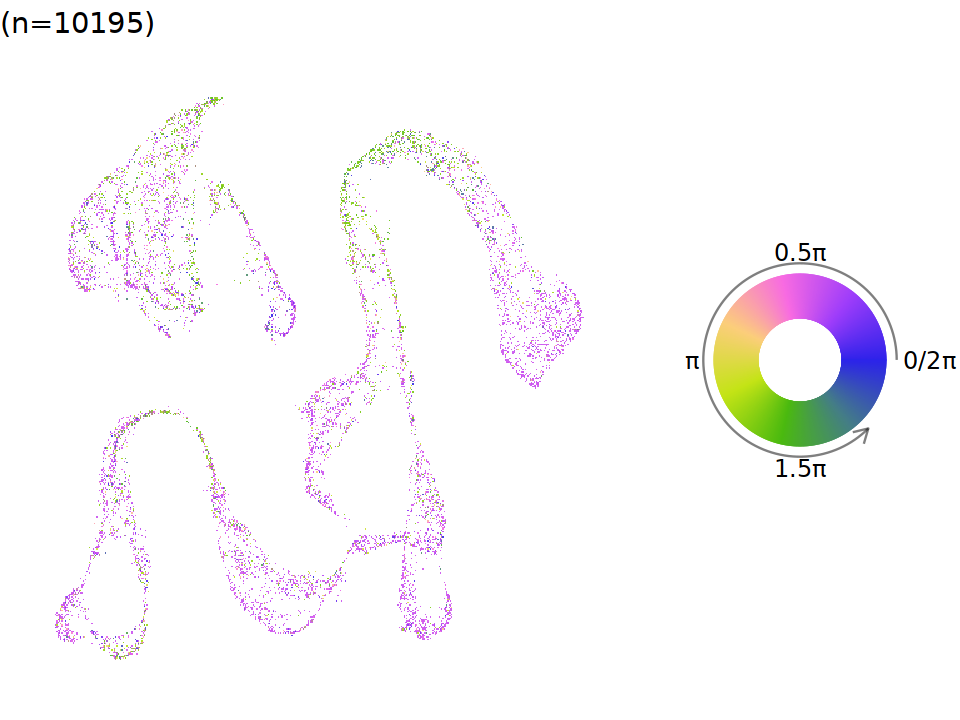

The number of projection genes found in the new data is 244.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


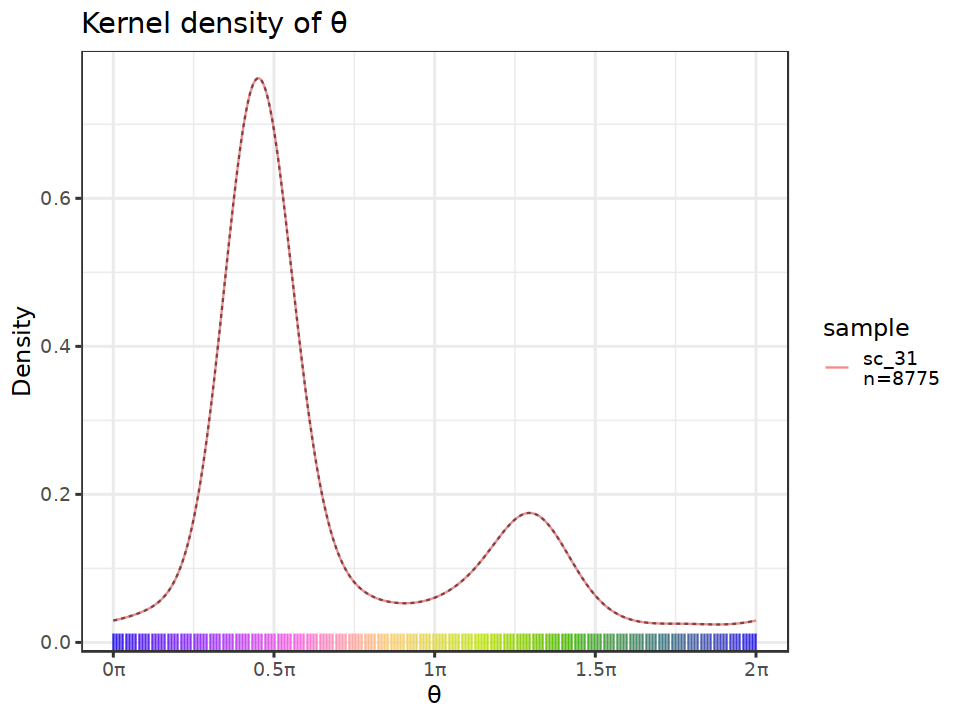

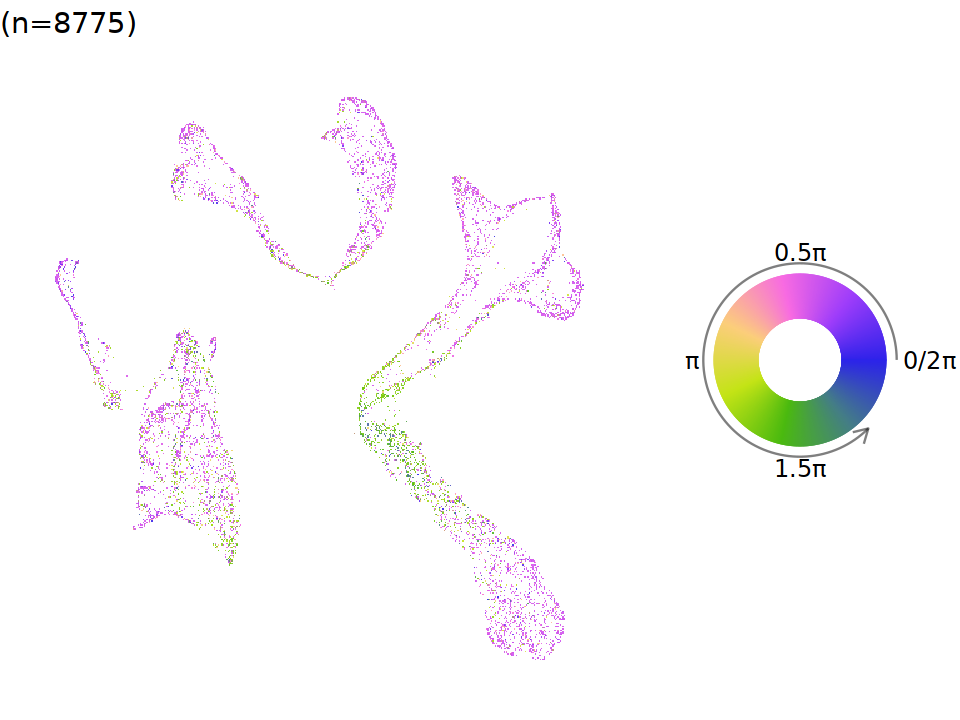

The number of projection genes found in the new data is 241.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


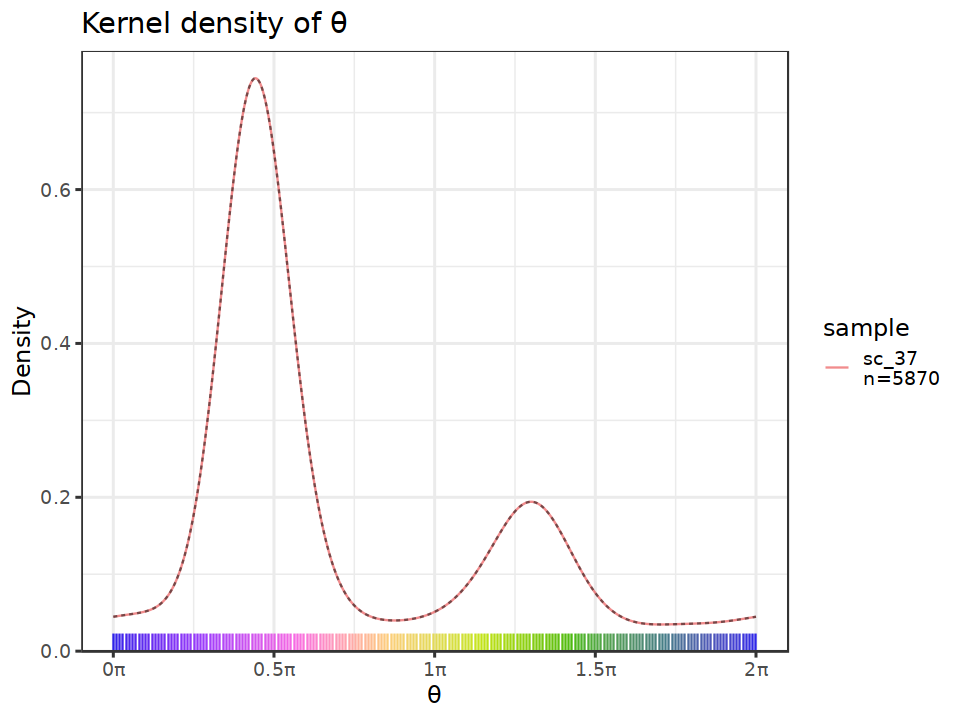

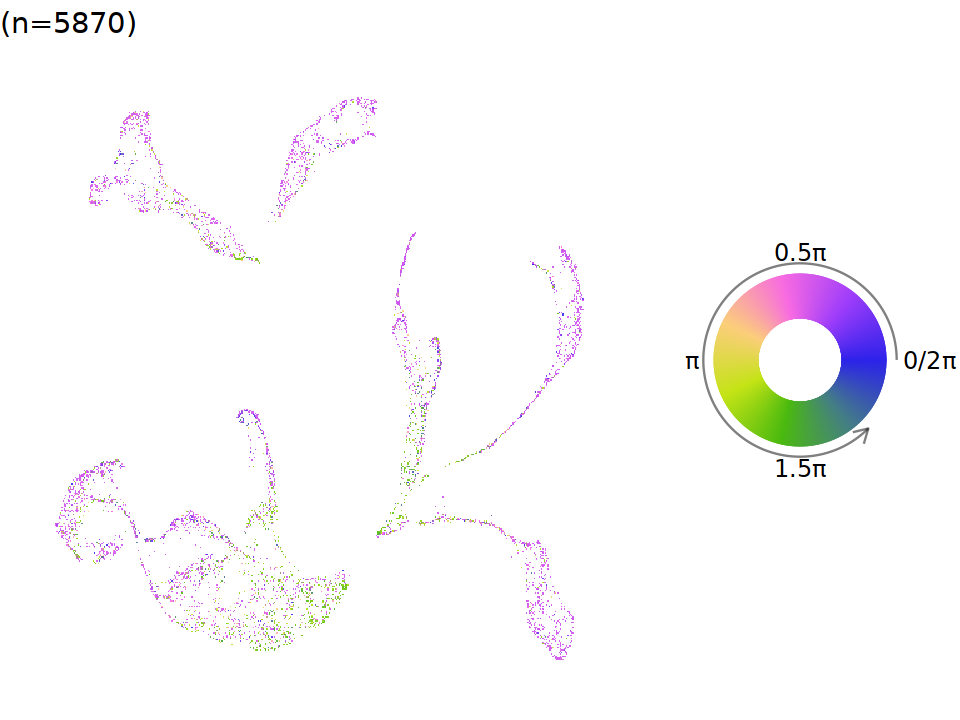

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


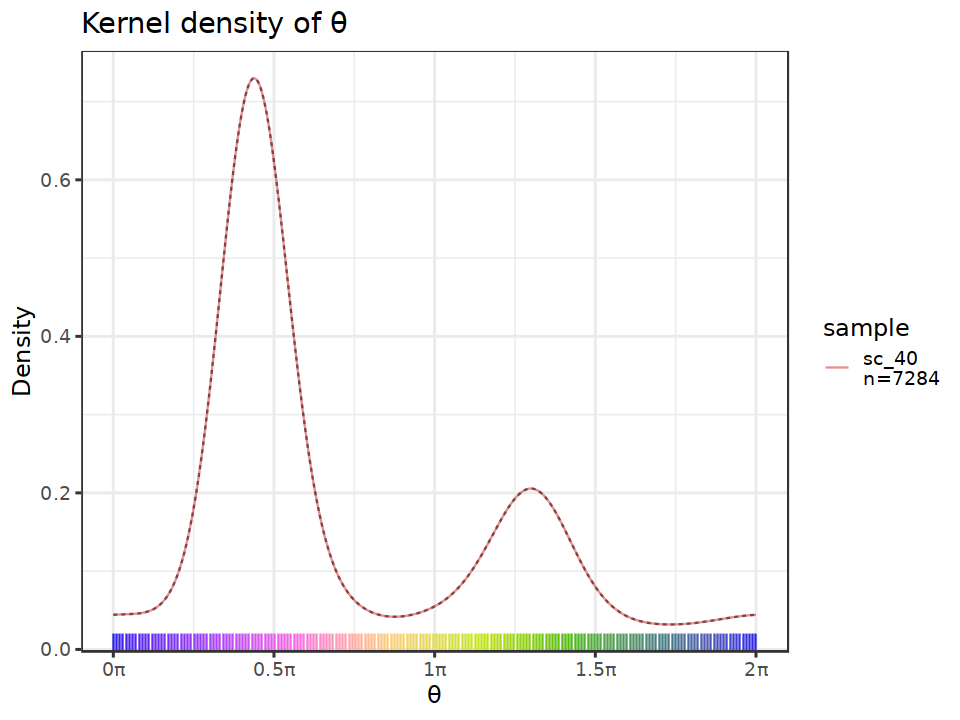

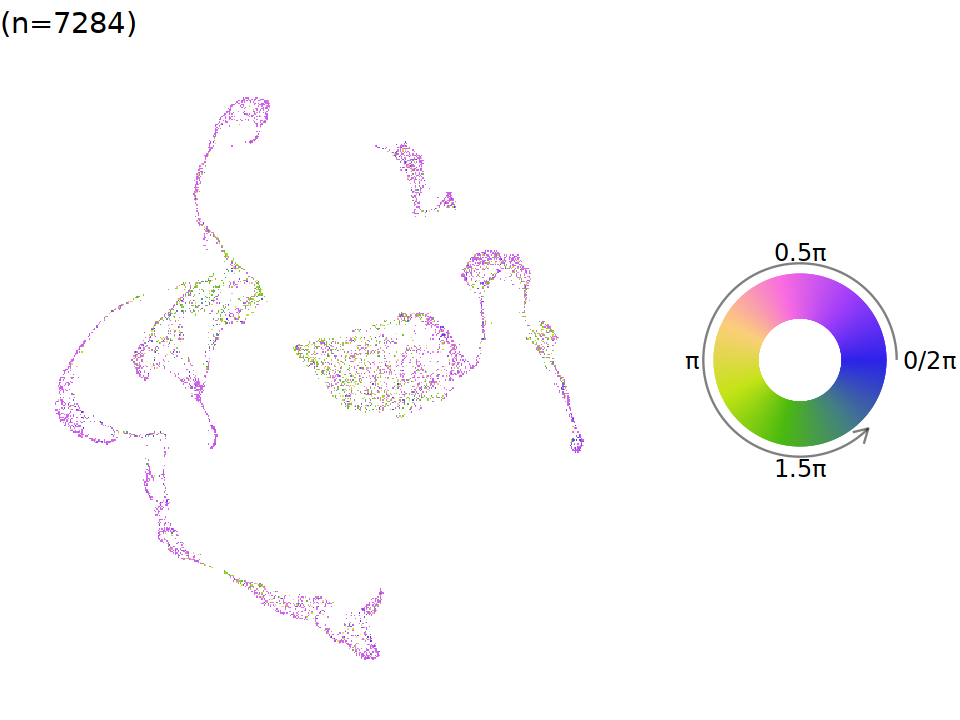

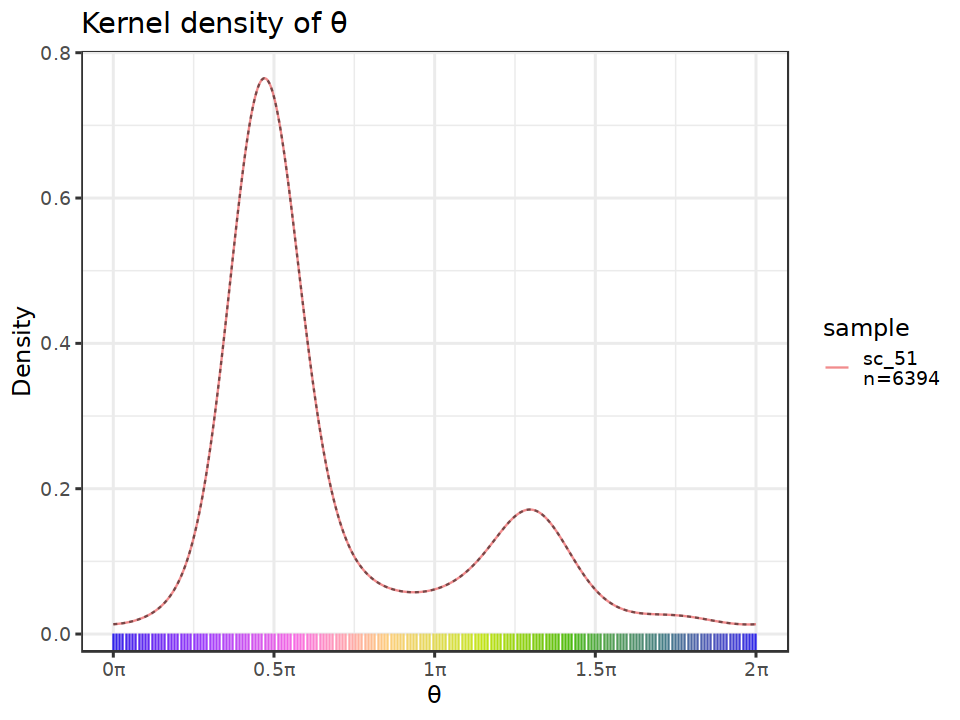

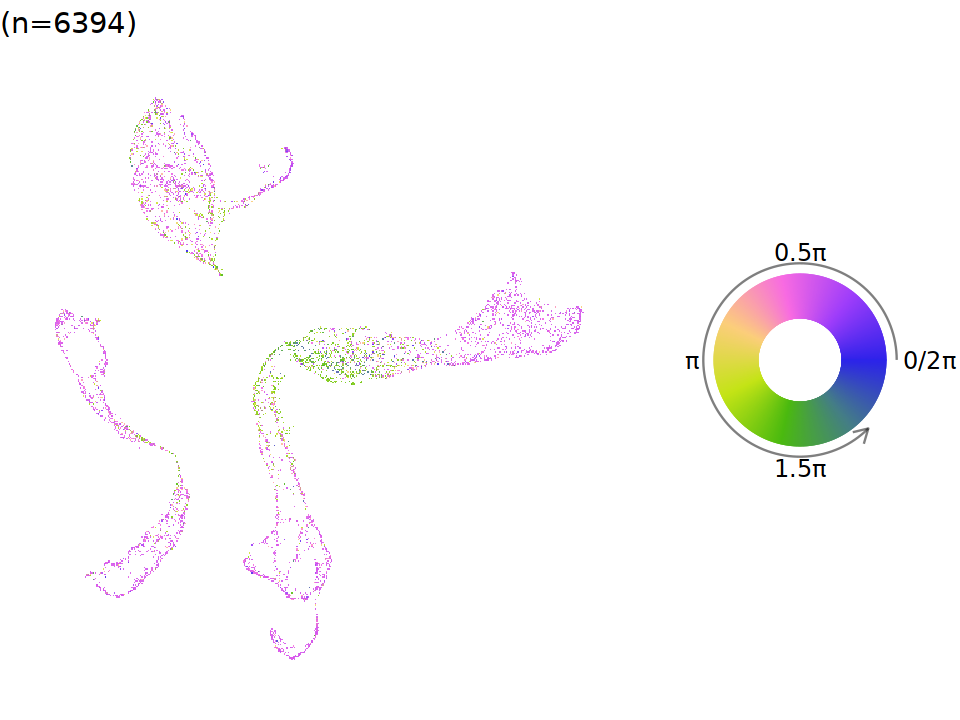

In [101]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

In [ ]:
run_tricycle <- function(sample){
    seu <- readRDS(paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT.rds"))
    sce <- as.SingleCellExperiment(seu)
    
    ## Tricycle estimation
    sce <- project_cycle_space(sce,ref.m = new.ref)
    sce <- estimate_cycle_position(sce)
    
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.2
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- (sce$tricyclePosition-2)*-1
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage
    
    ## Tricycle position on umap
    p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                           point.size = 1, point.alpha = 0.9) +
      theme_void(base_size = 14)
    legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
    print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))
    
    ## Write annotations as csv
    write.csv(seu@meta.data[,c("tricyclePosition", "tricycleCCStage")], paste0("./tricycle/",sample,".csv"), quote=FALSE)
    #saveRDS(seu,paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT_seu4.rds"))
}

In [94]:
sample.list <- c("dc1","dc2","tnw1","briT","briTR","sc_10_at","sc_11","sc_12","sc_20","sc_43","sc_44","sc_45","sc_46","sc_47","sc_48","sc_49","sc_50","sc_71",
                 "sc_122","sc_123","sc_124","sc_125","sc_126","sc_127","sc_128","sc_129","sc_130","sc_131","sc_132","sc_133","sc_134","sc_135","sc_136","sc_137",
                 "sc_155","sc_156","sc_157","sc_158","sc_159","sc_160","sc_161","sc_162","sc_163","sc_164","sc_165","sc_166","sc_167","sc_168","sc_169",
                 "sc_170","sc_171","sc_172","sc_173","sc_175","sc_176","sc_177","sc_178","sc_179","sc_180","sc_186","sc_187","sc_189","sc_190","sc_191",
                 "sc_215","sc_216","sc_217","sc_218","sc_220","sc_221","sc_222","sc_223","sc_224","sc_225","sc_226","sc_227","sc_228","sc_229","sc_235")

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


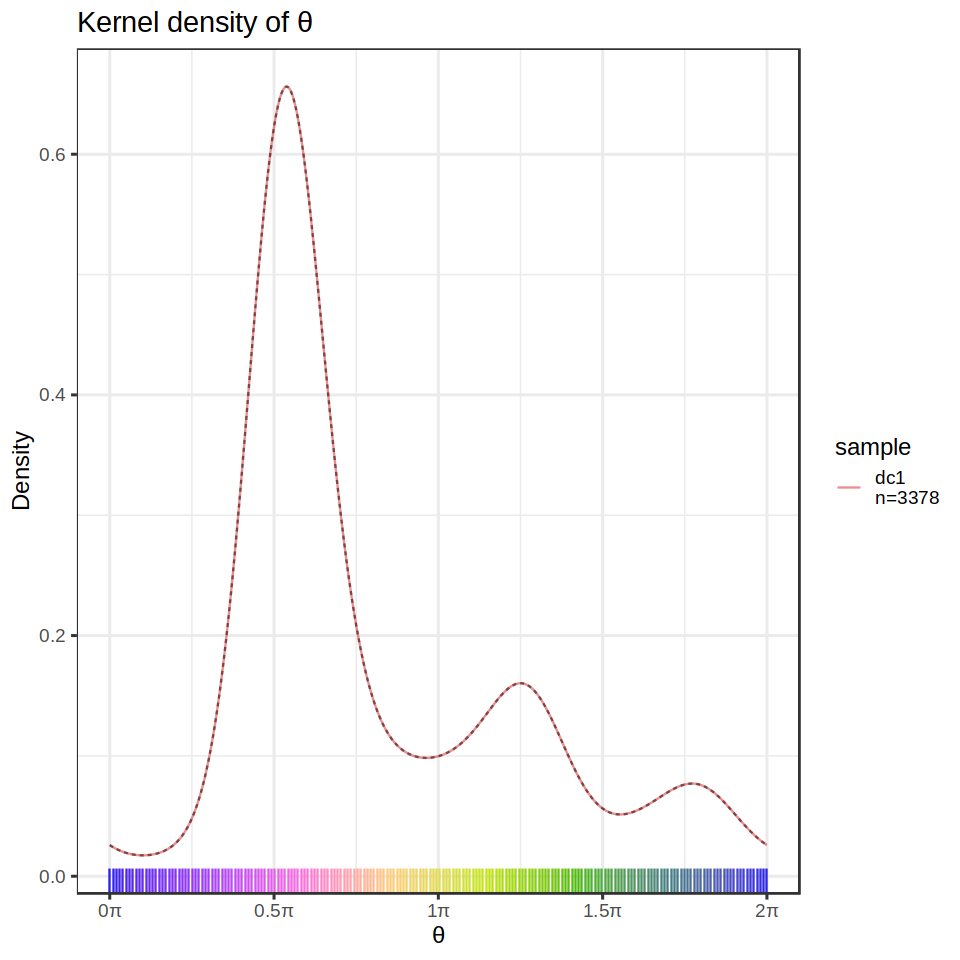

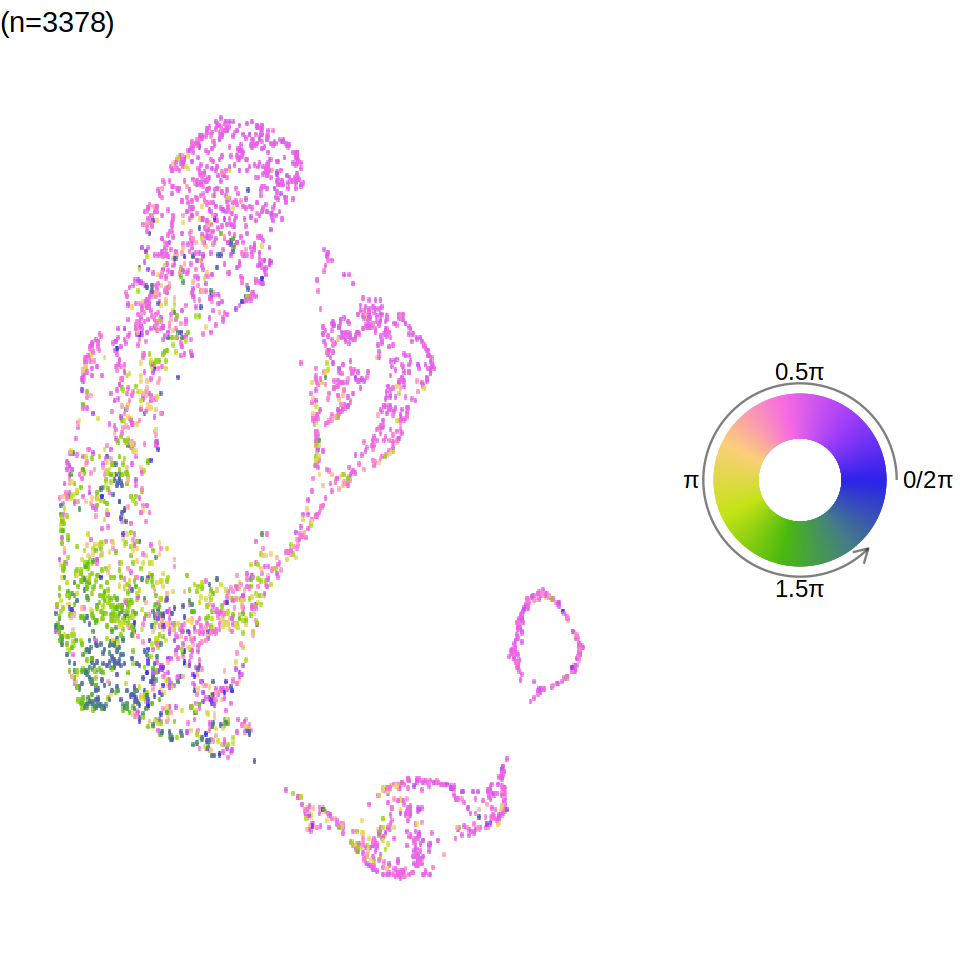

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


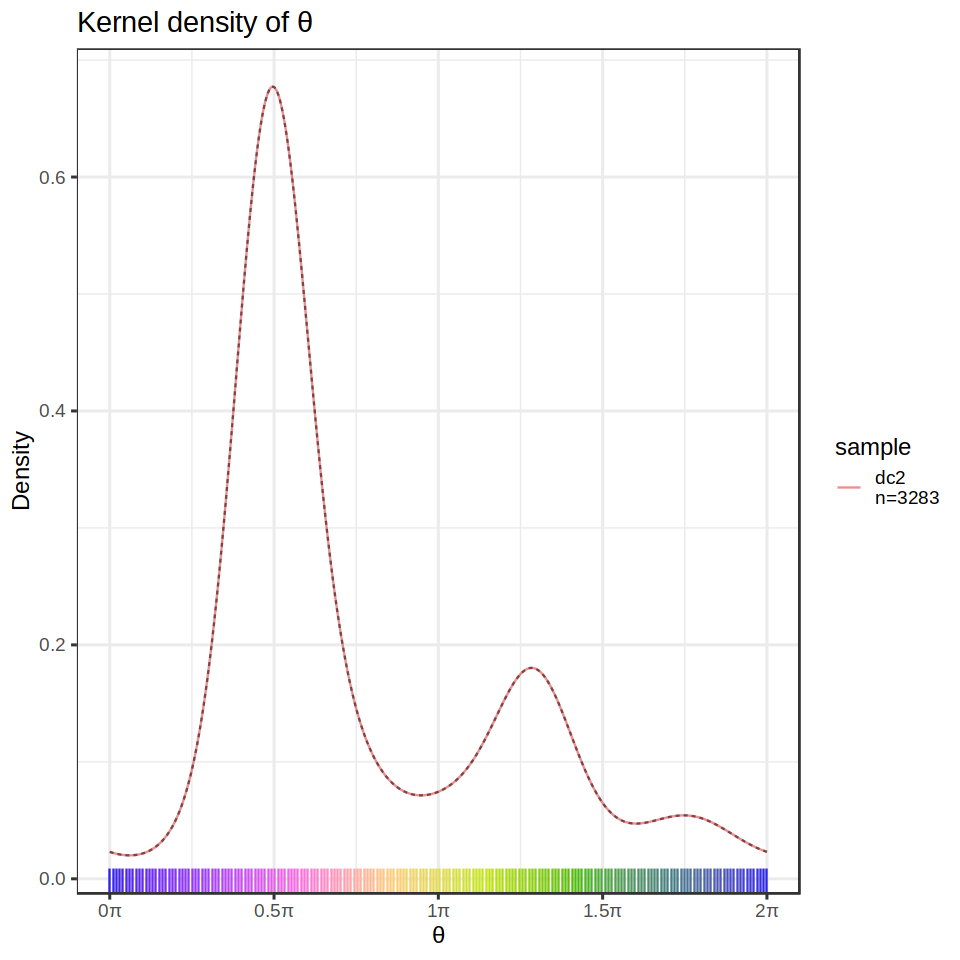

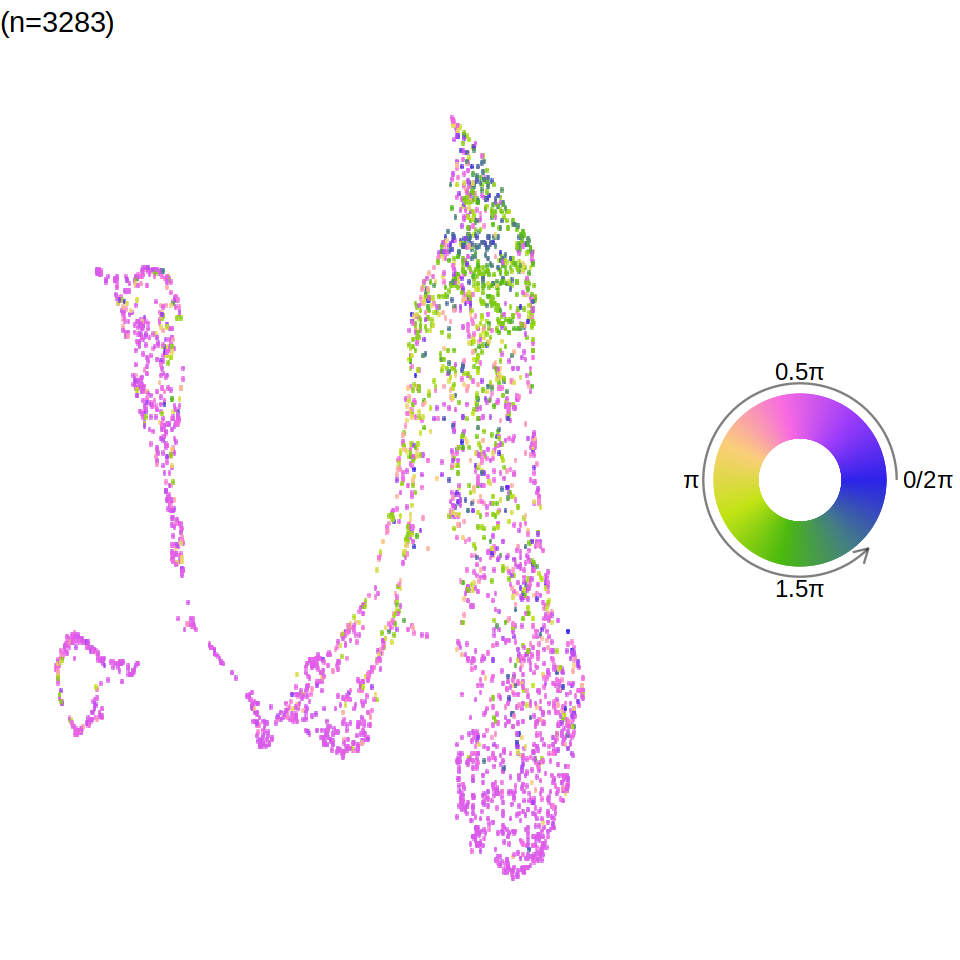

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


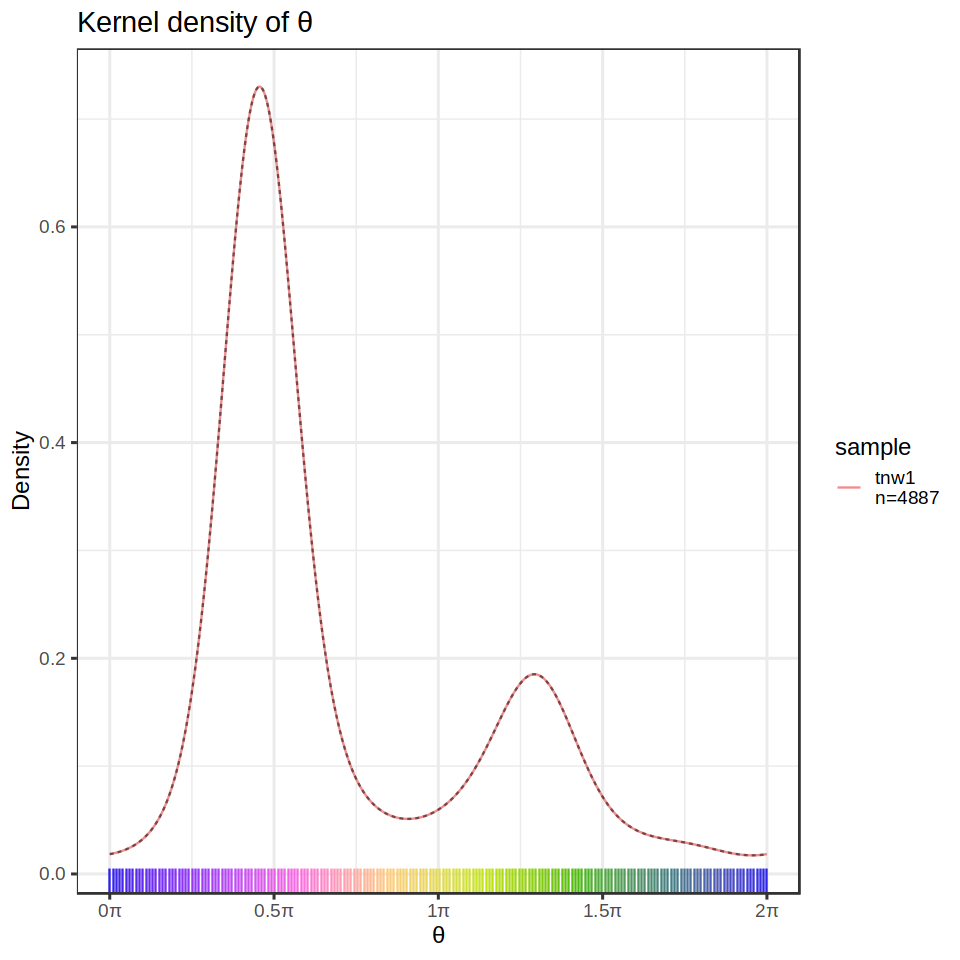

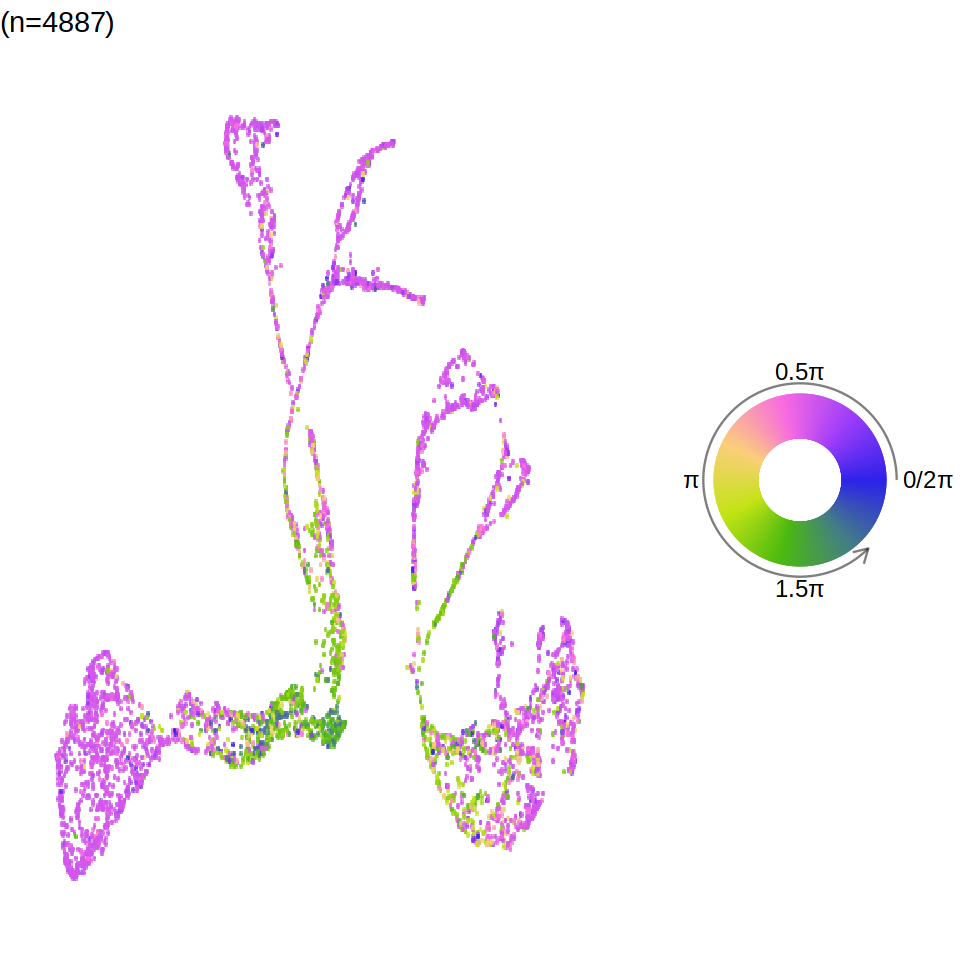

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


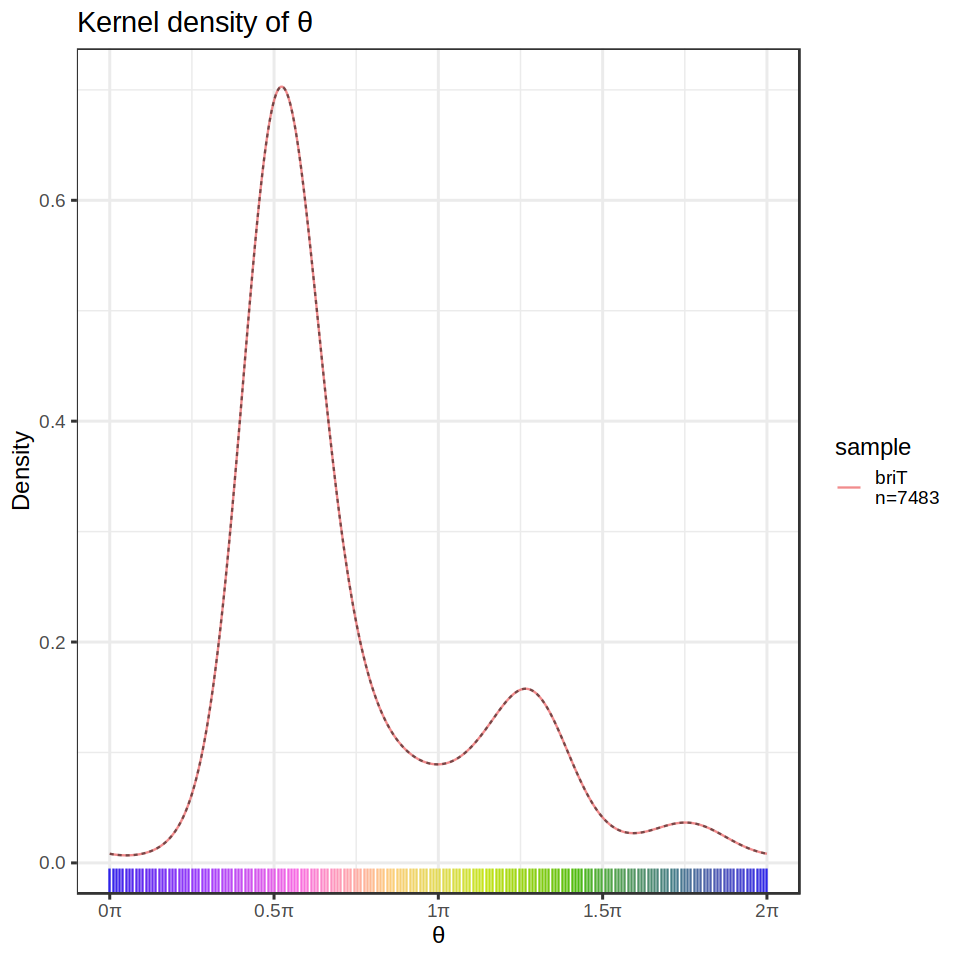

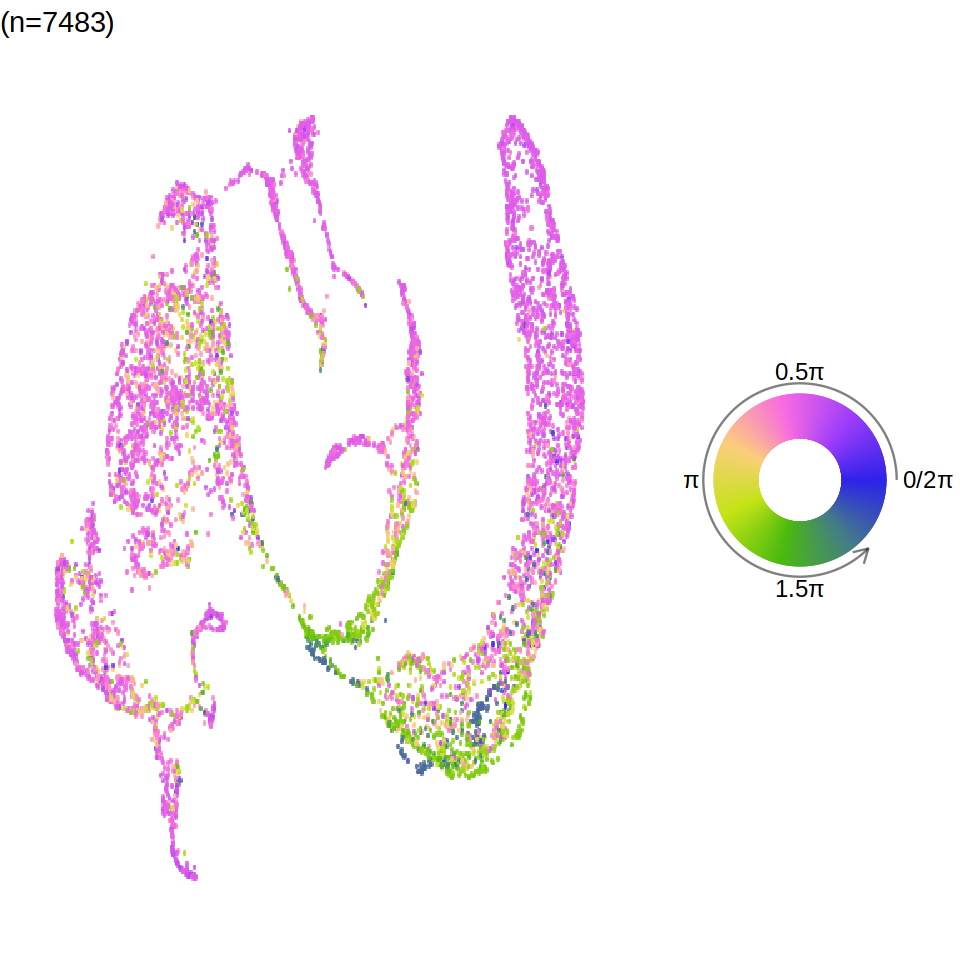

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


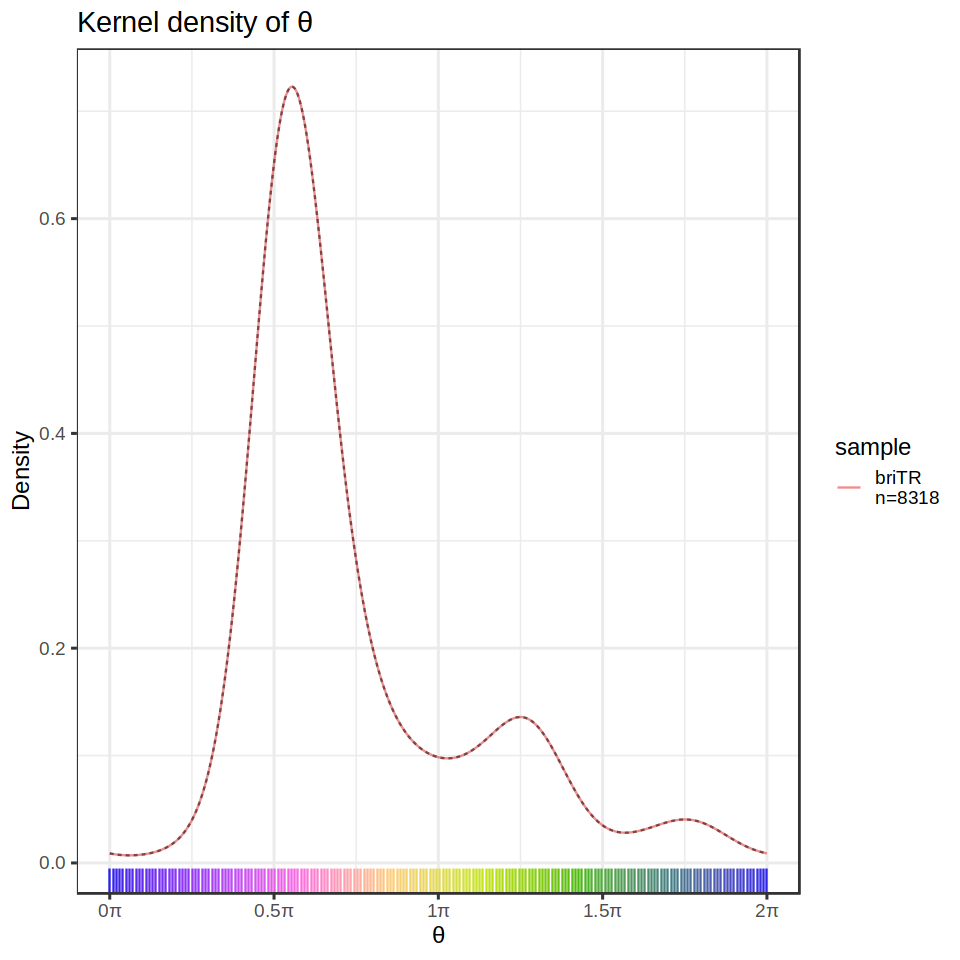

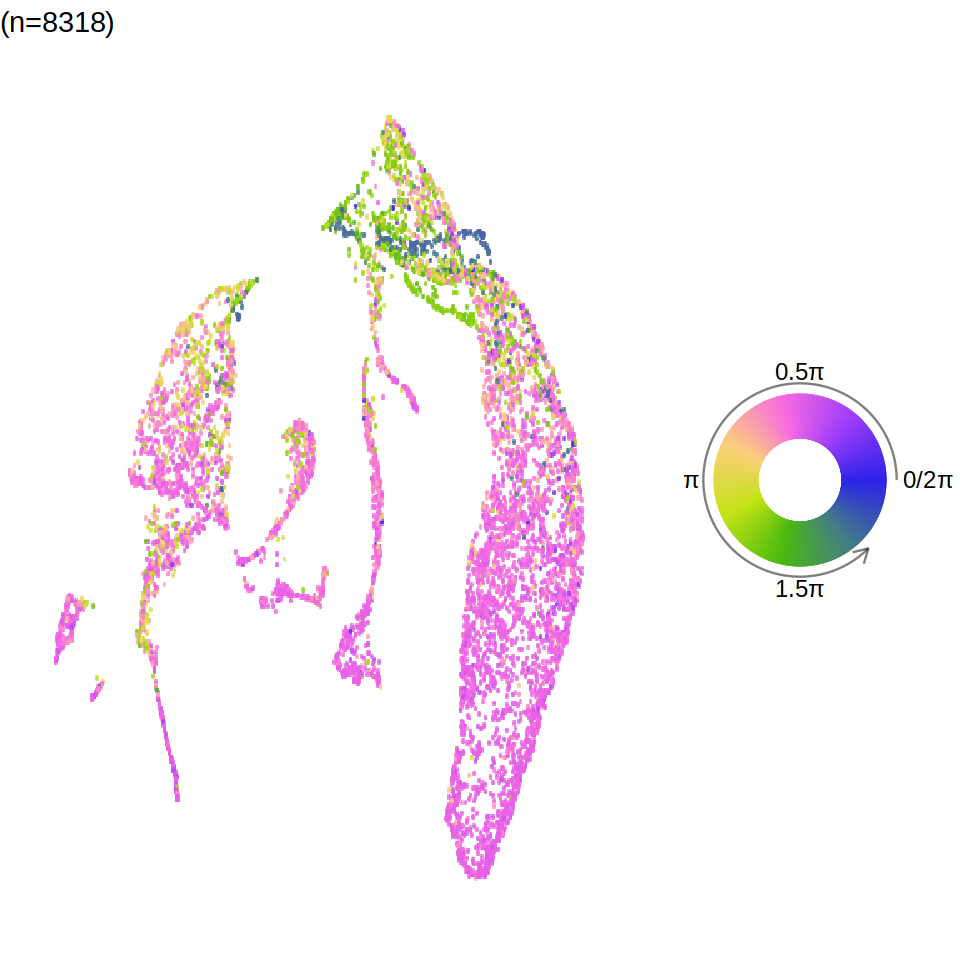

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


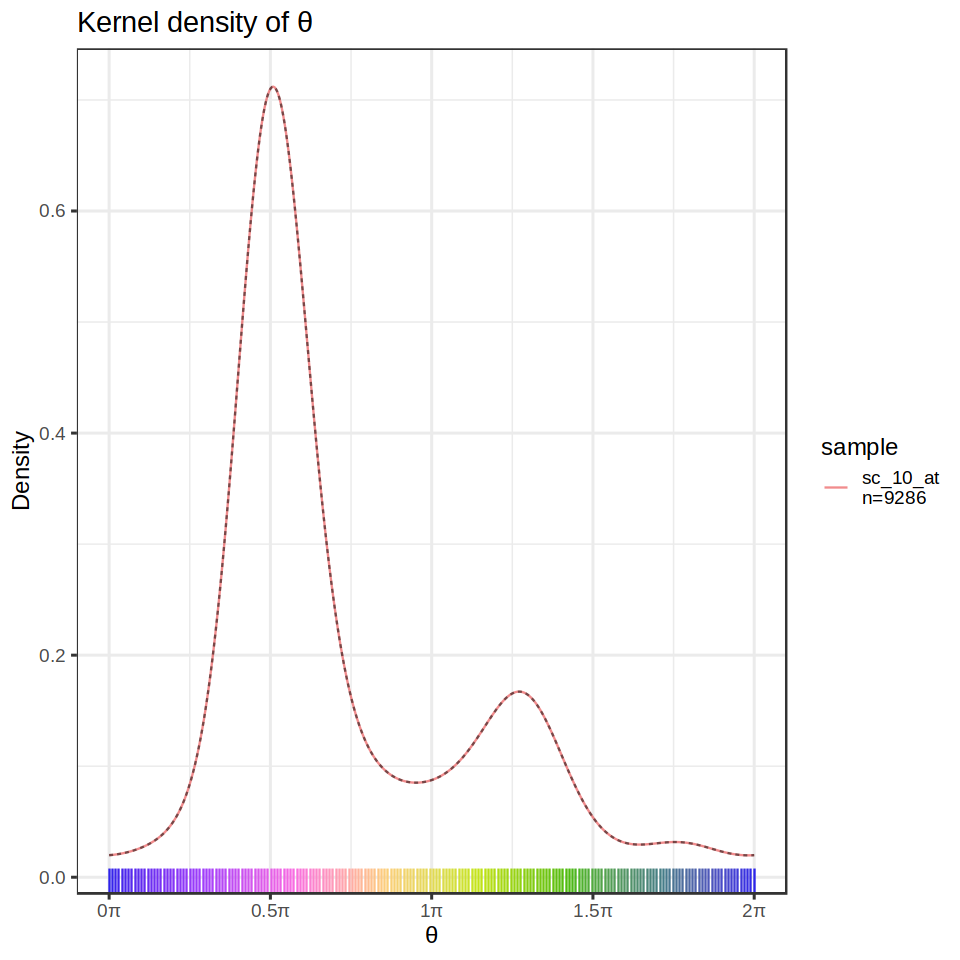

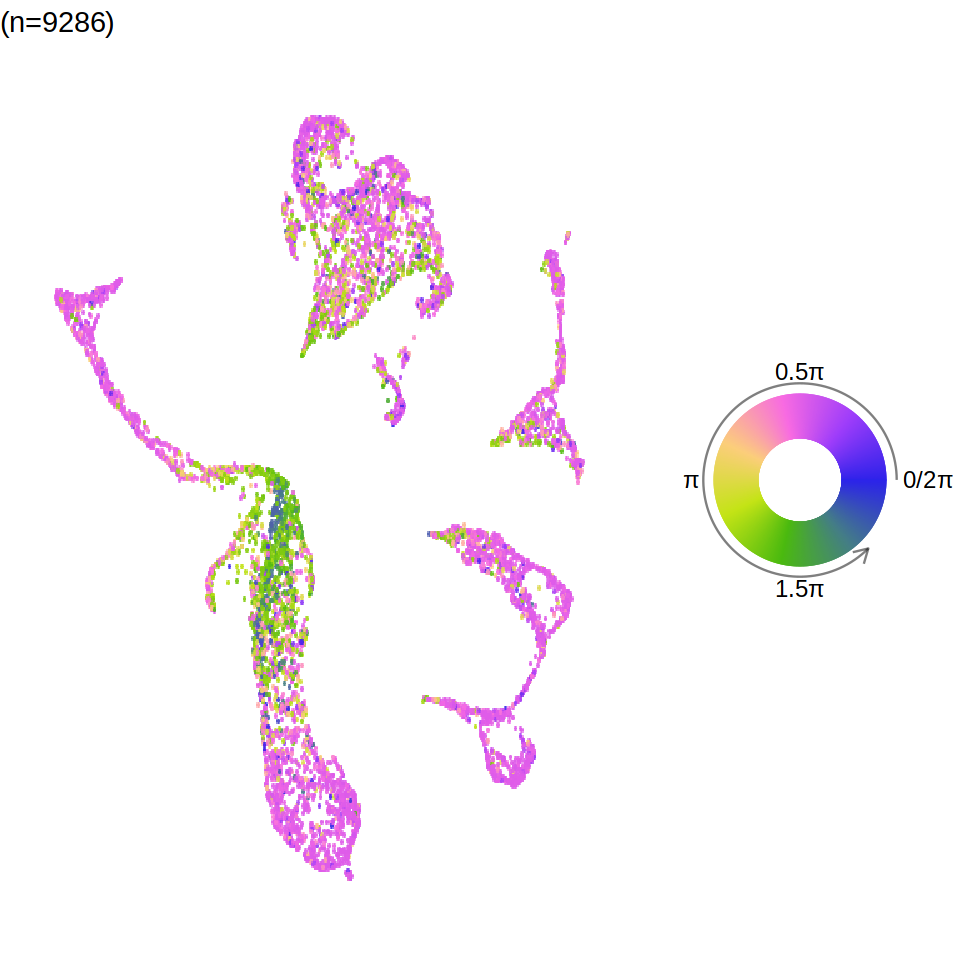

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


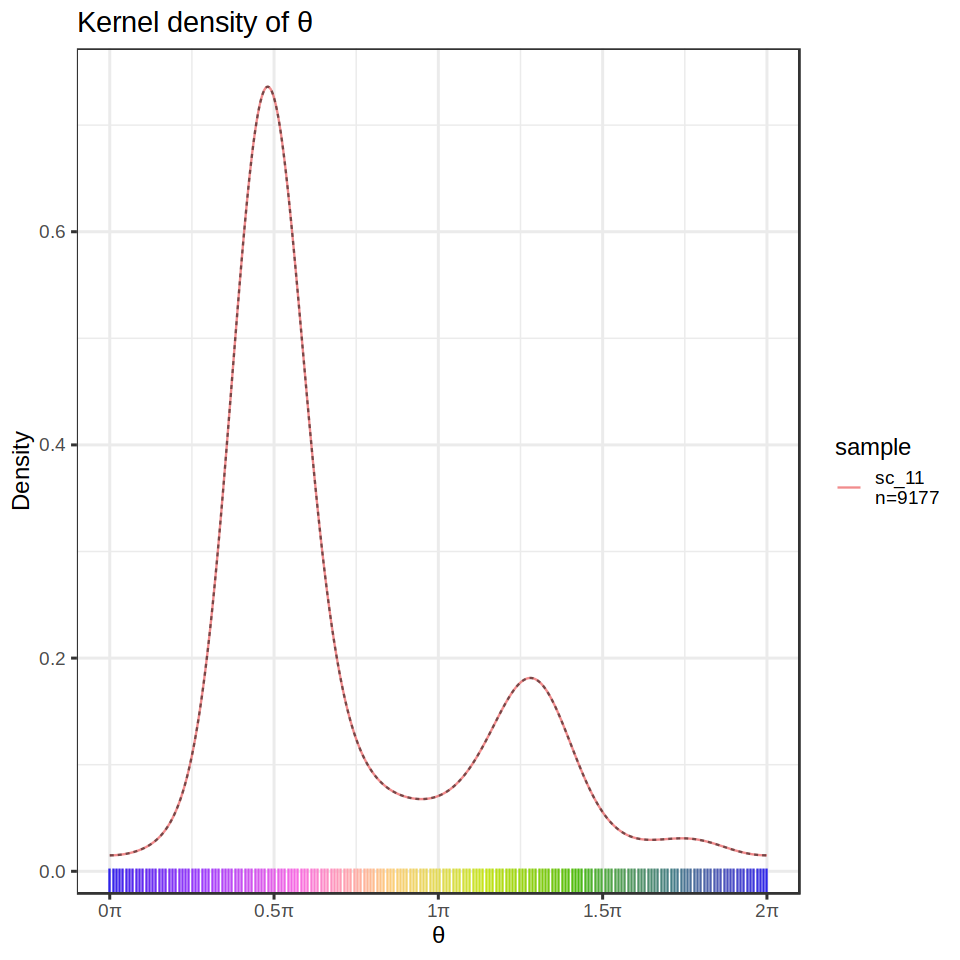

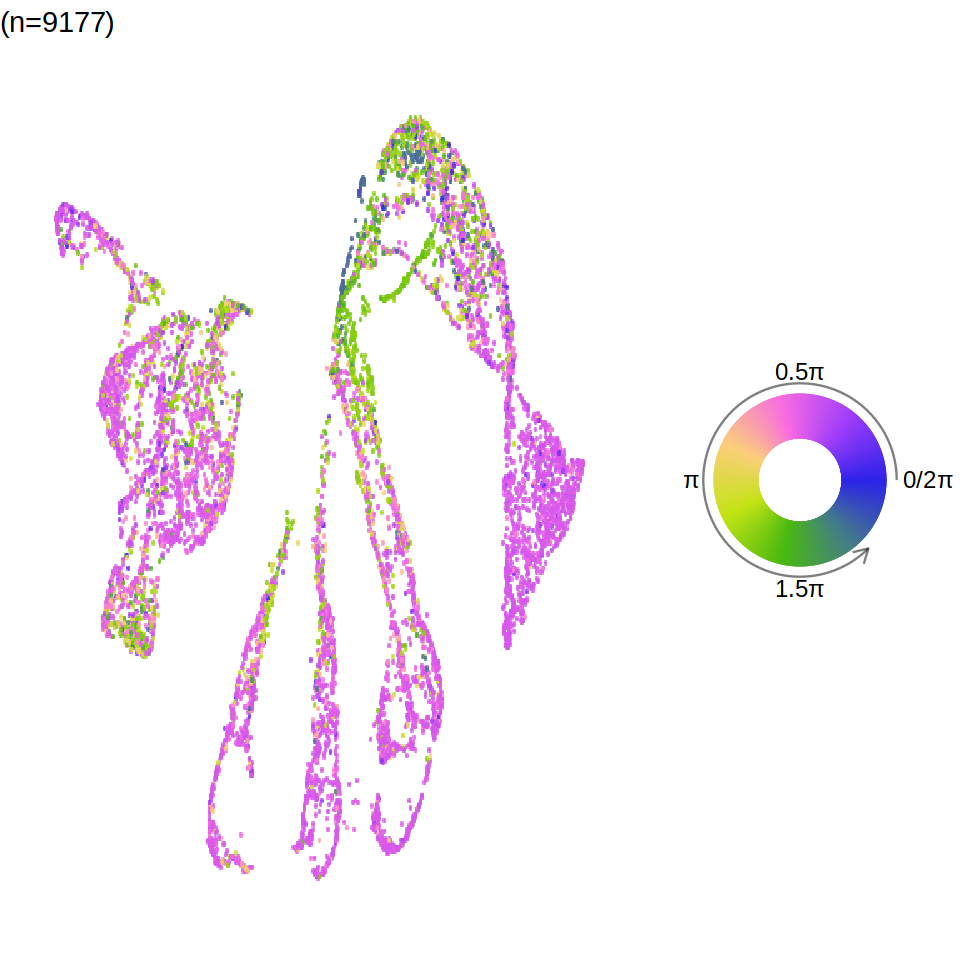

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


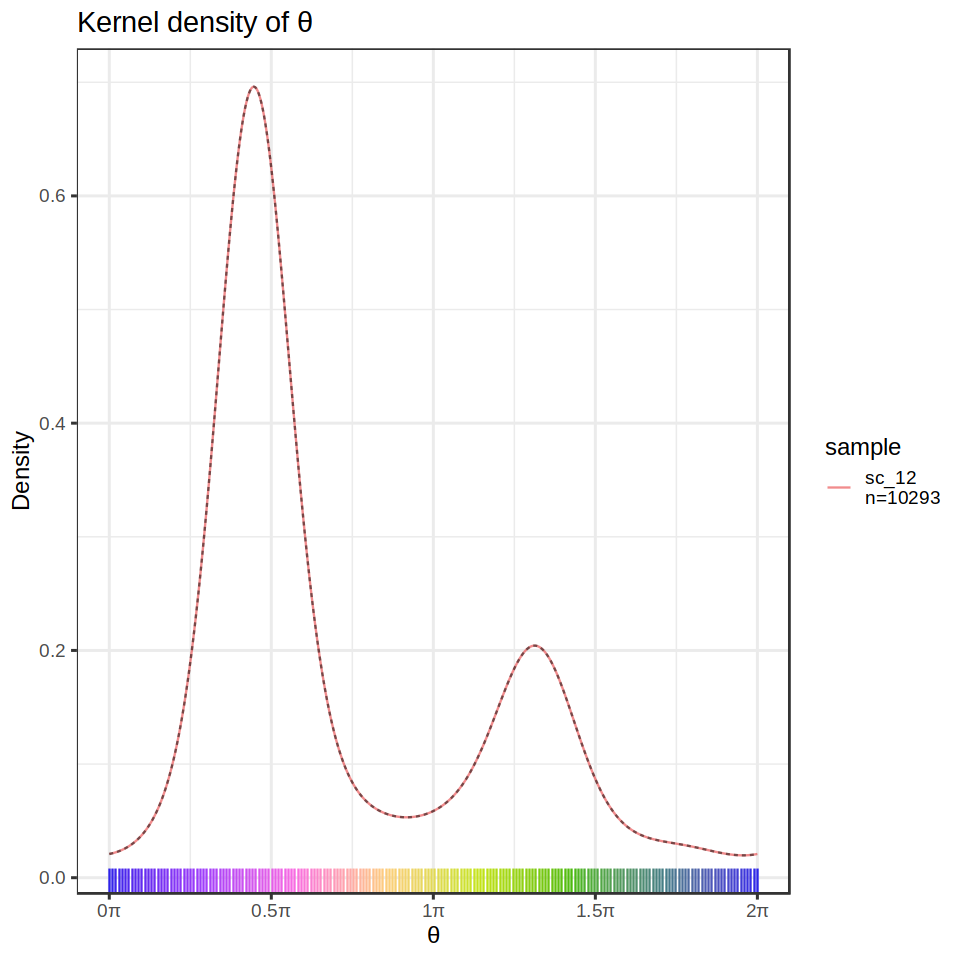

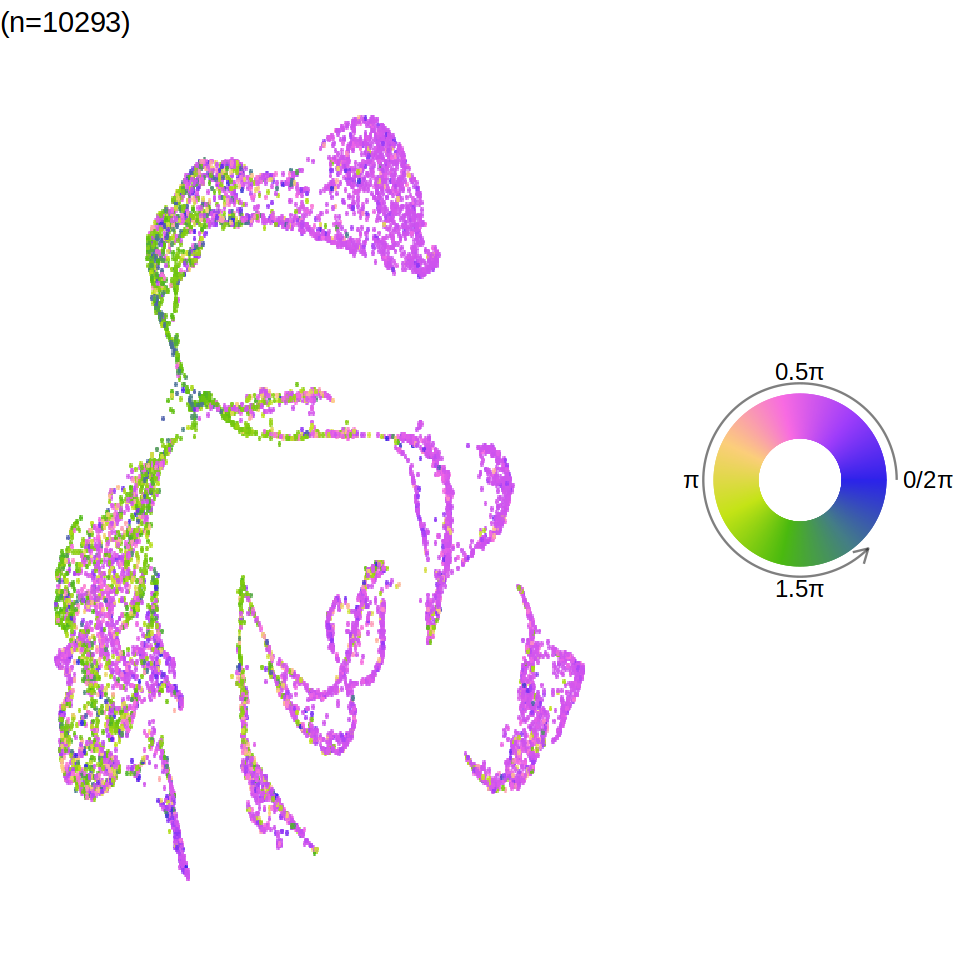

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


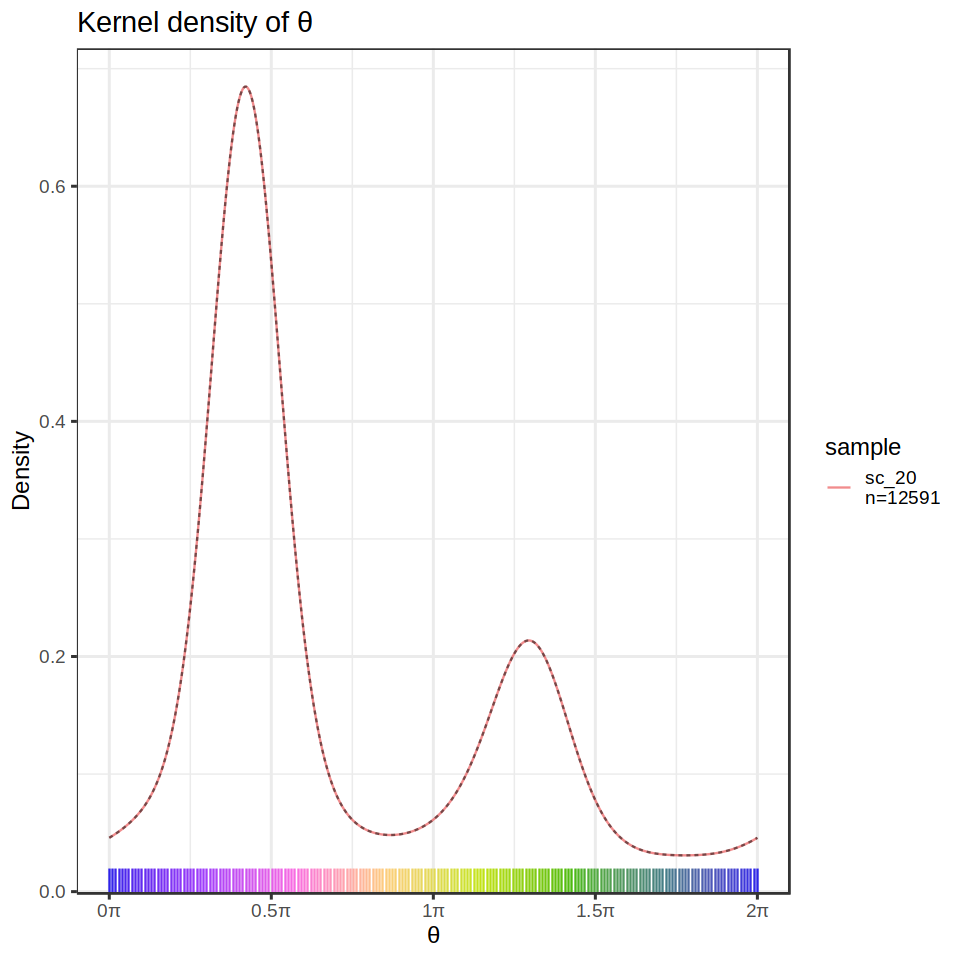

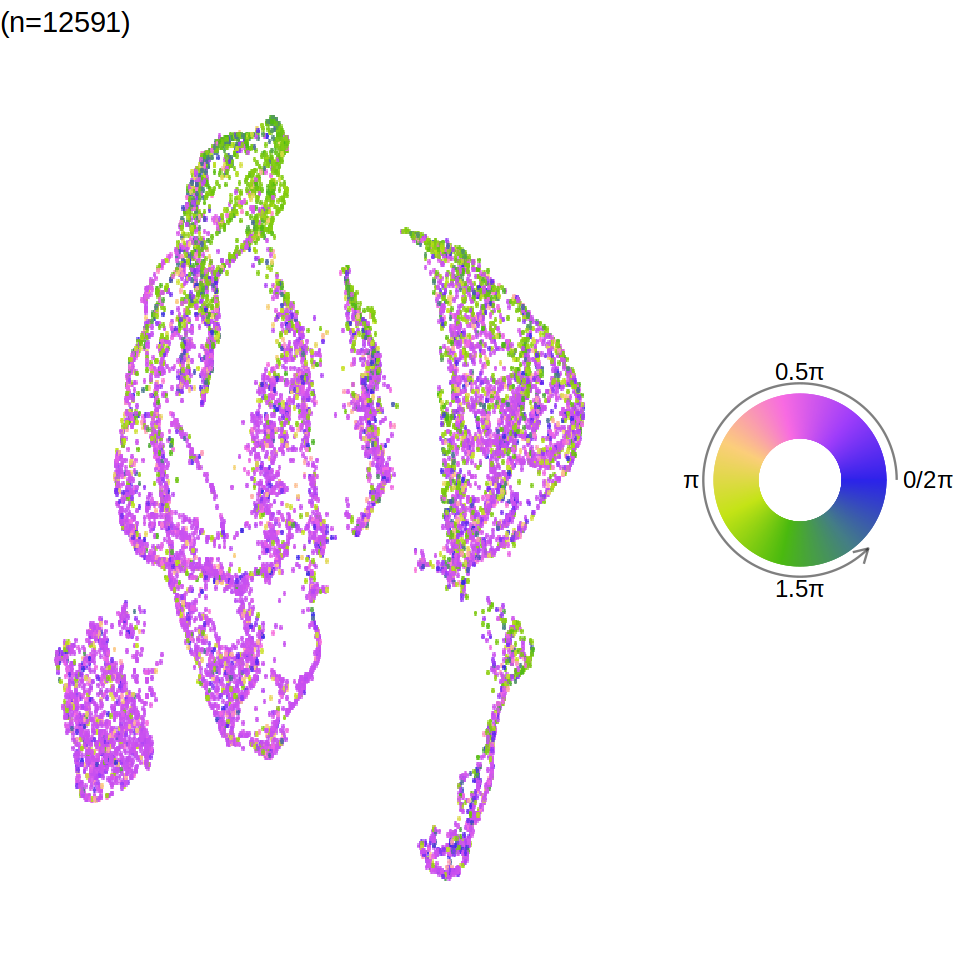

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


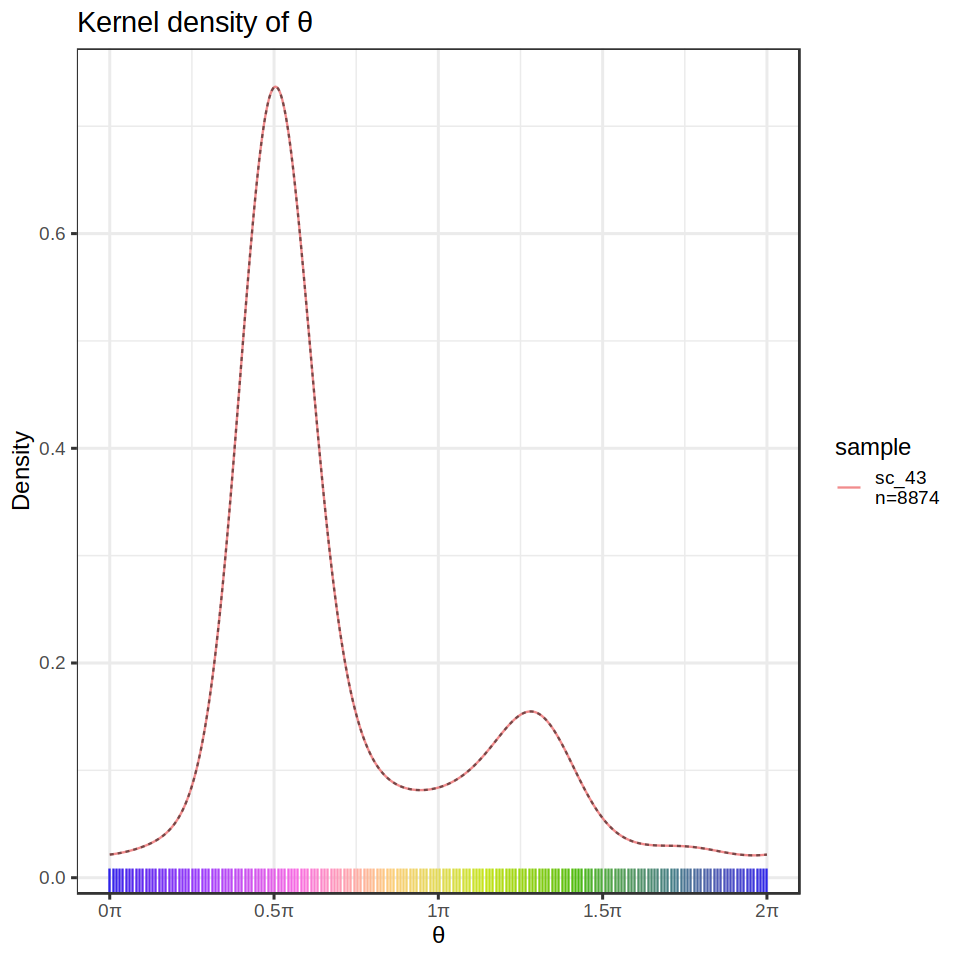

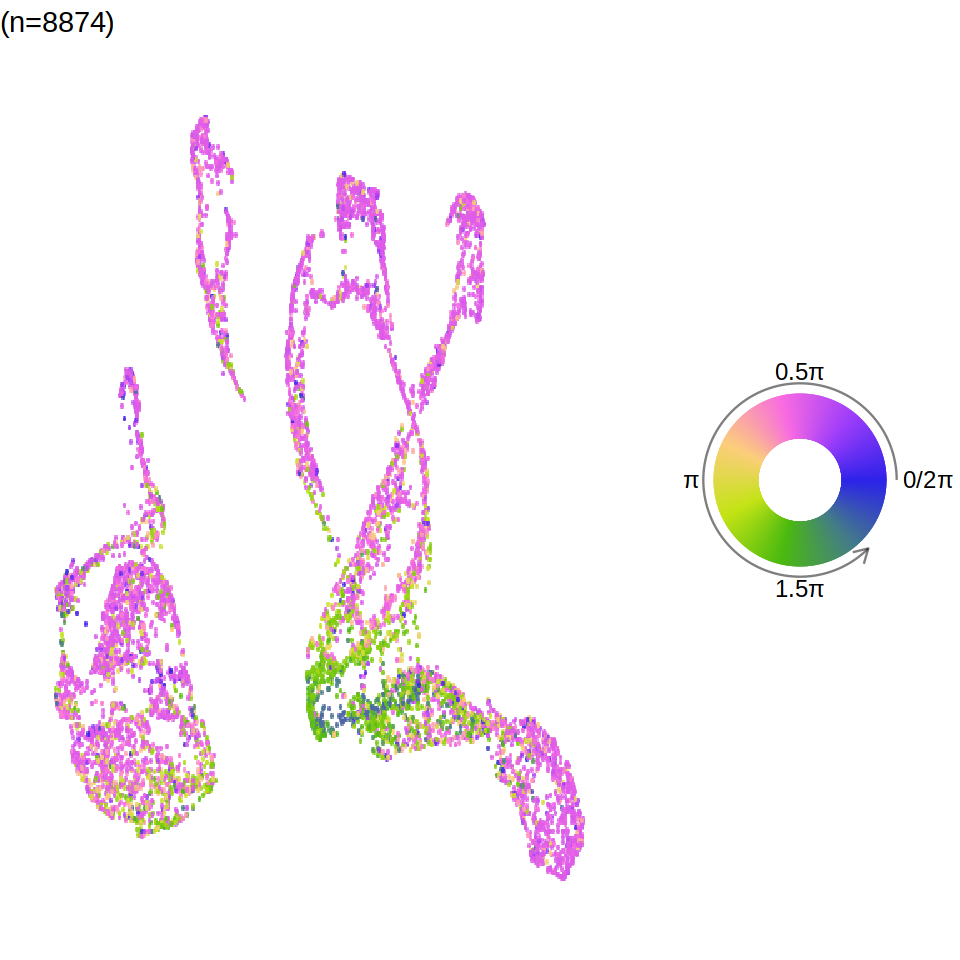

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


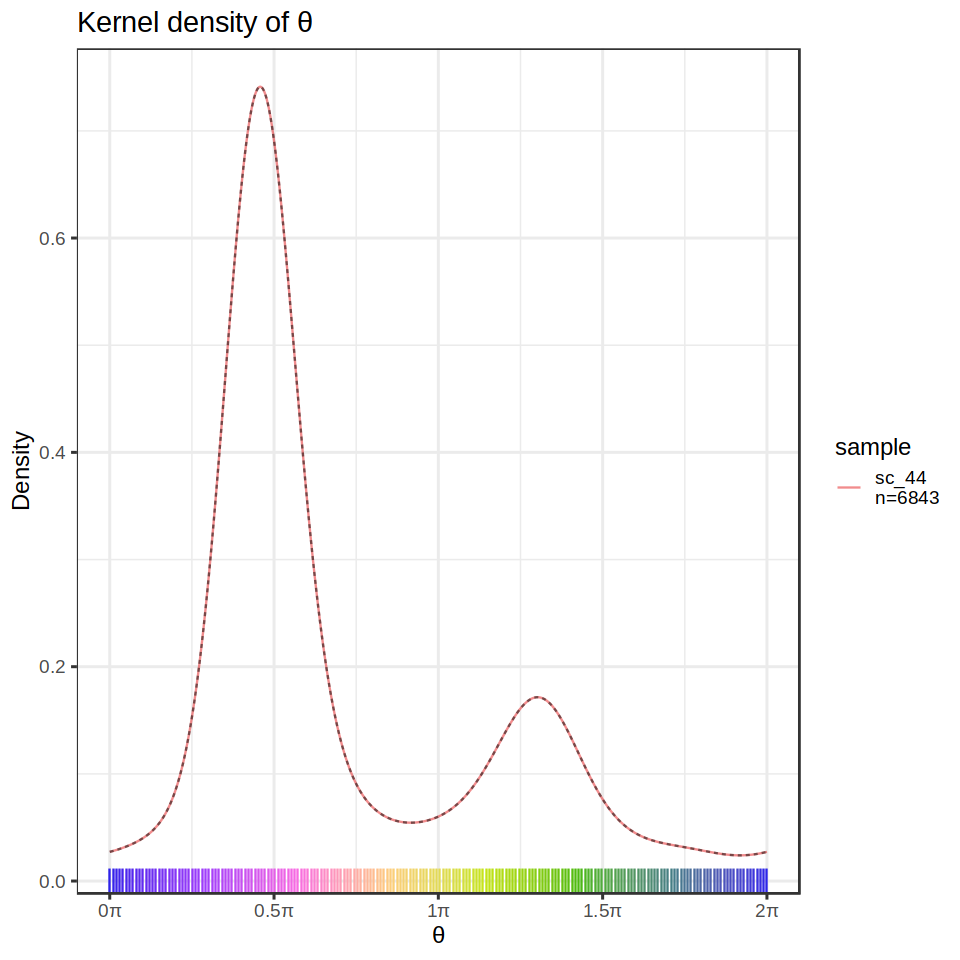

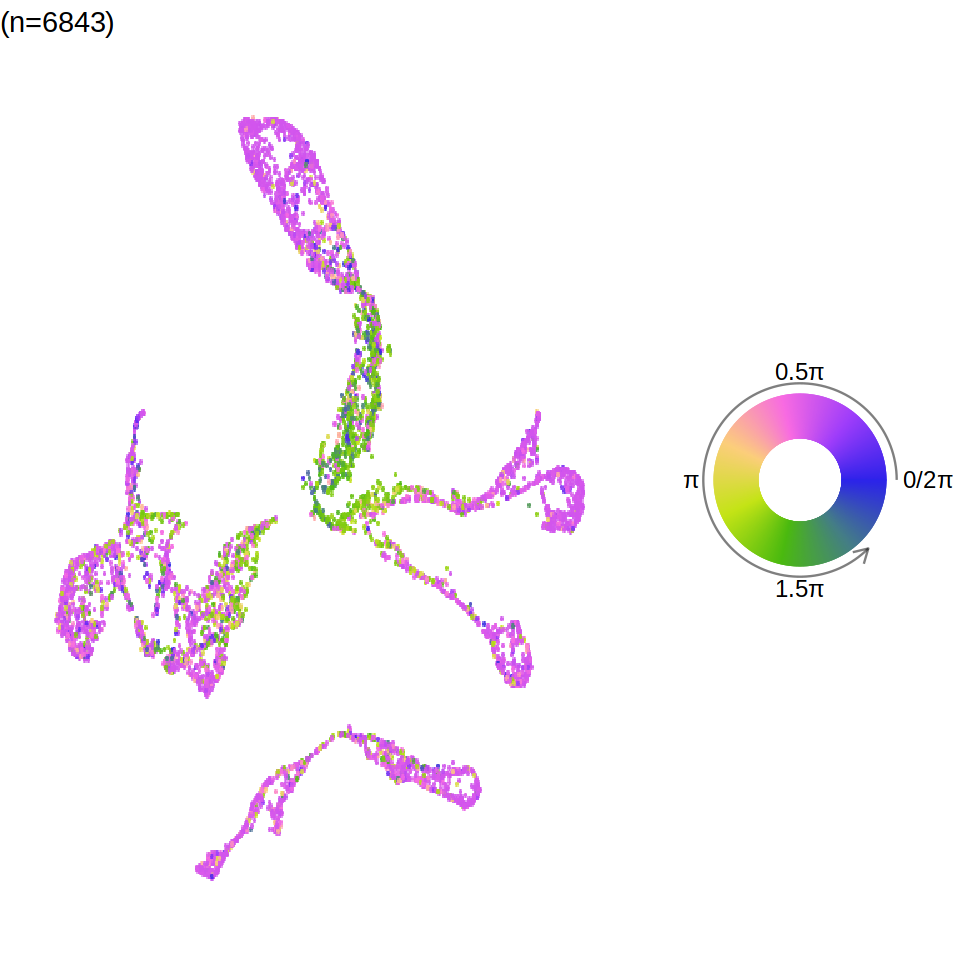

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


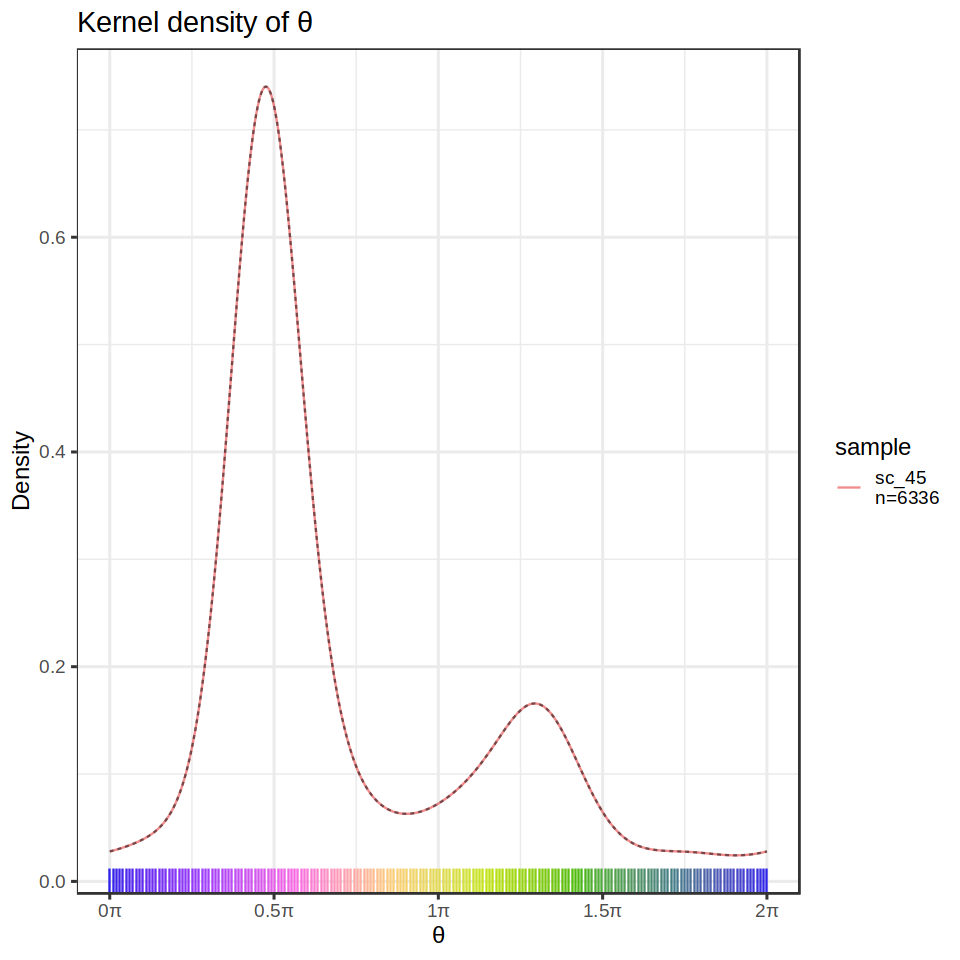

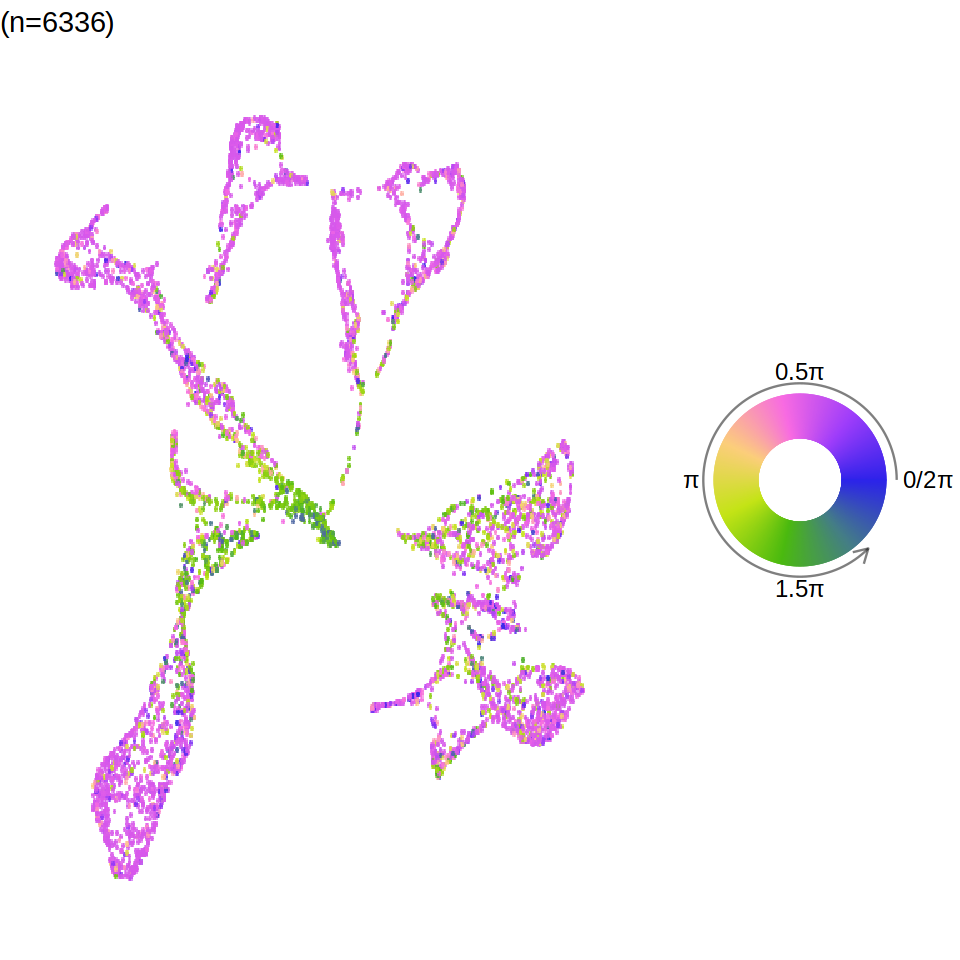

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


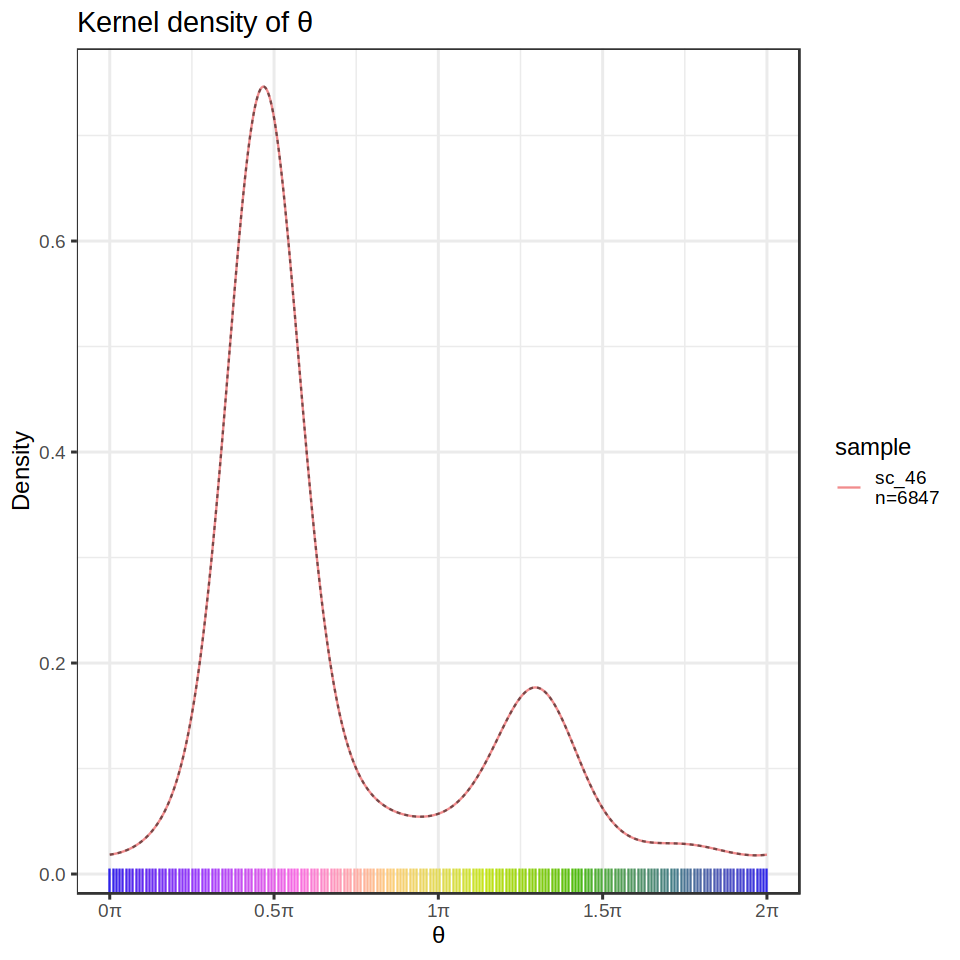

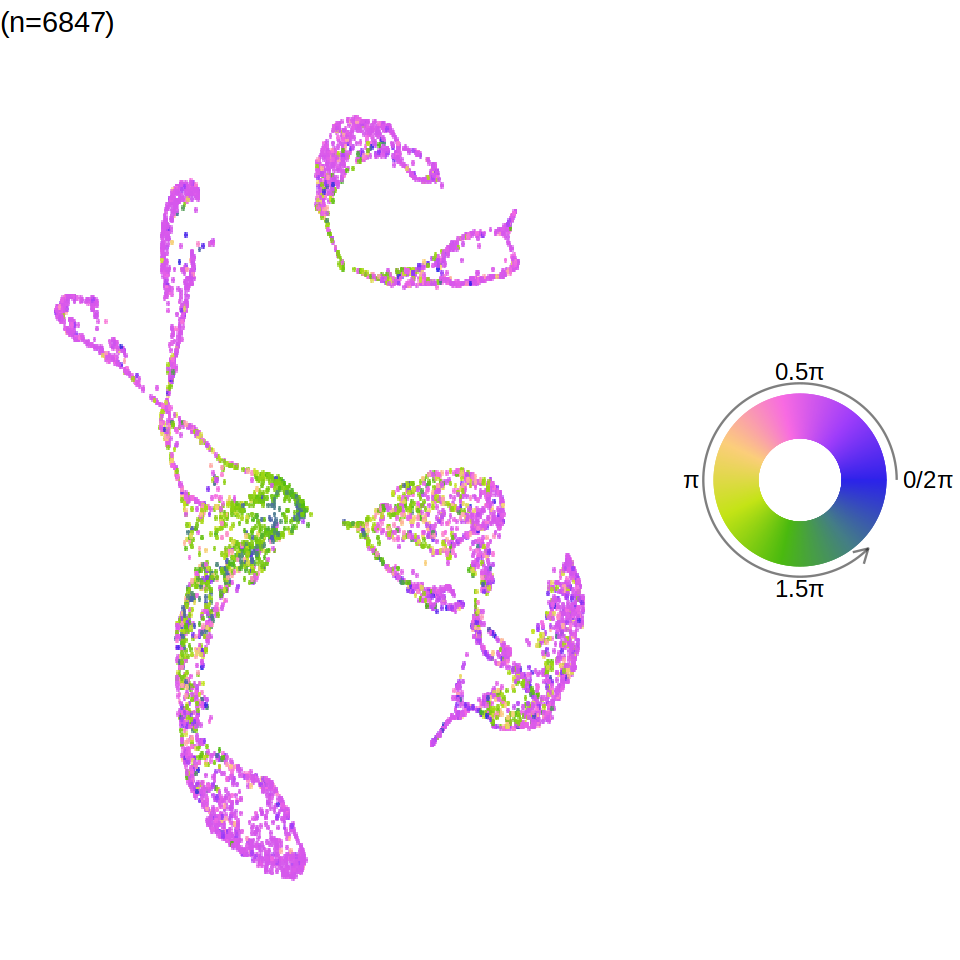

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


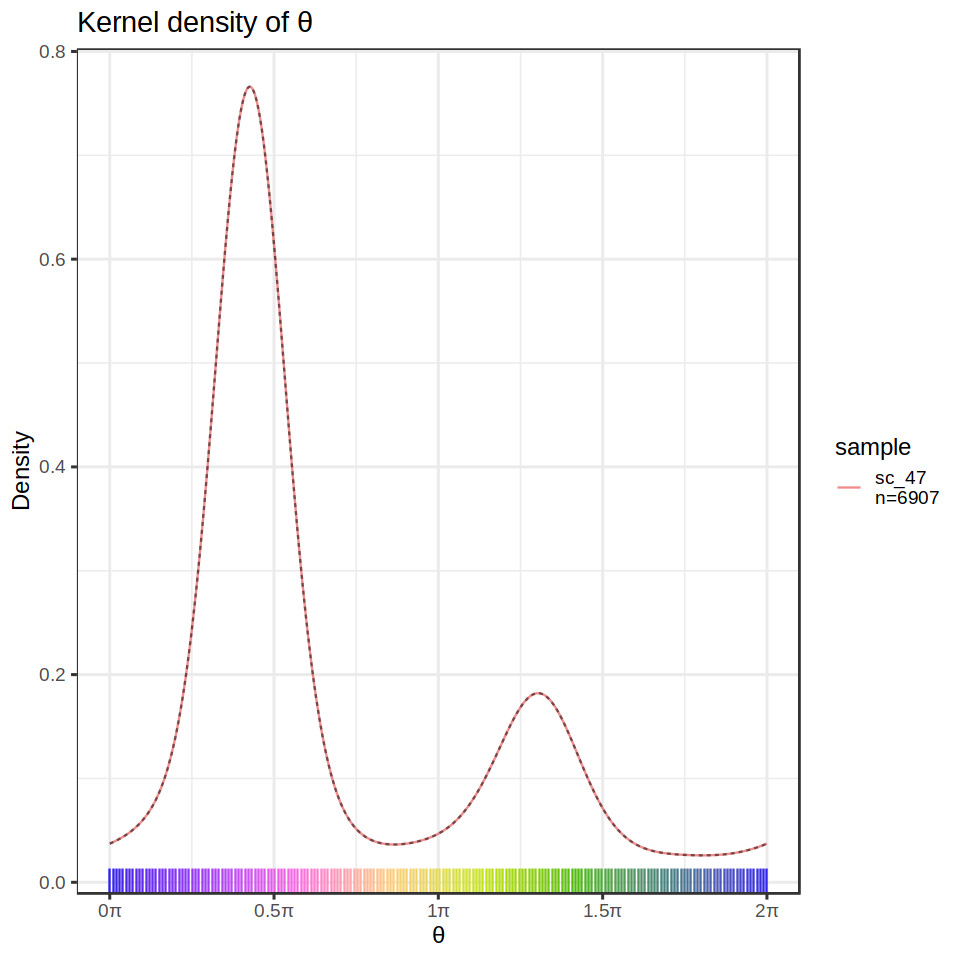

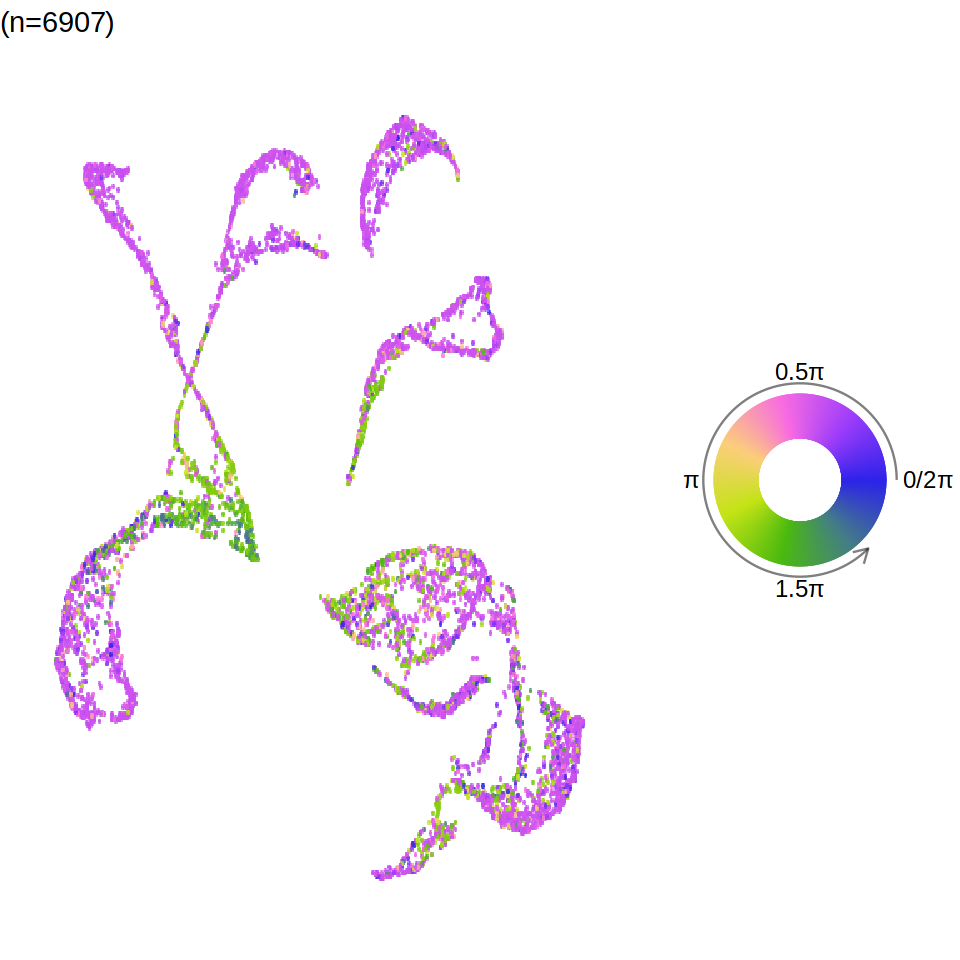

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


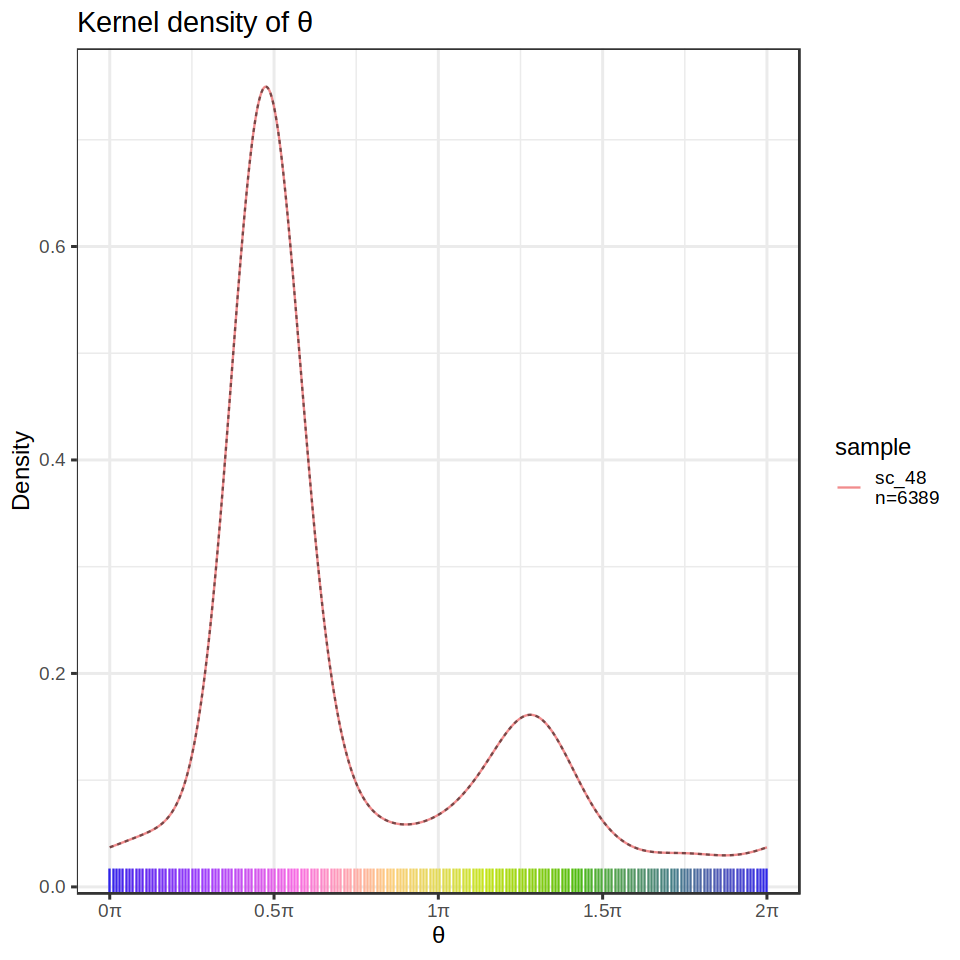

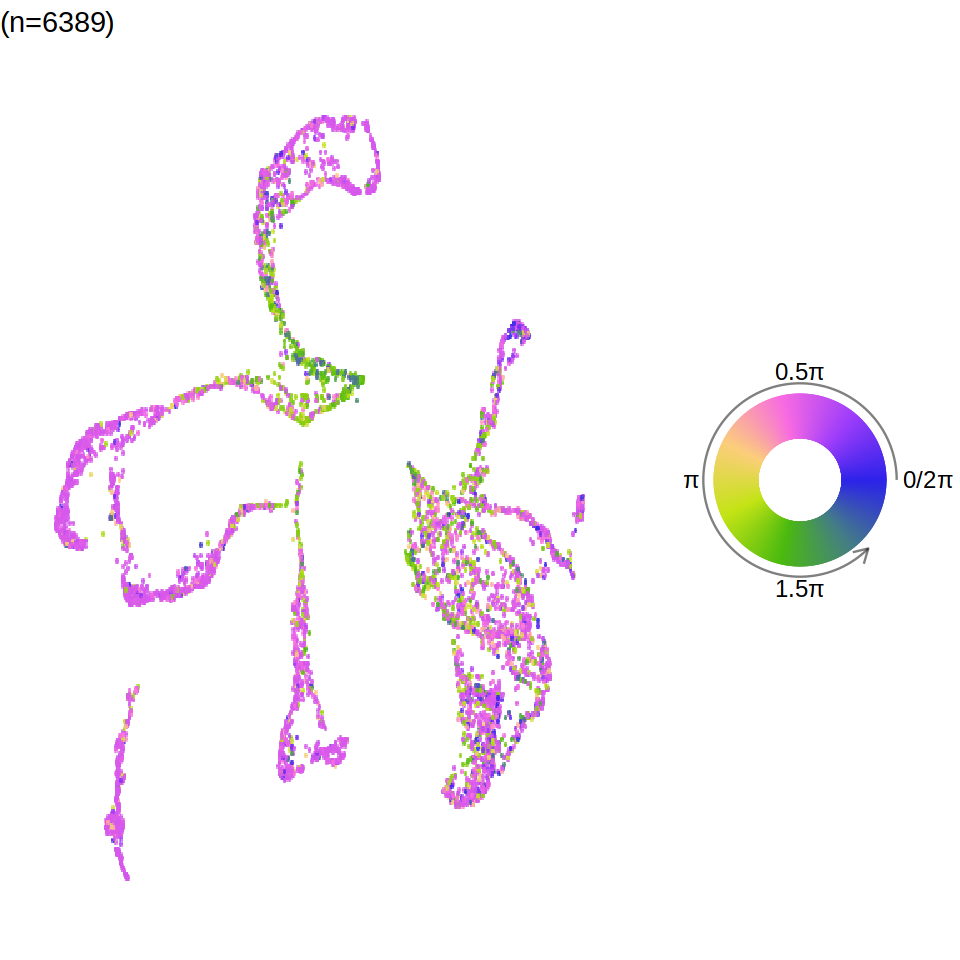

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


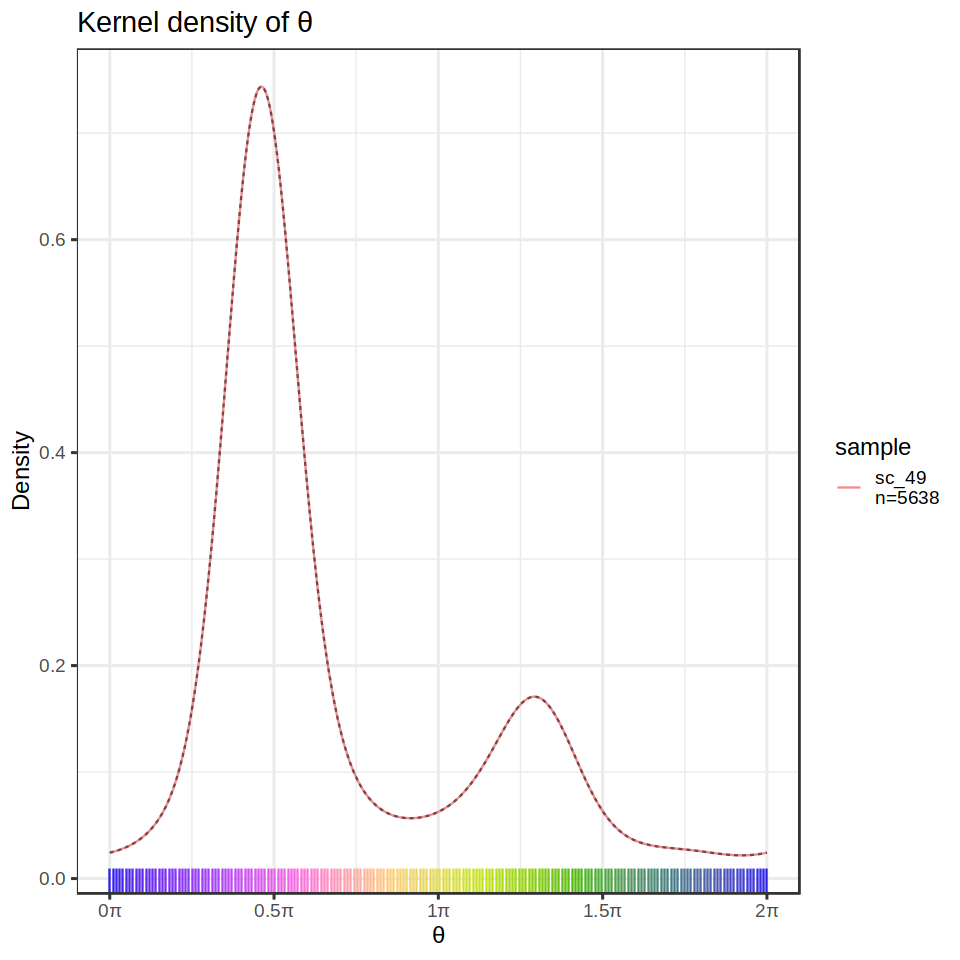

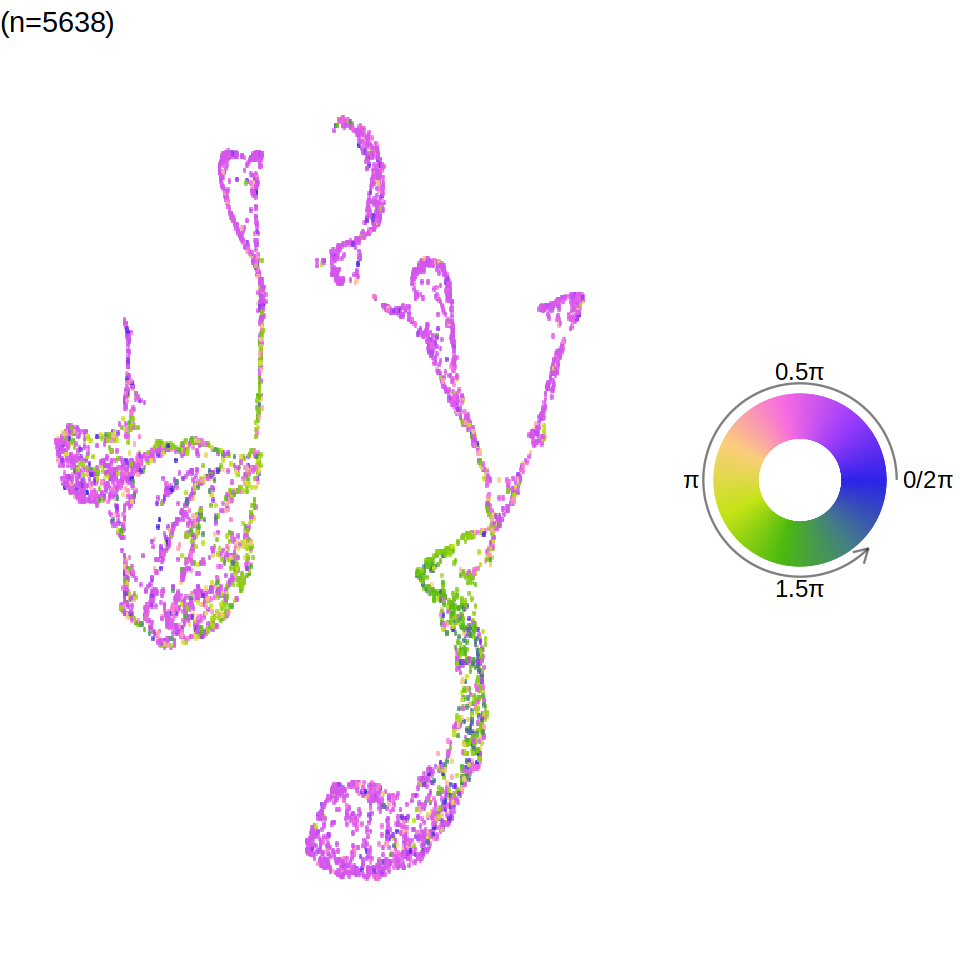

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


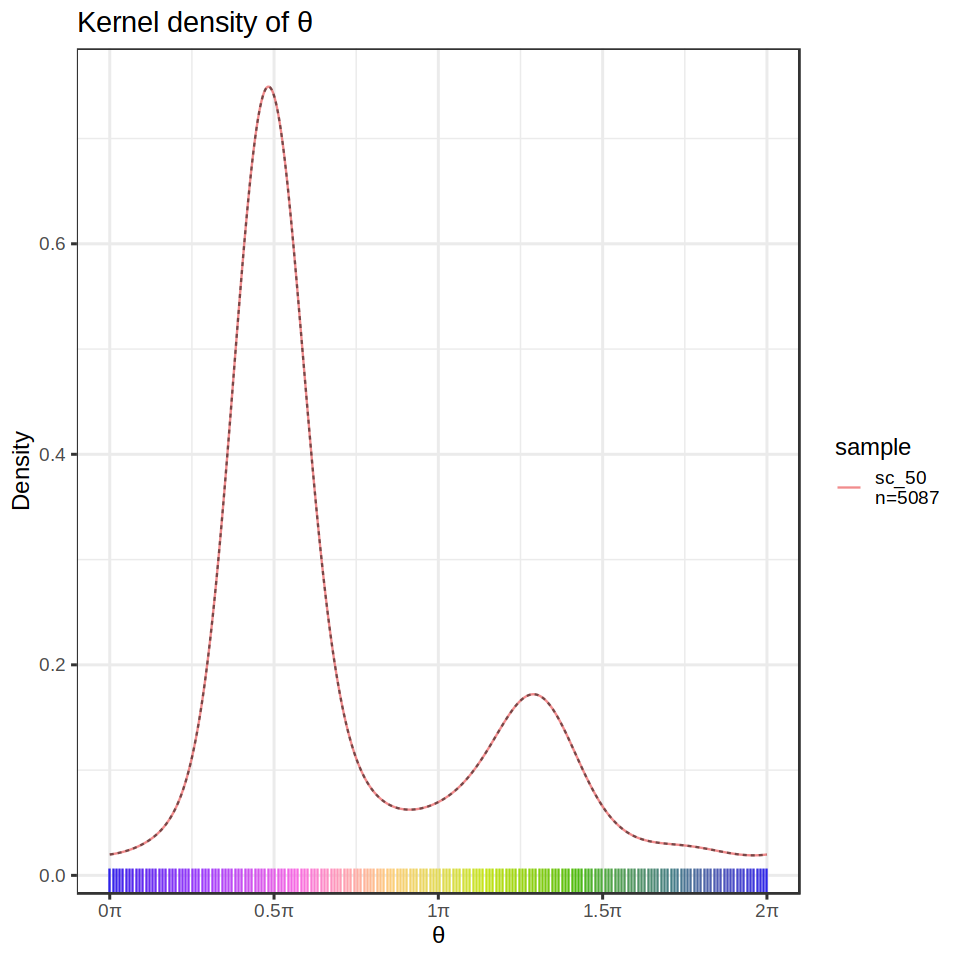

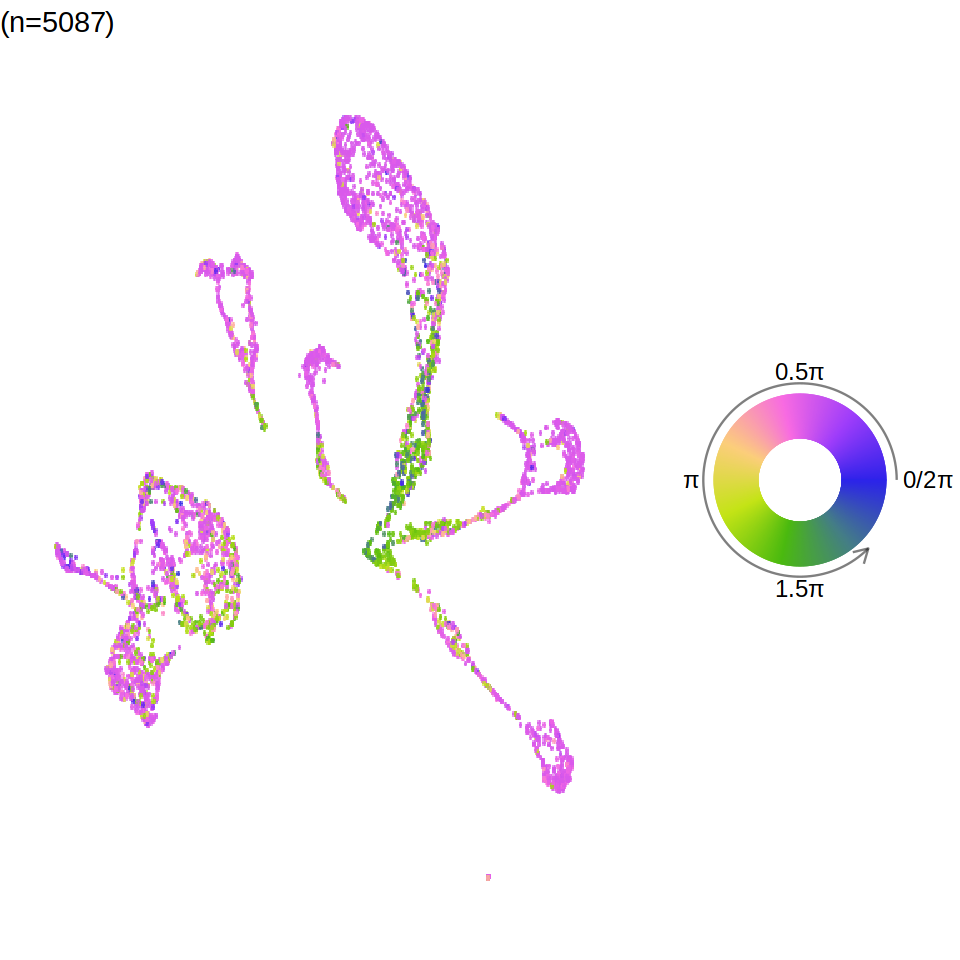

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


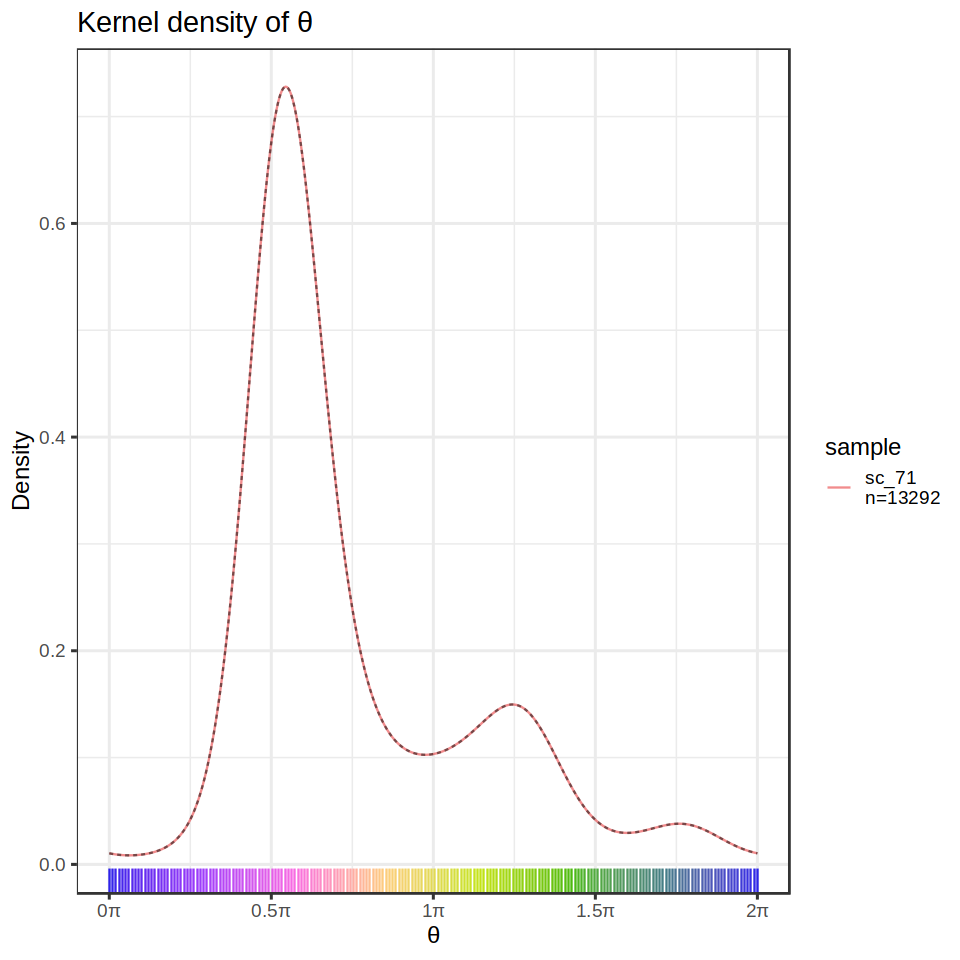

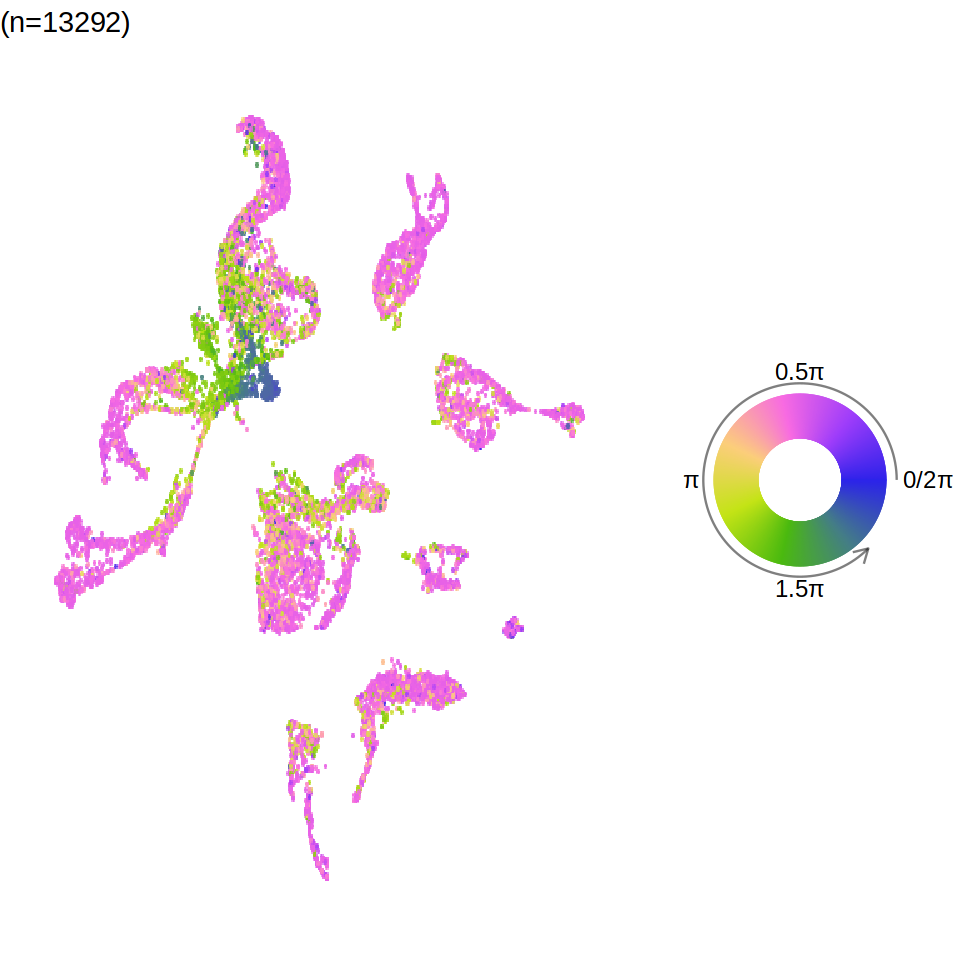

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


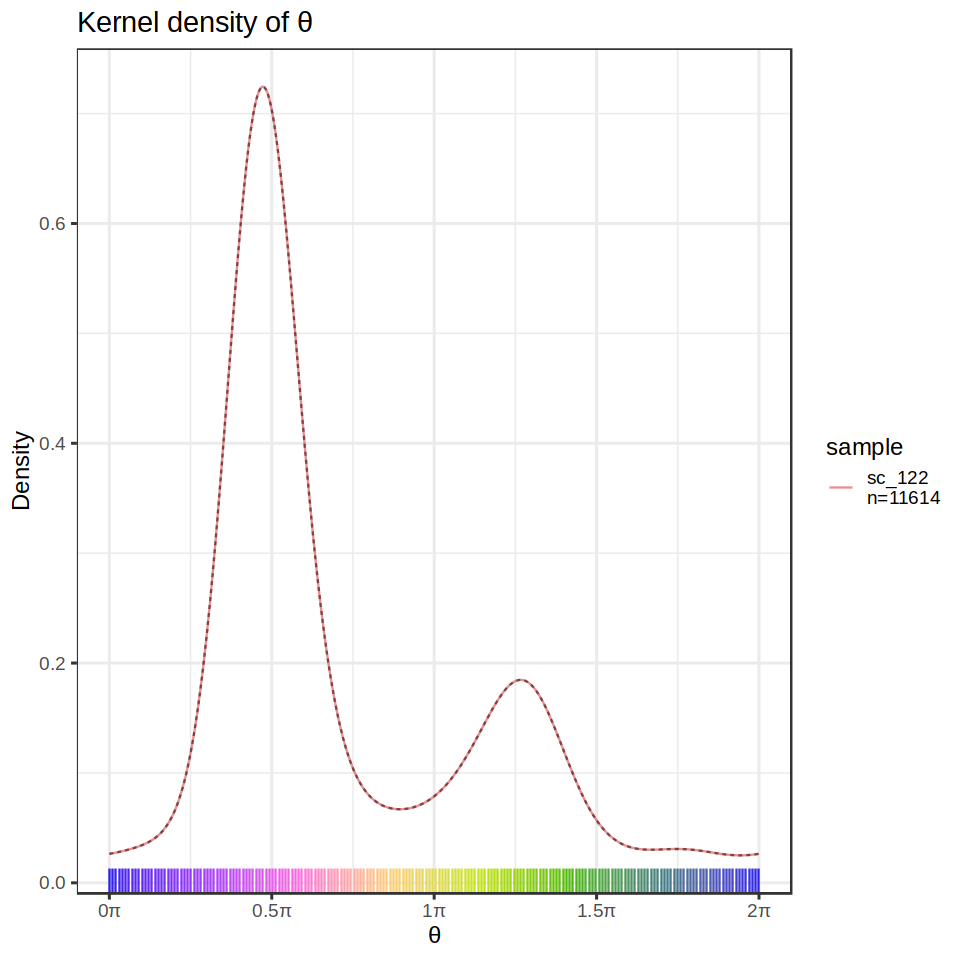

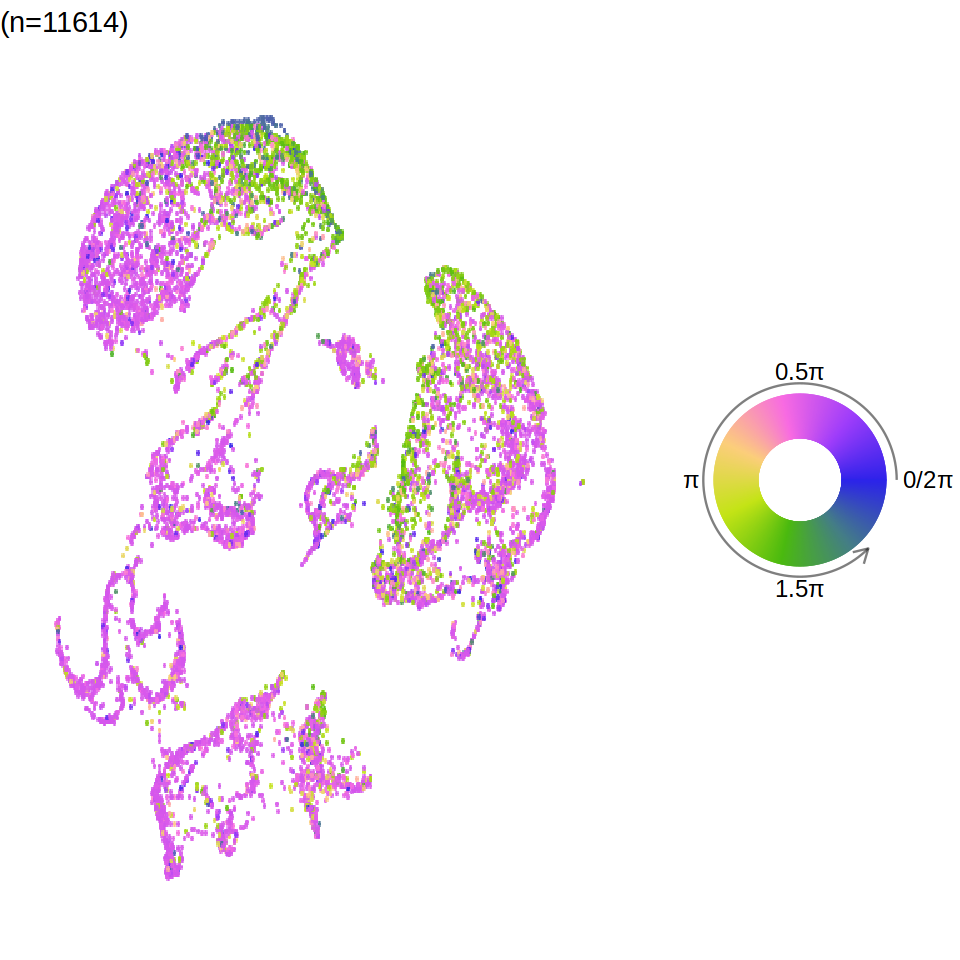

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


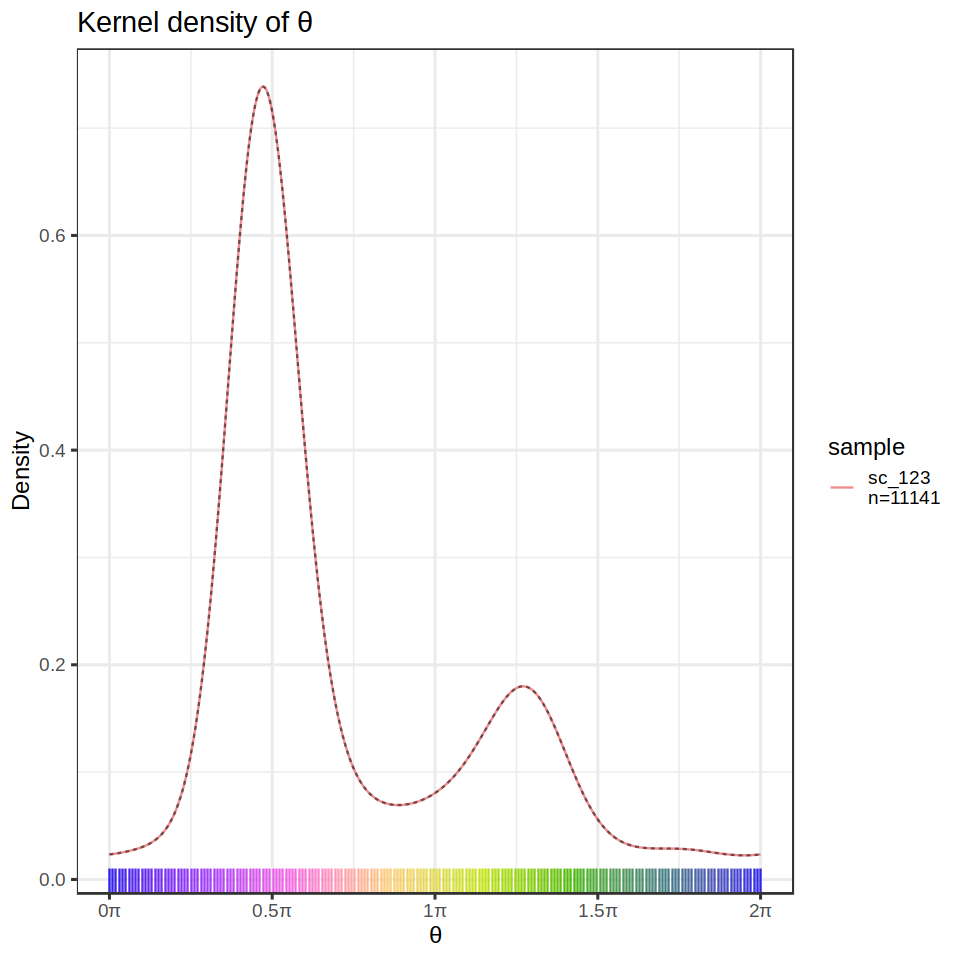

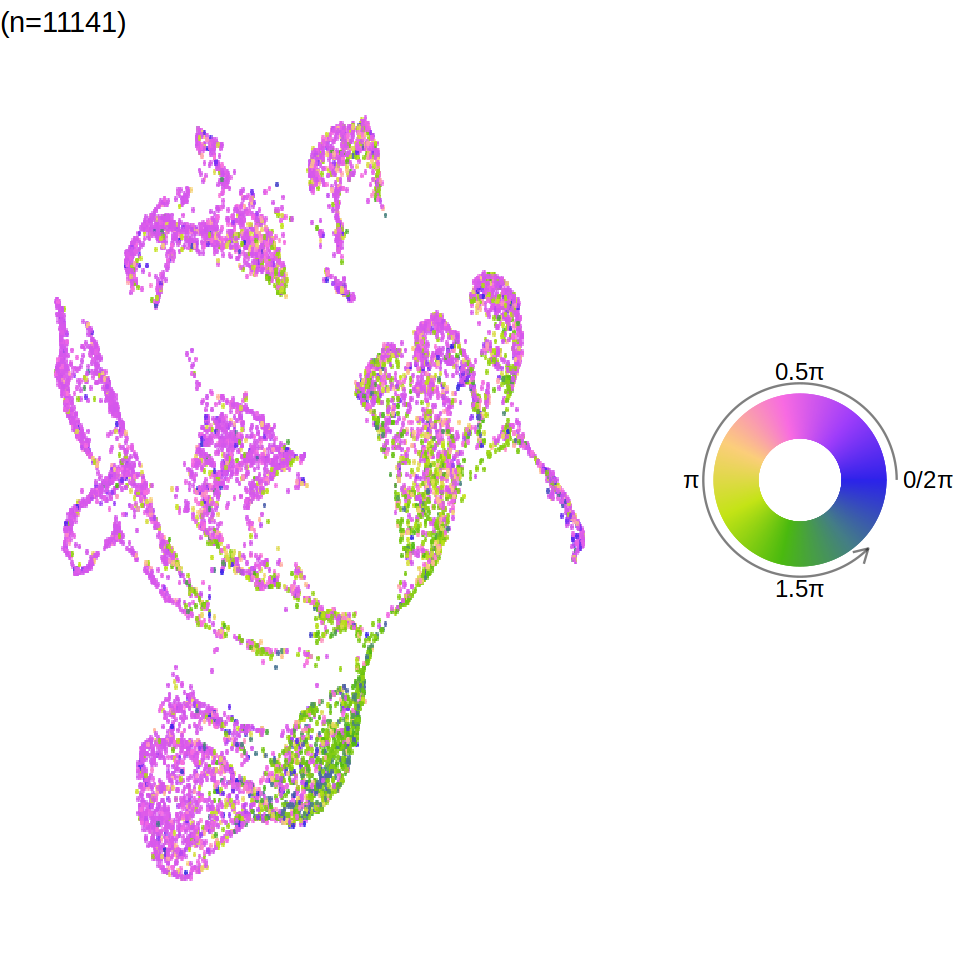

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


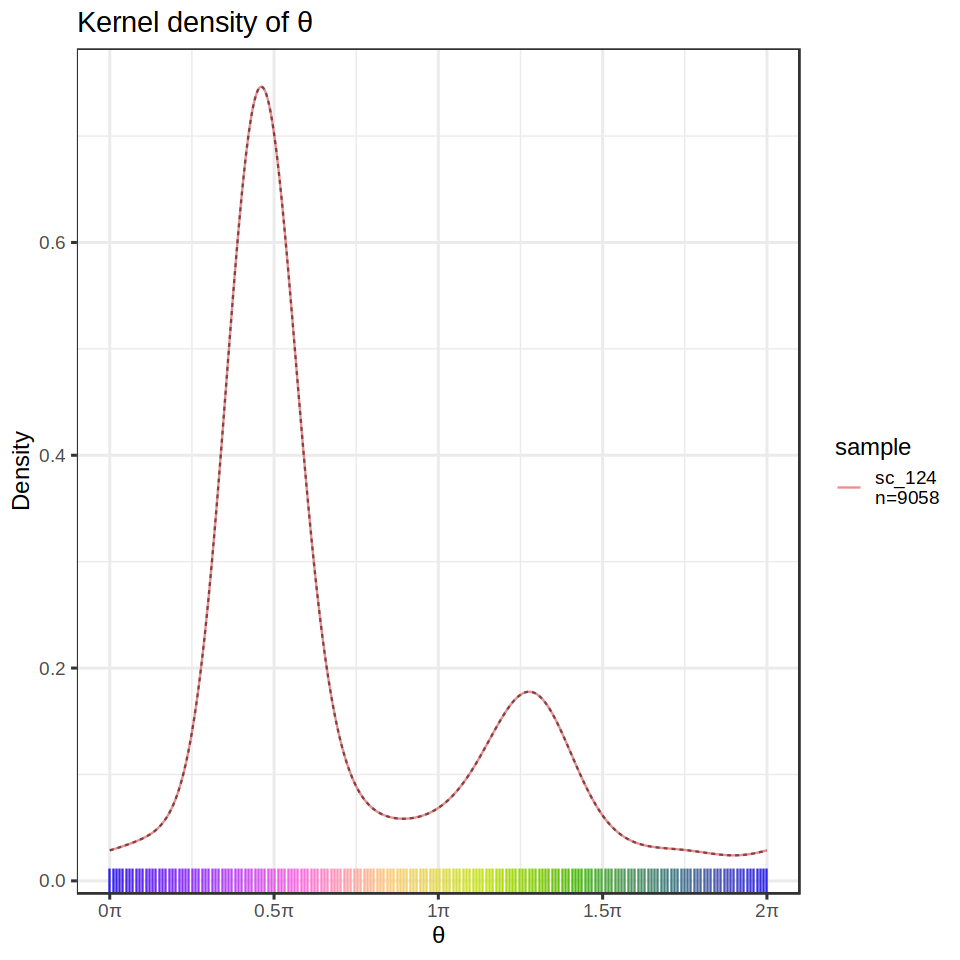

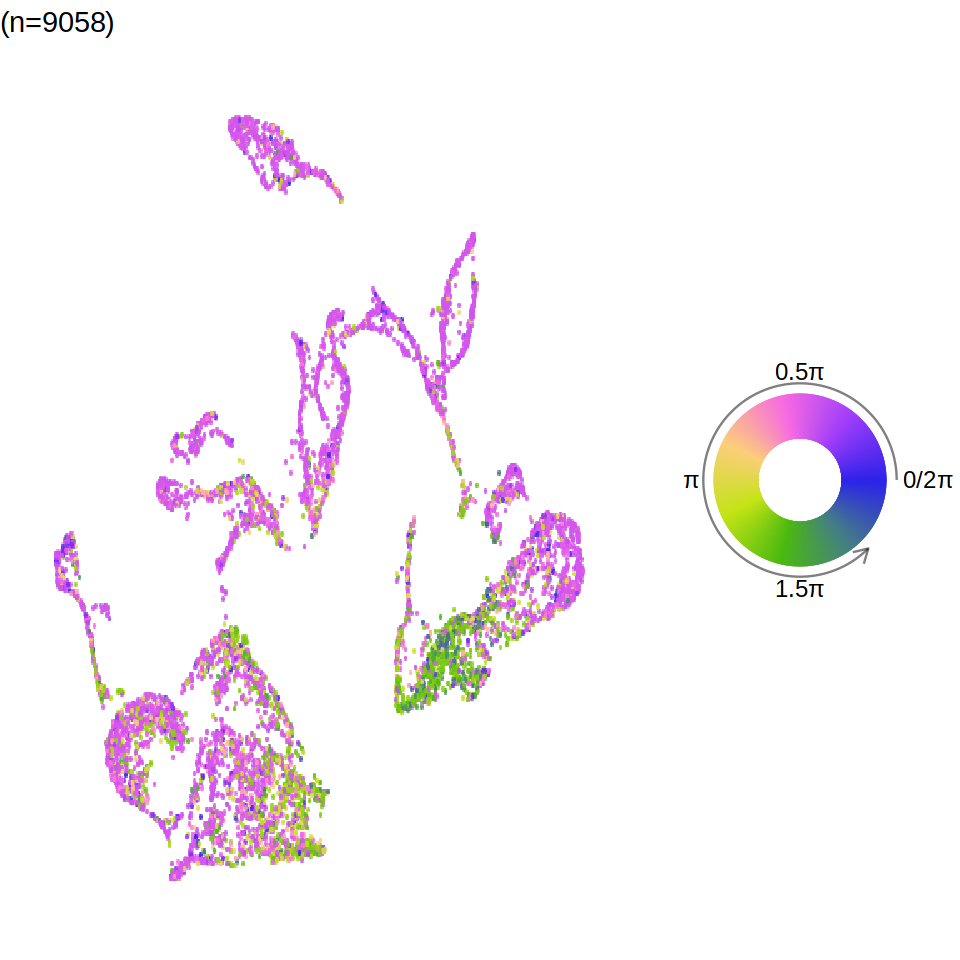

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


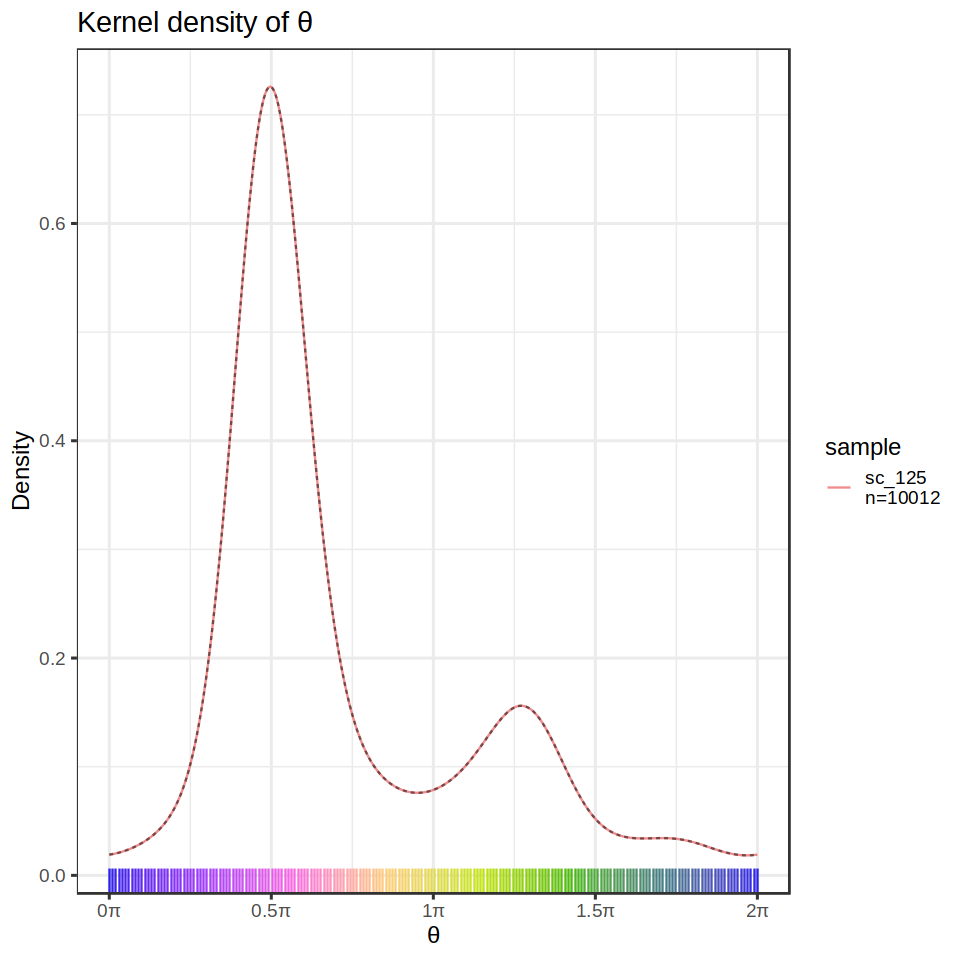

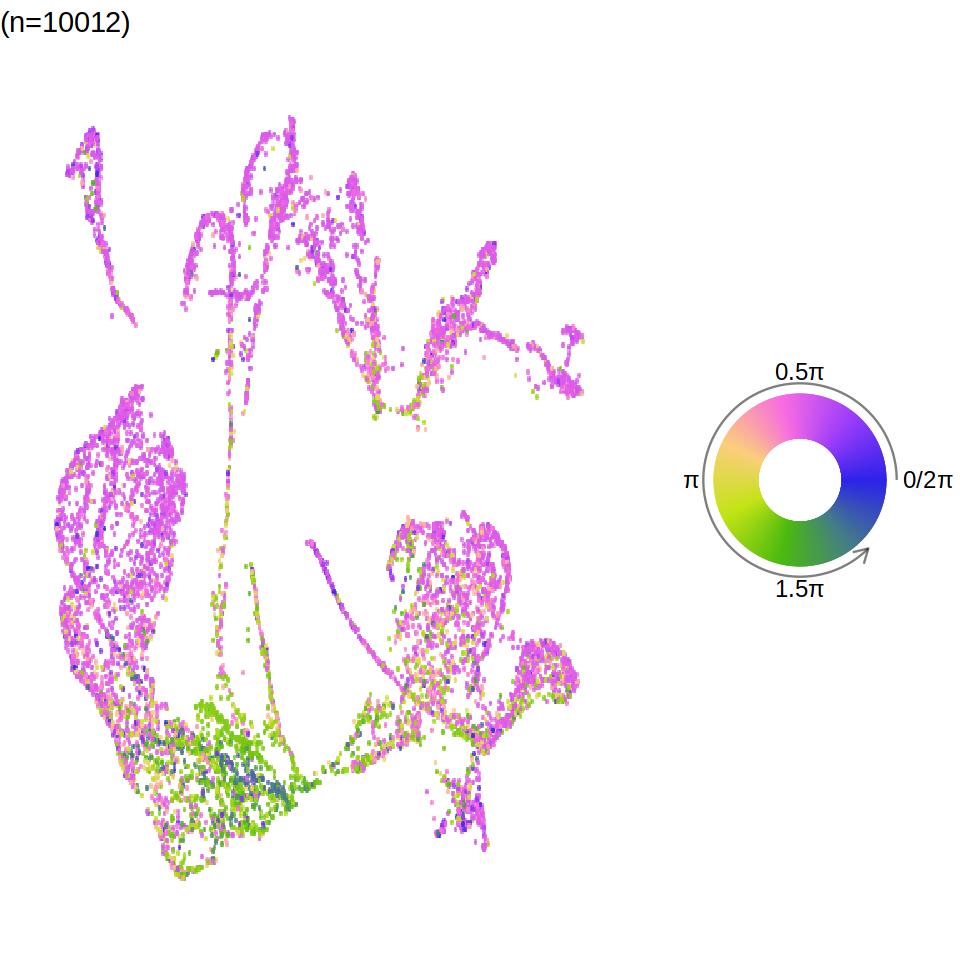

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


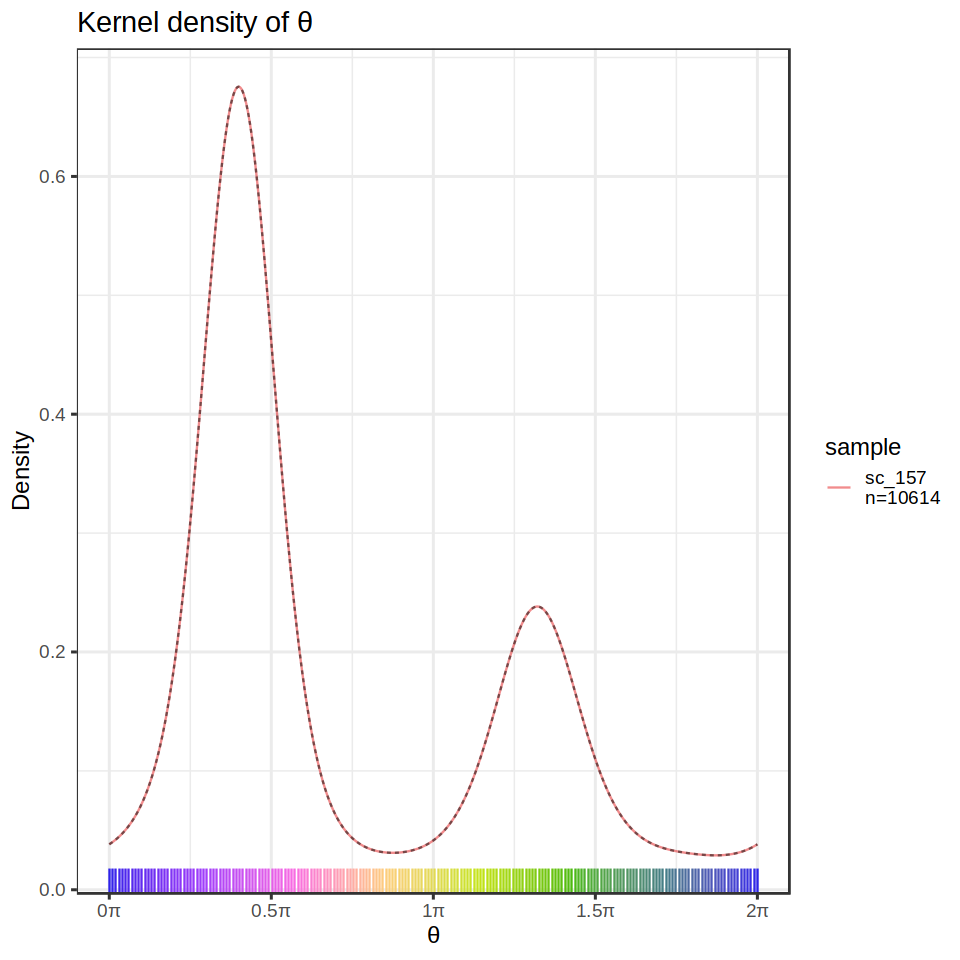

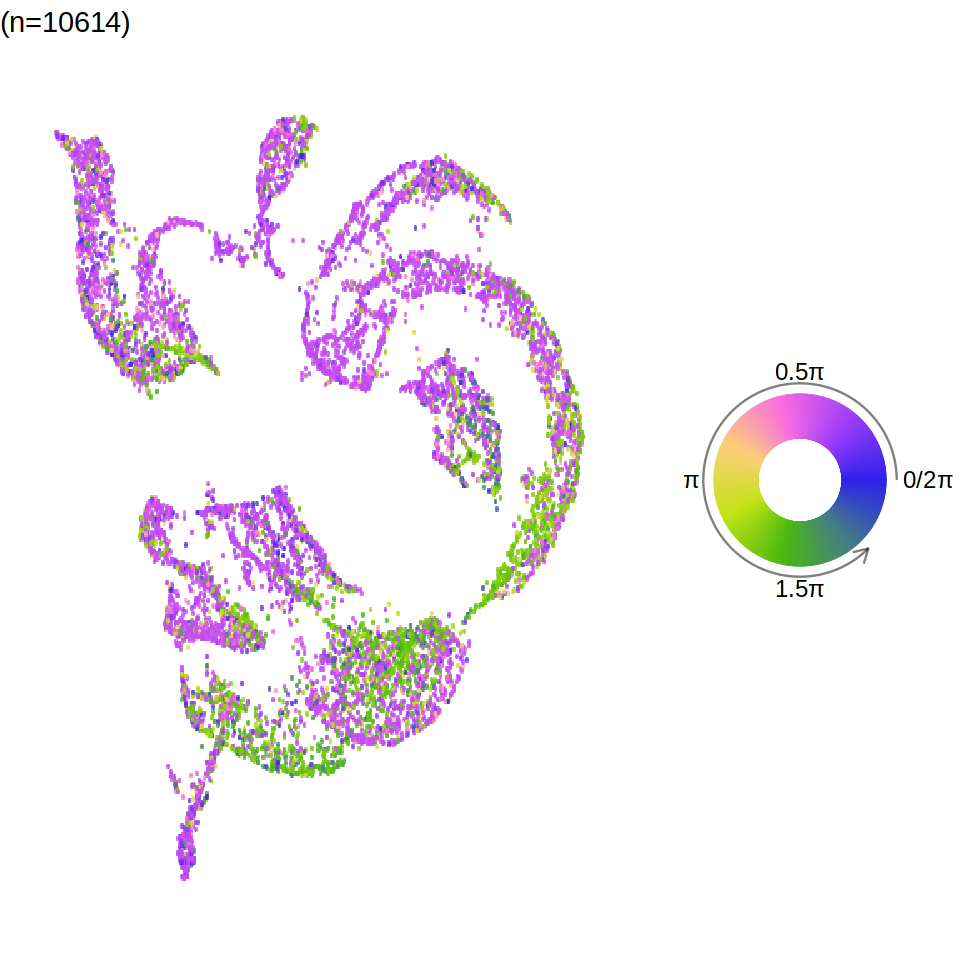

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


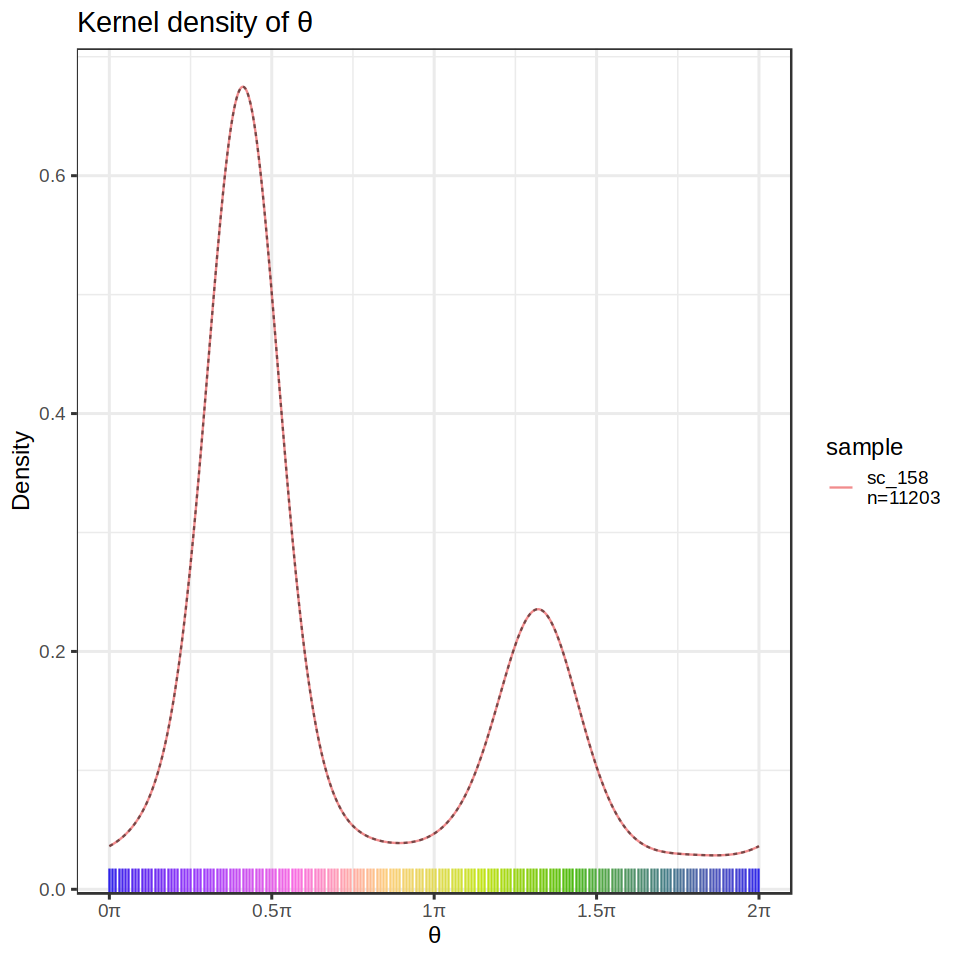

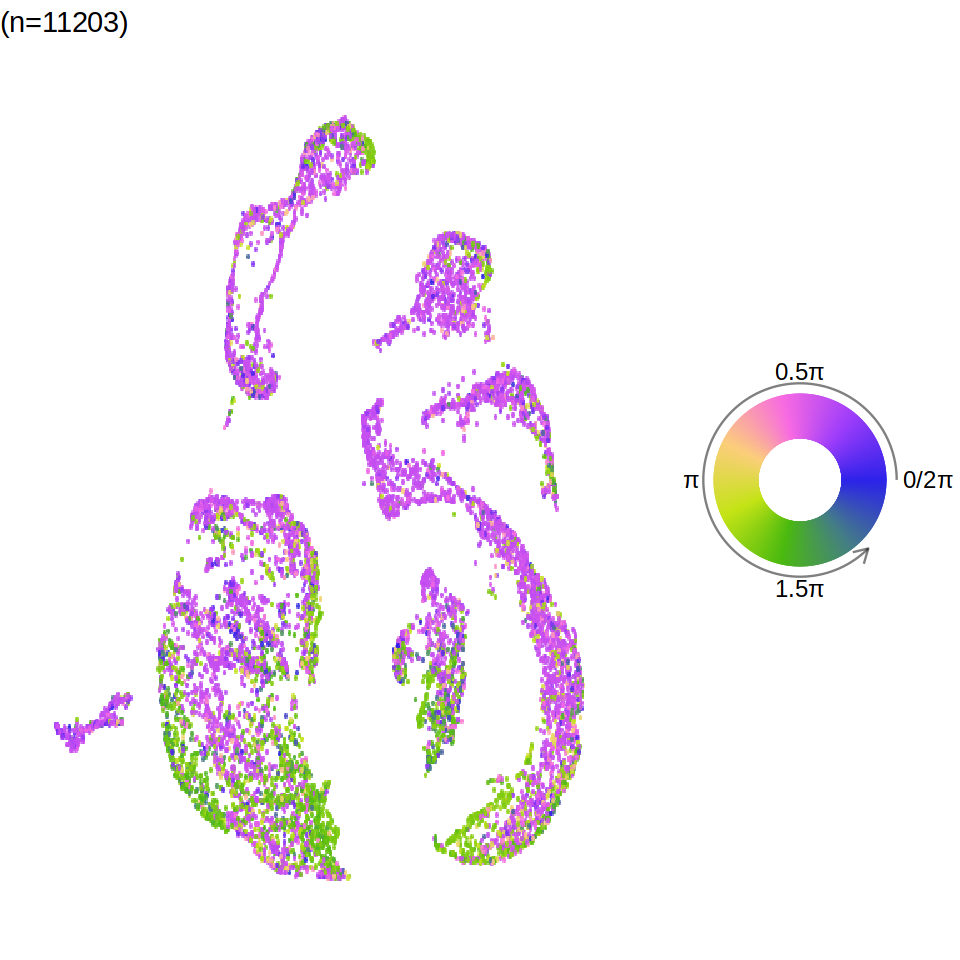

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


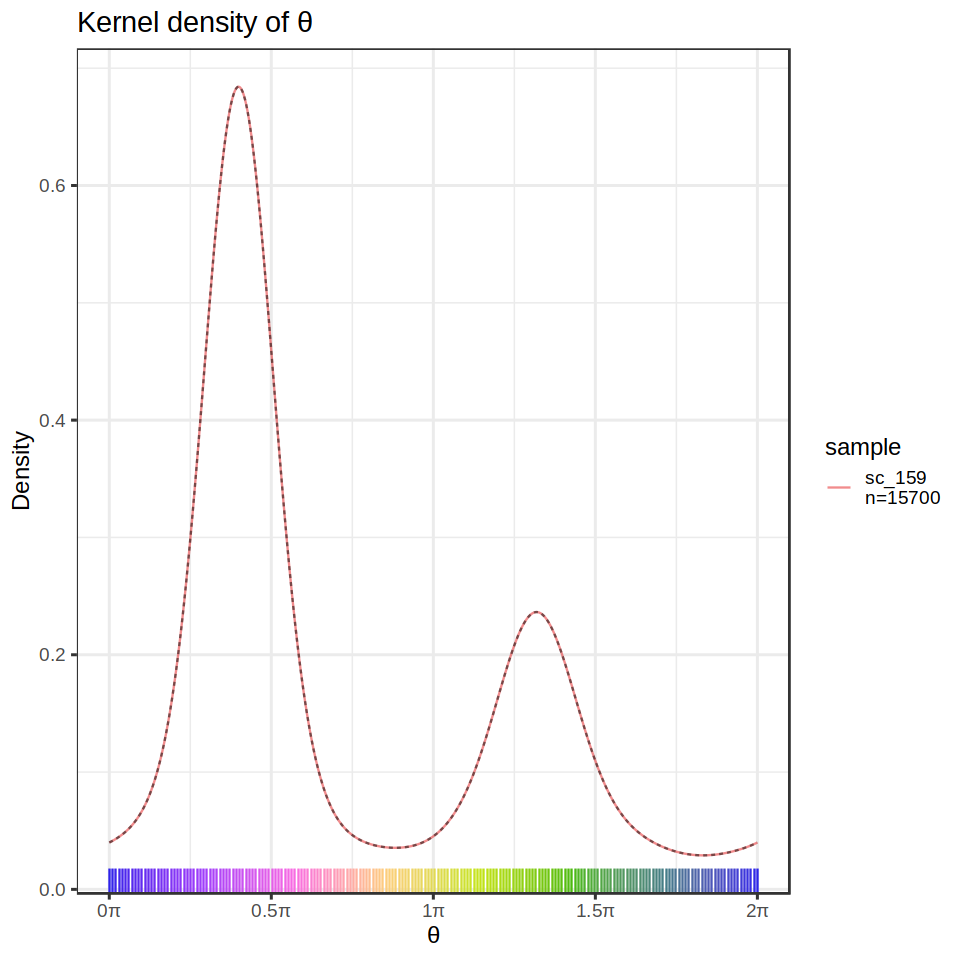

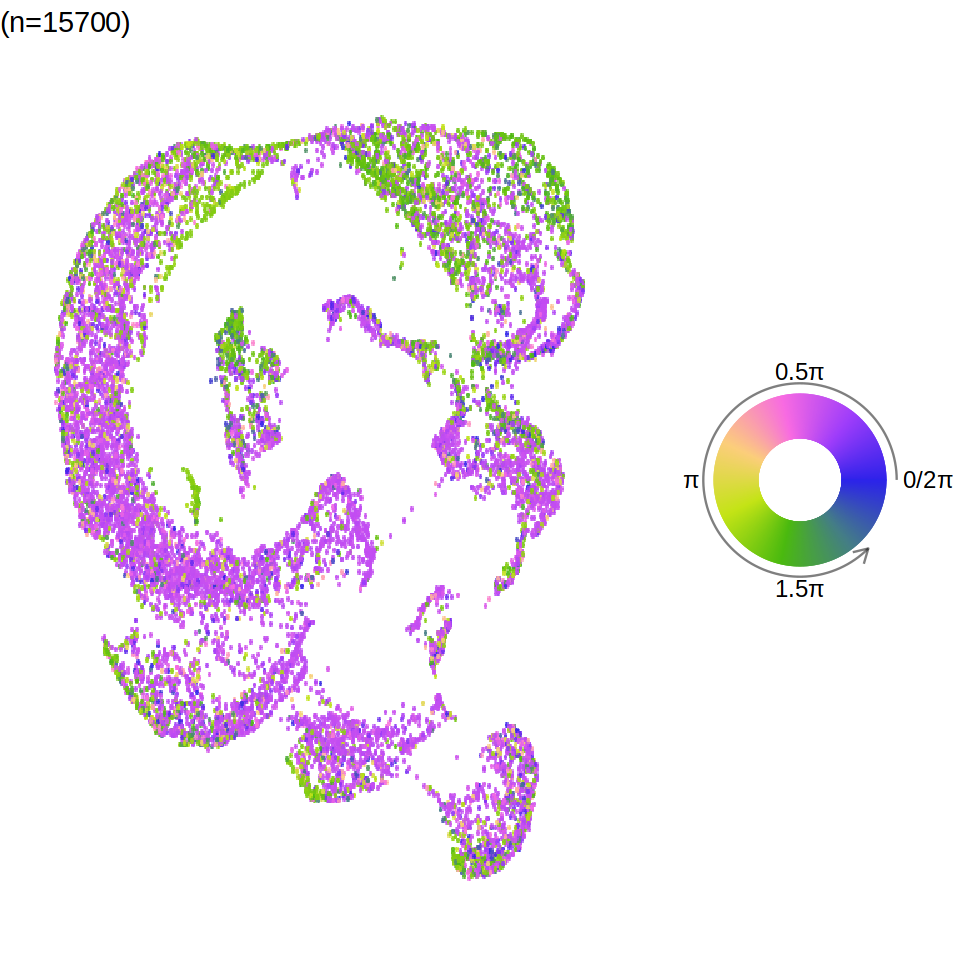

The number of projection genes found in the new data is 240.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


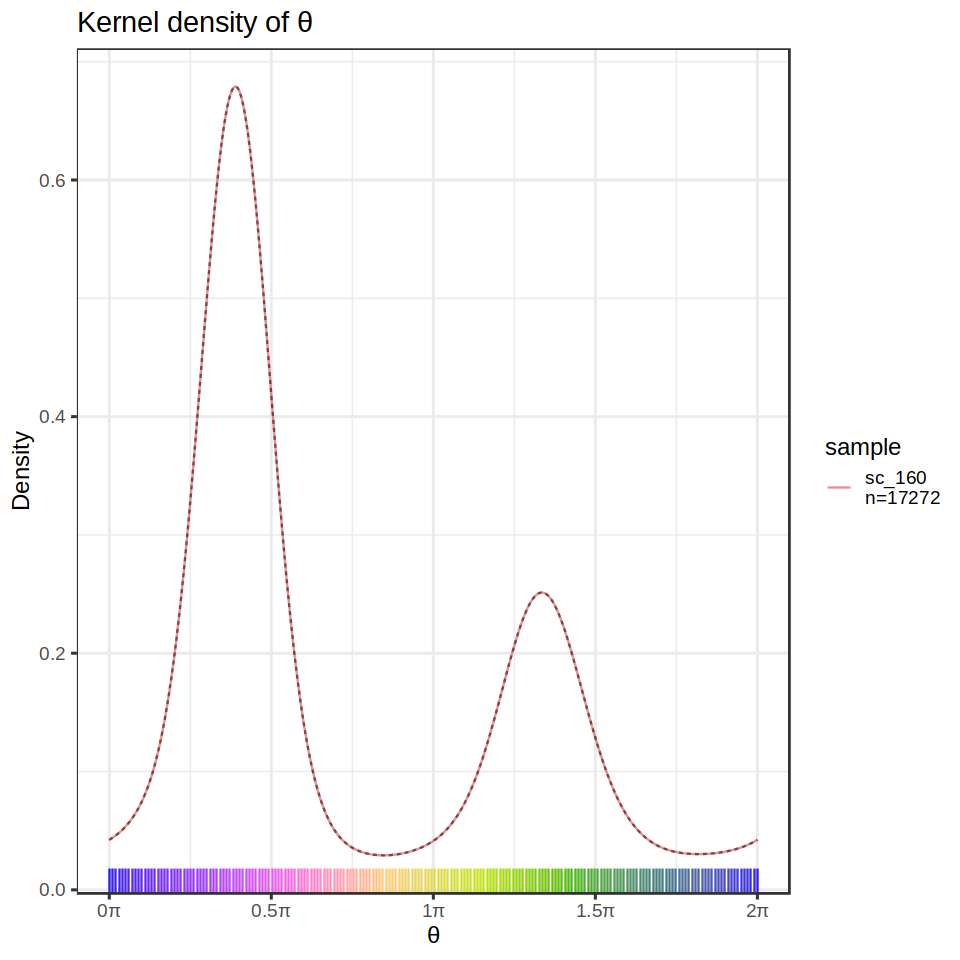

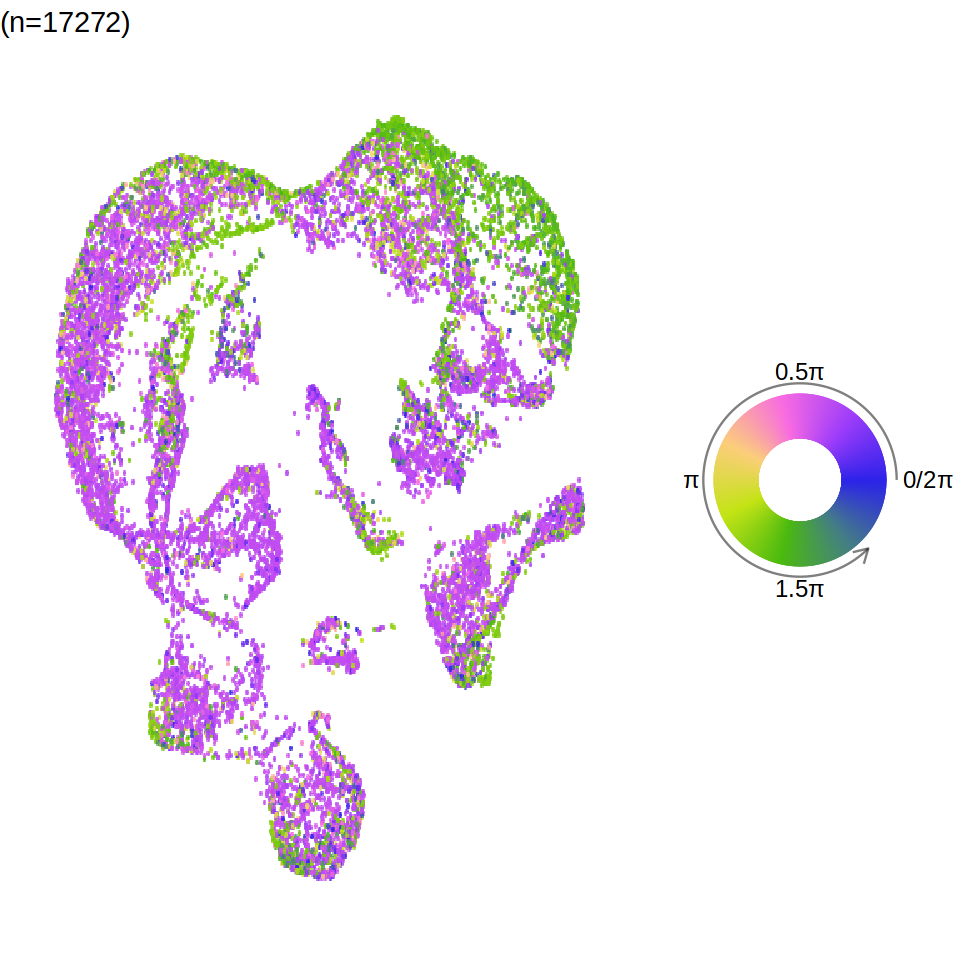

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


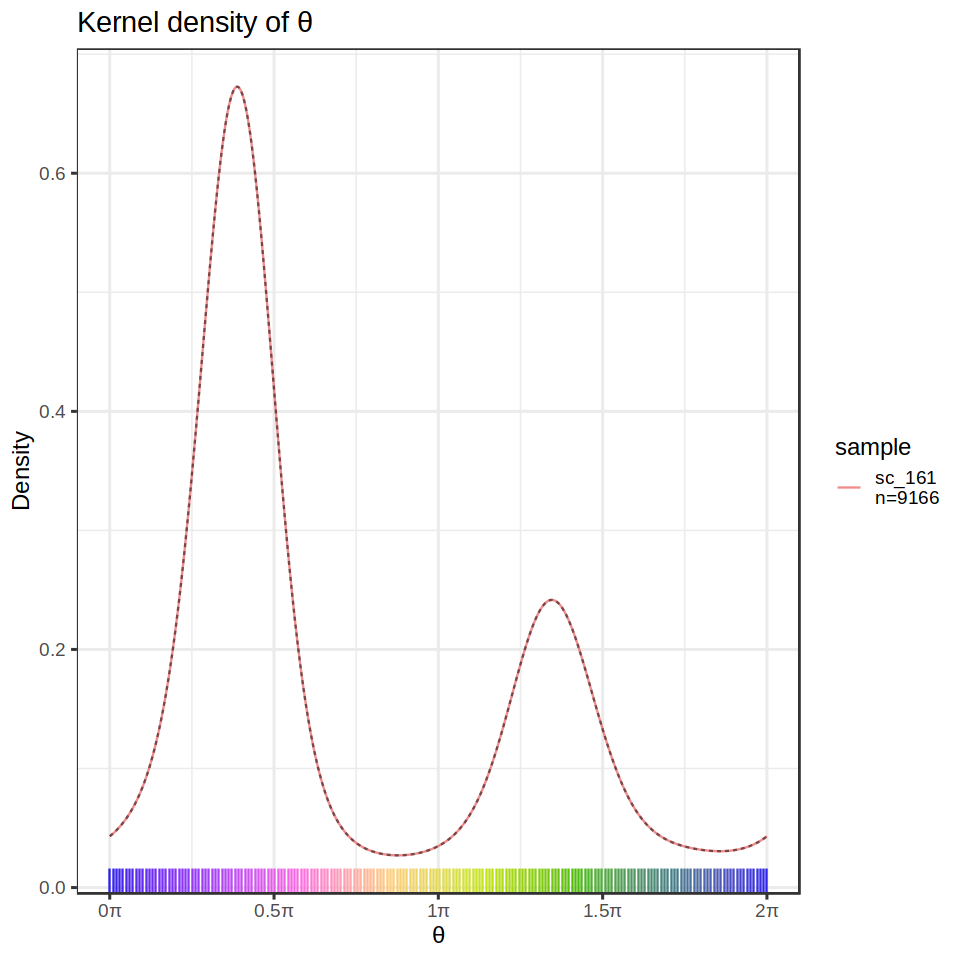

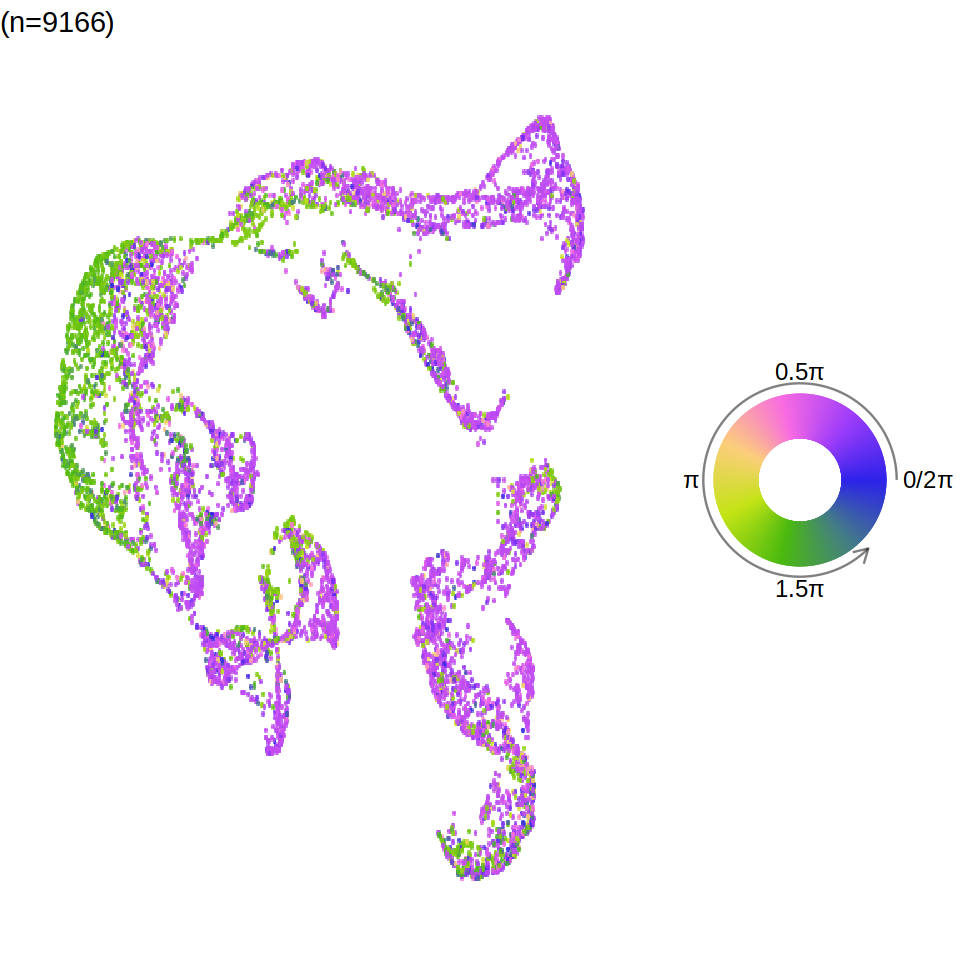

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


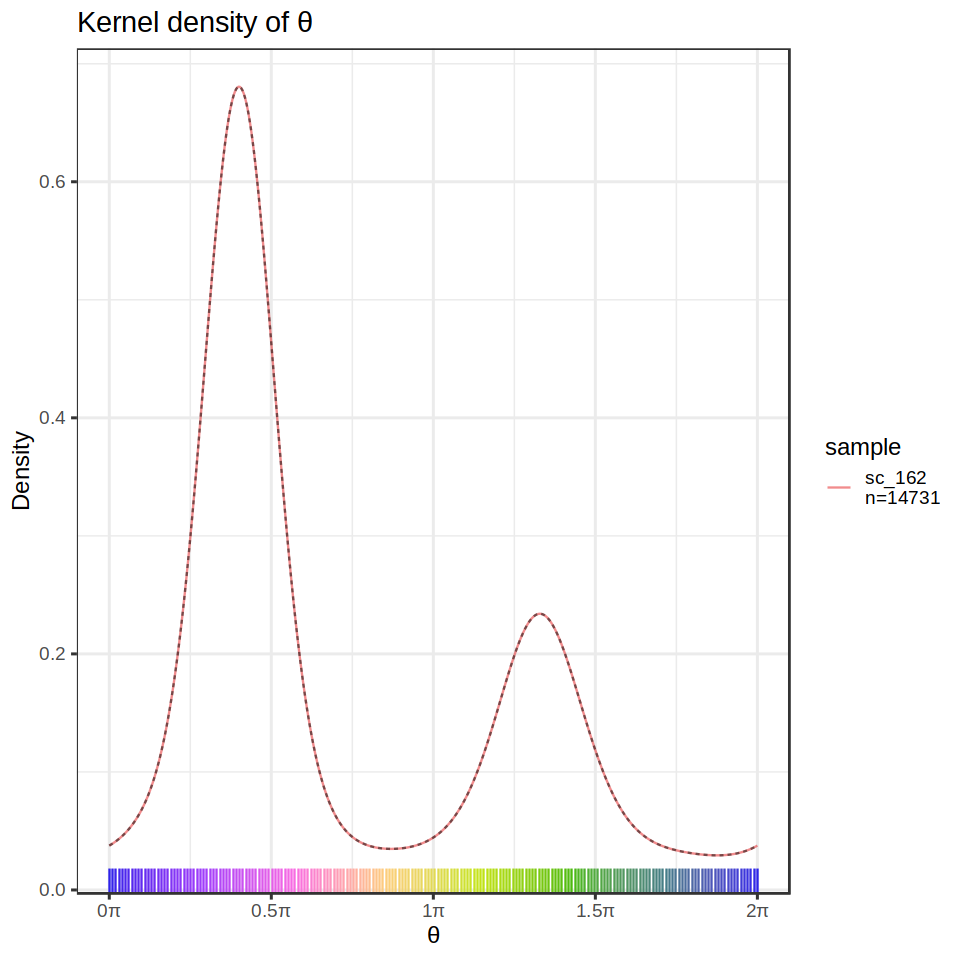

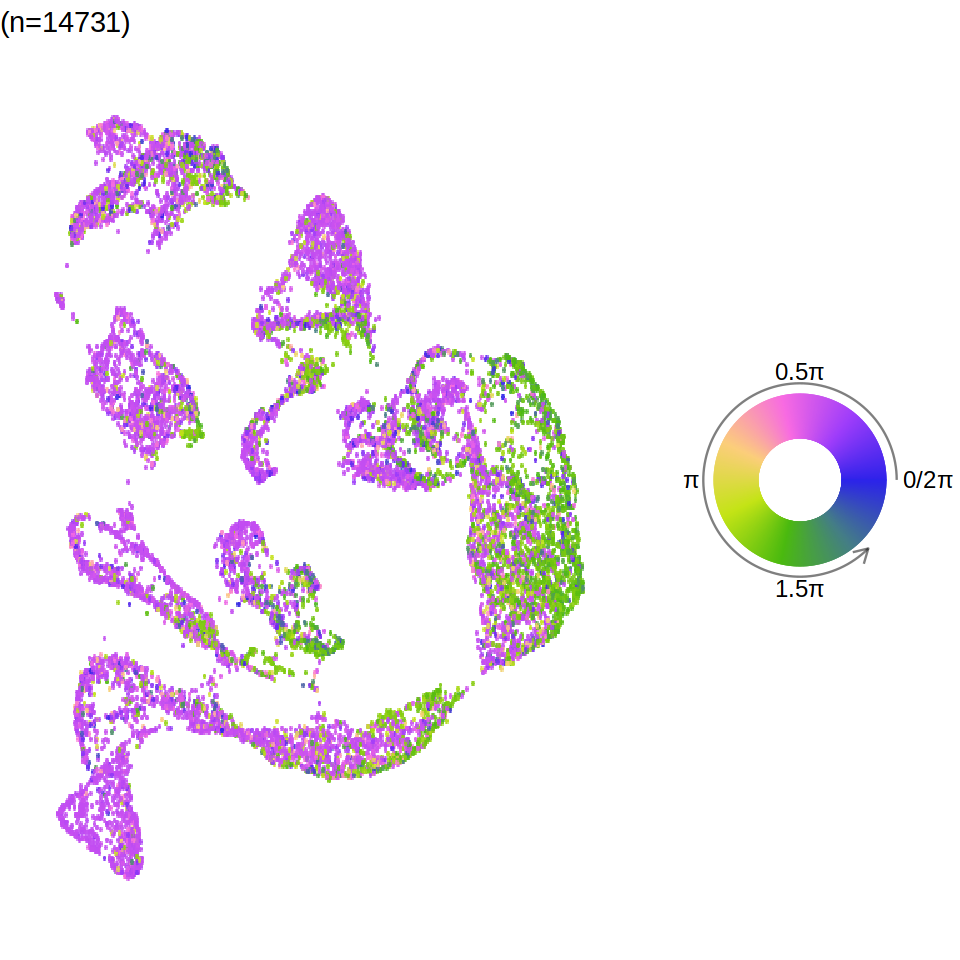

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


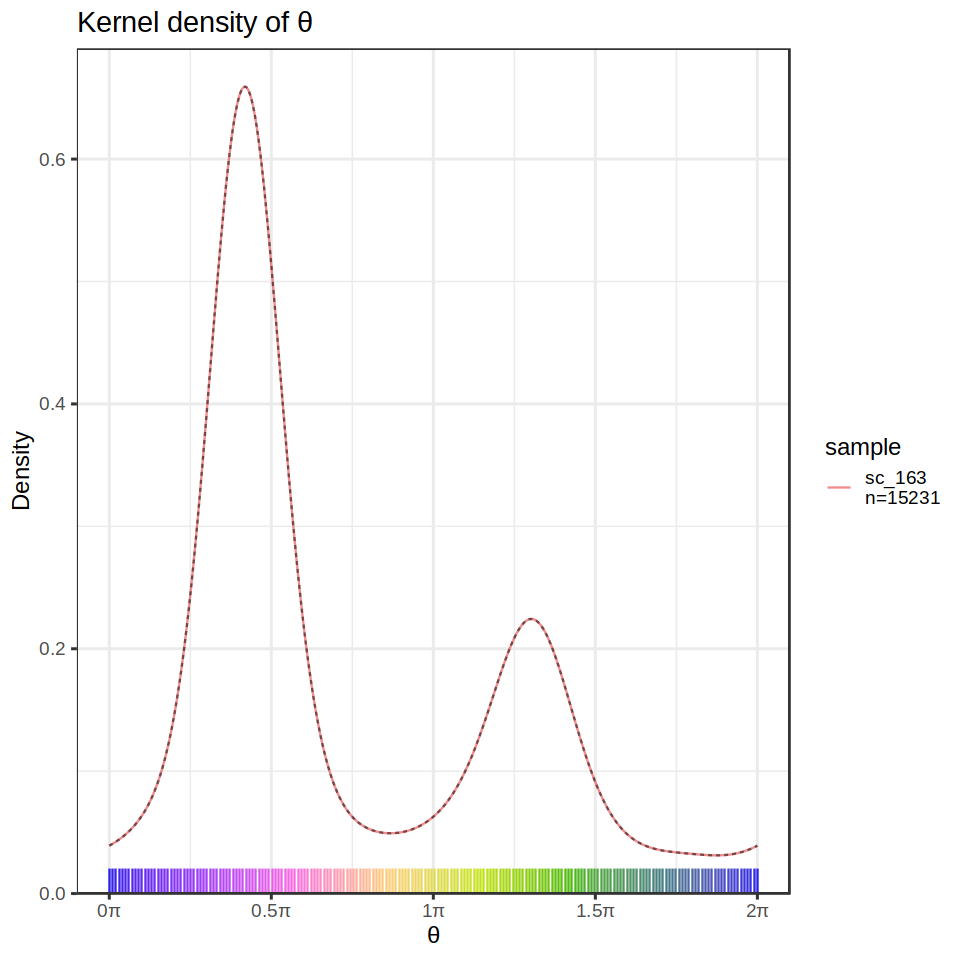

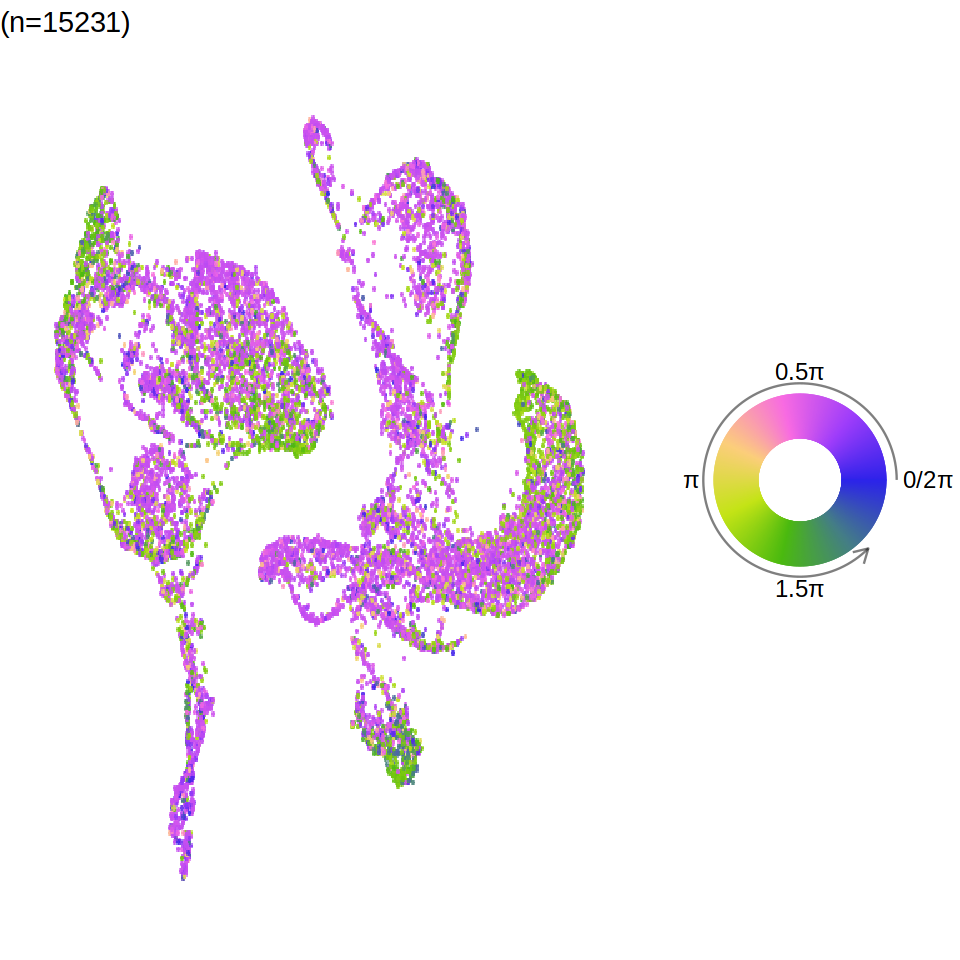

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


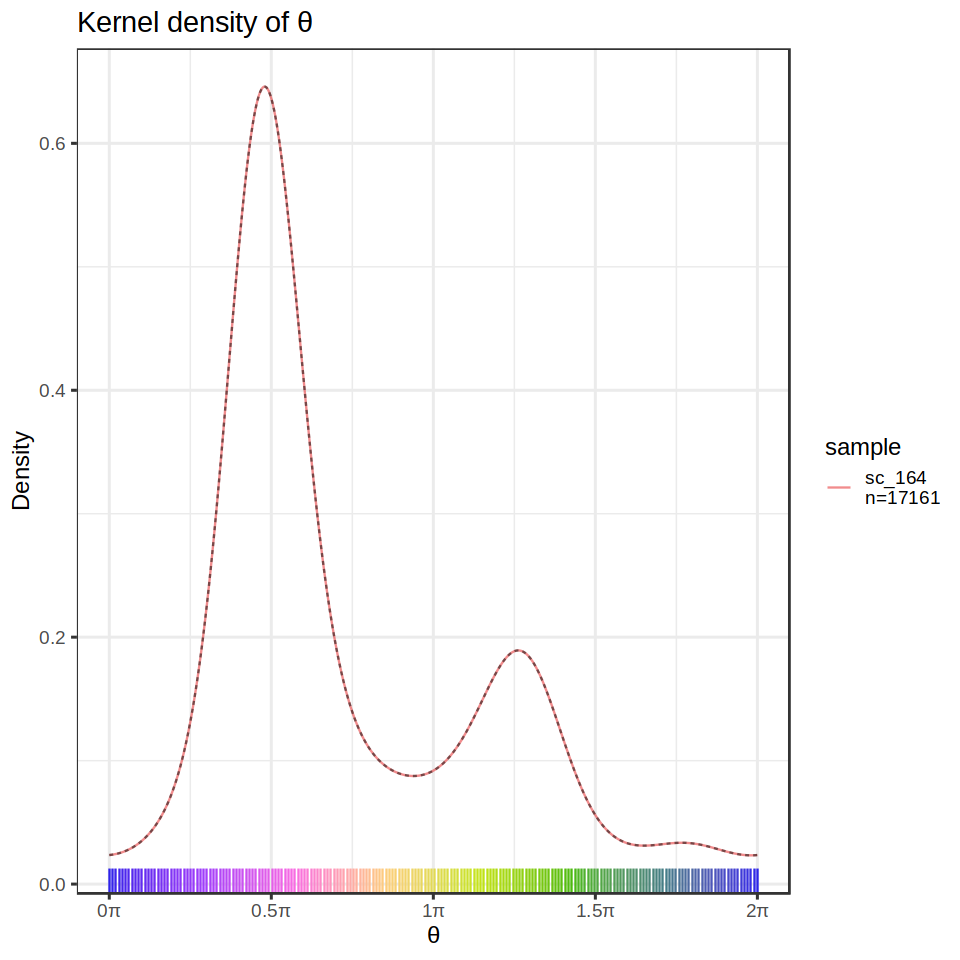

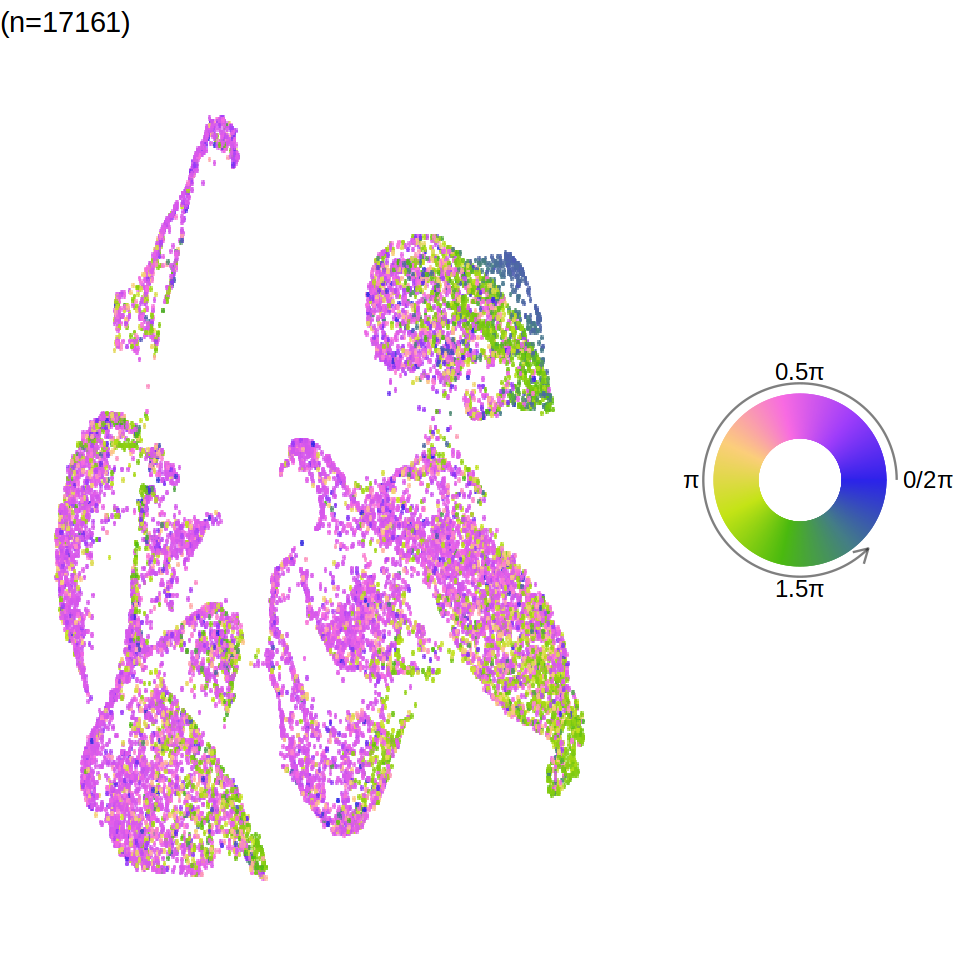

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


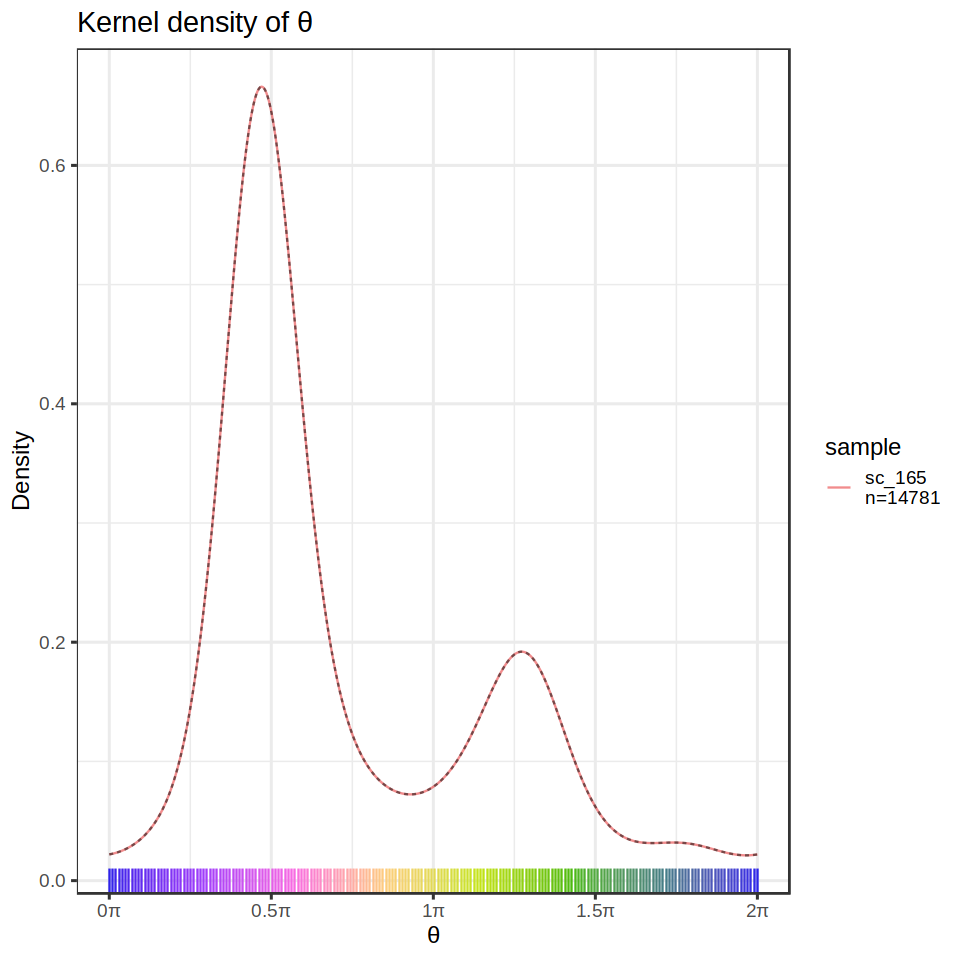

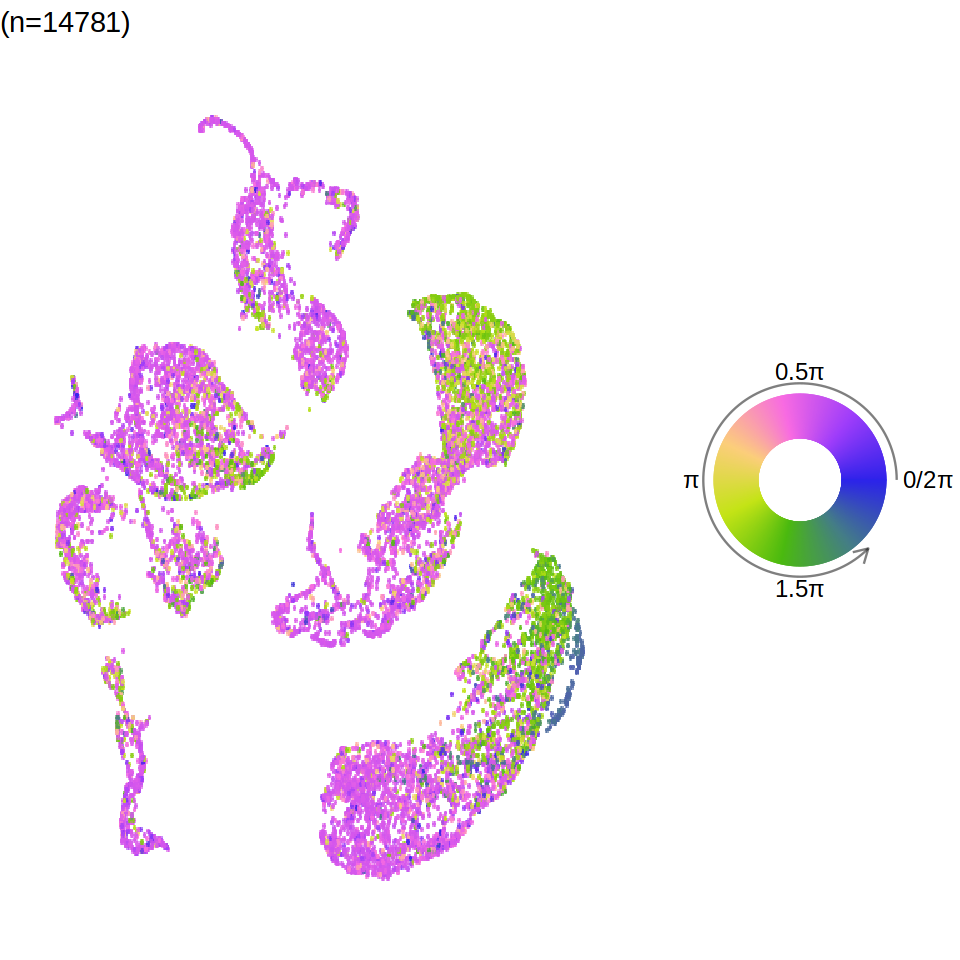

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


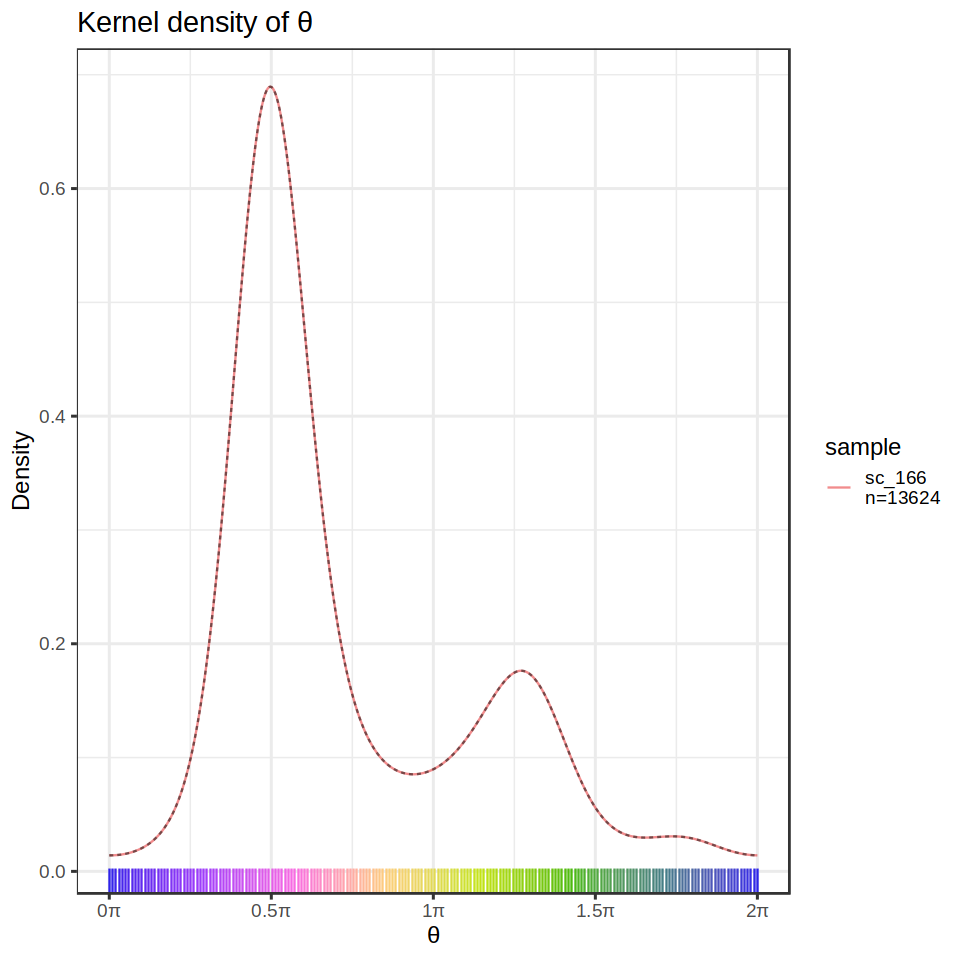

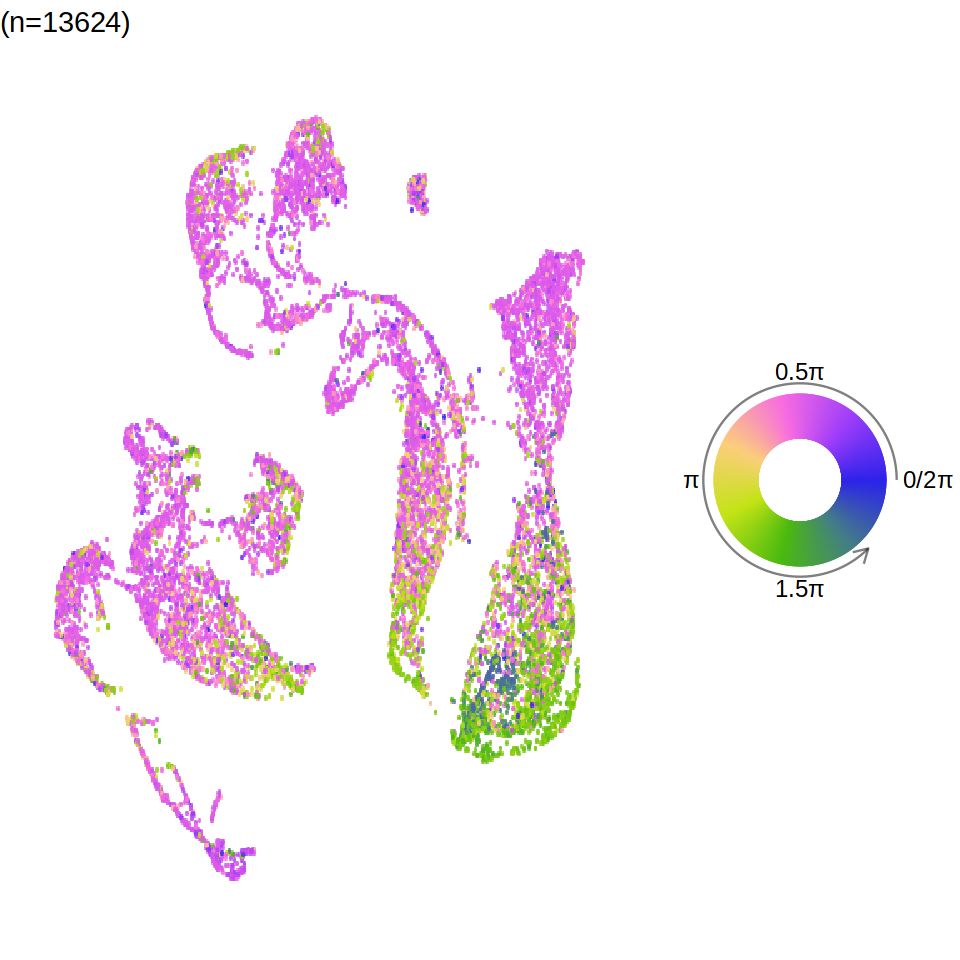

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


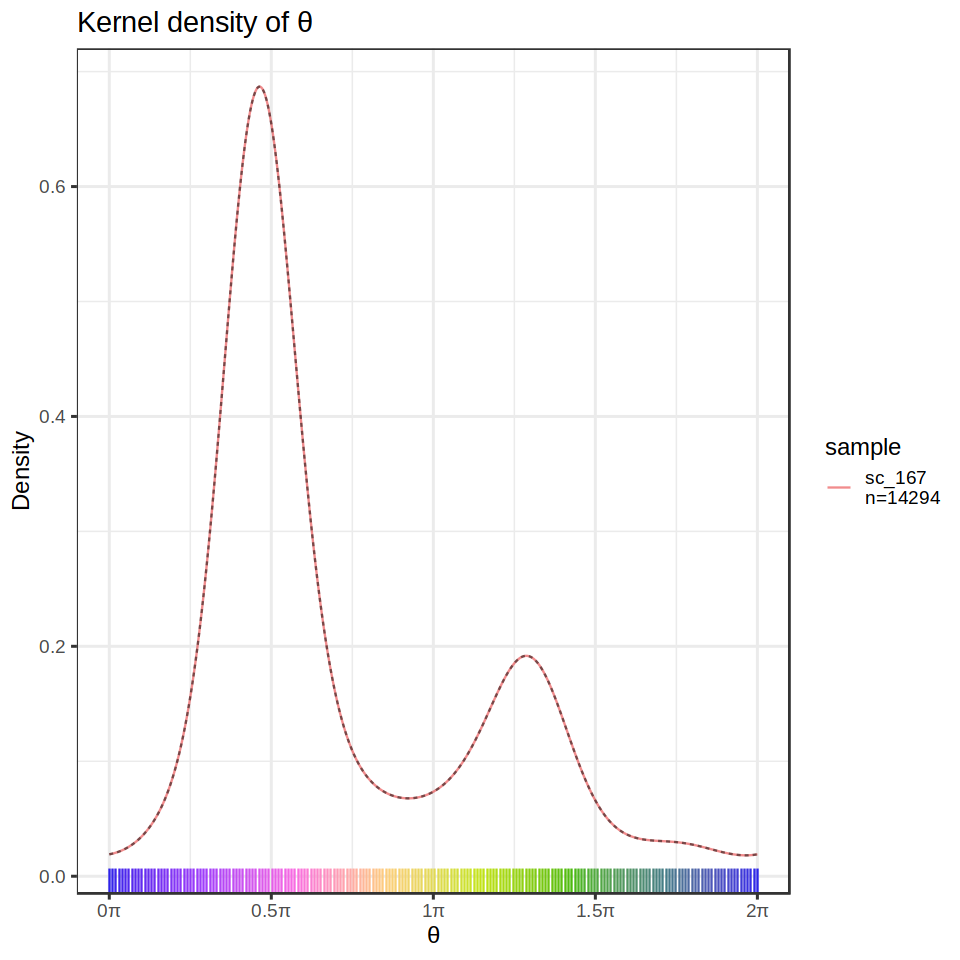

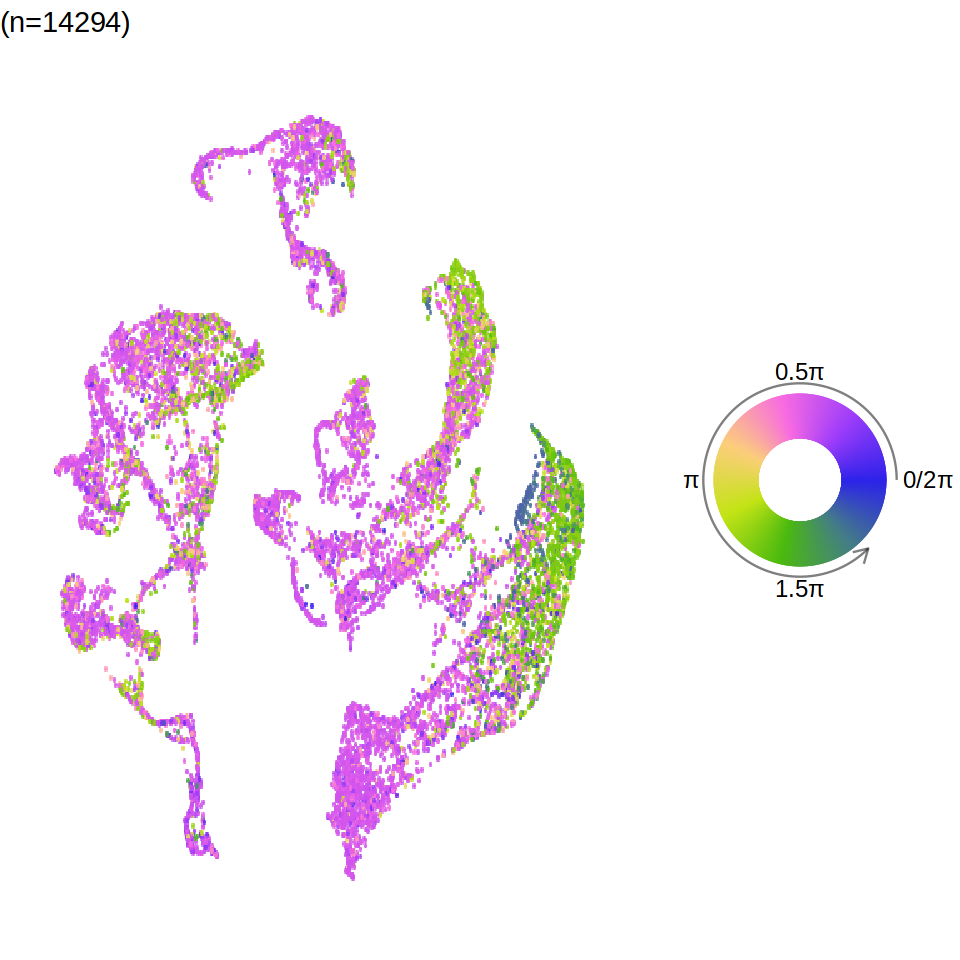

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


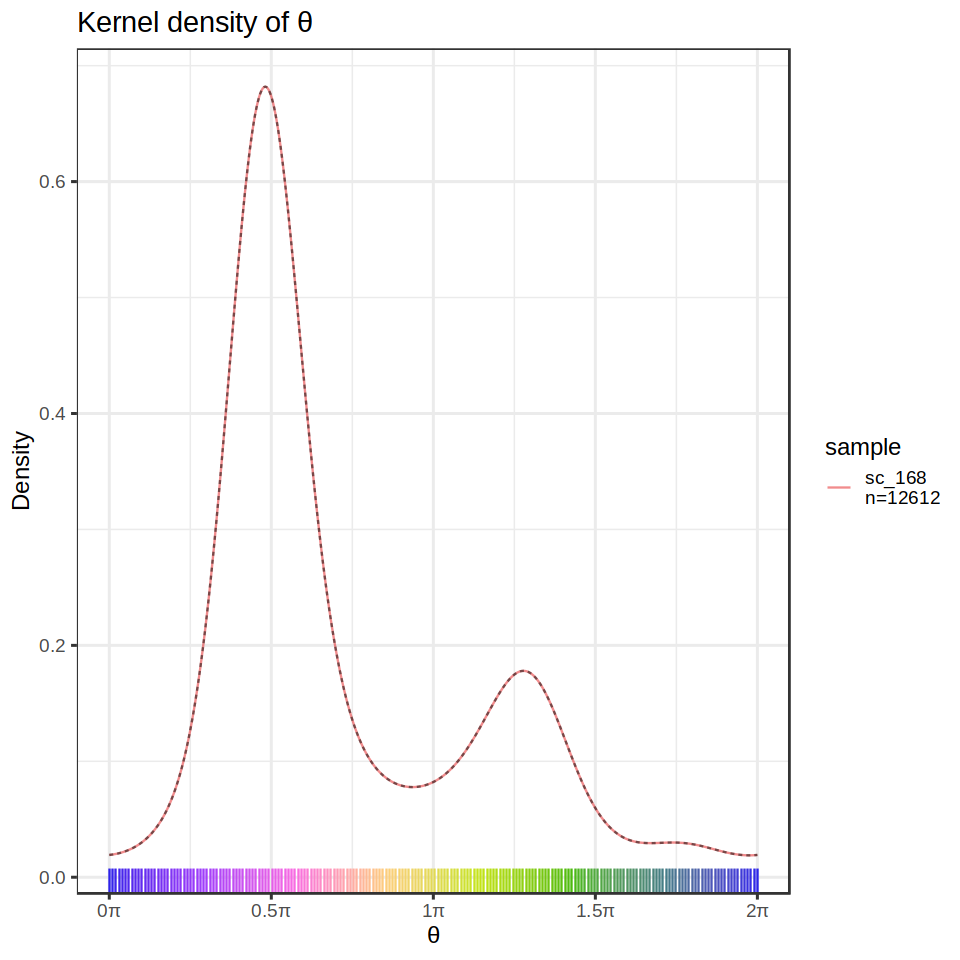

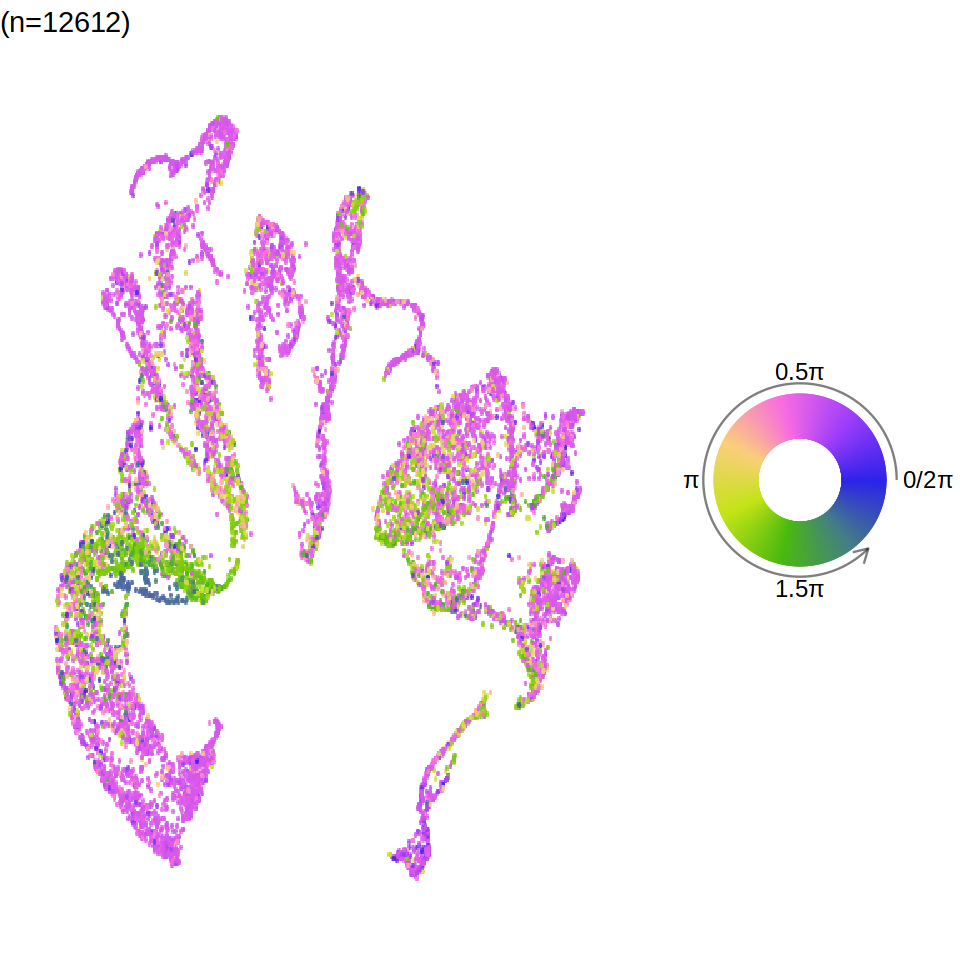

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


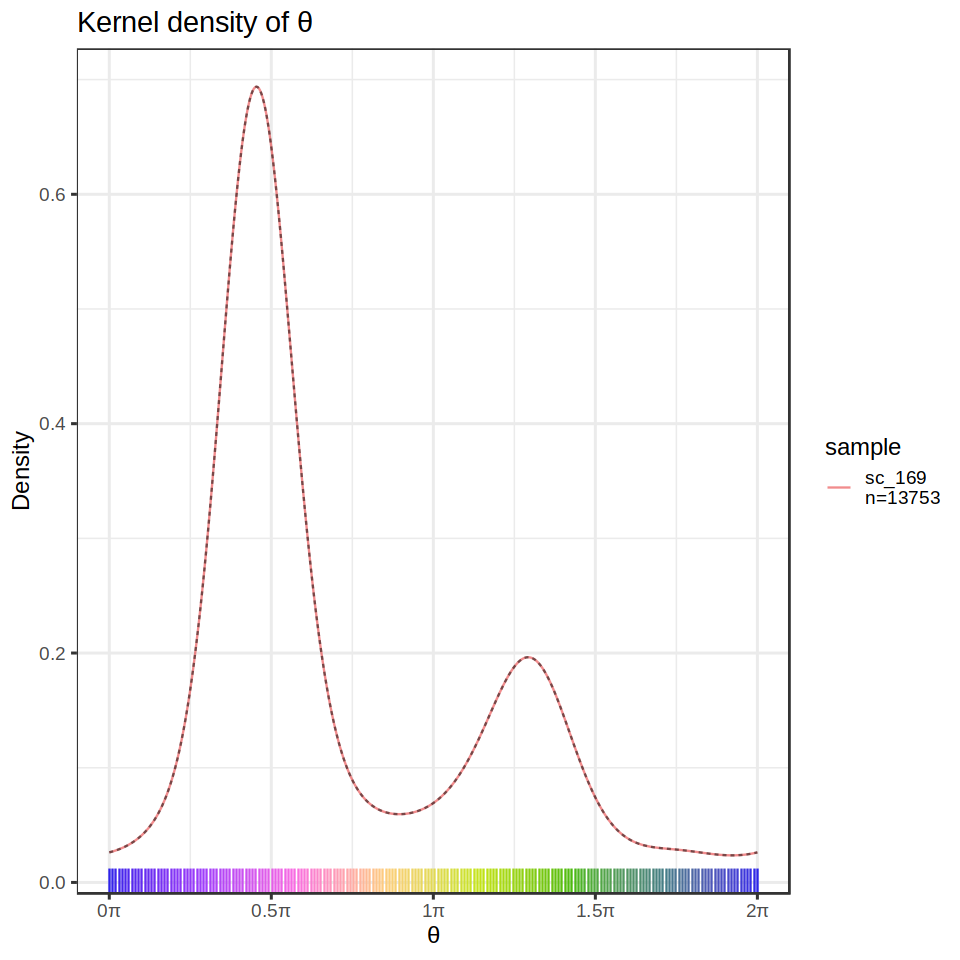

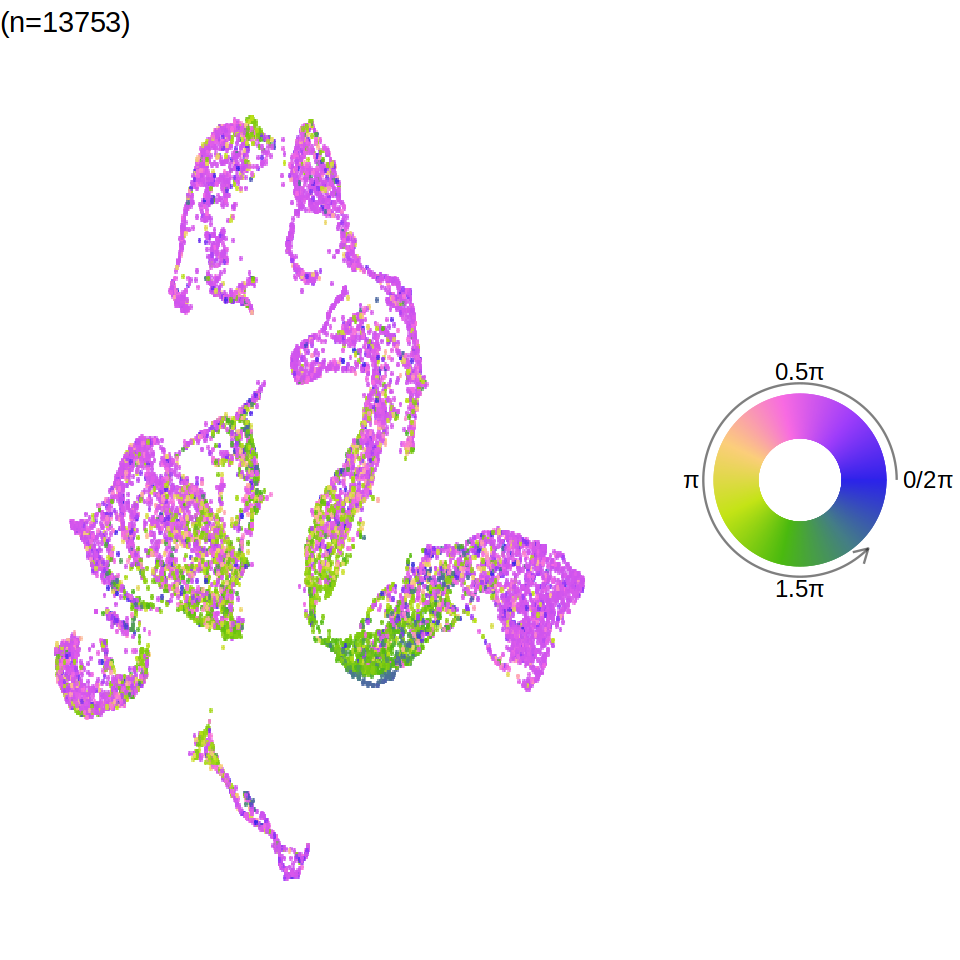

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


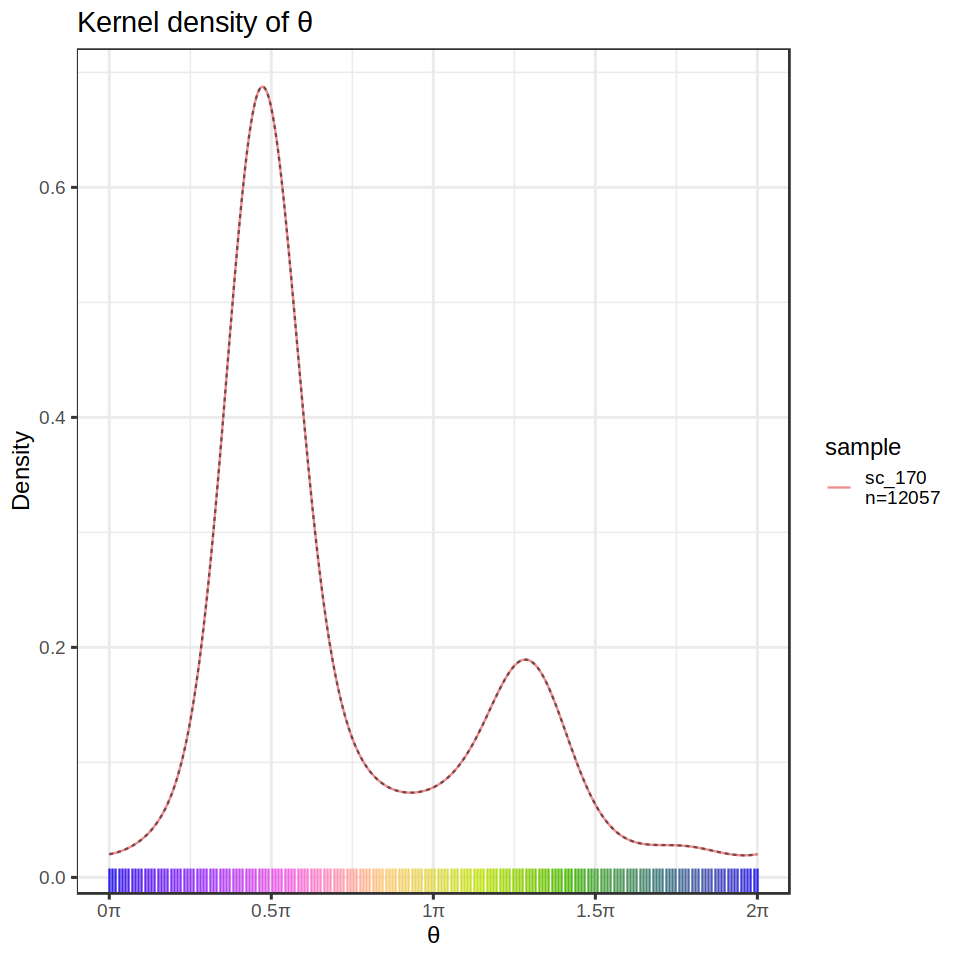

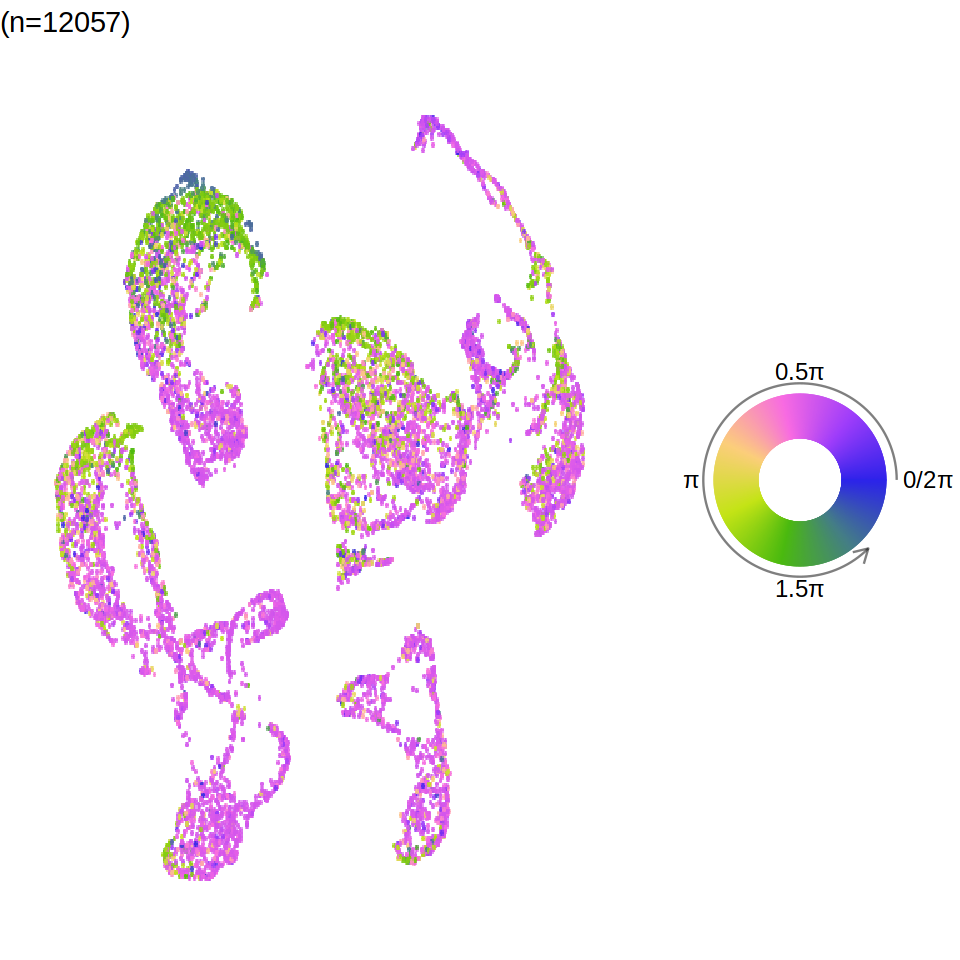

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


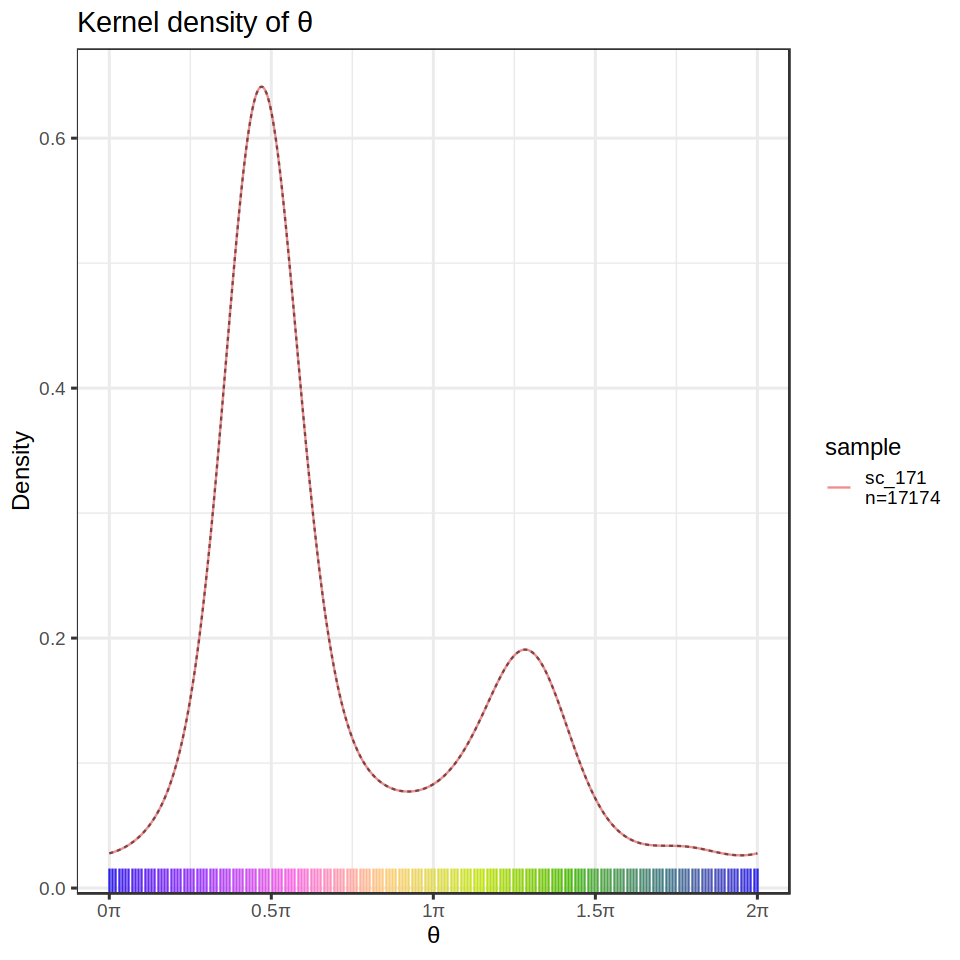

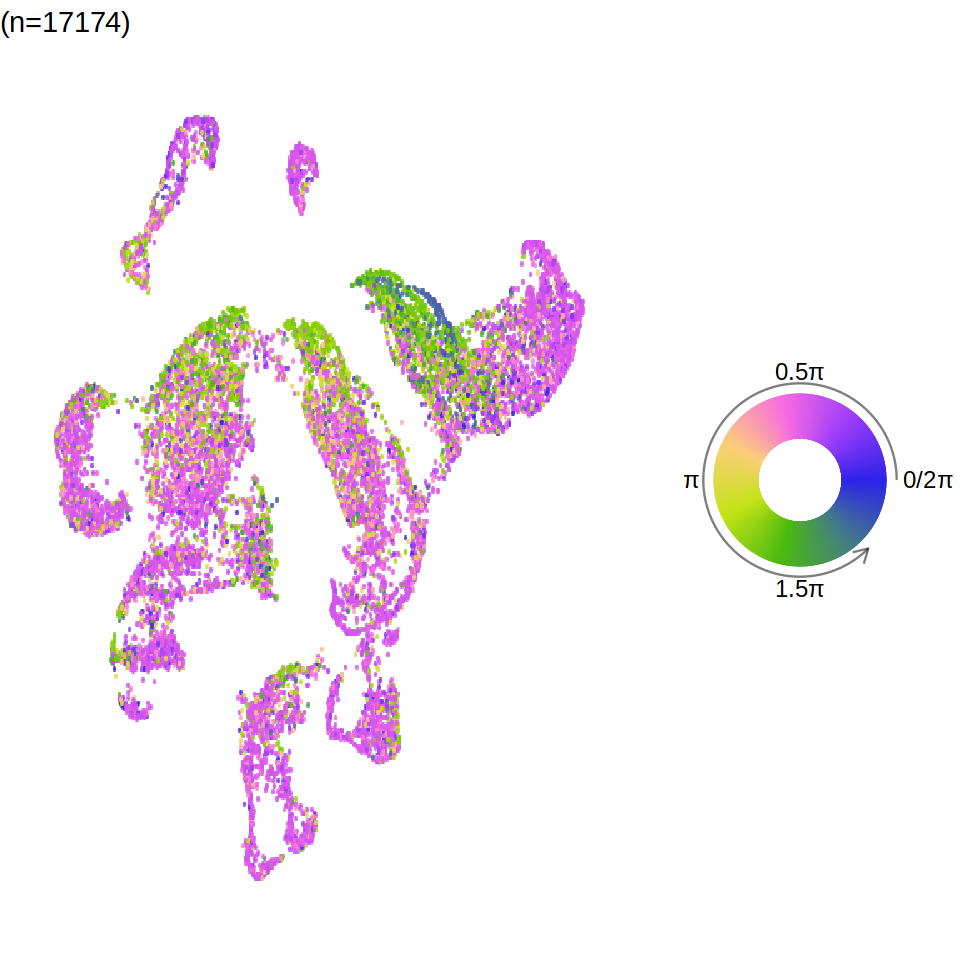

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


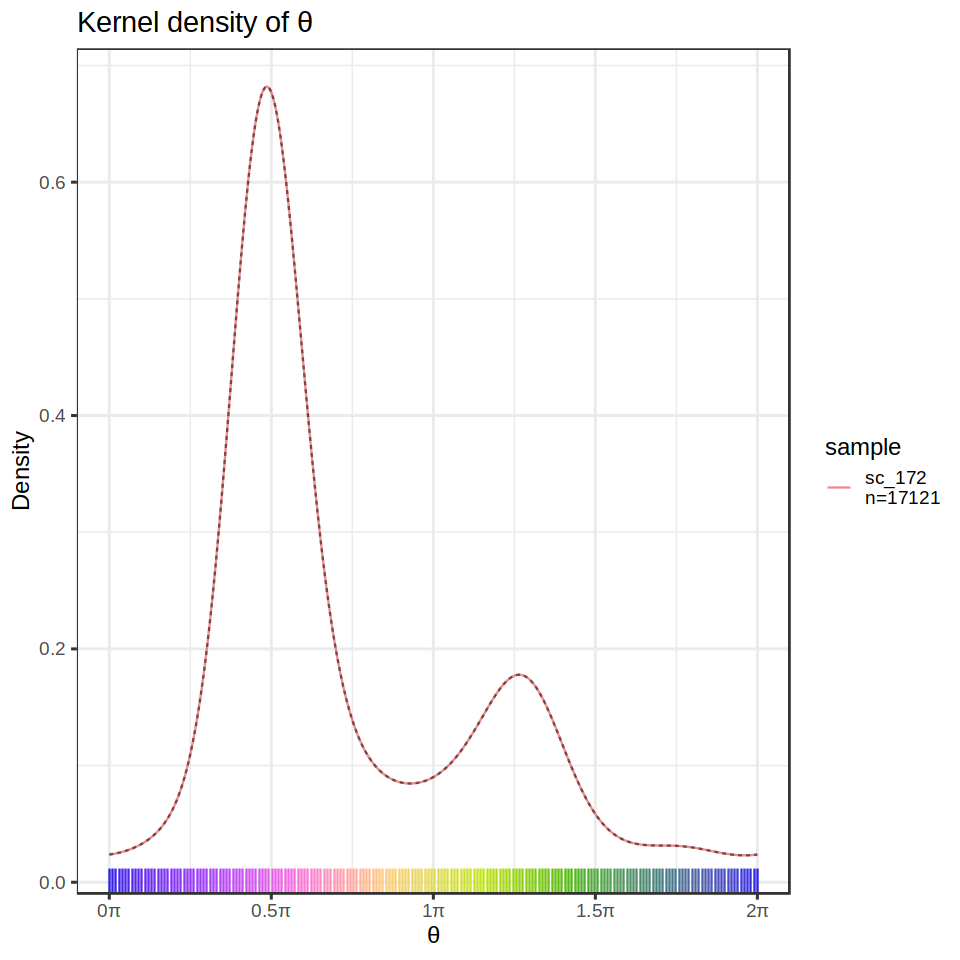

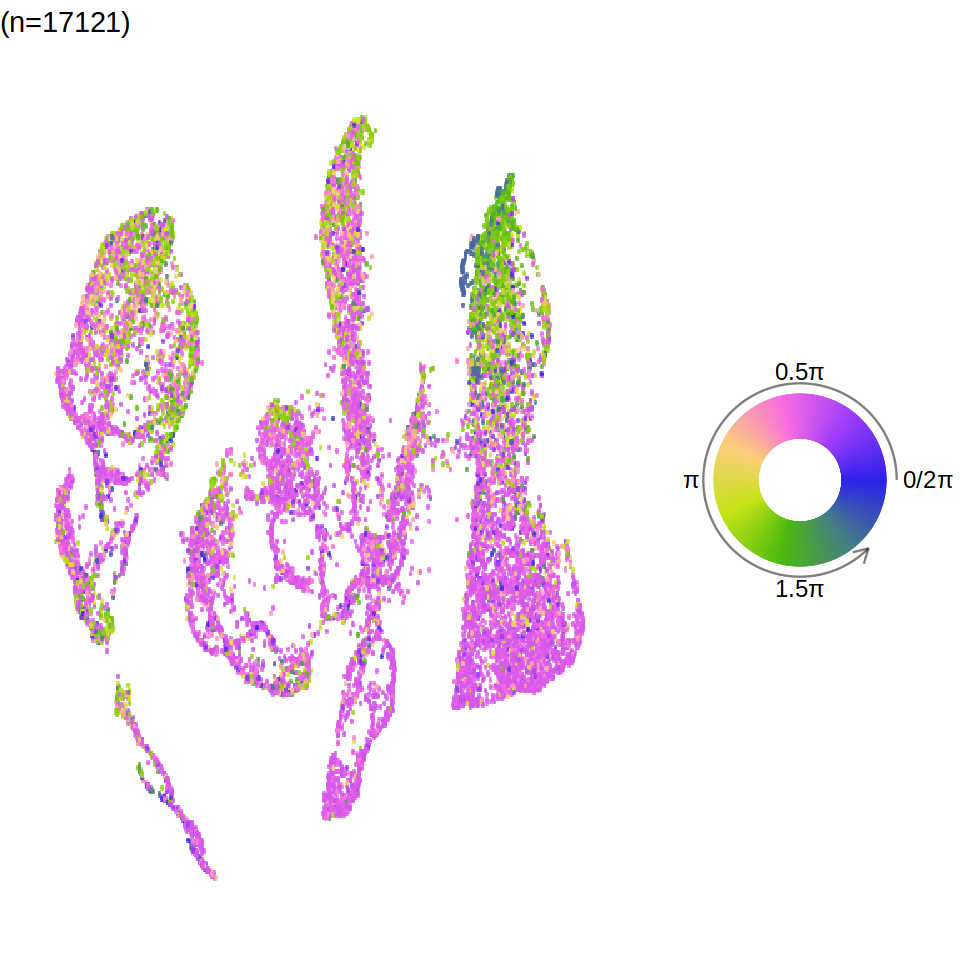

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


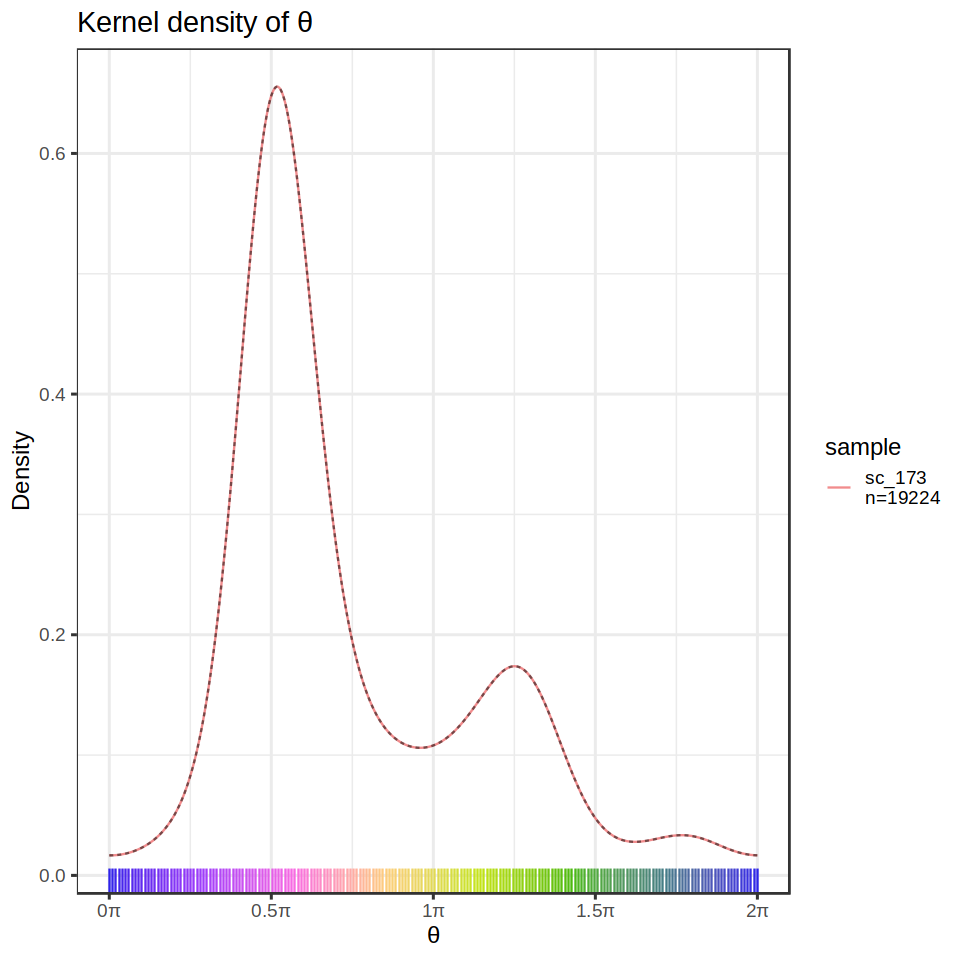

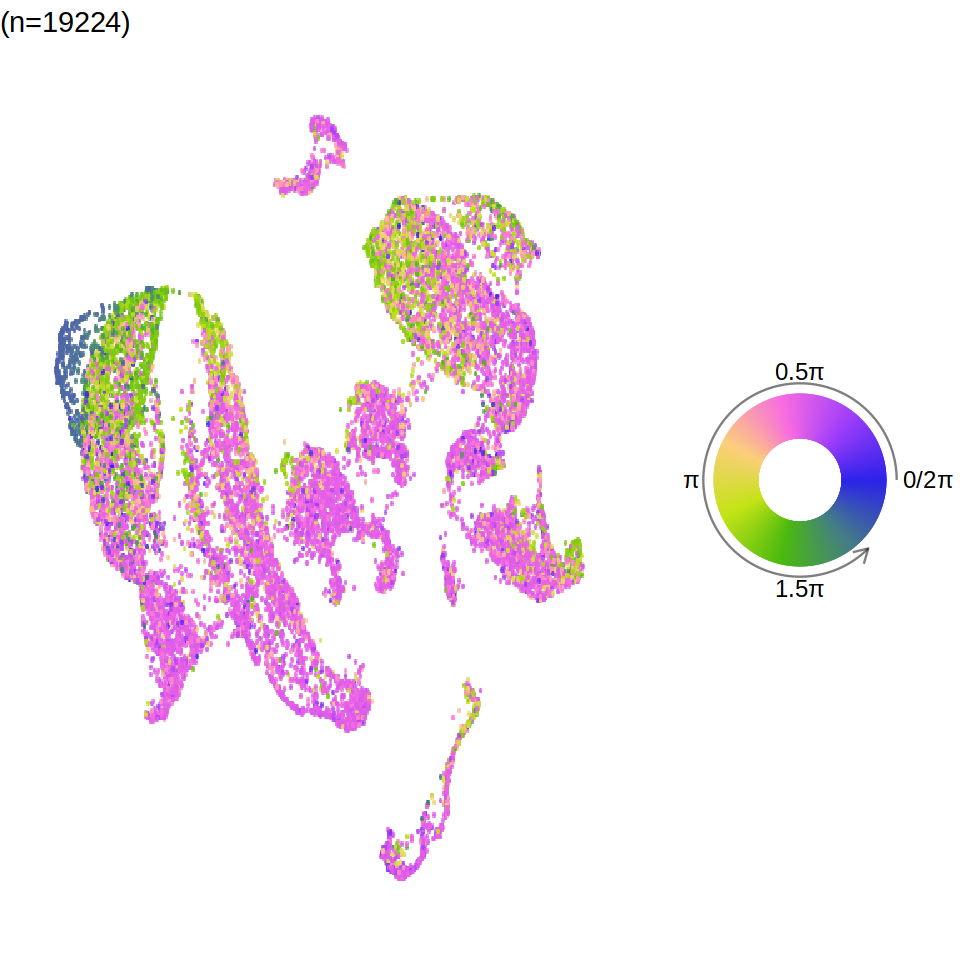

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


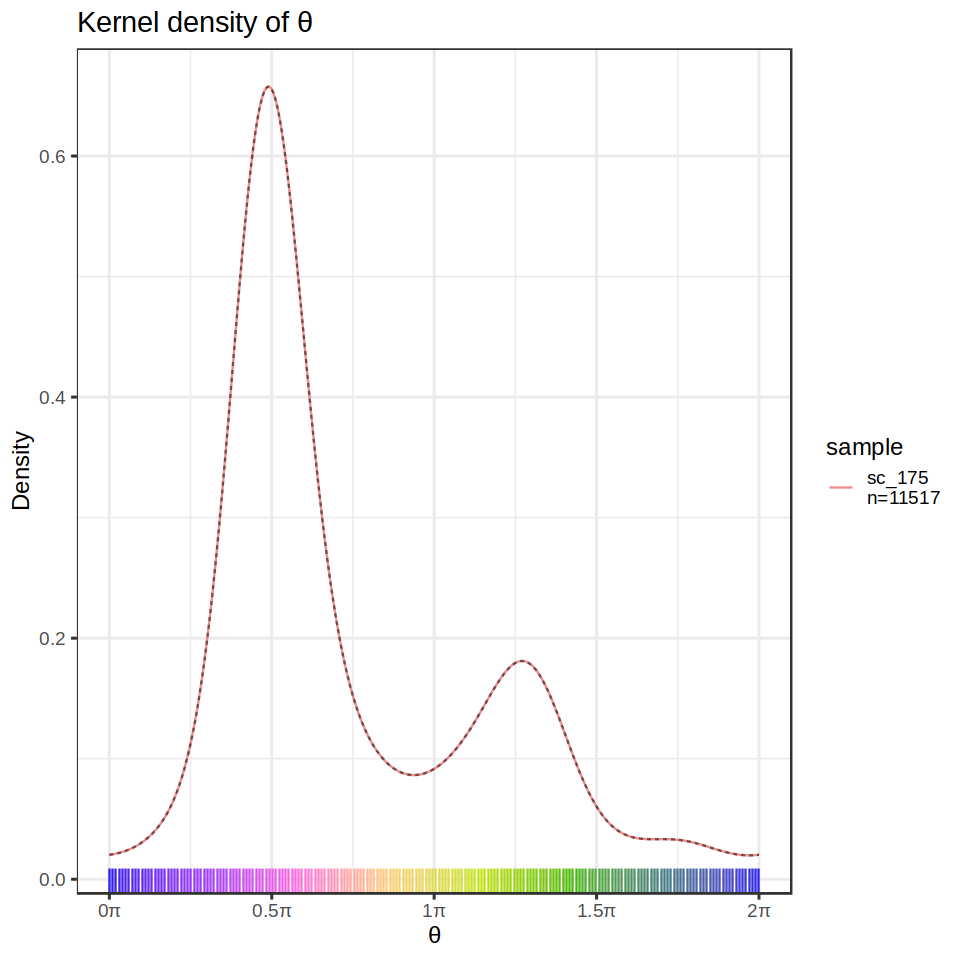

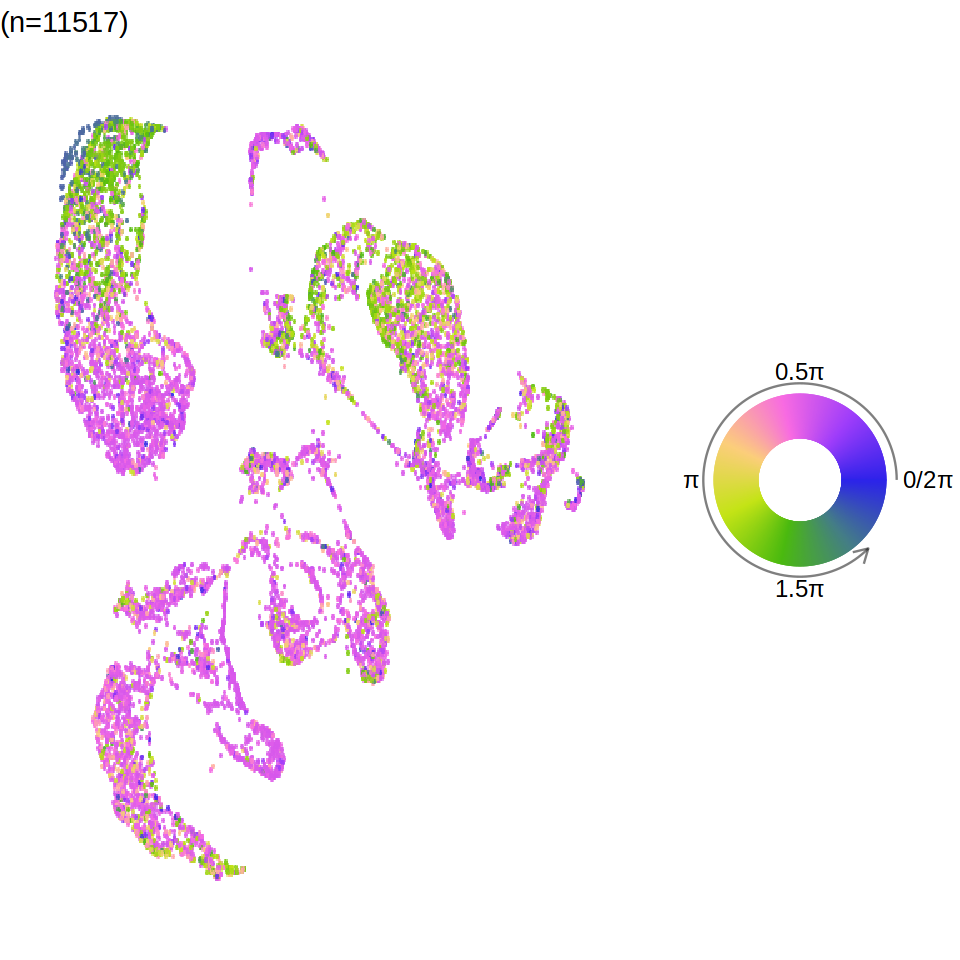

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


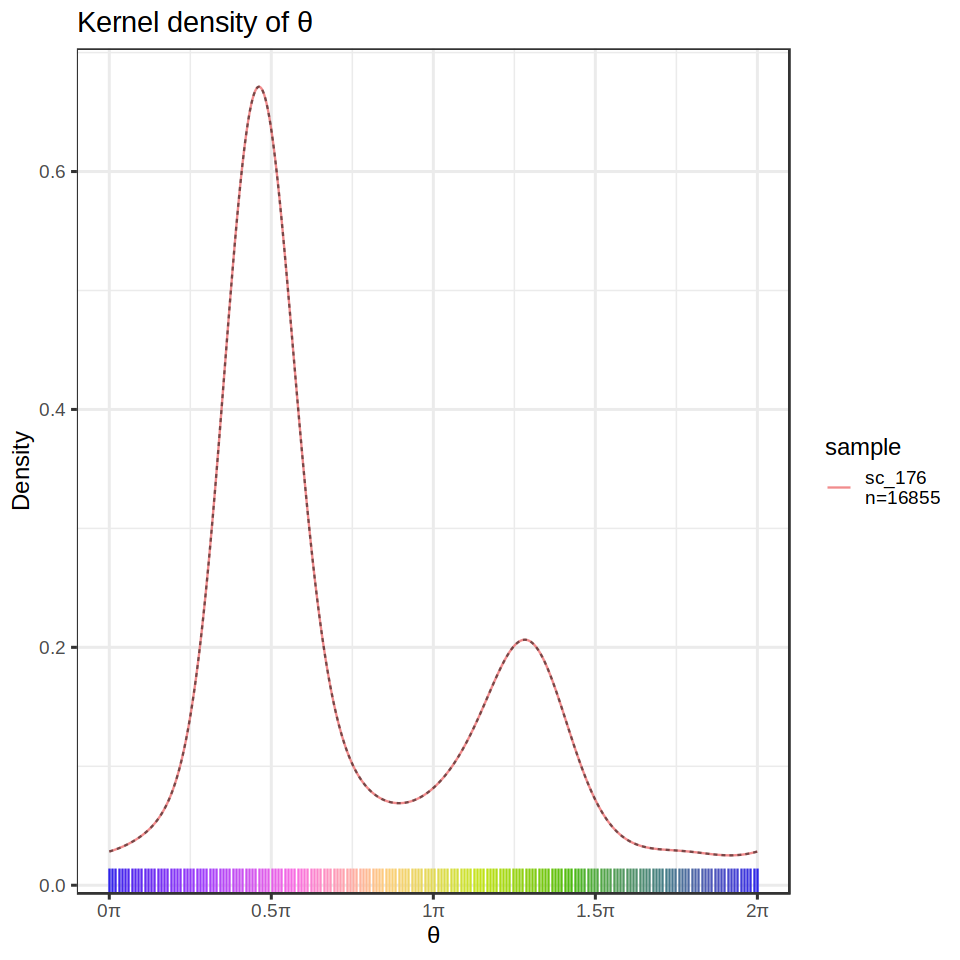

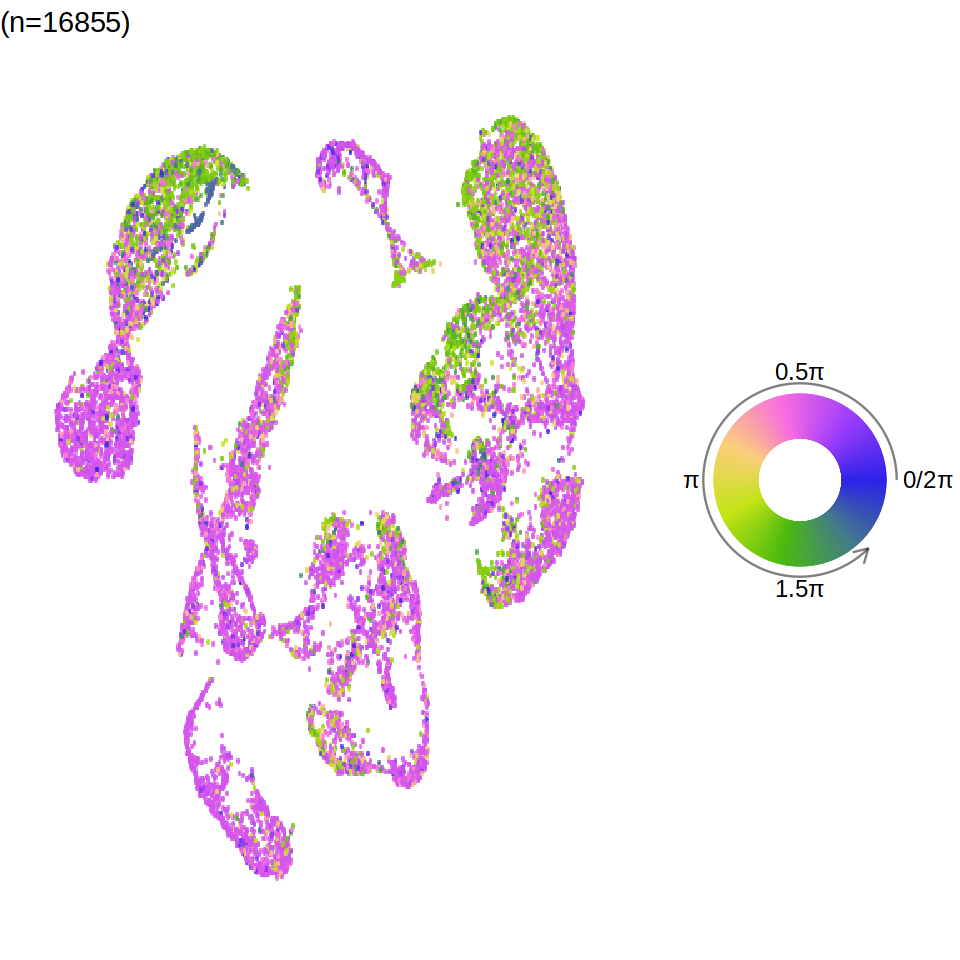

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


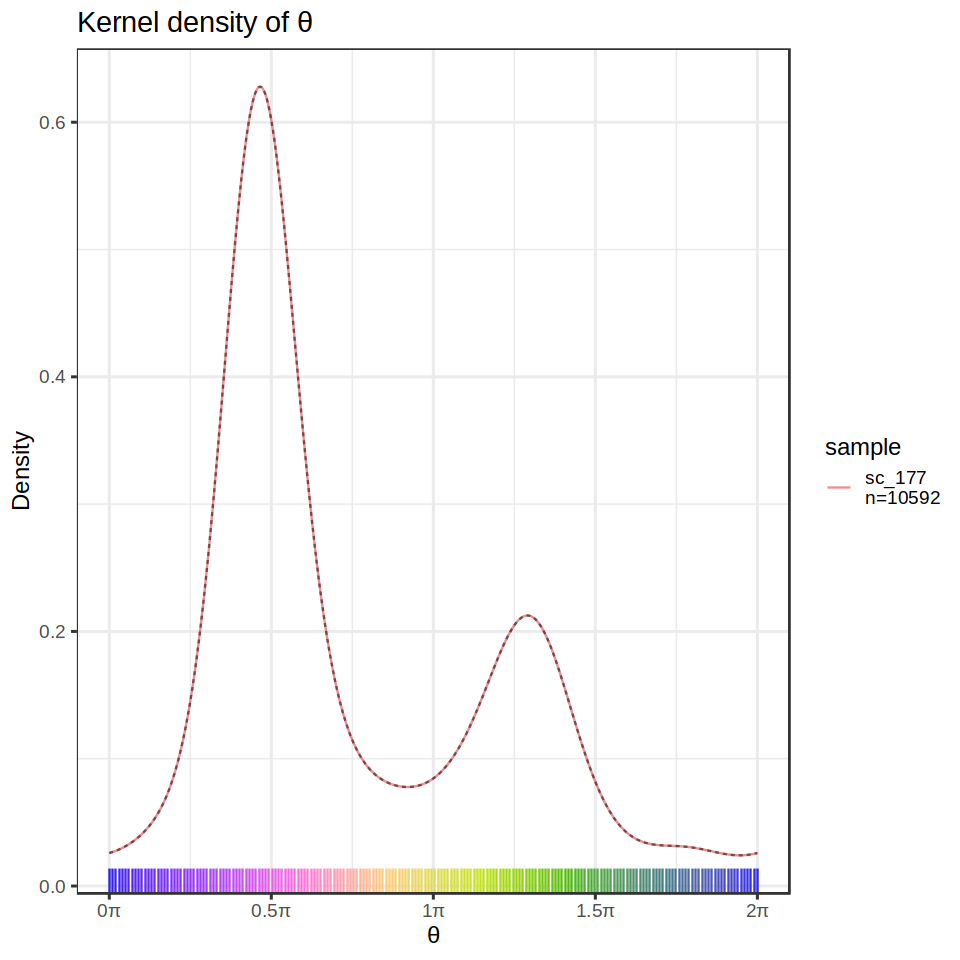

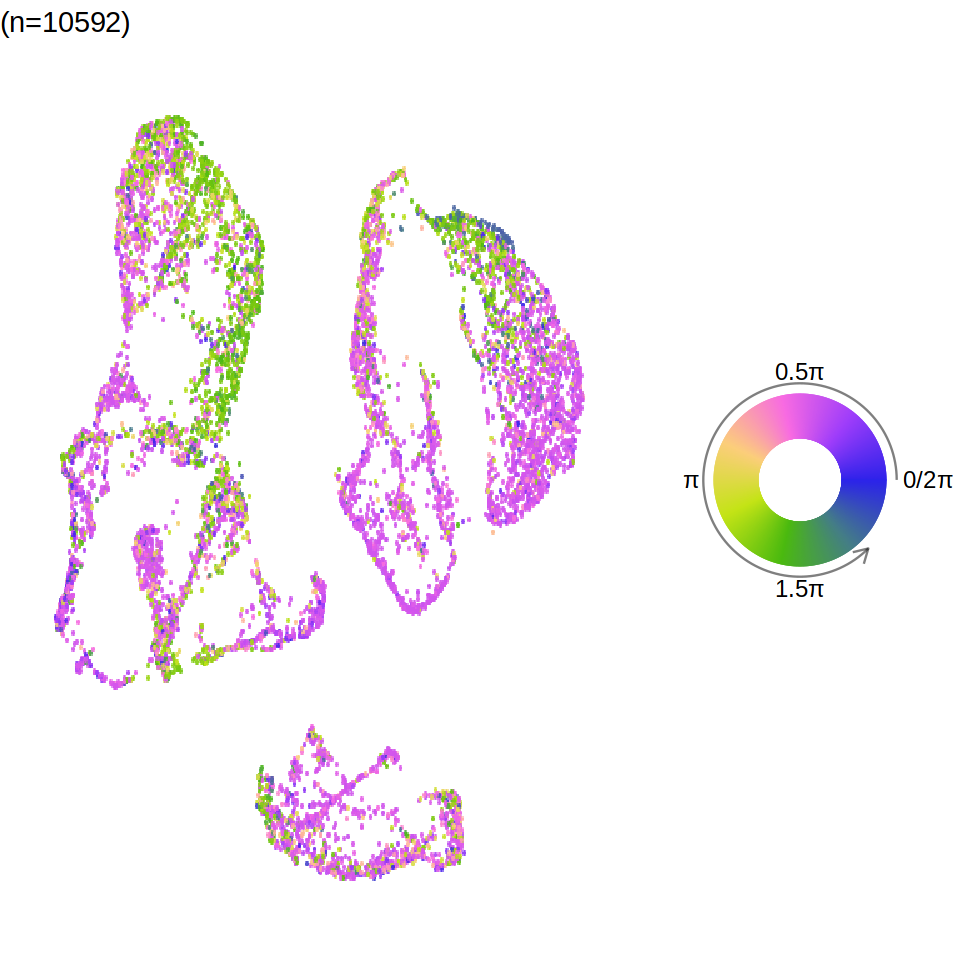

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


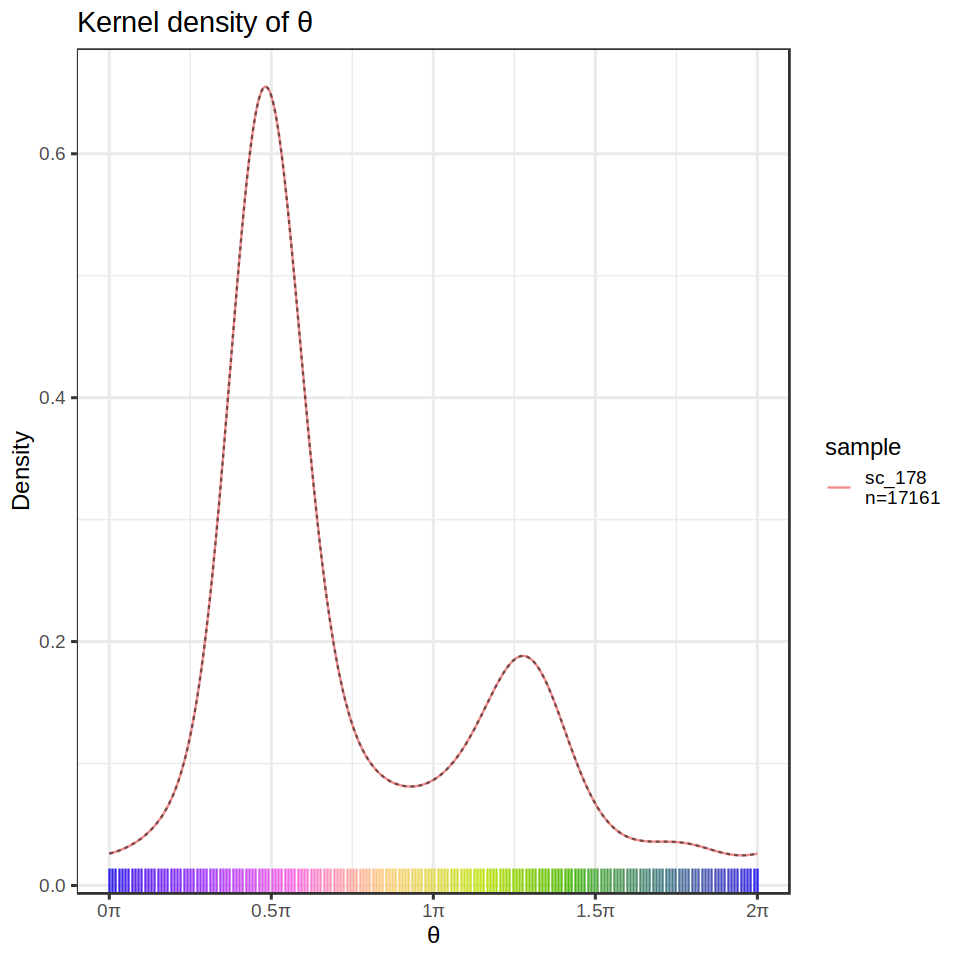

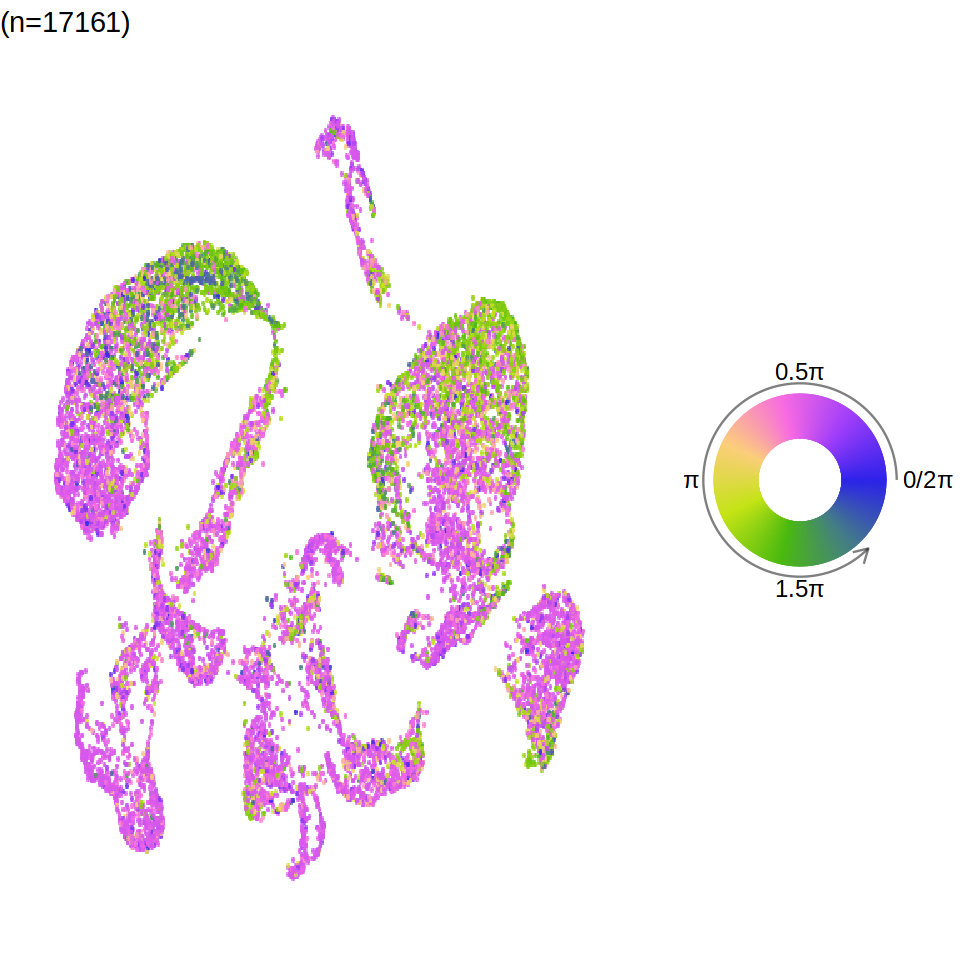

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


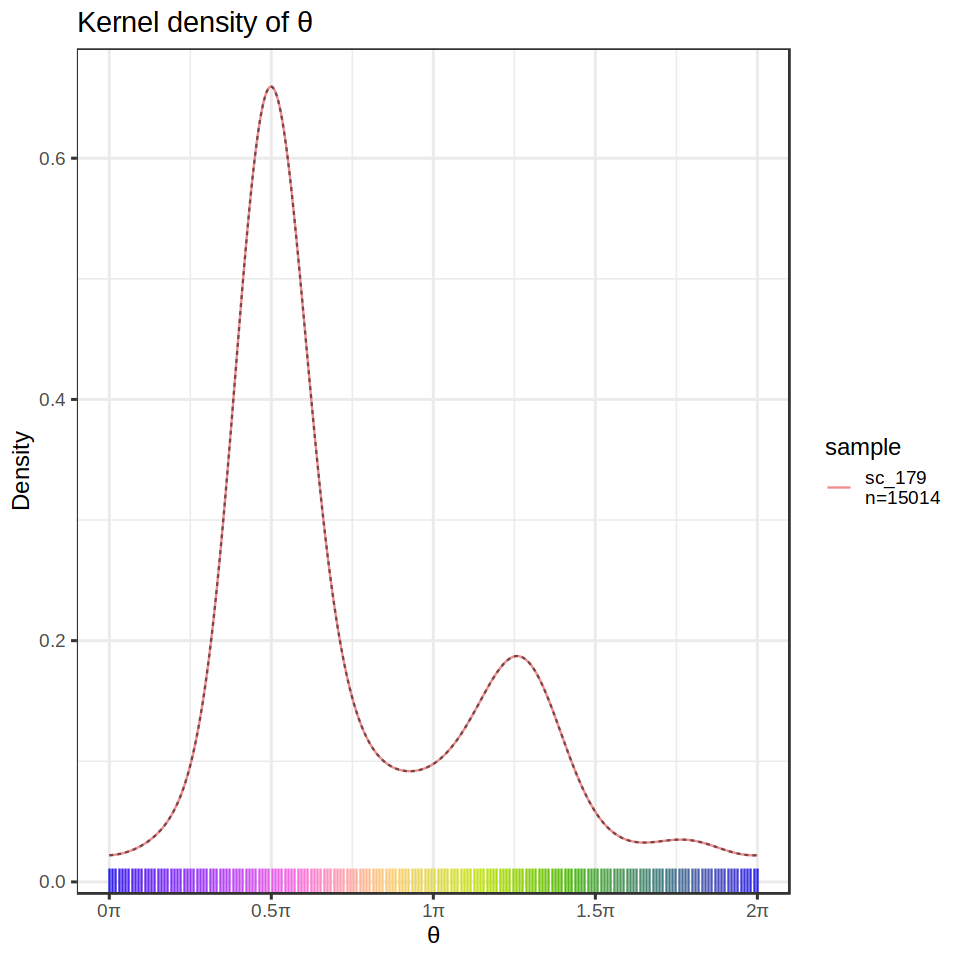

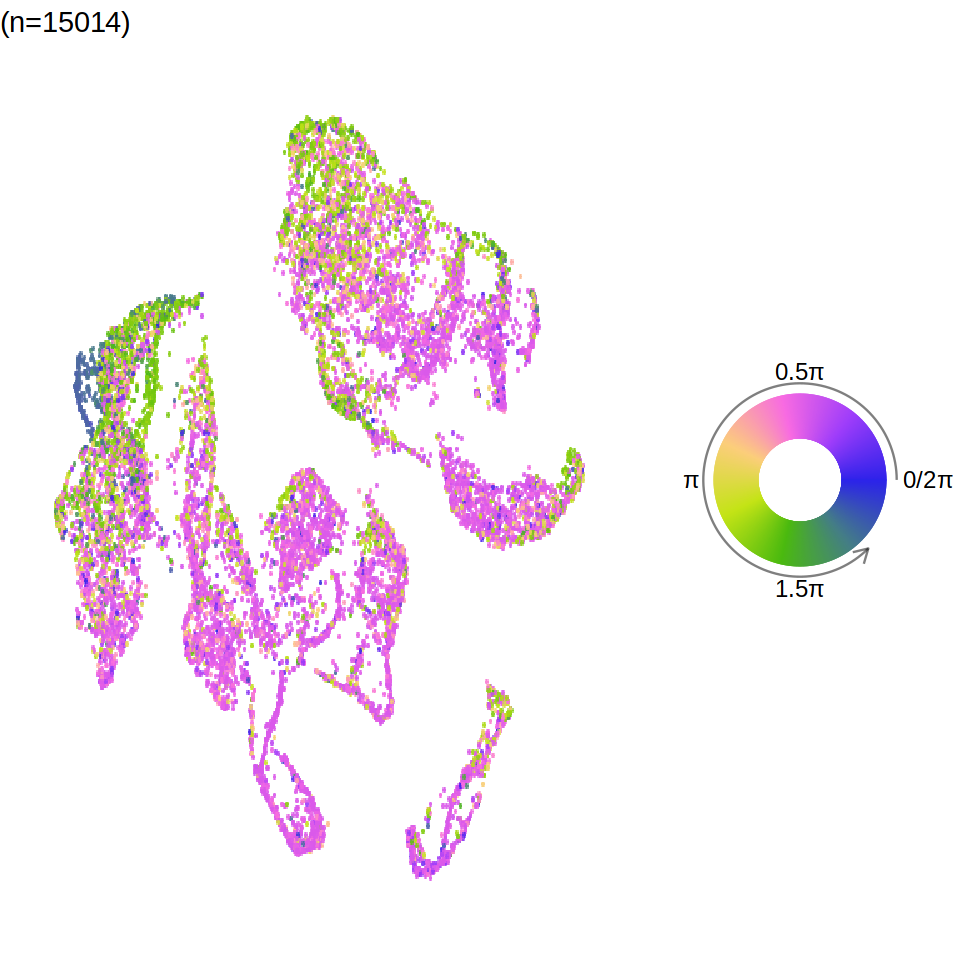

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


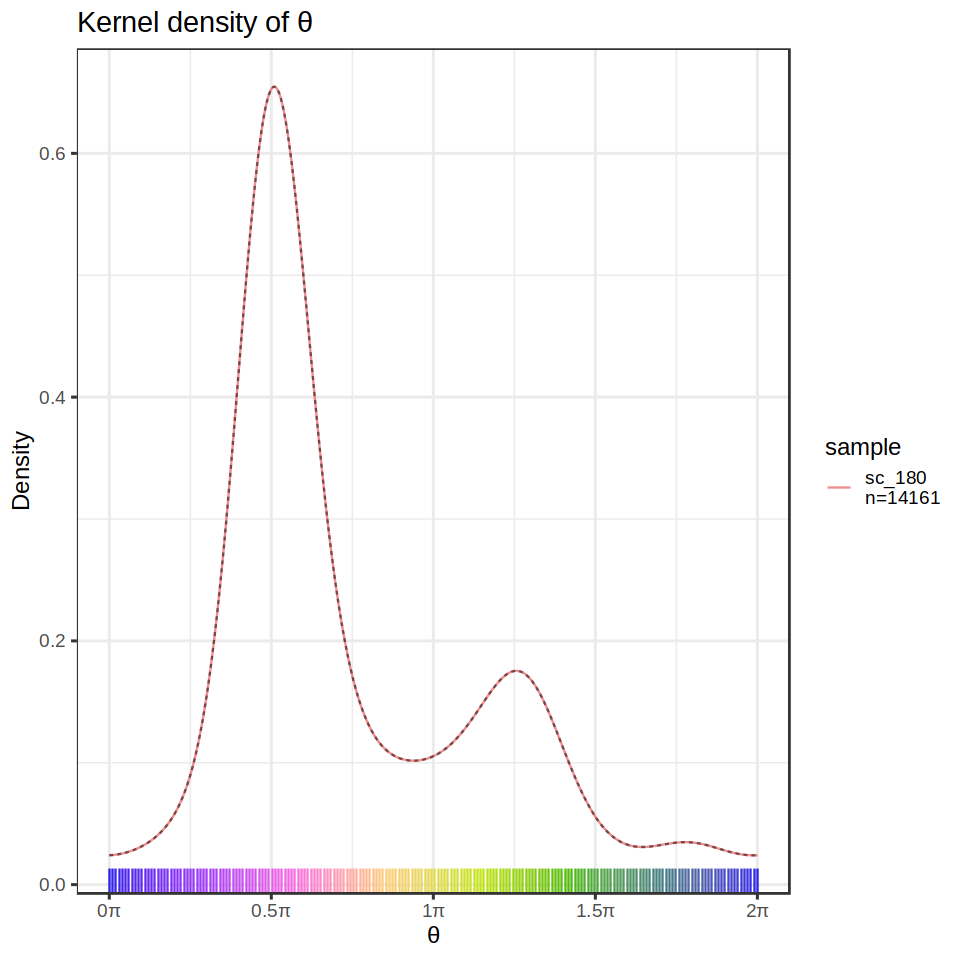

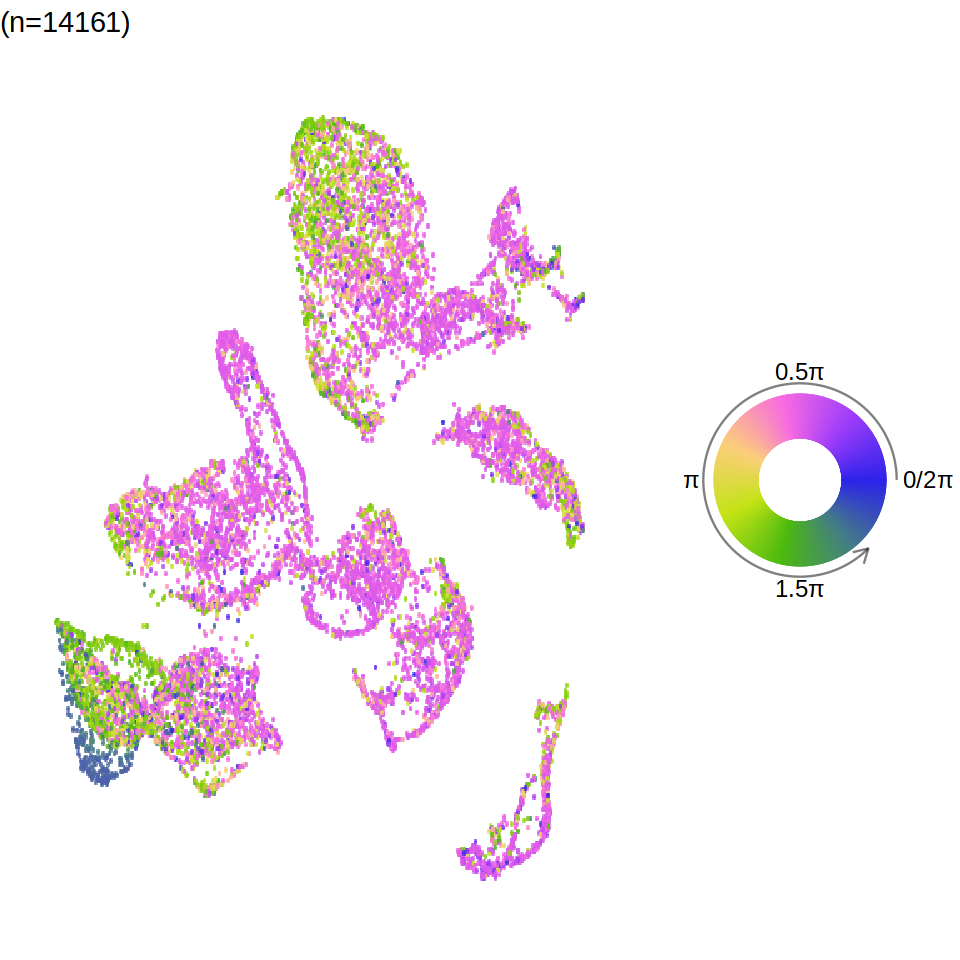

The number of projection genes found in the new data is 228.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


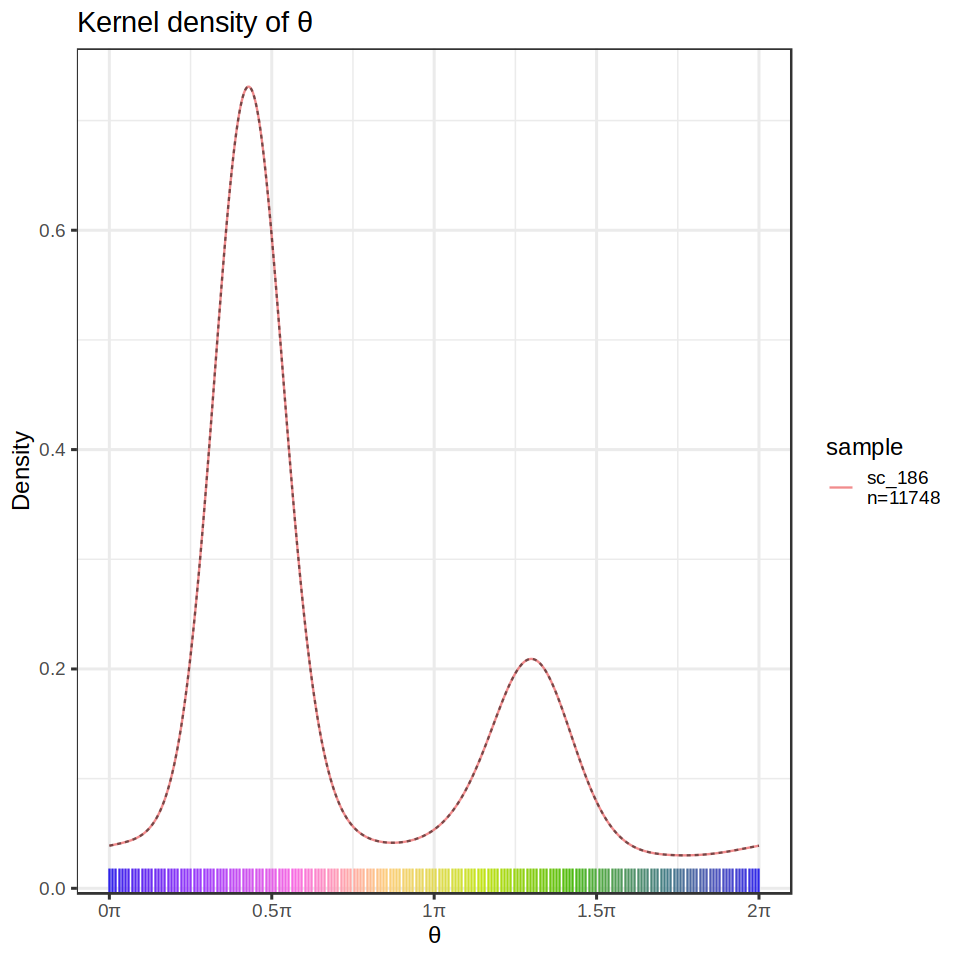

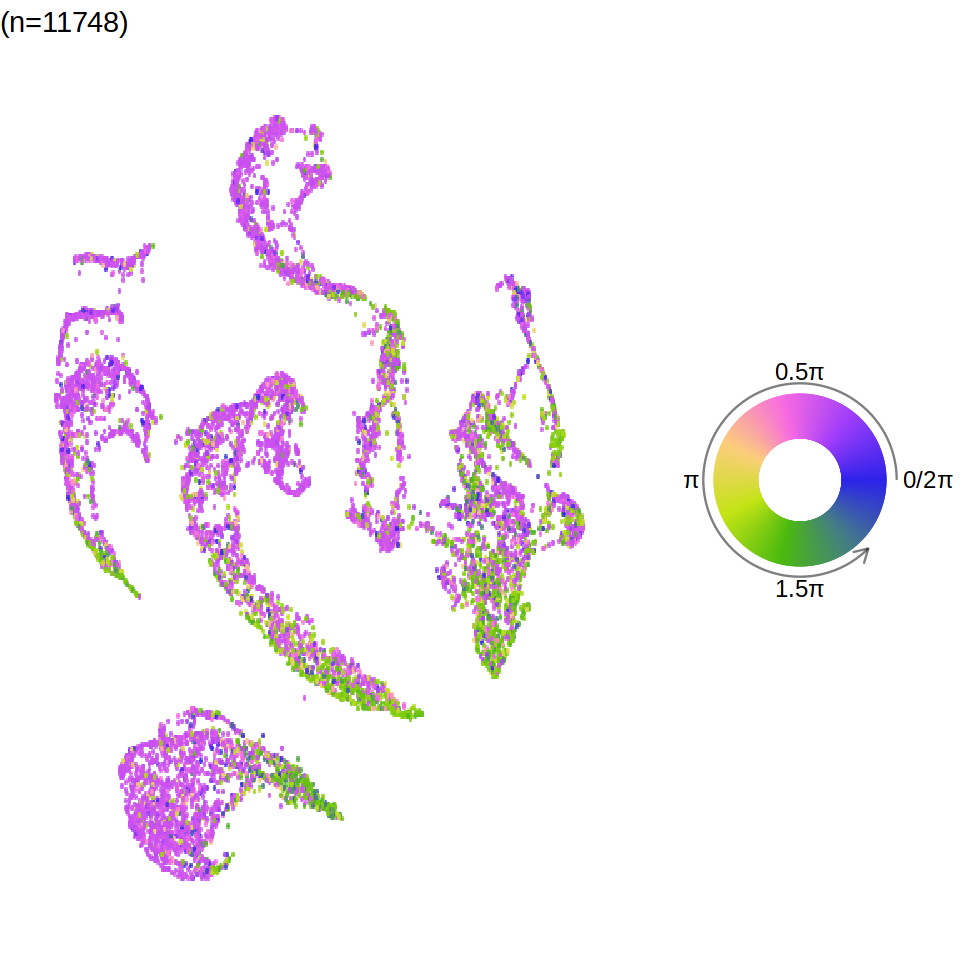

The number of projection genes found in the new data is 244.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


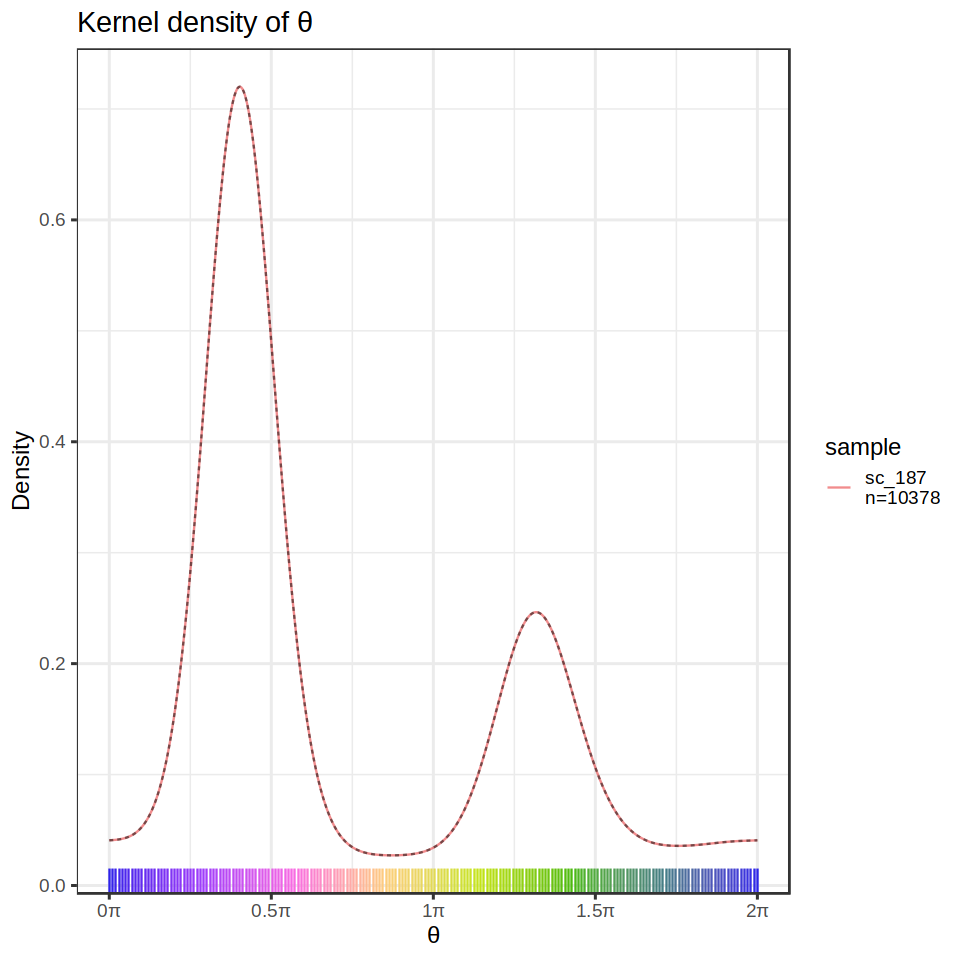

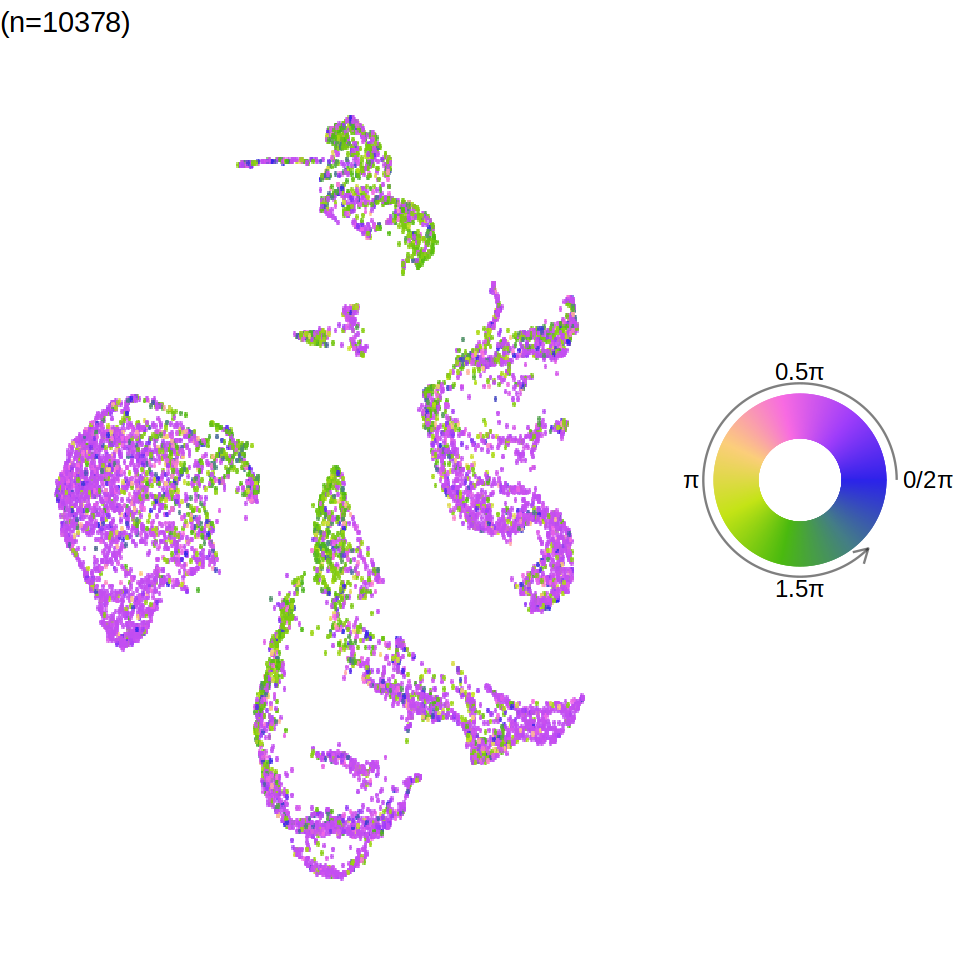

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


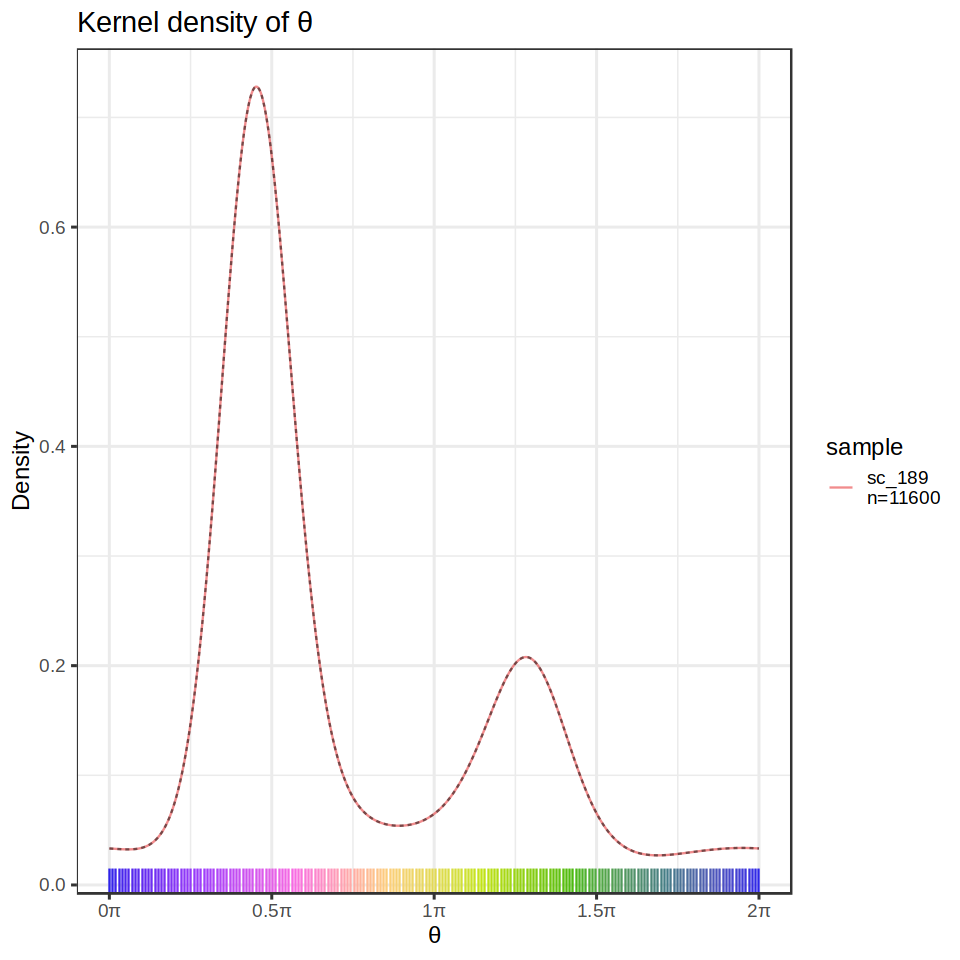

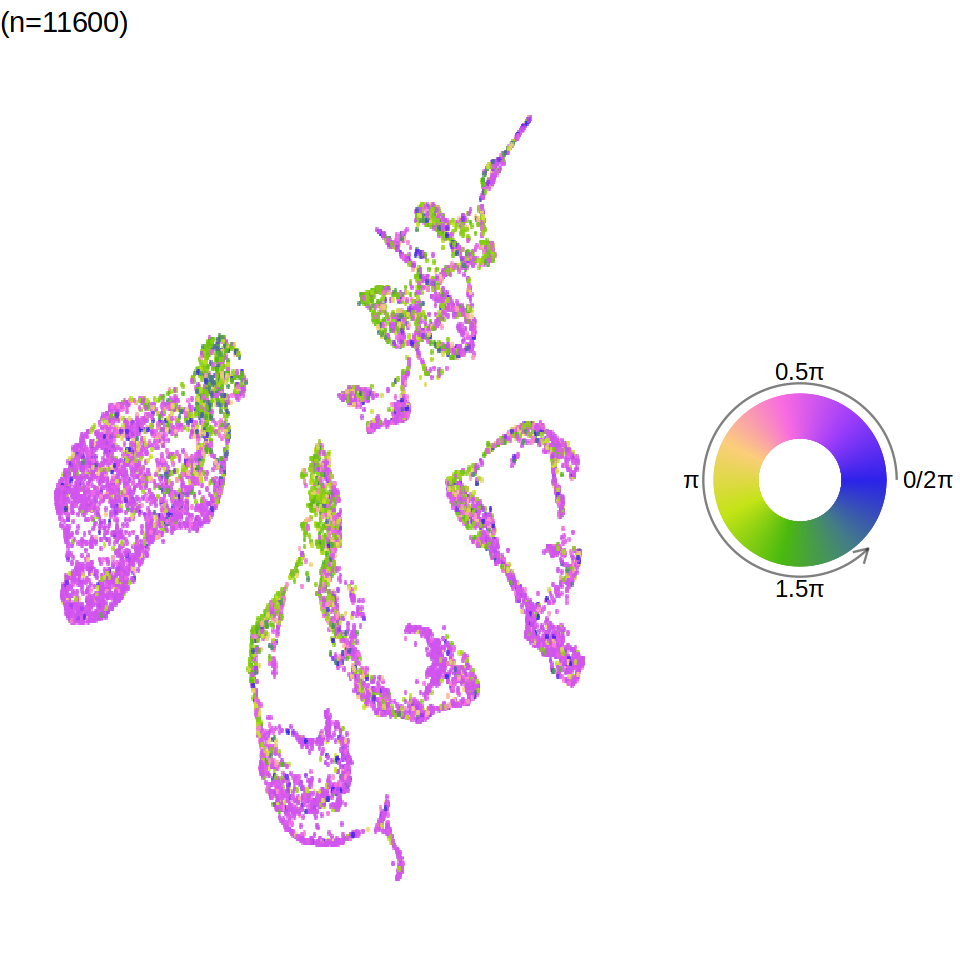

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


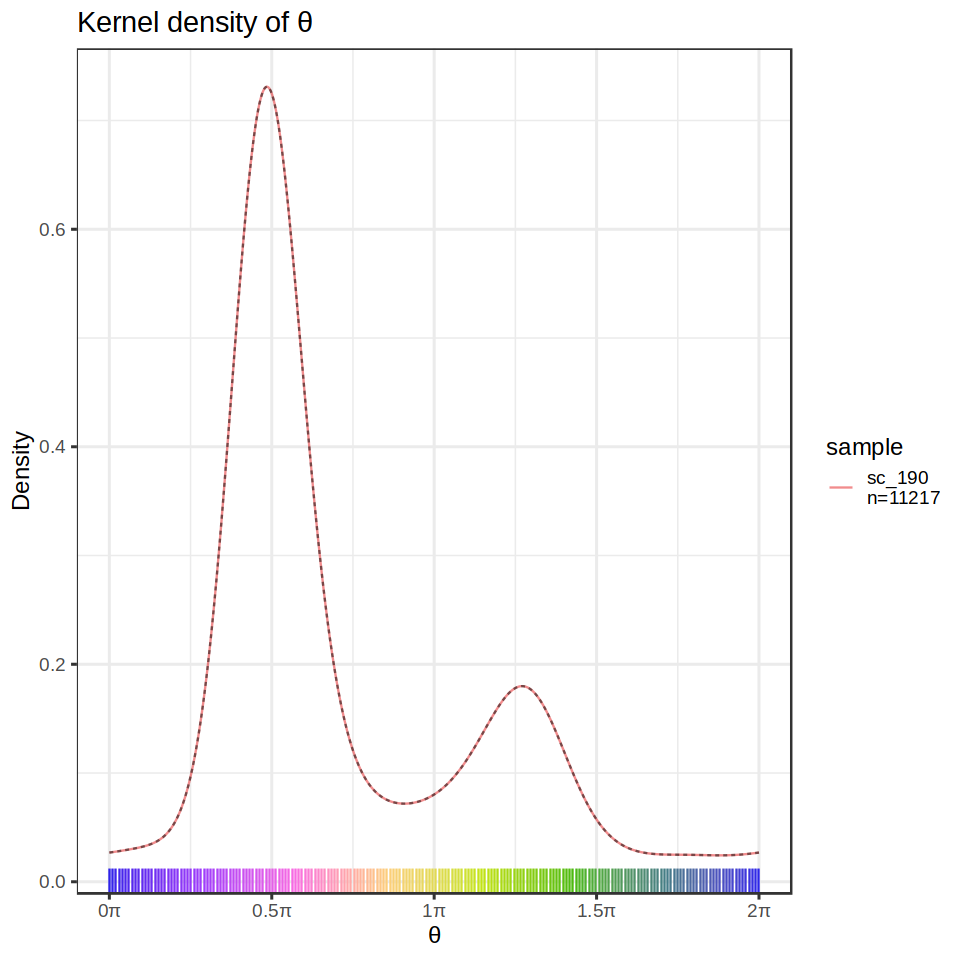

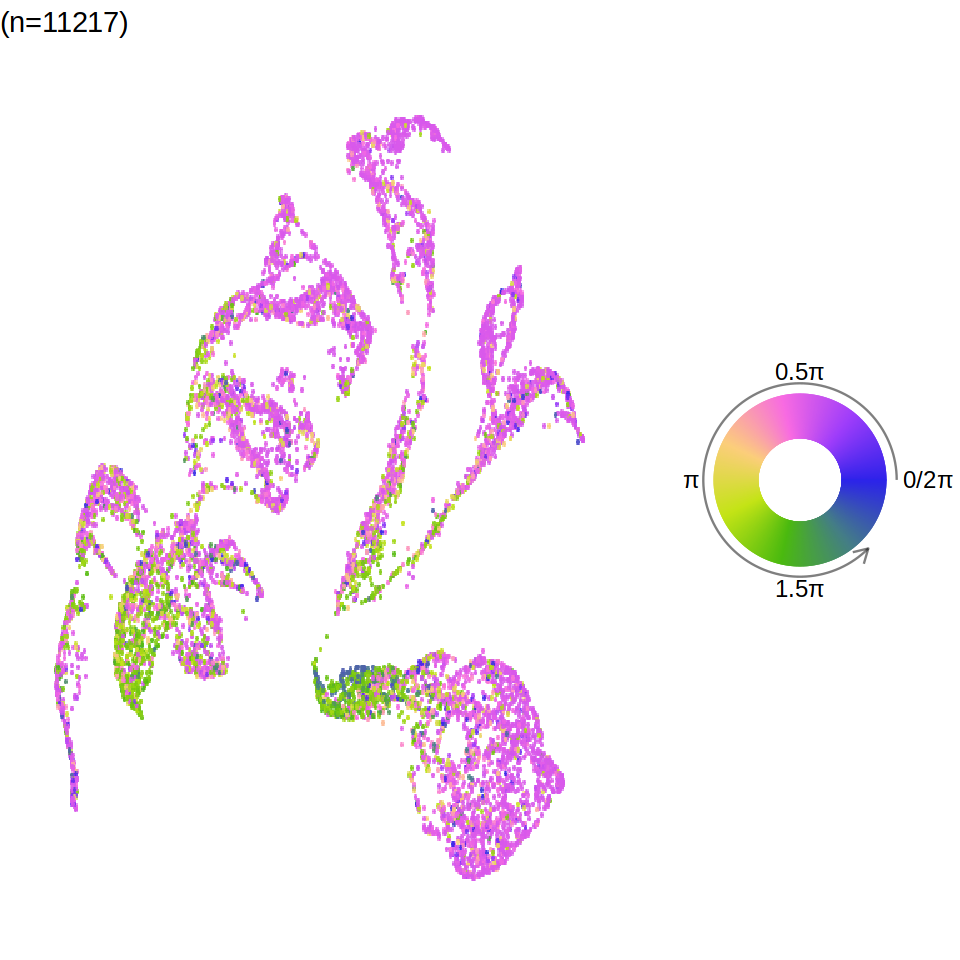

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


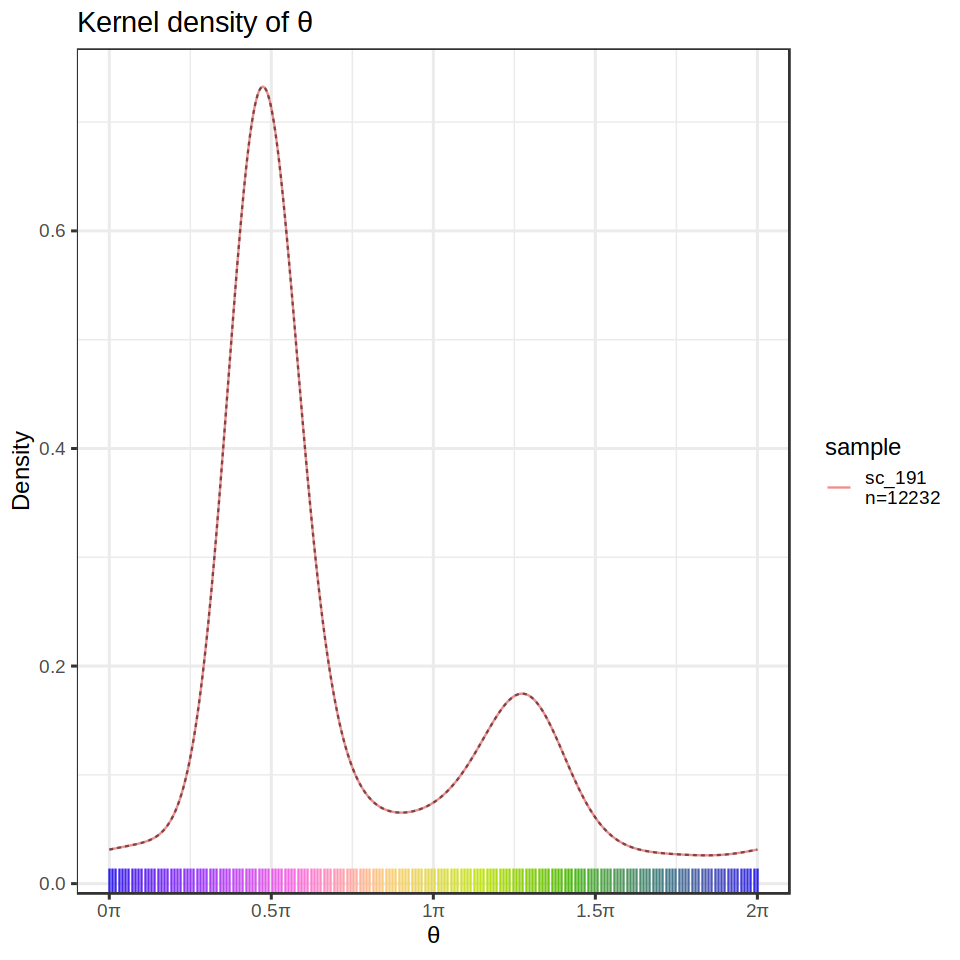

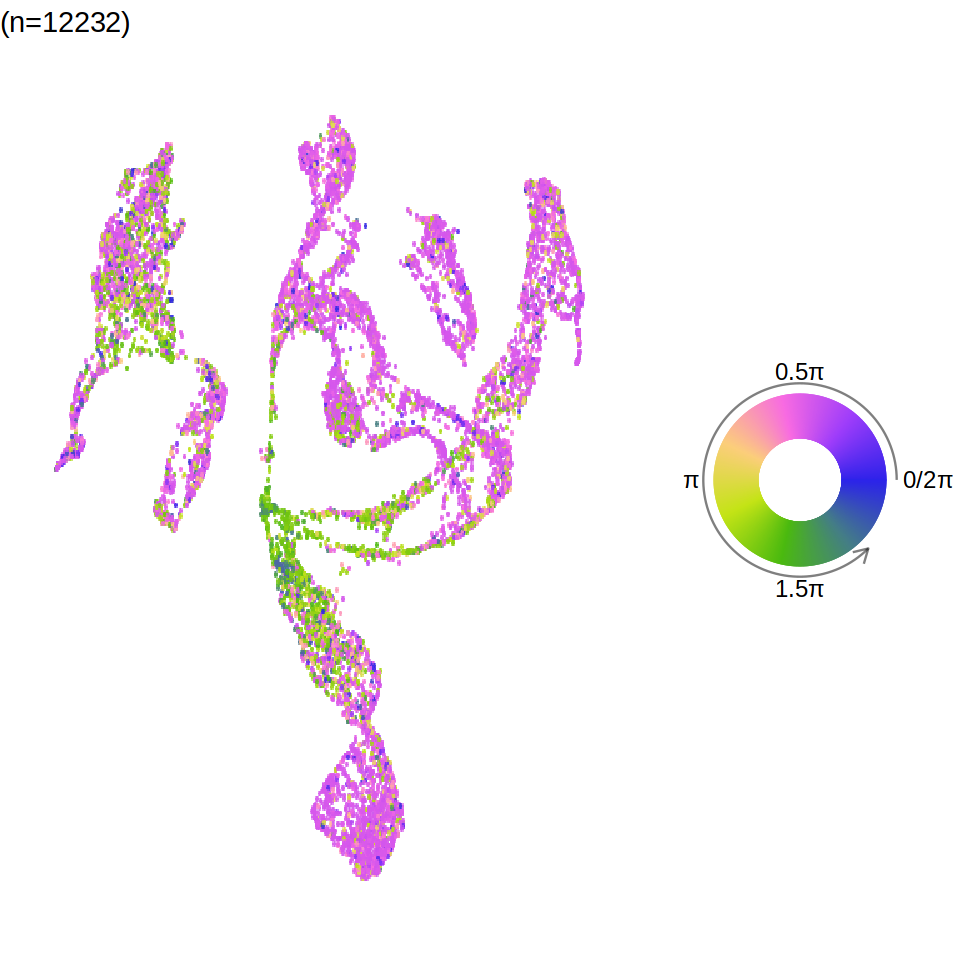

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


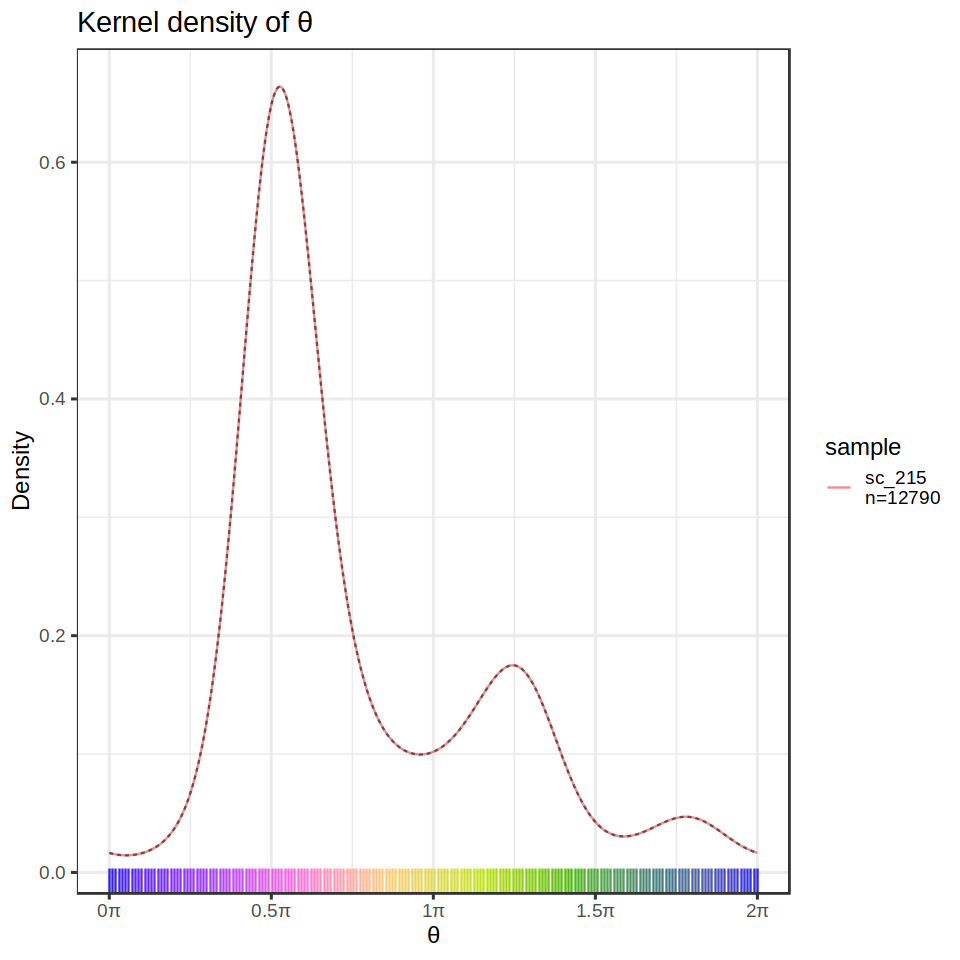

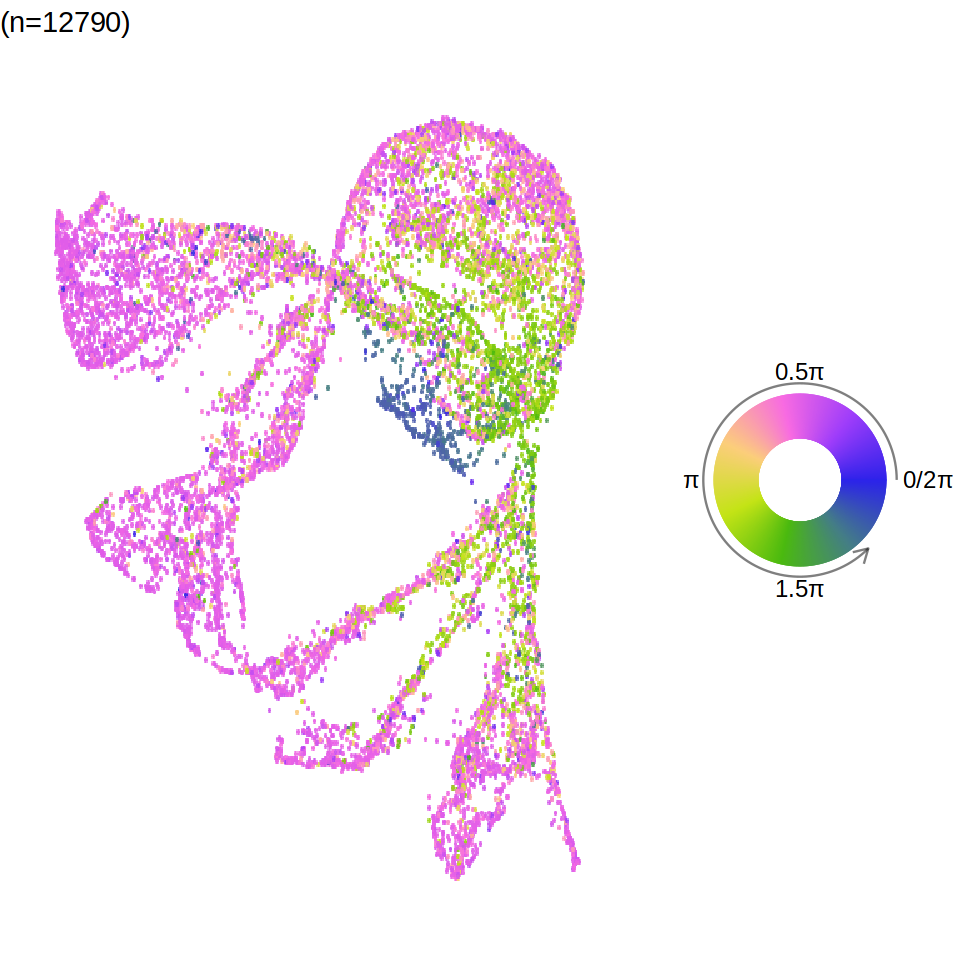

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


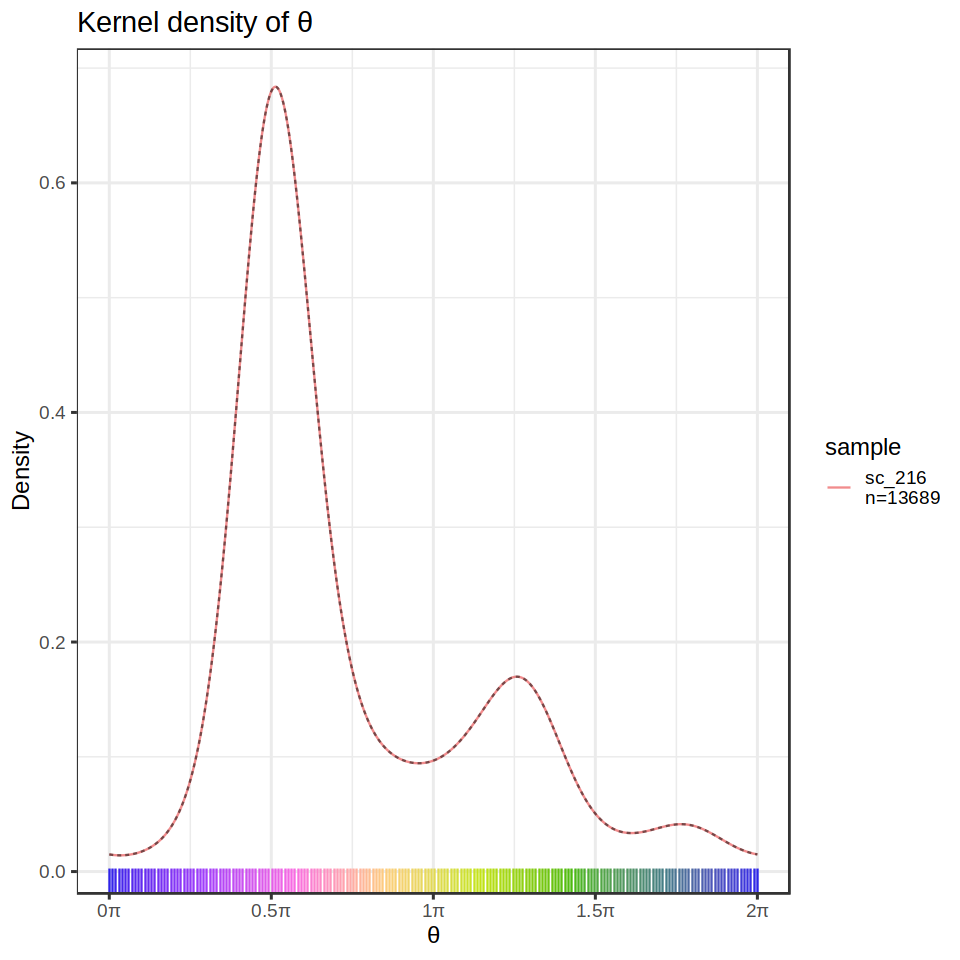

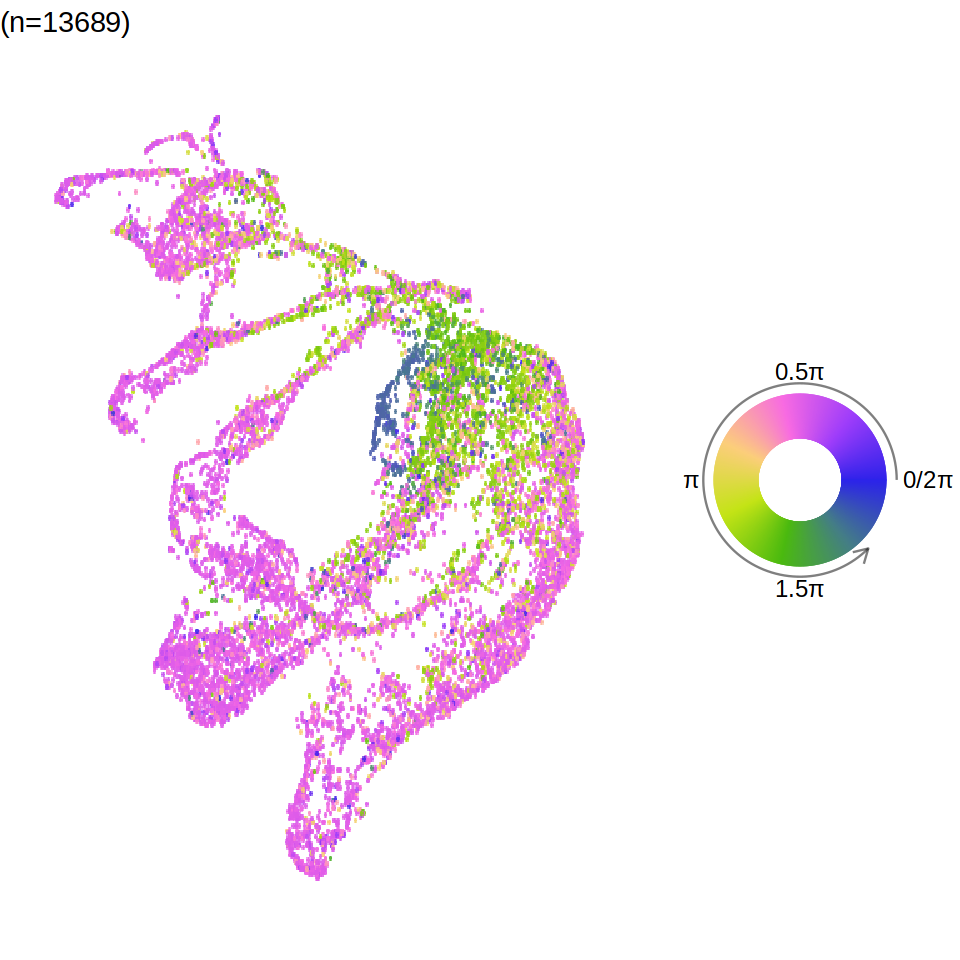

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


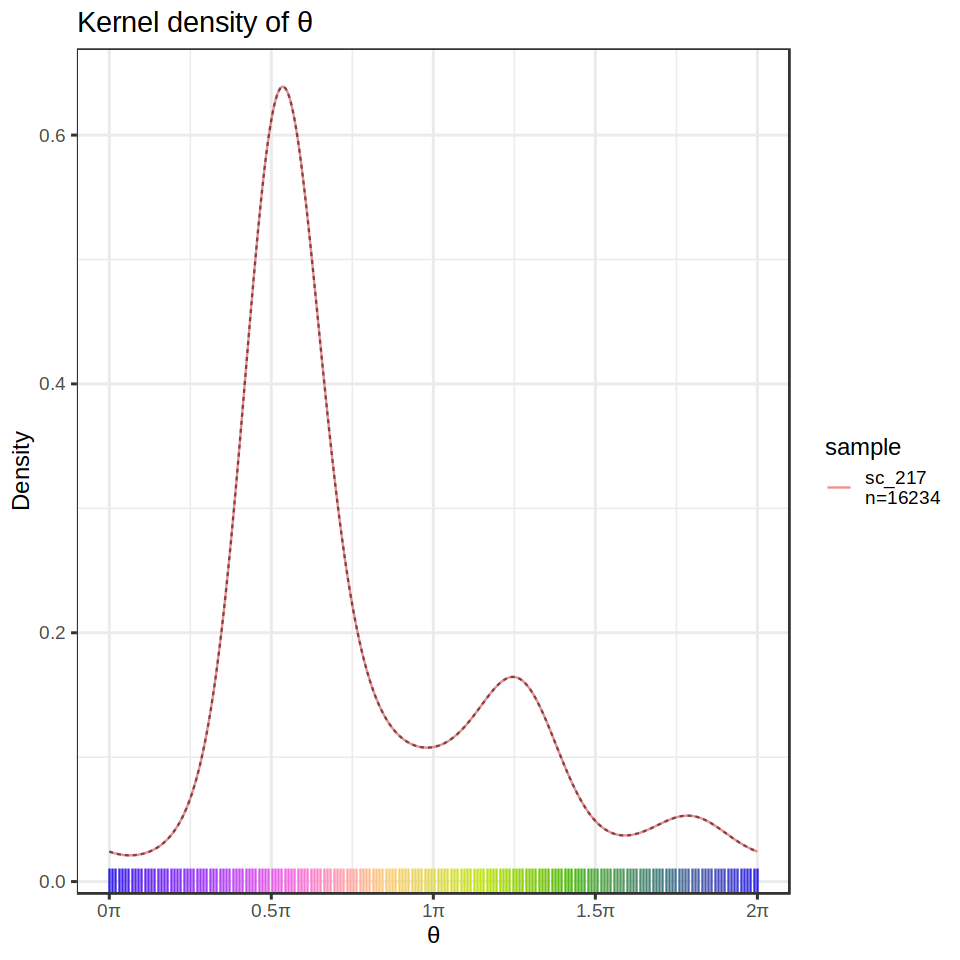

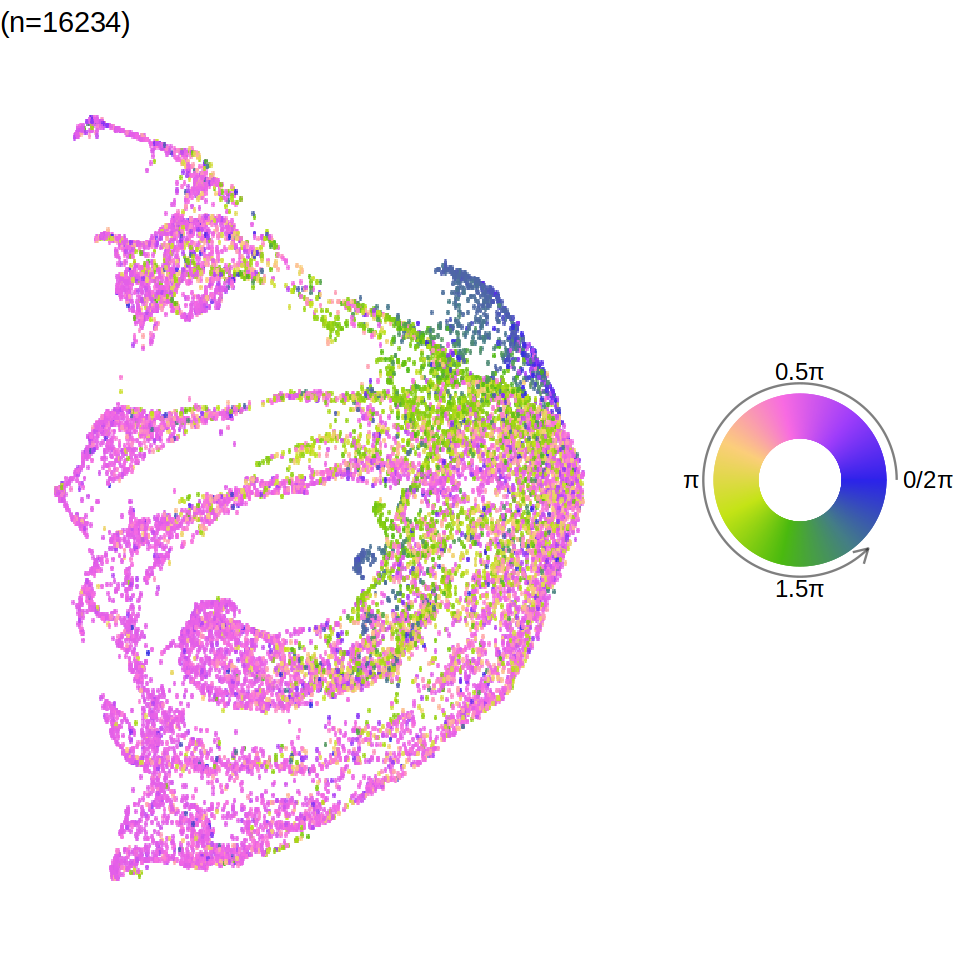

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


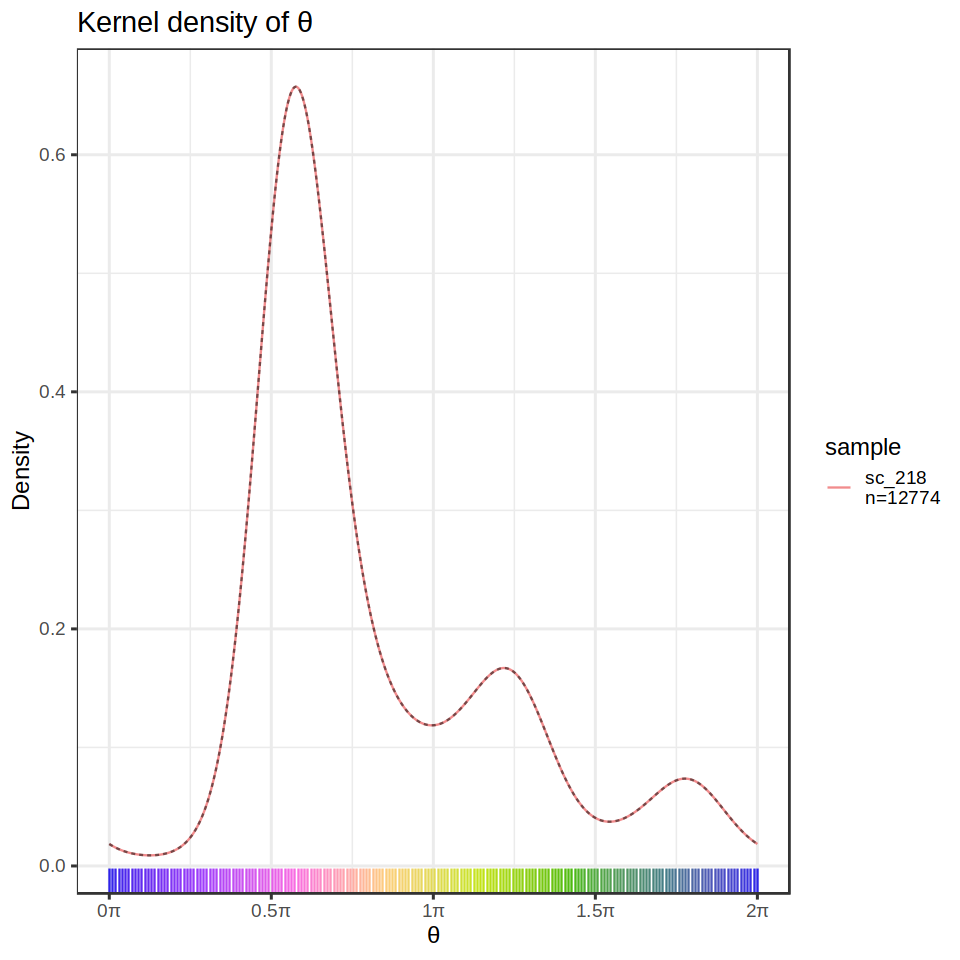

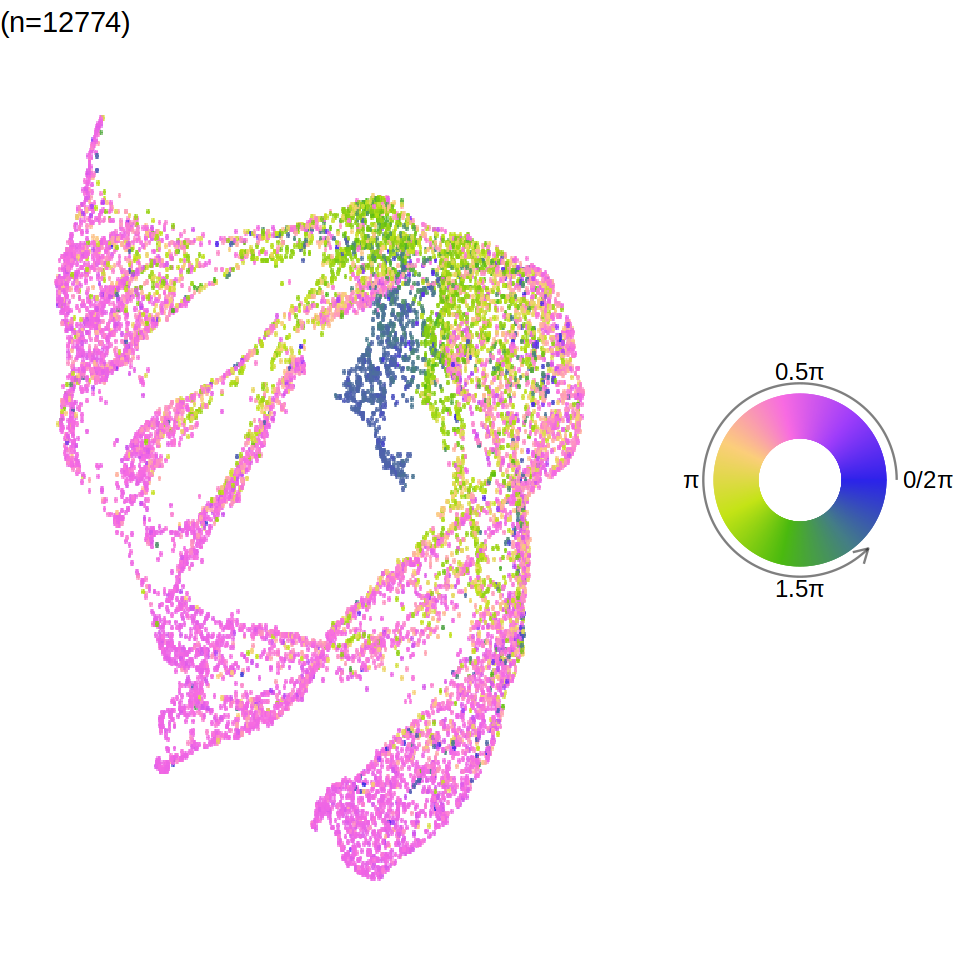

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


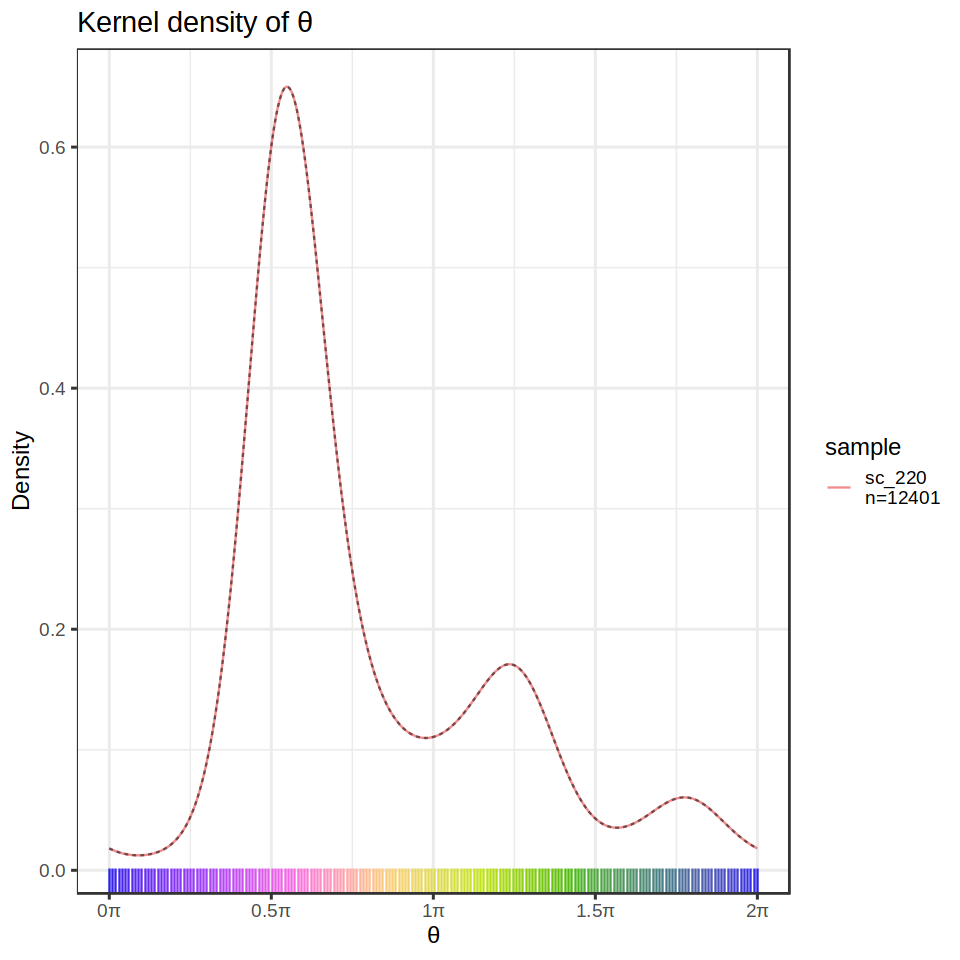

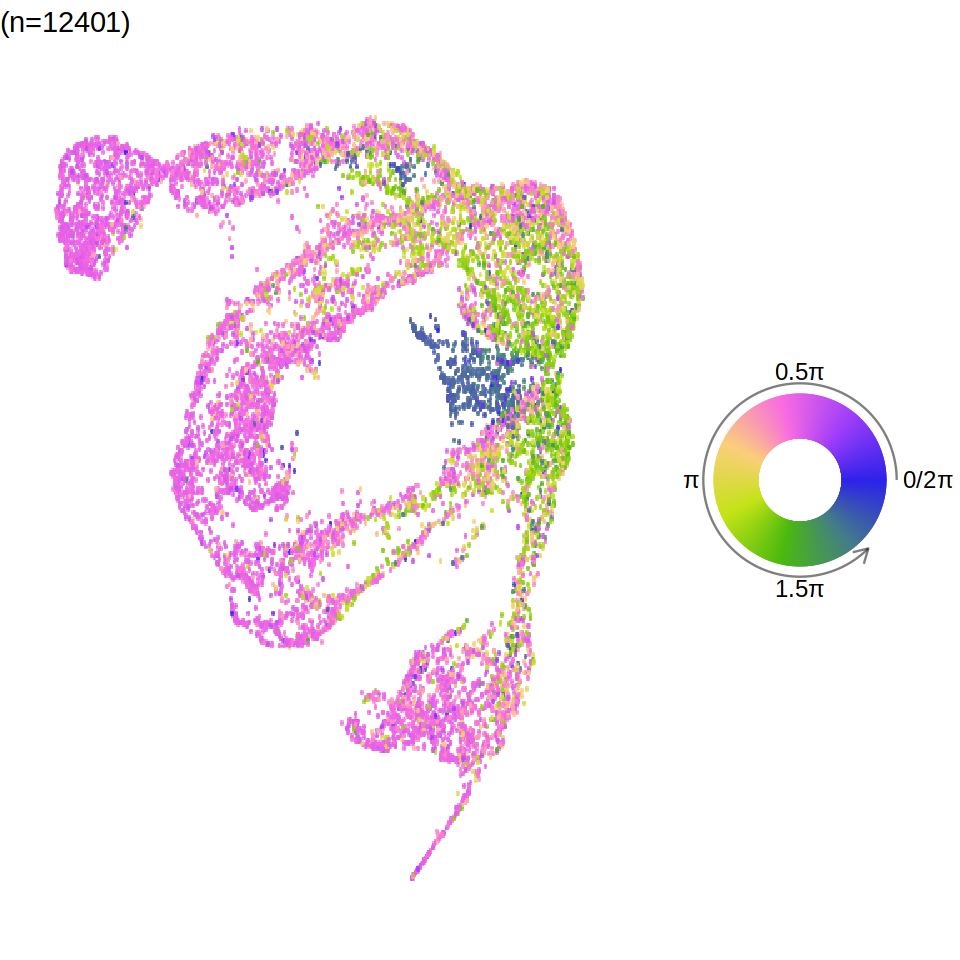

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


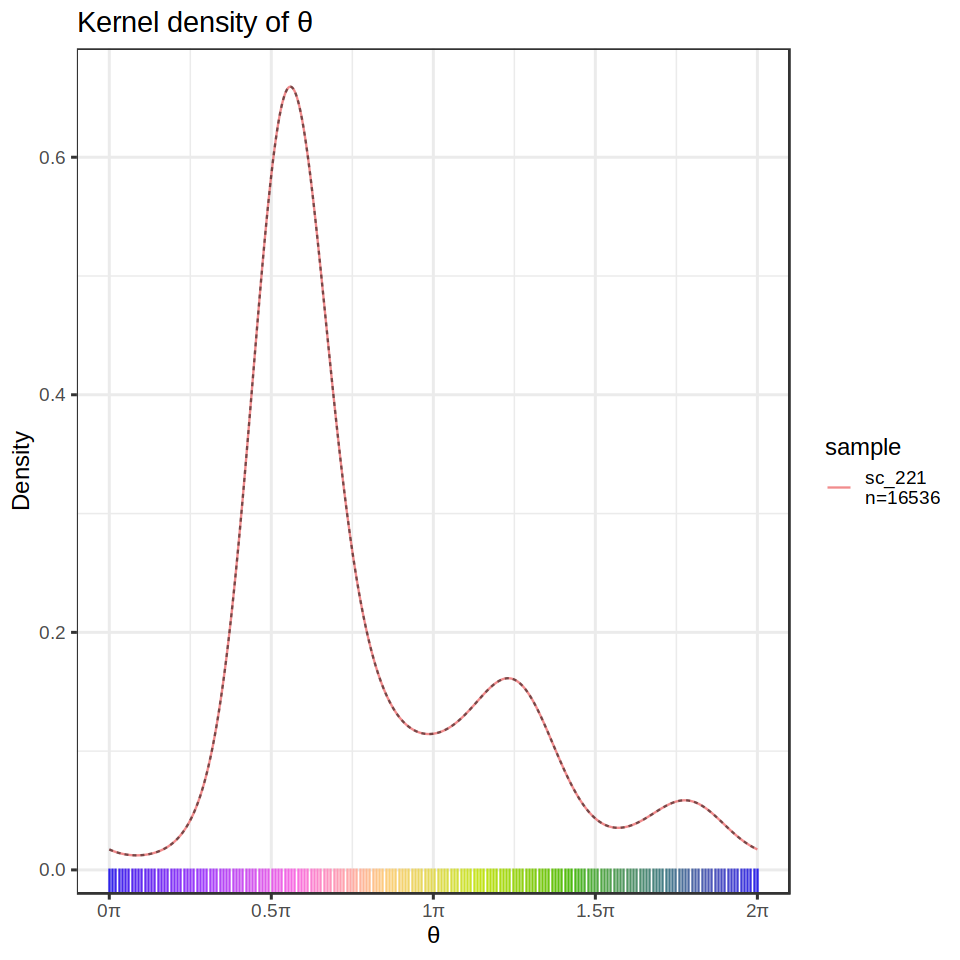

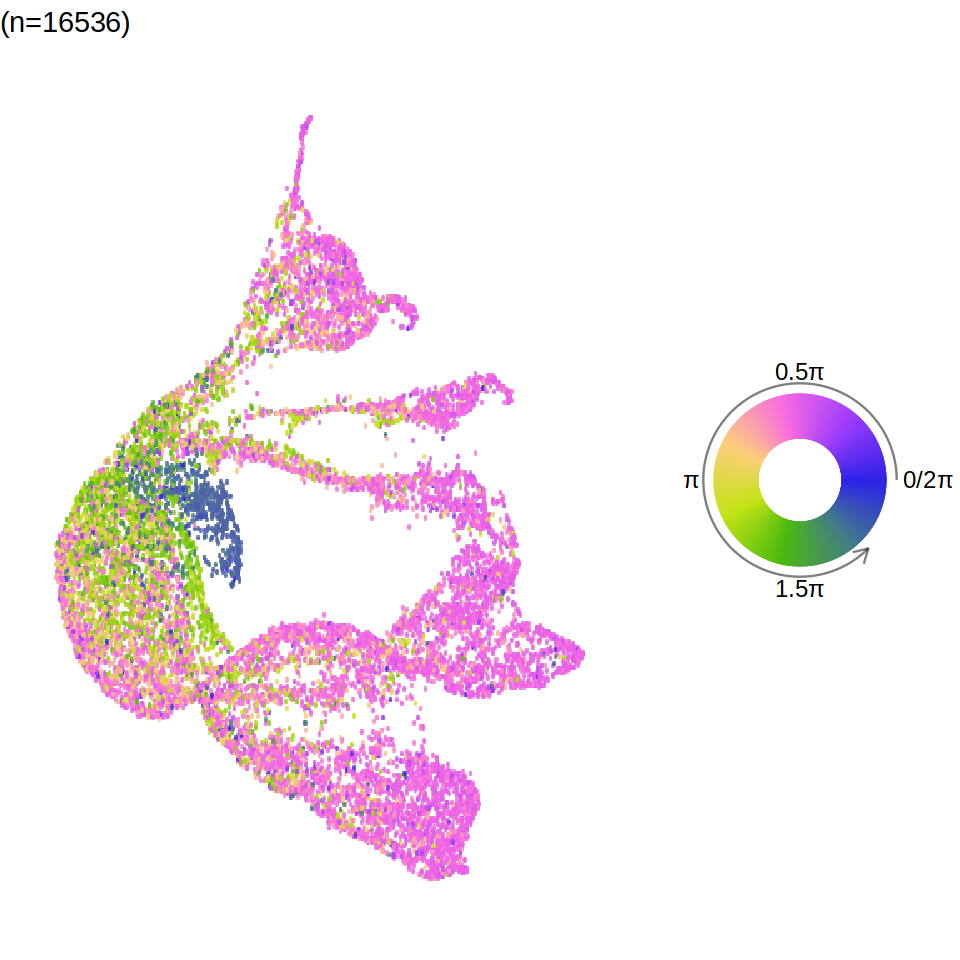

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


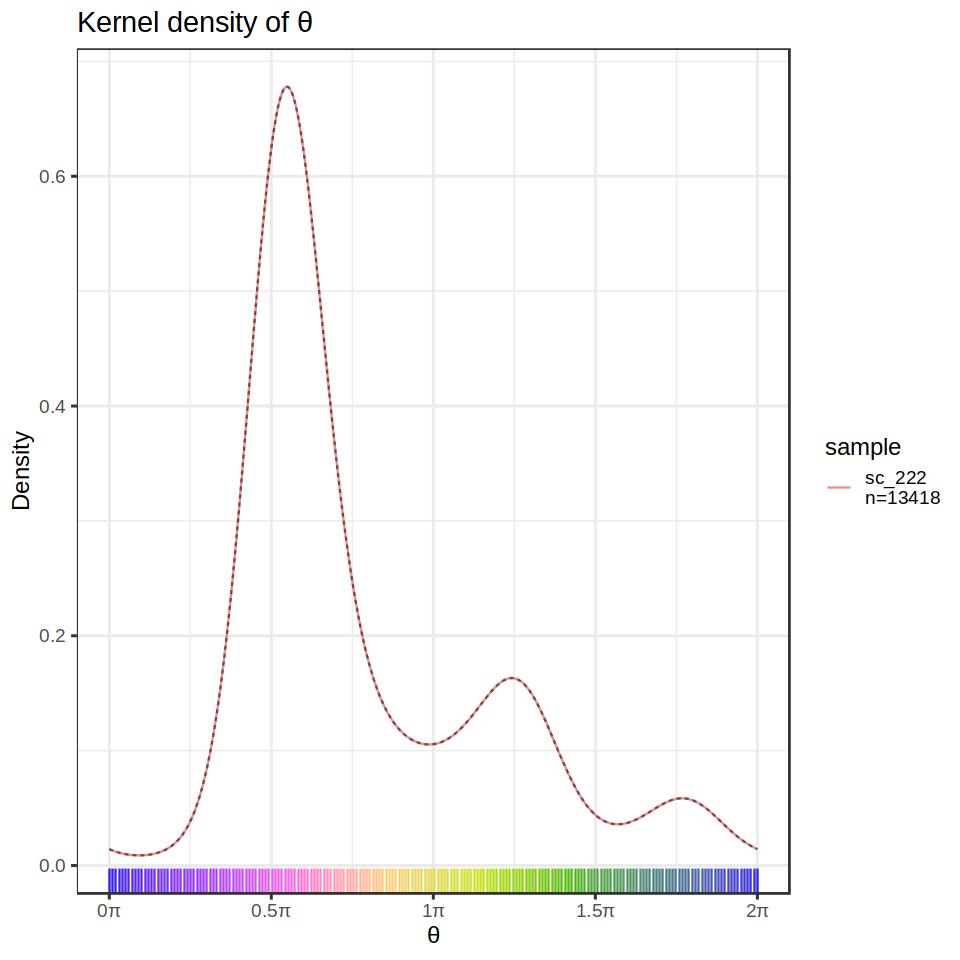

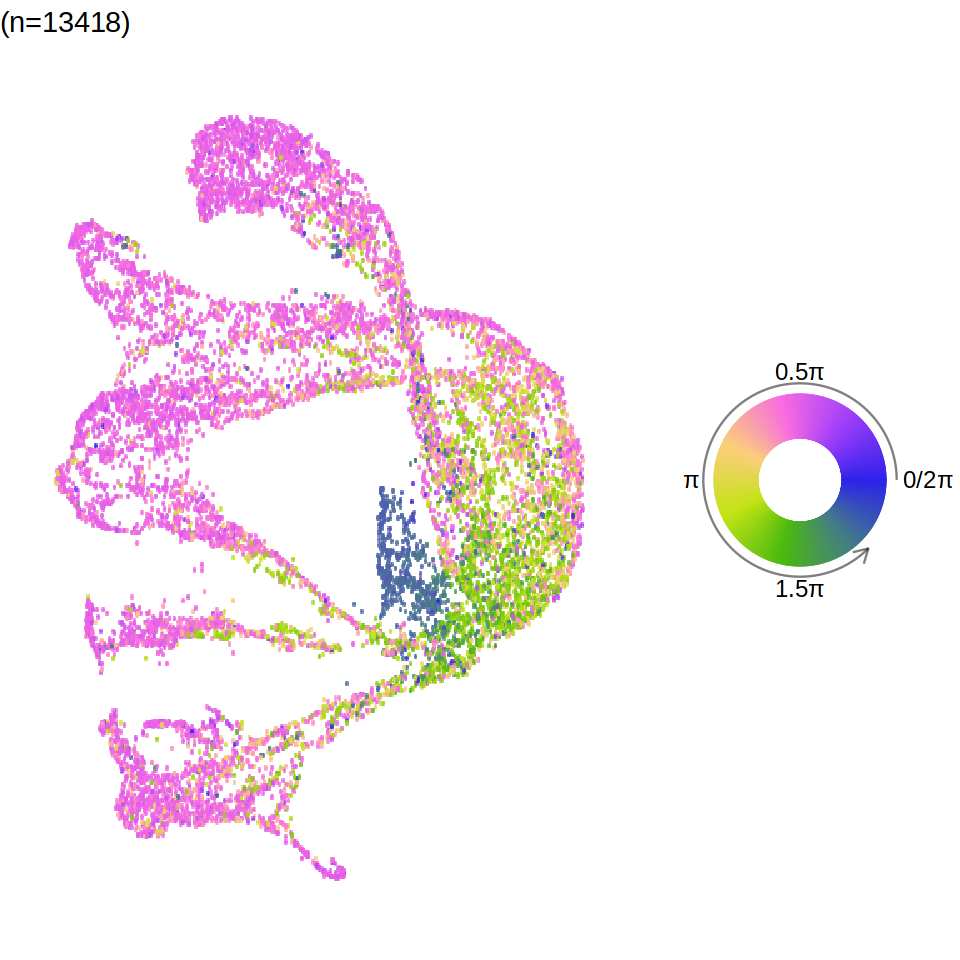

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


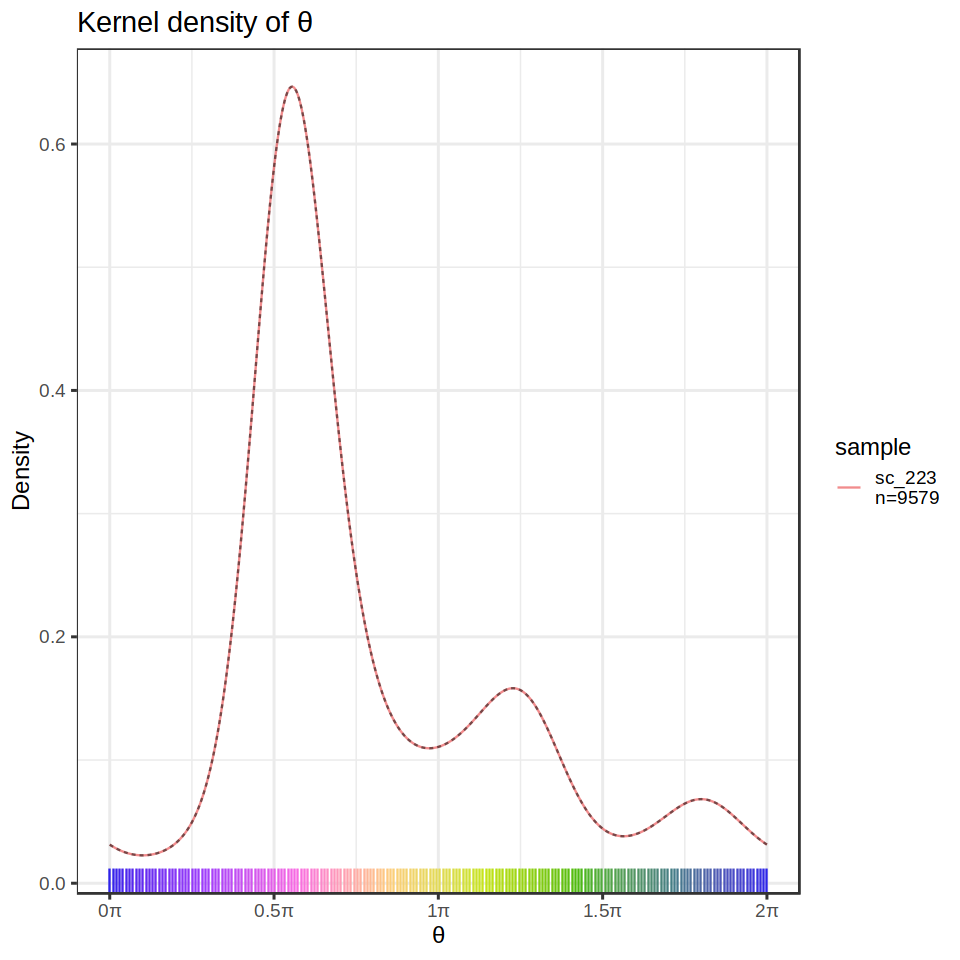

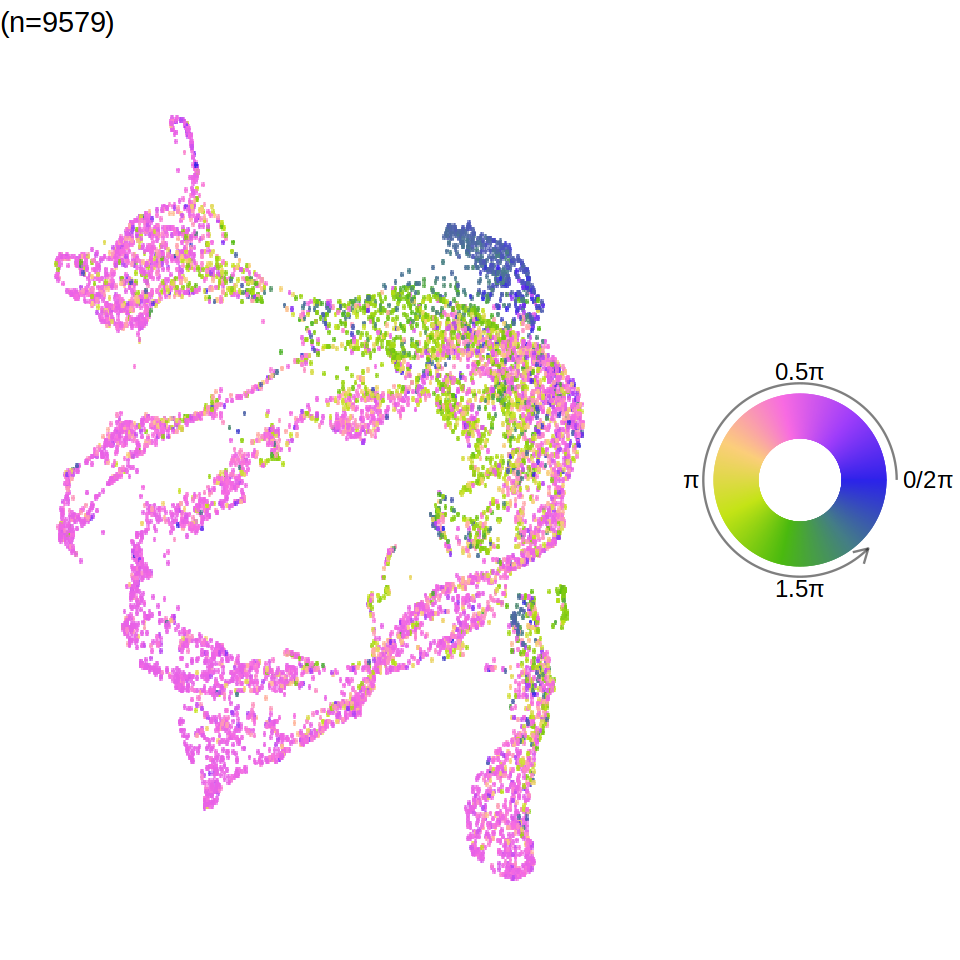

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


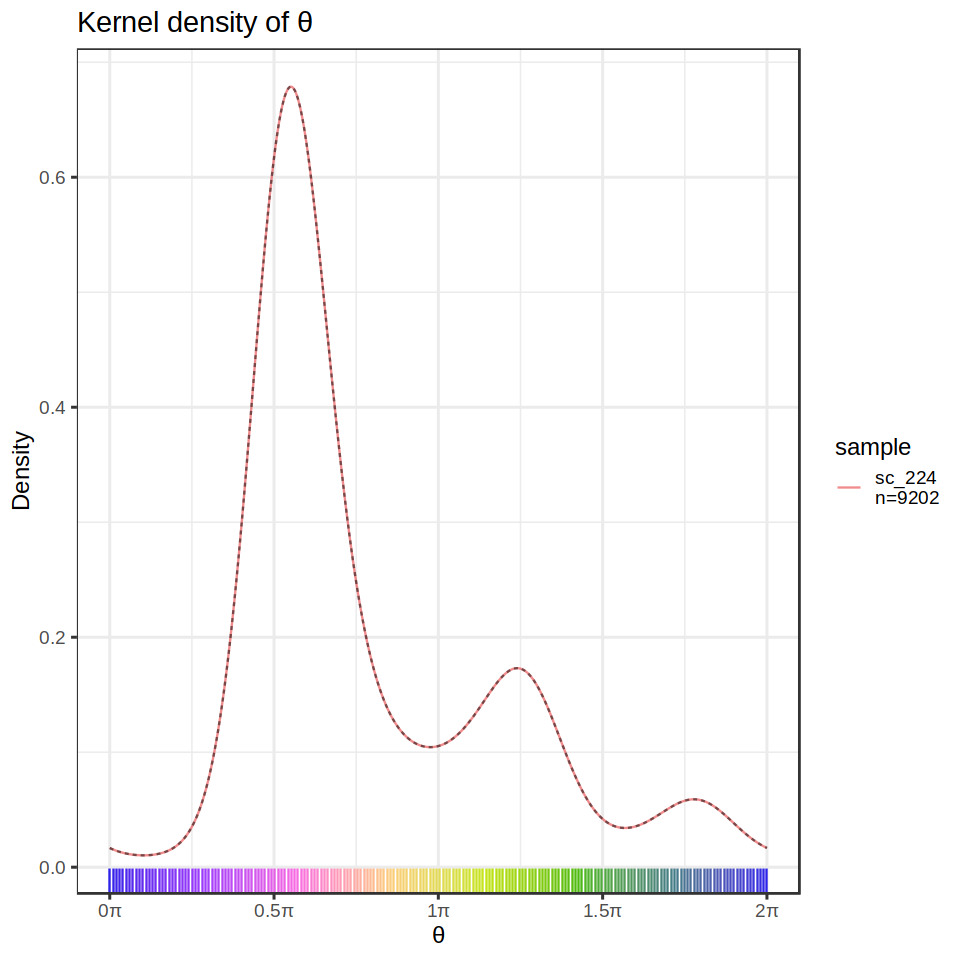

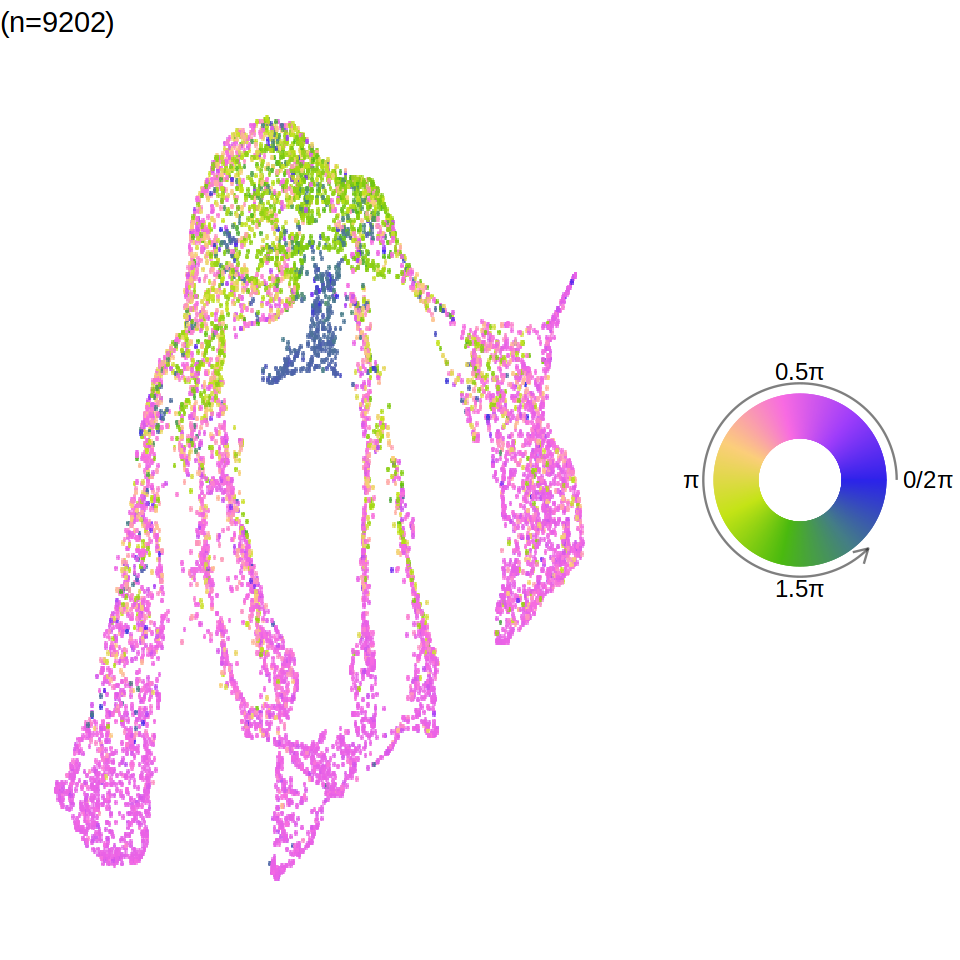

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


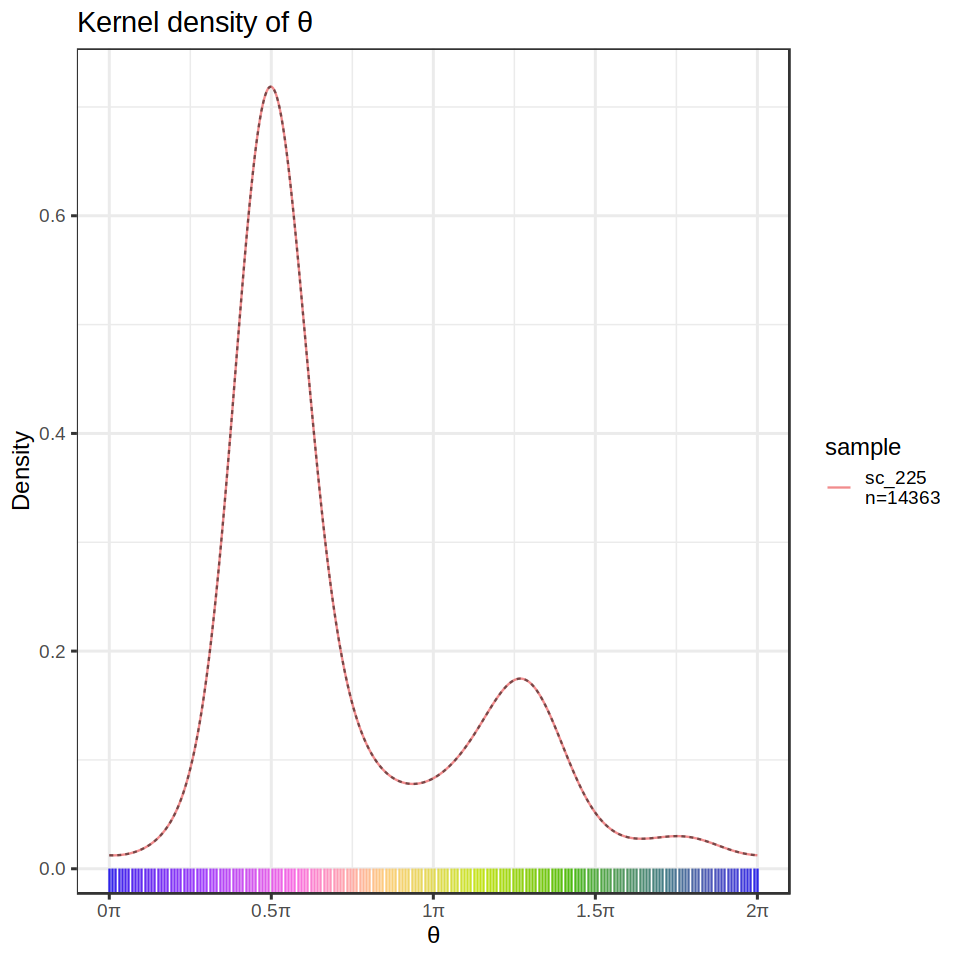

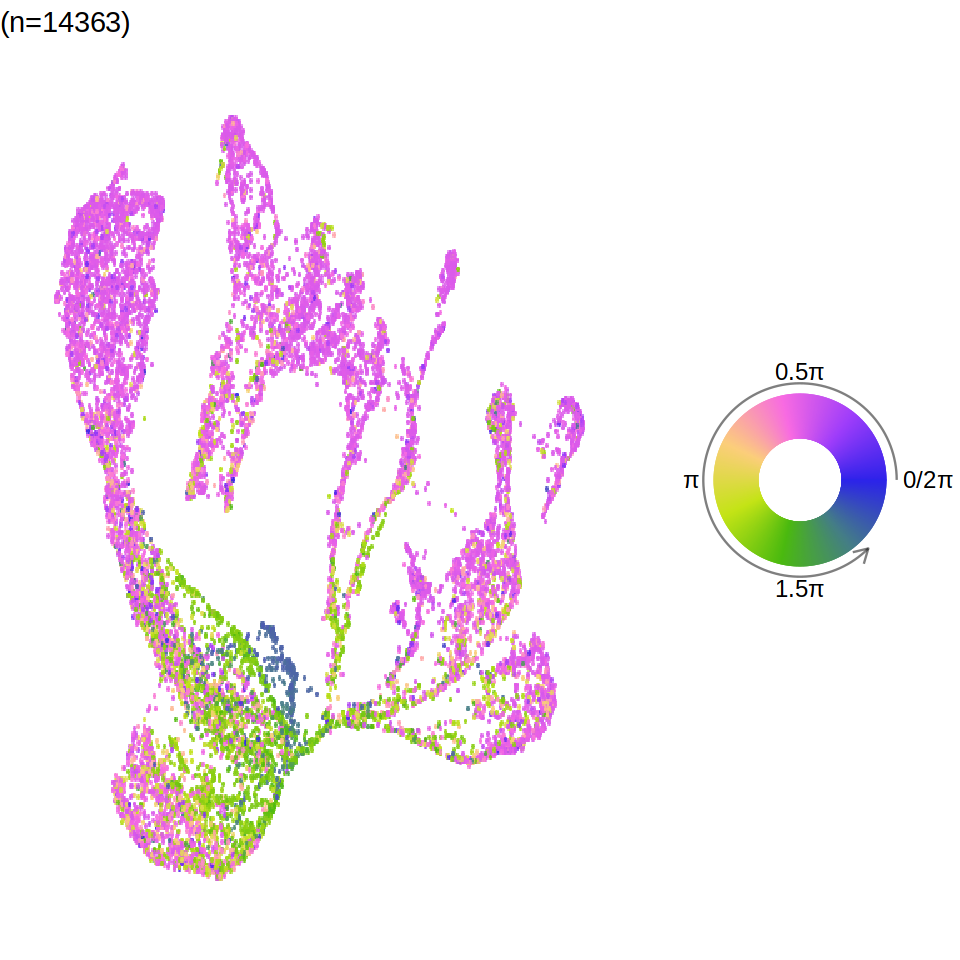

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


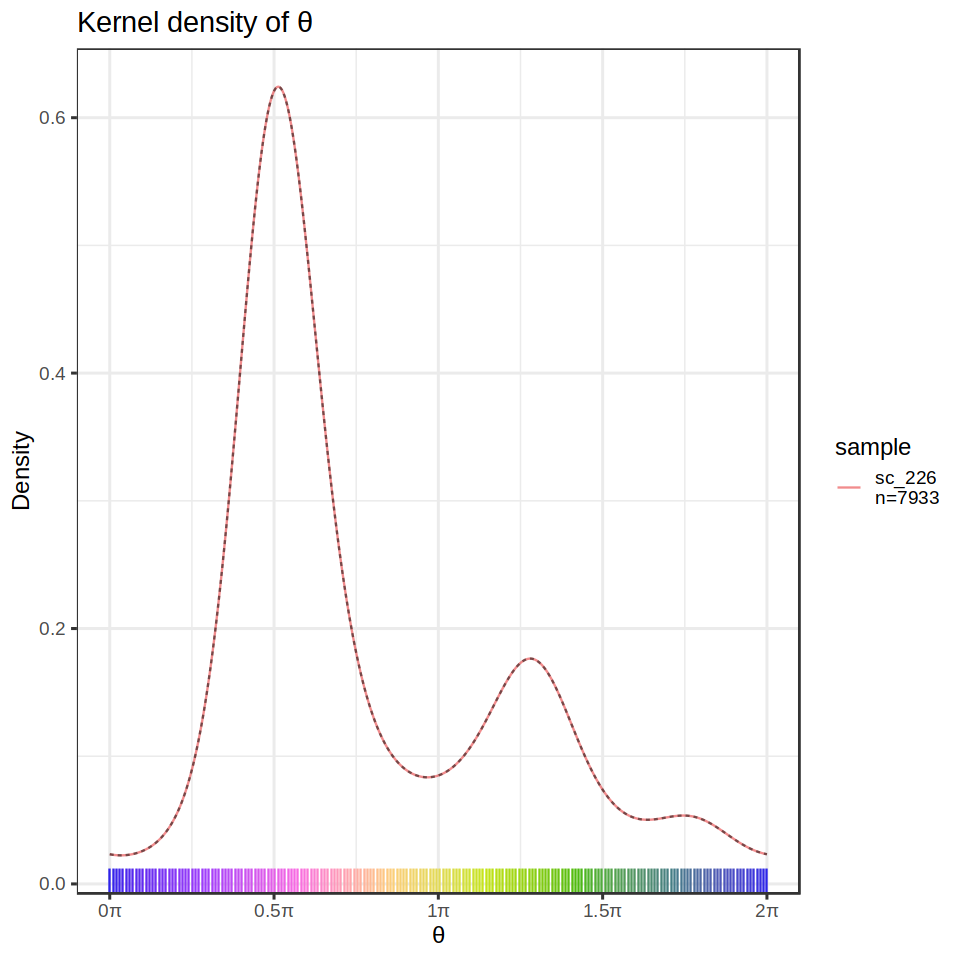

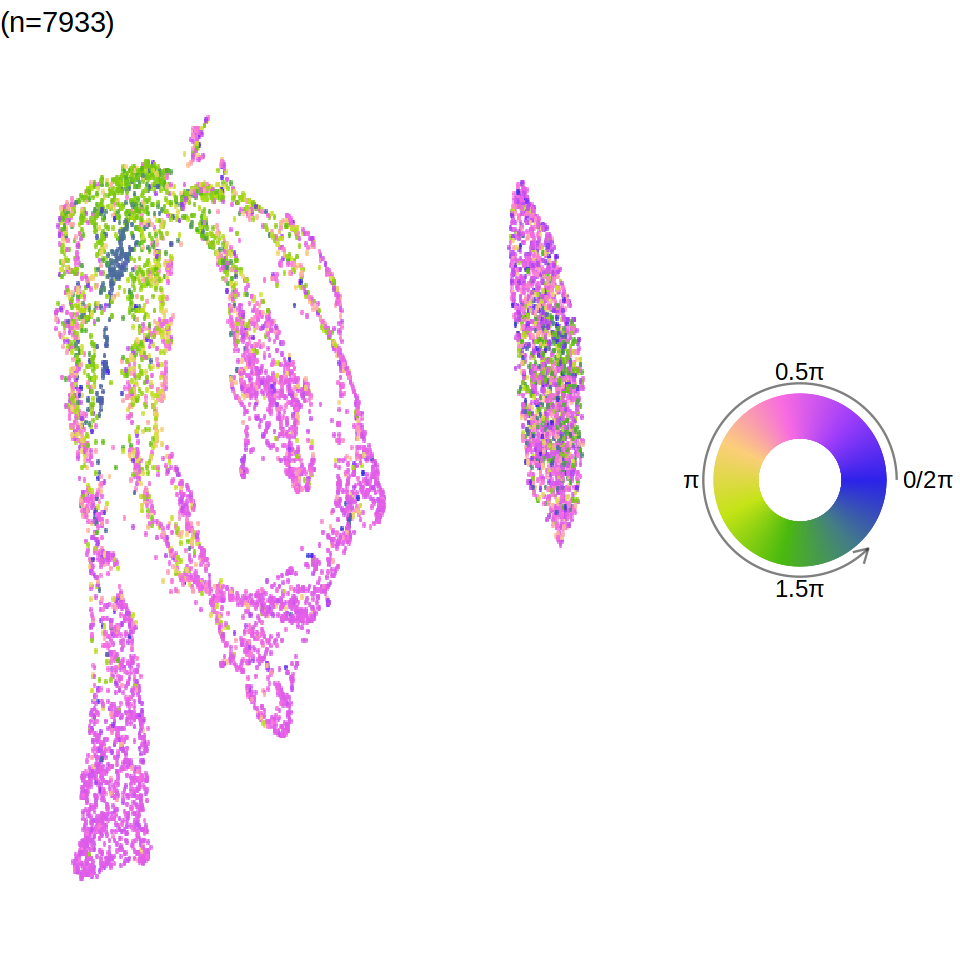

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


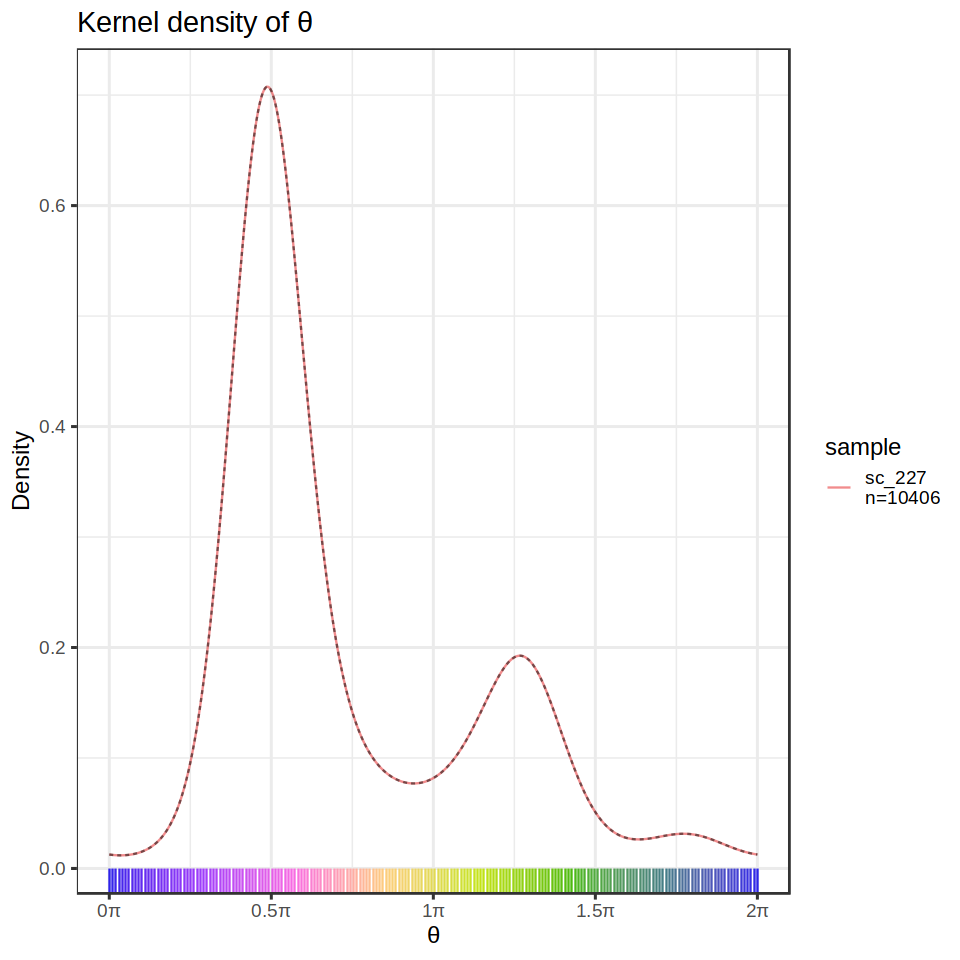

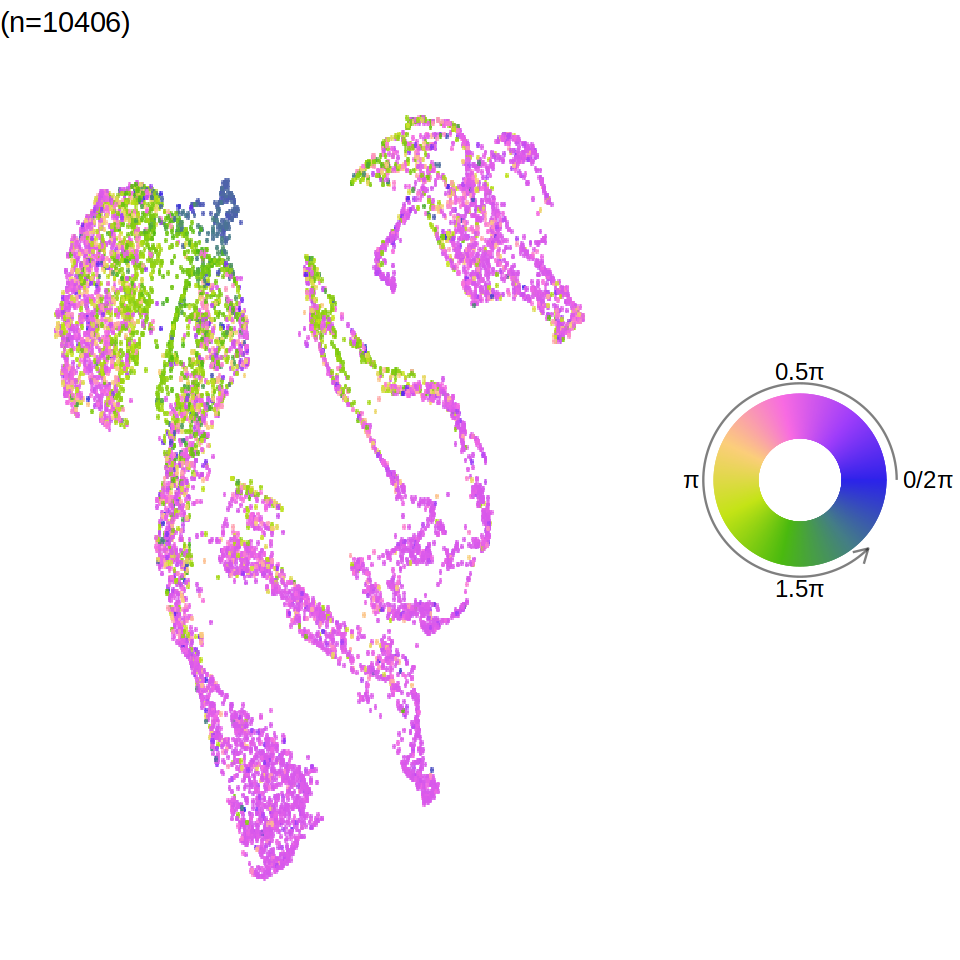

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


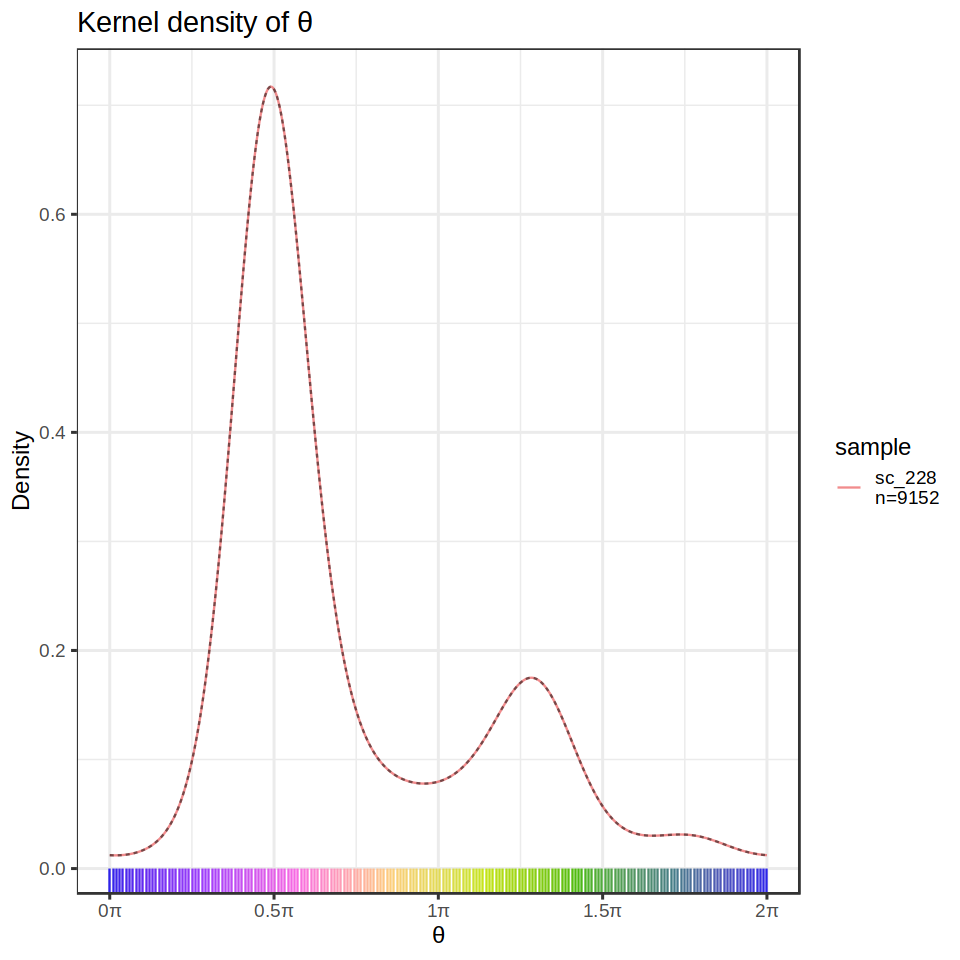

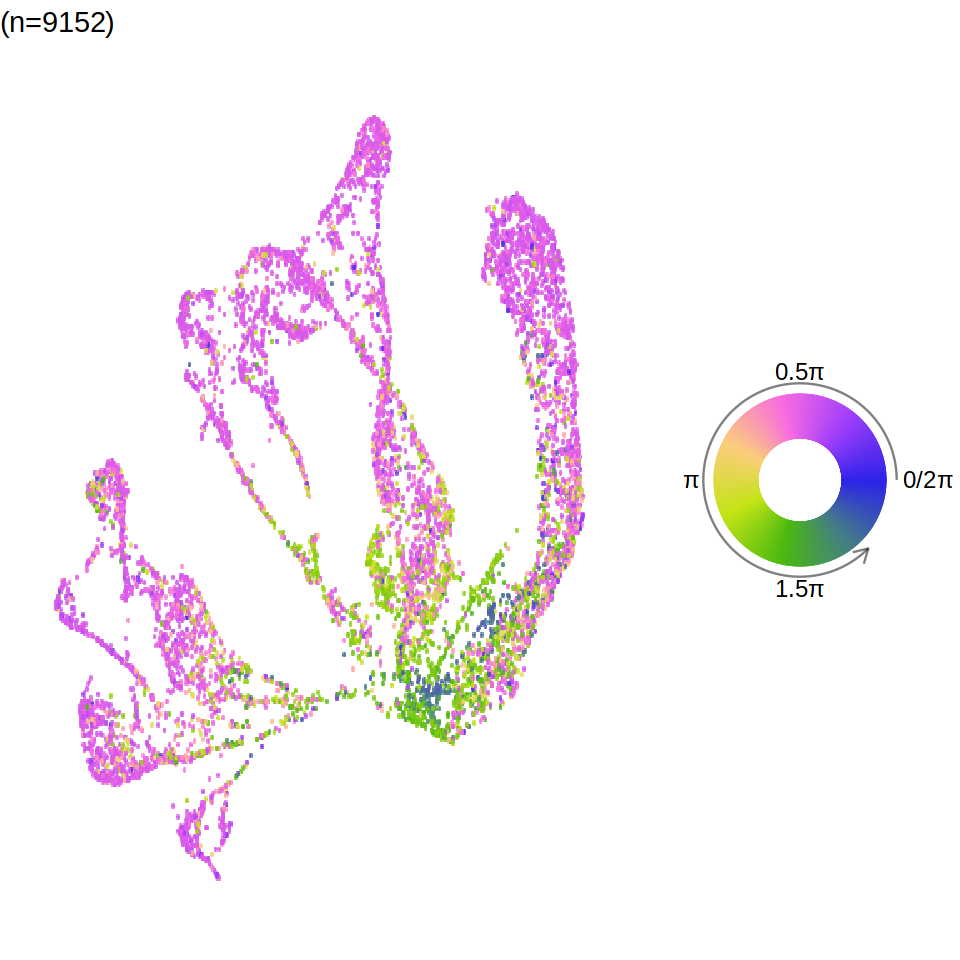

The number of projection genes found in the new data is 245.

Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


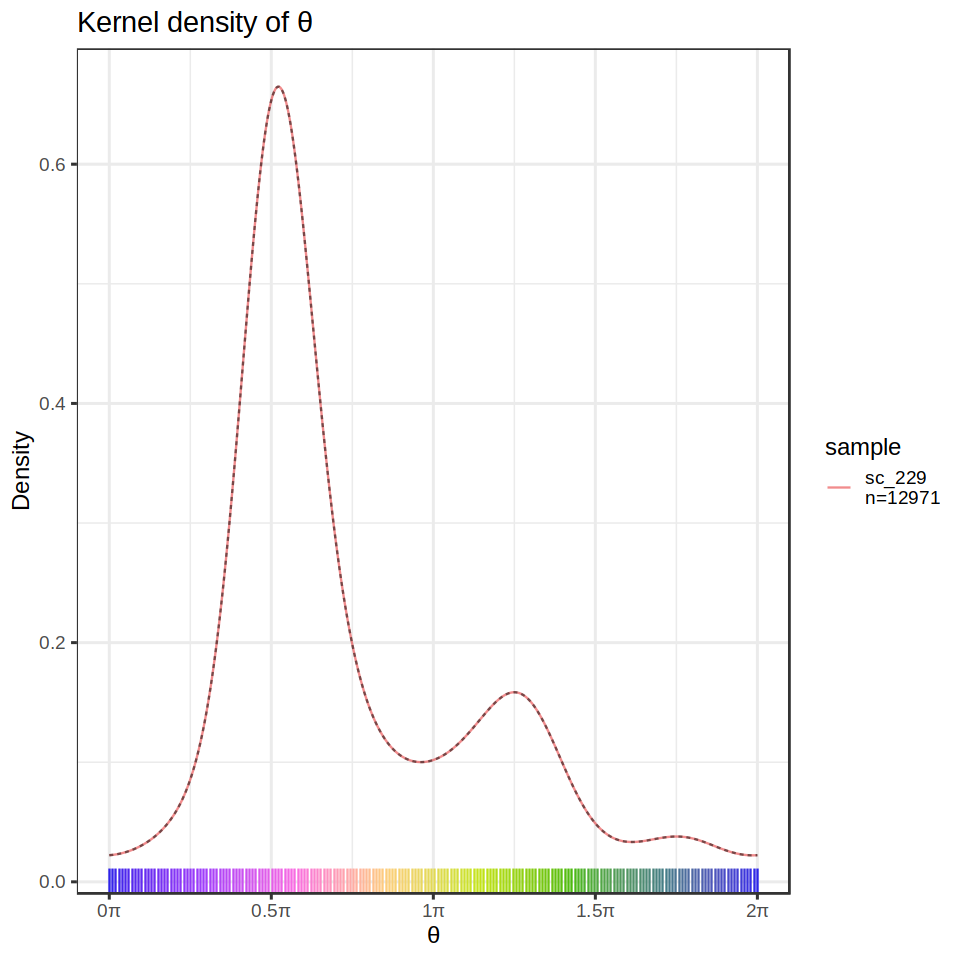

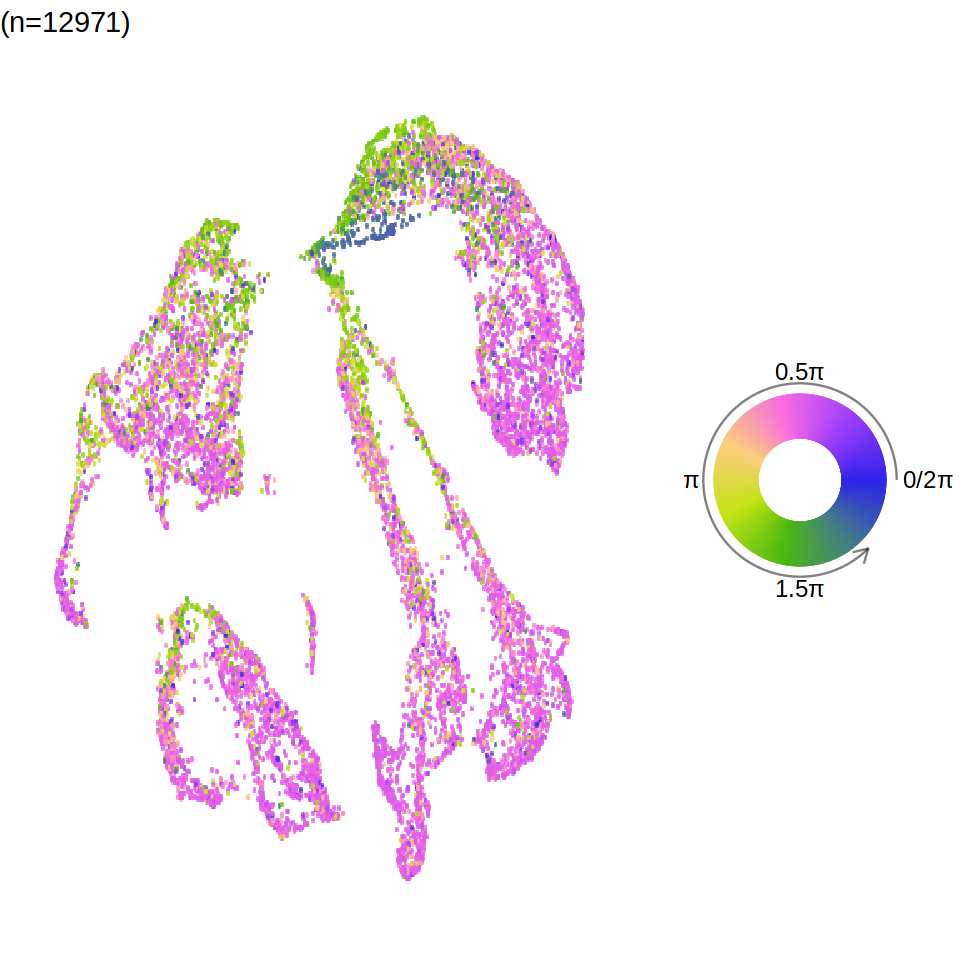

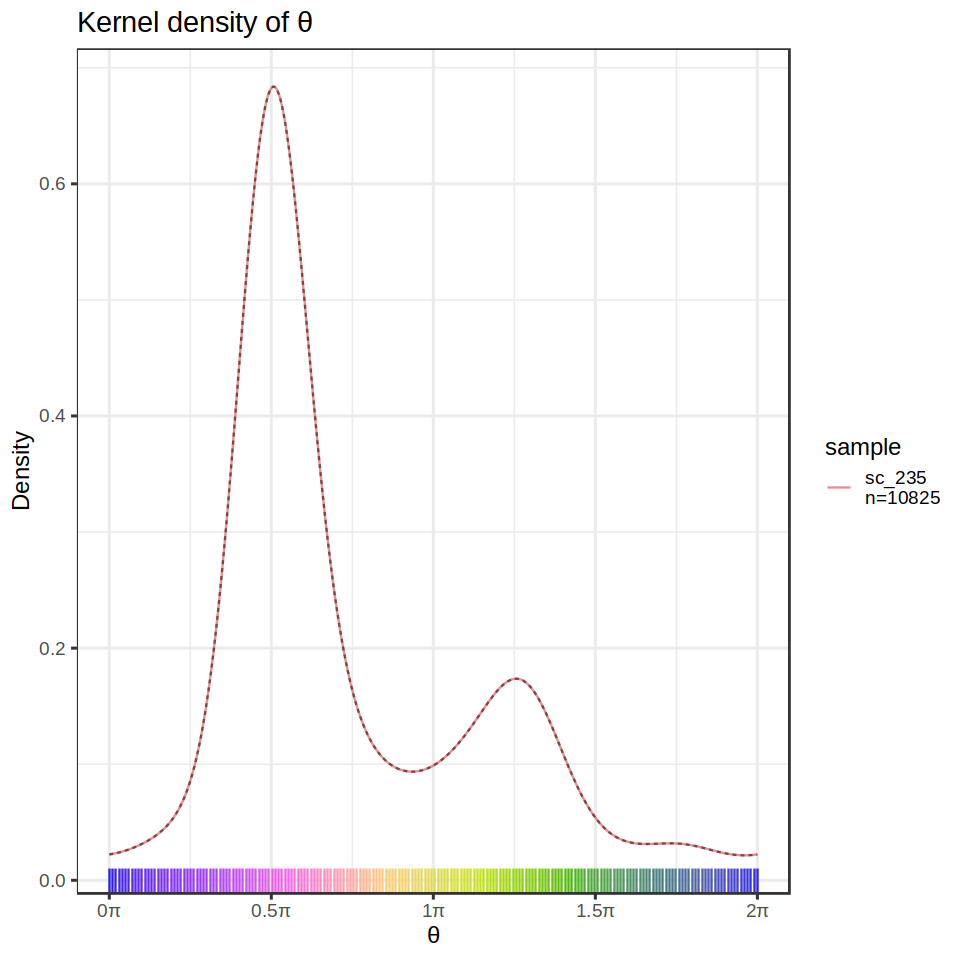

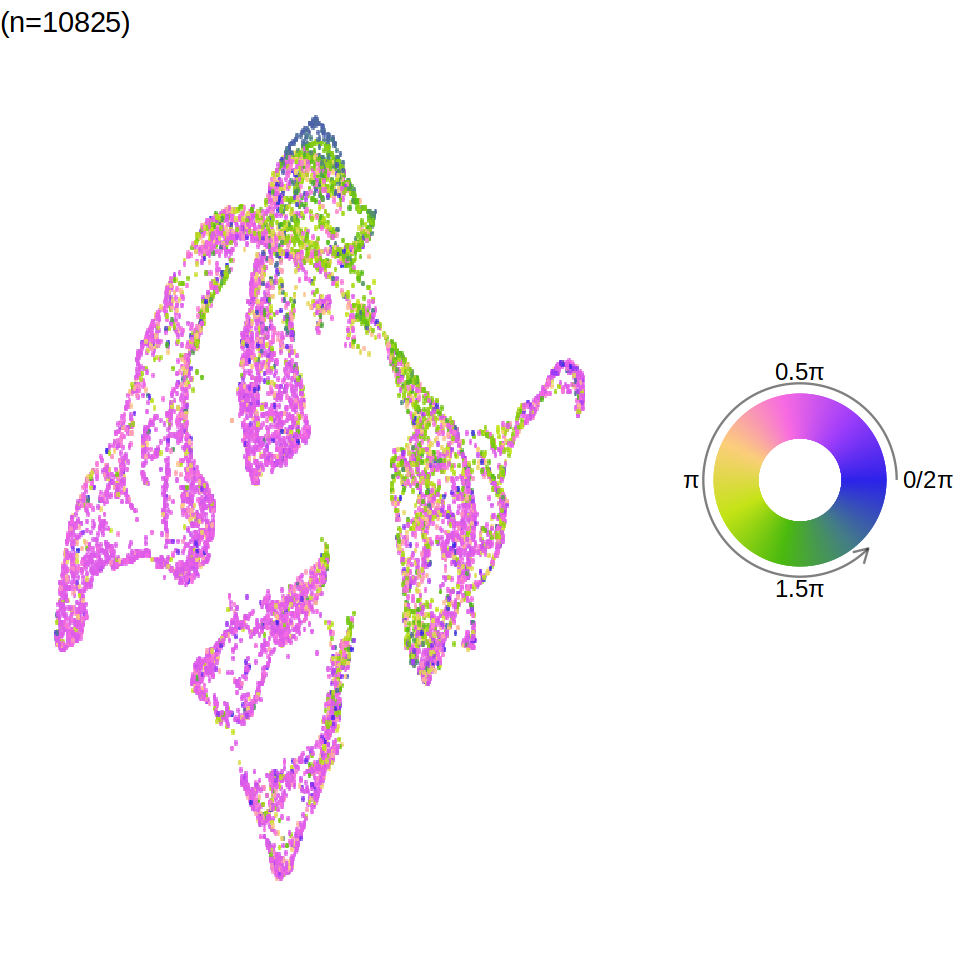

In [95]:
for (i in 1:length(sample.list)){
 run_tricycle(sample.list[i])
}

## Permanent recipe for tricycle inference:

In [21]:
    seu <- readRDS(paste0("./scRNA-seq/Seurat_Objects/","dc1","_COPILOT.rds"))

In [22]:
    sce <- as.SingleCellExperiment(seu)
    
    ## Tricycle estimation
    sce <- project_cycle_space(sce,ref.m = new.ref)
    sce <- estimate_cycle_position(sce)

The number of projection genes found in the new data is 245.



Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


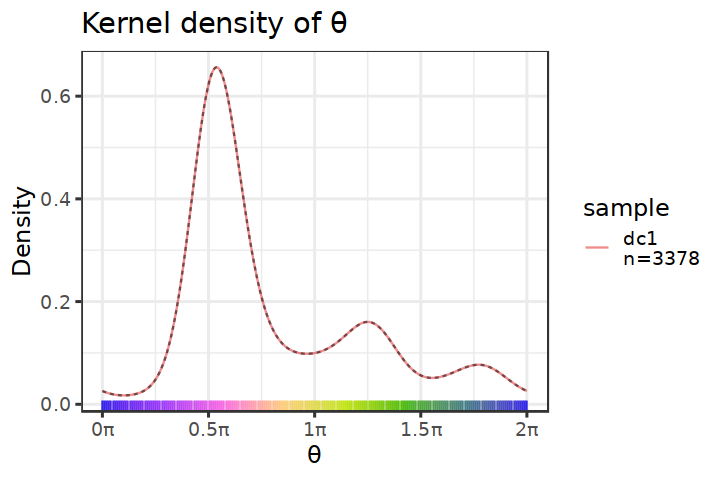

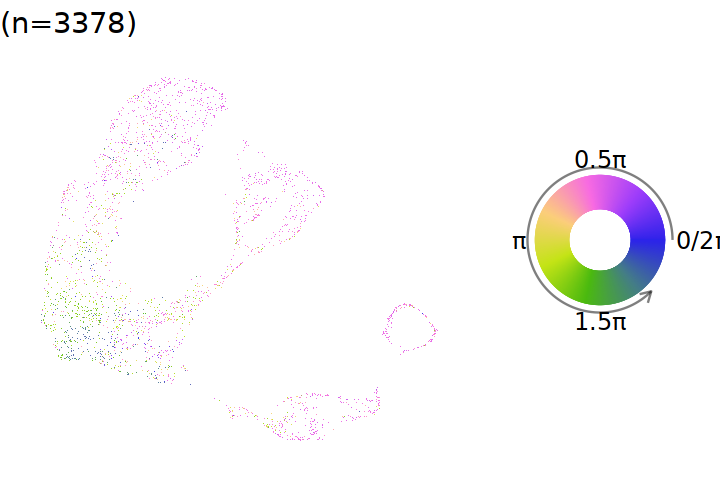

In [23]:
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage
    
    ## Tricycle position on umap
    p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                           point.size = 1, point.alpha = 0.9) +
      theme_void(base_size = 14)
    legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
    print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

In [24]:

run_tricycle <- function(sample){
    seu <- readRDS(paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT.rds"))
    sce <- as.SingleCellExperiment(seu)
    
    ## Tricycle estimation
    sce <- project_cycle_space(sce,ref.m = new.ref)
    sce <- estimate_cycle_position(sce)
    
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage
    
    ## Tricycle position on umap
    p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                           point.size = 1, point.alpha = 0.9) +
      theme_void(base_size = 14)
    legend <- circle_scale_legend(text.size = 5, alpha = 0.9)
    print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))
    
    ## Write annotations as csv
    write.csv(seu@meta.data[,c("tricyclePosition", "tricycleCCStage")], paste0("./tricycle/",sample,".csv"), quote=FALSE)
    #saveRDS(seu,paste0("./scRNA-seq/Seurat_Objects/",sample,"_COPILOT_seu4.rds"))
}

## Protophloem SMART-seq data

In [25]:
mtx <- read.table('./scRNA-seq/Published_Data/GSE140778_20190115_data.txt')

In [26]:
meta <- read.csv('./scRNA-seq/Published_Data/GSE140778_20190115_meta_data.csv')

In [27]:
sum(!is.na(meta$Cluster_PSE))

[1] 758

In [28]:
head(mtx)

,SLX_12100_i701_i502,SLX_12100_i701_i503,SLX_12100_i701_i504,SLX_12100_i701_i505,SLX_12100_i701_i506,SLX_12100_i701_i507,SLX_12100_i701_i508,SLX_12100_i701_i517,SLX_12100_i702_i502,SLX_12100_i702_i503,...,SLX_17313_i728_i521,SLX_17313_i728_i522,SLX_17313_i729_i513,SLX_17313_i729_i515,SLX_17313_i729_i516,SLX_17313_i729_i517,SLX_17313_i729_i518,SLX_17313_i729_i520,SLX_17313_i729_i521,SLX_17313_i729_i522
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AT1G01010,138.832,0.000,0,1.37359,0.665616,23.122100,0.0000,0,0.00000,153.1940,...,45.11770,0.00000,0,13.7543,58.2903,0.00,0.00000,0,0.0000,0
AT1G01020,277.664,146.593,0,33.42390,0.000000,0.000000,39.6054,0,0.00000,105.3210,...,8.01155,0.00000,0,0.0000,0.0000,0.00,0.00000,0,0.0000,0
AT1G01030,0.000,0.000,0,0.00000,7.321770,0.000000,0.0000,0,0.00000,0.0000,...,0.00000,0.00000,0,0.0000,0.0000,0.00,0.00000,0,0.0000,0
AT1G01040,0.000,0.000,0,0.00000,0.332834,0.379051,22.9967,0,0.00000,4.7873,...,0.00000,2.43814,0,0.0000,26.1001,0.00,0.00000,0,0.0000,0
AT1G01046,0.000,0.000,0,0.00000,0.000000,0.000000,0.0000,0,0.00000,0.0000,...,0.00000,0.00000,0,0.0000,0.0000,0.00,0.00000,0,0.0000,0
AT1G01050,138.832,146.593,0,72.80000,105.167000,137.974000,136.7020,0,1.94657,4.7873,...,6.32491,104.80900,0,103.1570,29.5801,329.67,6.51429,0,10.5481,0


In [29]:
rownames(meta) <- meta$ID

In [30]:
seu <- CreateSeuratObject(mtx, meta.data=meta)

In [31]:
seu

An object of class Seurat 
32824 features across 1375 samples within 1 assay 
Active assay: RNA (32824 features, 0 variable features)

In [32]:
head(seu@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,ID,sample,reads_total,reads_unmapped,reads_unique,reads_multi,percent_unique,percent_multi,percent_mapped,lib_size_avr,Cluster_all_cells,Cluster_PSE,Pseudotime_PSE
,<fct>,<dbl>,<int>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>
SLX_12100_i701_i502,SLX,734281.9,2860,SLX_12100_i701_i502,P1,847809,803895,38147,5767,4.499480,0.6802240,5.179704,678,NA,NA,NA
SLX_12100_i701_i503,SLX,913422.6,3518,SLX_12100_i701_i503,P1,1431659,1399319,27698,4642,1.934679,0.3242392,2.258918,678,NA,NA,NA
SLX_12100_i701_i504,SLX,827476.9,2904,SLX_12100_i701_i504,P1,313281,300049,9440,3792,3.013269,1.2104149,4.223684,678,NA,NA,NA
SLX_12100_i701_i505,SLX,600775.5,10725,SLX_12100_i701_i505,P1,3328241,992332,1515355,820554,45.530206,24.6542844,70.184491,678,10,4,1.3333992
SLX_12100_i701_i506,SLX,922948.5,11363,SLX_12100_i701_i506,P1,7051643,1901022,3201903,1948718,45.406482,27.6349498,73.041432,678,14,4,0.8876946
SLX_12100_i701_i507,SLX,894200.0,10634,SLX_12100_i701_i507,P1,6906310,1881499,2873579,2151232,41.608022,31.1487900,72.756812,678,7,NA,NA


In [33]:
seu <- NormalizeData(seu)
seu <- FindVariableFeatures(seu, selection.method = "vst", nfeatures = nrow(seu))
all.genes <- rownames(seu)
seu <- ScaleData(seu, features = all.genes)
seu <- RunPCA(seu,features = VariableFeatures(object = seu))

Centering and scaling data matrix

PC_ 1 
Positive:  AT5G03240, AT3G53990, AT4G05320, AT1G70670, AT4G05050, AT1G75280, AT4G39090, AT3G22400, AT4G21980, AT1G29520 
	   AT3G03200, AT1G77700, AT5G48060, AT1G54400, AT3G06420, AT3G58720, AT4G33490, AT2G46630, AT1G29380, AT1G08160 
	   AT1G79480, AT5G07220, AT5G49320, AT5G18970, AT5G03510, AT2G41200, AT2G42820, AT1G76970, AT1G63310, AT1G61760 
Negative:  AT3G04400, AT3G24830, AT3G25520, AT5G20290, AT5G02960, AT1G08360, AT5G16130, AT1G18540, AT3G02080, AT3G49910 
	   AT4G27090, AT2G34480, AT5G15200, AT2G47610, AT5G10360, AT4G00100, AT4G34670, AT5G23740, AT2G39460, AT3G04920 
	   AT3G53020, AT1G69620, AT2G18020, AT2G27530, AT1G67430, AT3G14600, AT3G11940, AT3G09200, AT2G19730, AT4G18100 
PC_ 2 
Positive:  AT5G42050, AT1G20450, AT1G19180, AT1G20440, AT2G47730, AT1G78380, AT4G30960, AT3G10985, AT5G10830, AT5G11670 
	   AT5G45110, AT1G78660, AT5G63790, AT1G04250, AT2G29440, AT5G08790, AT4G16380, AT4G34150, AT5G64260, AT5G19110 
	   AT2G24850, AT4

In [34]:
seu <- FindNeighbors(seu, dims = 1:10)
seu <- FindClusters(seu, resolution = 0.5)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1375
Number of edges: 33789

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9051
Number of communities: 12
Elapsed time: 0 seconds


In [35]:
seu <- RunUMAP(seu, dims = 1:10)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
10:49:41 UMAP embedding parameters a = 0.9922 b = 1.112

10:49:41 Read 1375 rows and found 10 numeric columns

10:49:41 Using Annoy for neighbor search, n_neighbors = 30

10:49:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:49:41 Writing NN index file to temp file /tmp/RtmpSzDebc/file16ca8b2394d636

10:49:41 Searching Annoy index using 1 thread, search_k = 3000

10:49:42 Annoy recall = 100%

10:49:43 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors

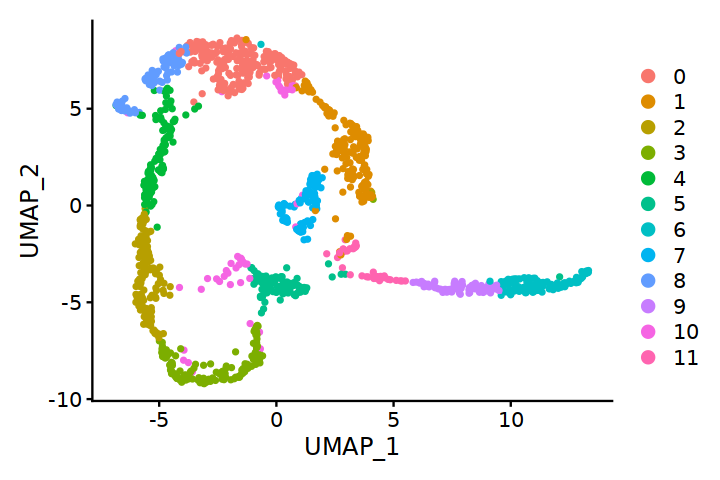

In [36]:
# note that you can set `label = TRUE` or use the LabelClusters function to help label
# individual clusters
DimPlot(seu, reduction = "umap")

In [37]:
head(seu@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,ID,sample,reads_total,reads_unmapped,reads_unique,reads_multi,percent_unique,percent_multi,percent_mapped,lib_size_avr,Cluster_all_cells,Cluster_PSE,Pseudotime_PSE,RNA_snn_res.0.5,seurat_clusters
,<fct>,<dbl>,<int>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<fct>,<fct>
SLX_12100_i701_i502,SLX,734281.9,2860,SLX_12100_i701_i502,P1,847809,803895,38147,5767,4.499480,0.6802240,5.179704,678,NA,NA,NA,10,10
SLX_12100_i701_i503,SLX,913422.6,3518,SLX_12100_i701_i503,P1,1431659,1399319,27698,4642,1.934679,0.3242392,2.258918,678,NA,NA,NA,4,4
SLX_12100_i701_i504,SLX,827476.9,2904,SLX_12100_i701_i504,P1,313281,300049,9440,3792,3.013269,1.2104149,4.223684,678,NA,NA,NA,0,0
SLX_12100_i701_i505,SLX,600775.5,10725,SLX_12100_i701_i505,P1,3328241,992332,1515355,820554,45.530206,24.6542844,70.184491,678,10,4,1.3333992,0,0
SLX_12100_i701_i506,SLX,922948.5,11363,SLX_12100_i701_i506,P1,7051643,1901022,3201903,1948718,45.406482,27.6349498,73.041432,678,14,4,0.8876946,8,8
SLX_12100_i701_i507,SLX,894200.0,10634,SLX_12100_i701_i507,P1,6906310,1881499,2873579,2151232,41.608022,31.1487900,72.756812,678,7,NA,NA,7,7


In [38]:
seu

An object of class Seurat 
32824 features across 1375 samples within 1 assay 
Active assay: RNA (32824 features, 27218 variable features)
 2 dimensional reductions calculated: pca, umap

In [39]:
#seu[["umap"]]@cell.embeddings[,1] <- seu[["umap"]]@cell.embeddings[,1]*-1
seu[["umap"]]@cell.embeddings[,2] <- seu[["umap"]]@cell.embeddings[,2]*-1
#u2 <- rc.integrated@reductions$umap@cell.embeddings[,1]
#u1 <- rc.integrated@reductions$umap@cell.embeddings[,2]
#rc.integrated@reductions$umap@cell.embeddings[,1] <- u1
#rc.integrated@reductions$umap@cell.embeddings[,2] <- u2

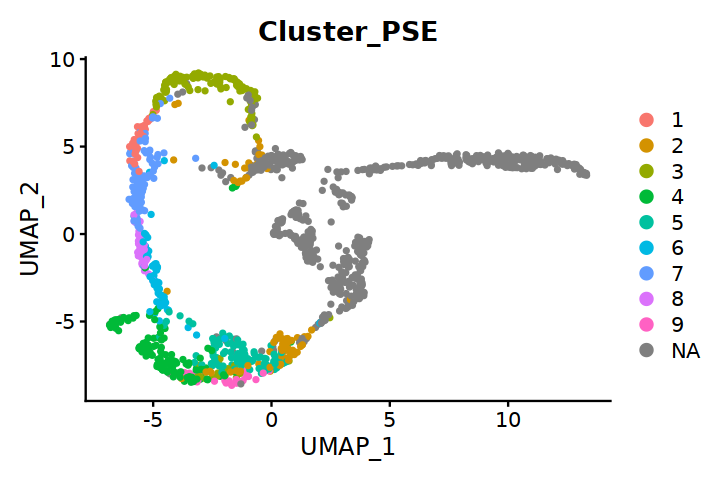

In [40]:
DimPlot(seu, reduction = "umap", group.by = "Cluster_PSE")

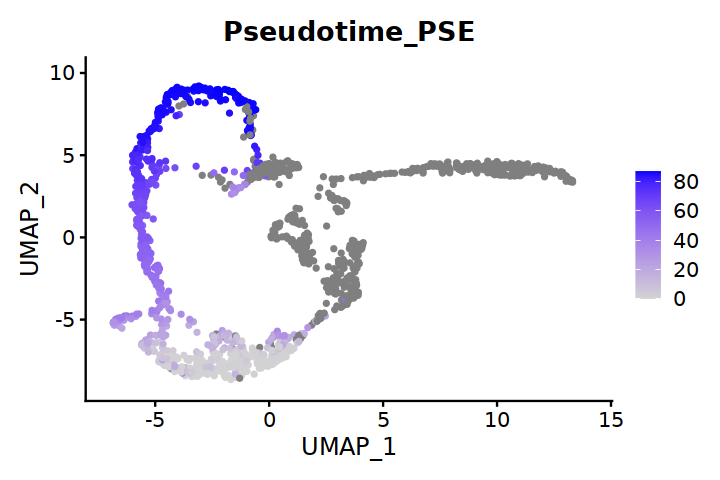

In [41]:
FeaturePlot(seu, reduction = "umap", features = "Pseudotime_PSE")

### tricycle reference

In [42]:
sce <- as.SingleCellExperiment(seu)

## Tricycle estimation
sce <- project_cycle_space(sce,ref.m = new.ref)
sce <- estimate_cycle_position(sce)

The number of projection genes found in the new data is 245.



Warning message in brewer.pal(nlevels(color_var.v), "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


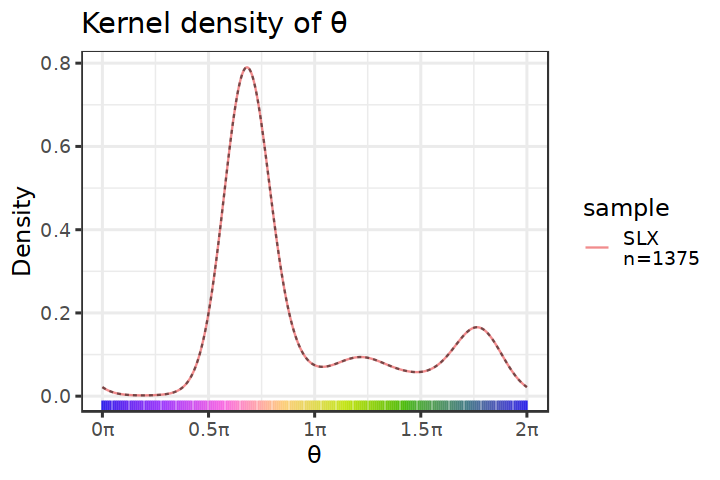

In [43]:
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage


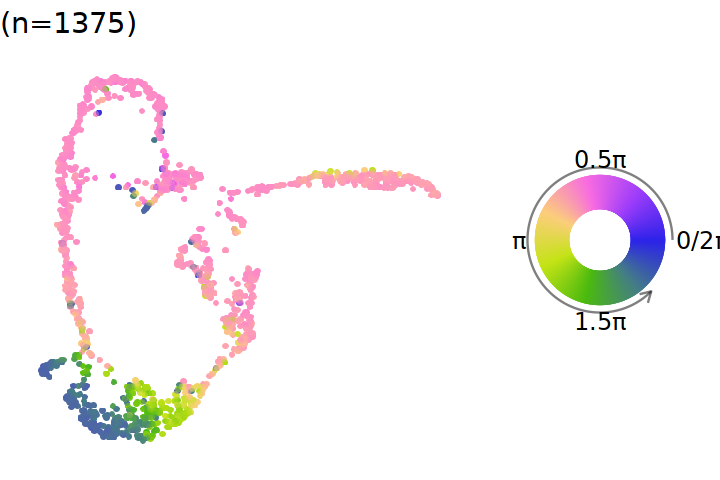

In [44]:
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 4, point.alpha = 1) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

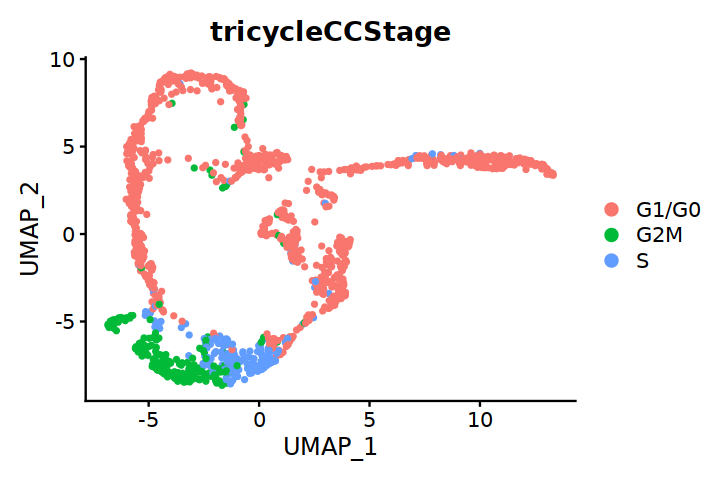

In [45]:
DimPlot(seu, reduction = "umap", group.by = "tricycleCCStage")

In [46]:
seu$Pseudotime_PSE

SLX_12100_i701_i502 SLX_12100_i701_i503 SLX_12100_i701_i504 SLX_12100_i701_i505 
                 NA                  NA                  NA          1.33339915 
SLX_12100_i701_i506 SLX_12100_i701_i507 SLX_12100_i701_i508 SLX_12100_i701_i517 
         0.88769461                  NA          1.16211669                  NA 
SLX_12100_i702_i502 SLX_12100_i702_i503 SLX_12100_i702_i504 SLX_12100_i702_i505 
                 NA                  NA          0.09233270                  NA 
SLX_12100_i702_i506 SLX_12100_i702_i507 SLX_12100_i702_i508 SLX_12100_i702_i517 
         0.58251736          2.33706074          0.85477163                  NA 
SLX_12100_i703_i502 SLX_12100_i703_i503 SLX_12100_i703_i504 SLX_12100_i703_i505 
                 NA                  NA                  NA         53.61314228 
SLX_12100_i703_i506 SLX_12100_i703_i507 SLX_12100_i703_i508 SLX_12100_i703_i517 
        54.52189408         85.19729857          1.21034307         14.52197083 
SLX_12100_i704_i502 SLX_12100_i704_i503 SLX_12100_i704_i504 SLX_12100_i704_i505 
        13.24045026          1.77884414         52.82139272          0.43780271 
SLX_12100_i704_i506 SLX_12100_i704_i507 SLX_12100_i704_i508 SLX_12100_i704_i517 
                 NA                  NA          9.61703756         52.82136960 
SLX_12100_i705_i502 SLX_12100_i705_i503 SLX_12100_i705_i504 SLX_12100_i705_i505 
        27.10965105         49.37018009          1.15367341         39.32187208 
SLX_12100_i705_i506 SLX_12100_i705_i507 SLX_12100_i705_i508 SLX_12100_i705_i517 
                 NA         40.04760222         26.91993546         49.93199810 
SLX_12100_i706_i502 SLX_12100_i706_i503 SLX_12100_i706_i504 SLX_12100_i706_i506 
        52.82134648         27.64106385          0.62609432                  NA 
SLX_12100_i706_i507 SLX_12100_i706_i508 SLX_12100_i706_i517 SLX_12100_i707_i502 
        53.11332564                  NA         49.68501244          6.76686925 
SLX_12100_i707_i503 SLX_12100_i707_i504 SLX_12100_i707_i505 SLX_12100_i707_i506 
                 NA                  NA                  NA                  NA 
SLX_12100_i707_i507 SLX_12100_i707_i508 SLX_12100_i707_i517 SLX_12100_i708_i502 
        20.40363867                  NA          1.53774030                  NA 
SLX_12100_i708_i504 SLX_12100_i708_i505 SLX_12100_i708_i506 SLX_12100_i708_i507 
                 NA         10.24219888         61.65428491          2.38856752 
SLX_12100_i708_i508 SLX_12100_i708_i517 SLX_12100_i709_i502 SLX_12100_i709_i503 
         1.11866837                  NA         84.87846819         49.39924658 
SLX_12100_i709_i504 SLX_12100_i709_i505 SLX_12100_i709_i506 SLX_12100_i709_i507 
         0.22760599         37.82399987          6.80767276          0.00000000 
SLX_12100_i709_i508 SLX_12100_i709_i517 SLX_12100_i710_i502 SLX_12100_i710_i503 
        84.58015502                  NA         76.92521644                  NA 
SLX_12100_i710_i504 SLX_12100_i710_i505 SLX_12100_i710_i506 SLX_12100_i710_i507 
                 NA         53.65480723         22.70207271          9.84681910 
SLX_12100_i710_i508 SLX_12100_i710_i517 SLX_12100_i711_i502 SLX_12100_i711_i503 
        51.33378868                  NA                  NA         28.69816309 
SLX_12100_i711_i504 SLX_12100_i711_i506 SLX_12100_i711_i507 SLX_12100_i711_i508 
                 NA          1.65640445                  NA                  NA 
SLX_12100_i711_i517 SLX_12100_i712_i502 SLX_12100_i712_i503 SLX_12100_i712_i504 
                 NA         59.22134752         52.81707104          1.01333827 
SLX_12100_i712_i505 SLX_12100_i712_i506 SLX_12100_i712_i507 SLX_12100_i712_i508 
         1.00095554          0.67329501         13.90172358          0.28143248 
SLX_14251_i701_i502 SLX_14251_i701_i503 SLX_14251_i701_i504 SLX_14251_i701_i505 
        25.50605057                  NA          1.28389794                  NA 
SLX_14251_i701_i506 SLX_14251_i701_i507 SLX_14251_i701_i508 SLX_14251_i701_i517 
         9.03412129            

In [47]:
seu$Pseudotime_PSE_rank <- rank(seu$Pseudotime_PSE)

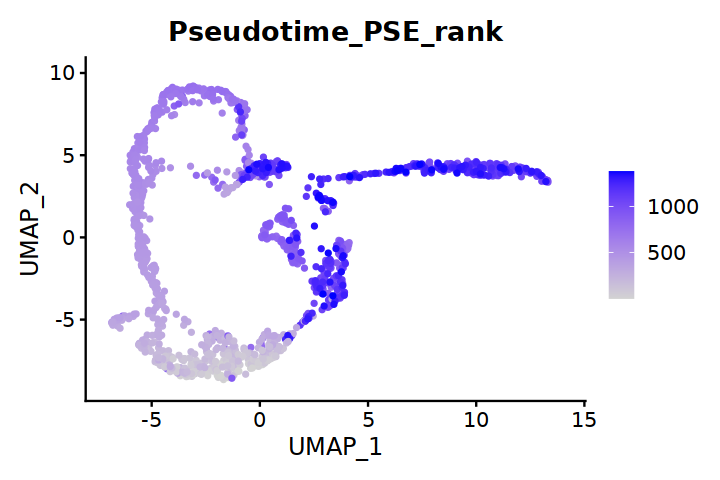

In [48]:
FeaturePlot(seu, reduction = "umap", features = "Pseudotime_PSE_rank")

In [49]:
saveRDS(seu,"./tricycle/seu_Phloem_1375_cells.rds")

In [50]:
seu_PSE <- subset(seu, cells=colnames(seu)[!is.na(seu$Cluster_PSE)])

In [51]:
seu_PSE

An object of class Seurat 
32824 features across 758 samples within 1 assay 
Active assay: RNA (32824 features, 27218 variable features)
 2 dimensional reductions calculated: pca, umap

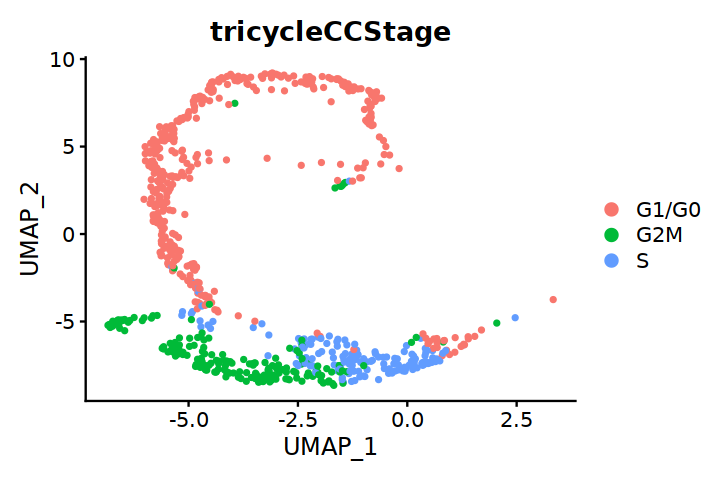

In [52]:
DimPlot(seu_PSE, reduction = "umap", group.by = "tricycleCCStage")

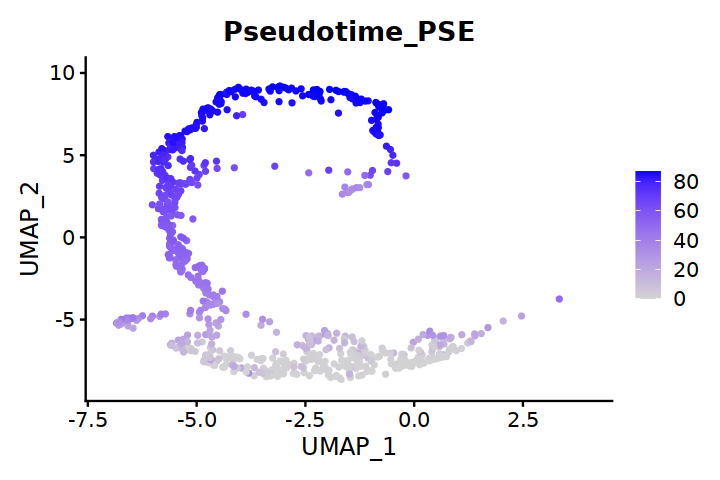

In [53]:
FeaturePlot(seu_PSE, reduction = "umap", features = "Pseudotime_PSE")

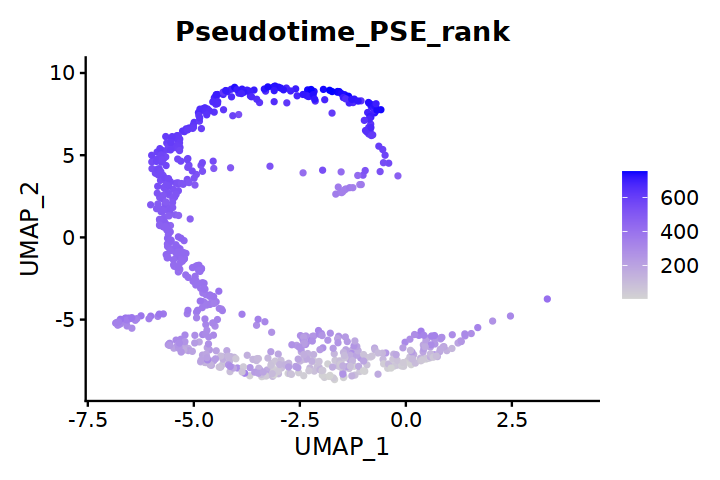

In [54]:
FeaturePlot(seu_PSE, reduction = "umap", features = "Pseudotime_PSE_rank")

In [55]:
saveRDS(seu_PSE,"./tricycle/seu_PSE_758_cells.rds")

In [56]:
## All cells (PSE, MSE, Procambium)
pltsg <- function(gene){
    keygene.idx <- which(rownames(seu@assays$RNA@data) == gene)
    fit.l <- fit_periodic_loess(seu$tricyclePosition*pi,
                            seu@assays$RNA@data[keygene.idx,],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = gene) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

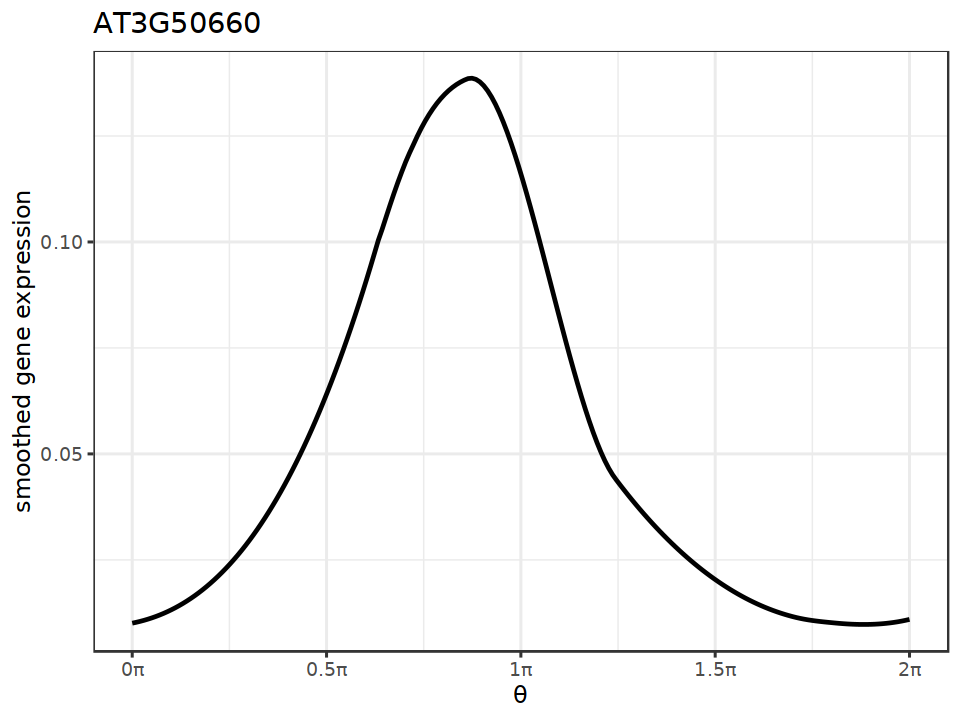

In [57]:
## DWF4
pltsg('AT3G50660')

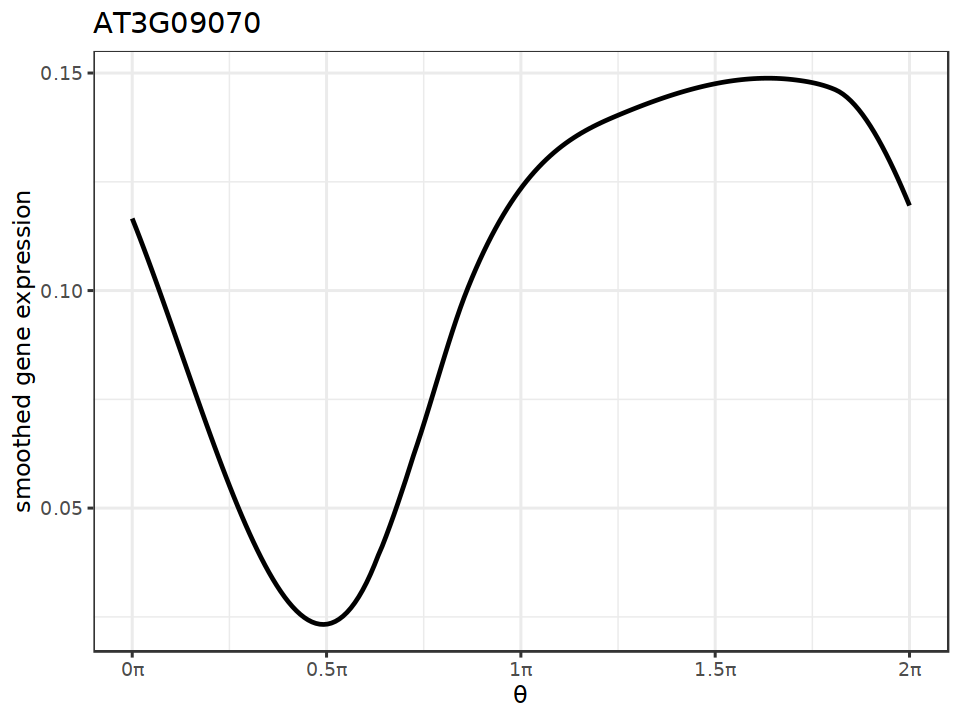

In [58]:
## OPS
pltsg('AT3G09070')

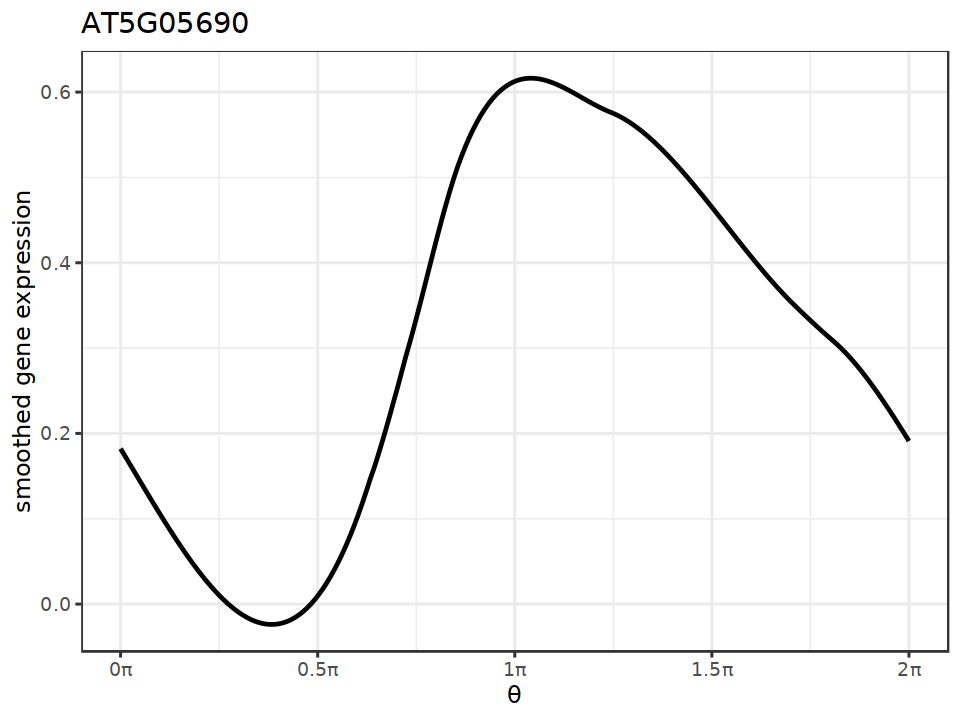

In [59]:
## CPD
pltsg('AT5G05690')

In [60]:
## Only PSE
pltsg <- function(gene){
    keygene.idx <- which(rownames(seu_PSE@assays$RNA@data) == gene)
    fit.l <- fit_periodic_loess(seu_PSE$tricyclePosition*pi,
                            seu_PSE@assays$RNA@data[keygene.idx,],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = gene) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

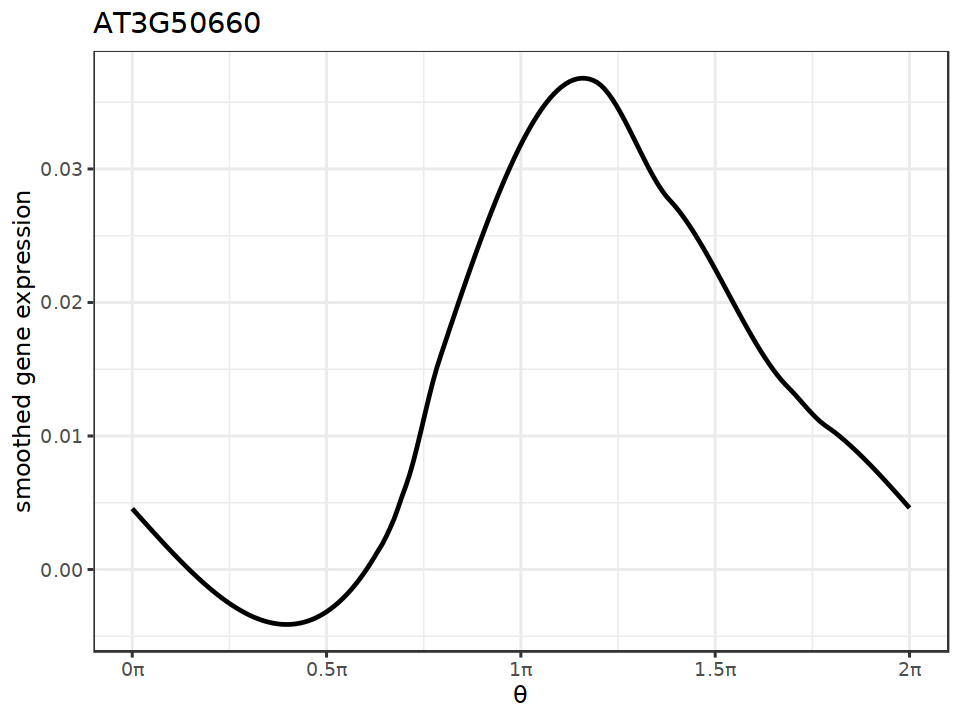

In [61]:
## DWF4
pltsg('AT3G50660')

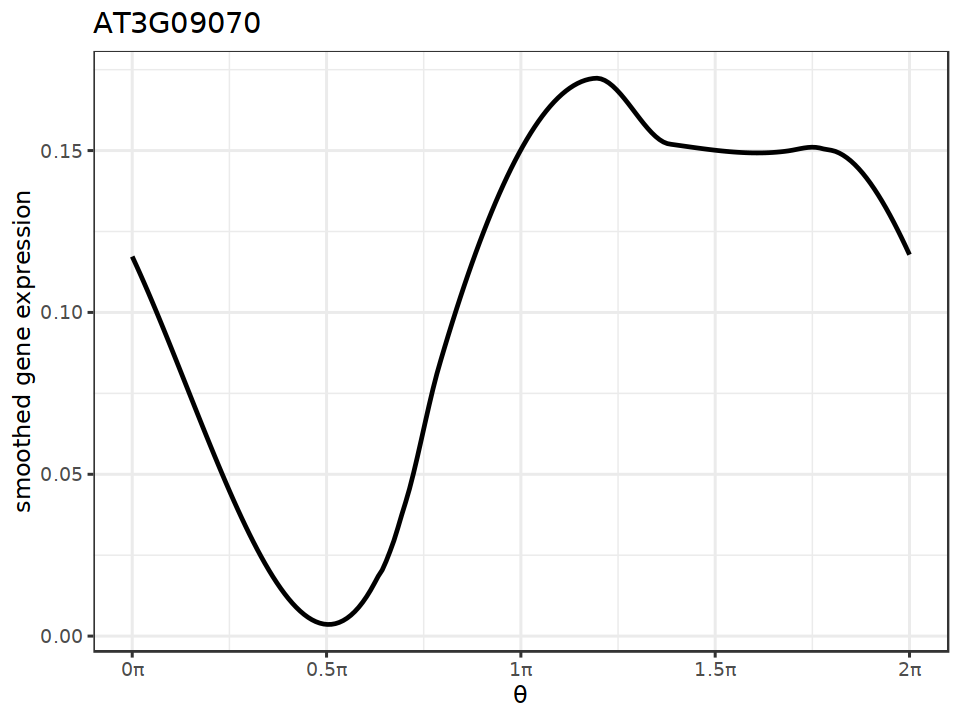

In [62]:
## OPS
pltsg('AT3G09070')

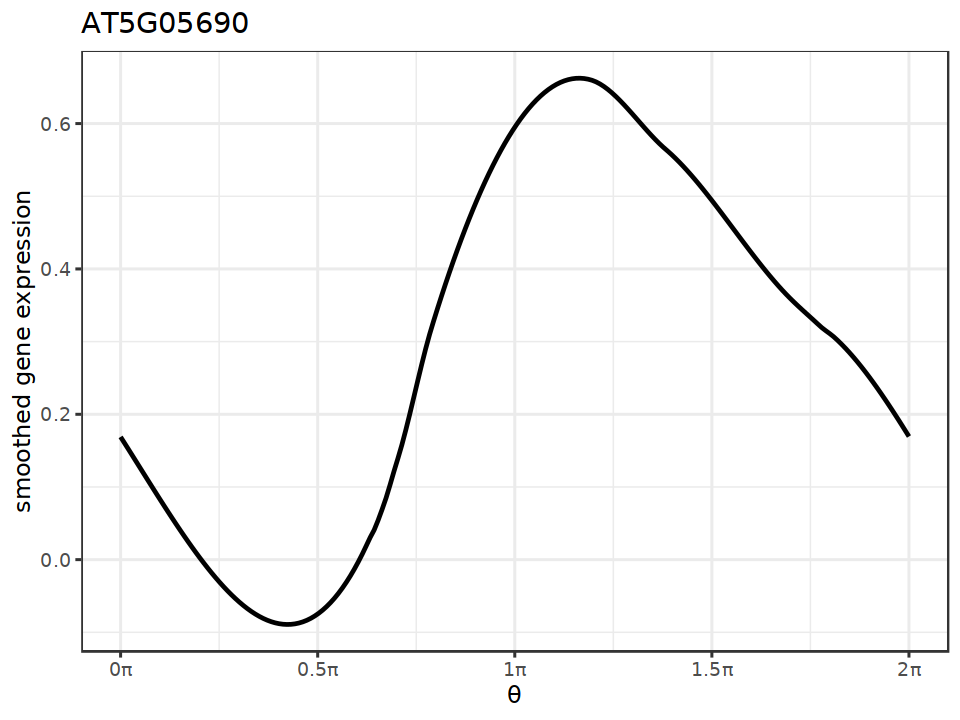

In [63]:
## CPD
pltsg('AT5G05690')

In [64]:
seu_mer_PSE <- subset(seu_PSE, cells=colnames(seu_PSE)[which(seu_PSE$Pseudotime_PSE_rank <= 410)])

In [65]:
seu_mer_PSE

An object of class Seurat 
32824 features across 410 samples within 1 assay 
Active assay: RNA (32824 features, 27218 variable features)
 2 dimensional reductions calculated: pca, umap

In [66]:
saveRDS(seu_mer_PSE,"./tricycle/seu_mer_PSE_410_cells.rds")

In [67]:
## Only meristem PSE
pltsg <- function(gene){
    keygene.idx <- which(rownames(seu_mer_PSE@assays$RNA@data) == gene)
    fit.l <- fit_periodic_loess(seu_mer_PSE$tricyclePosition*pi,
                            seu_mer_PSE@assays$RNA@data[keygene.idx,],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = gene) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

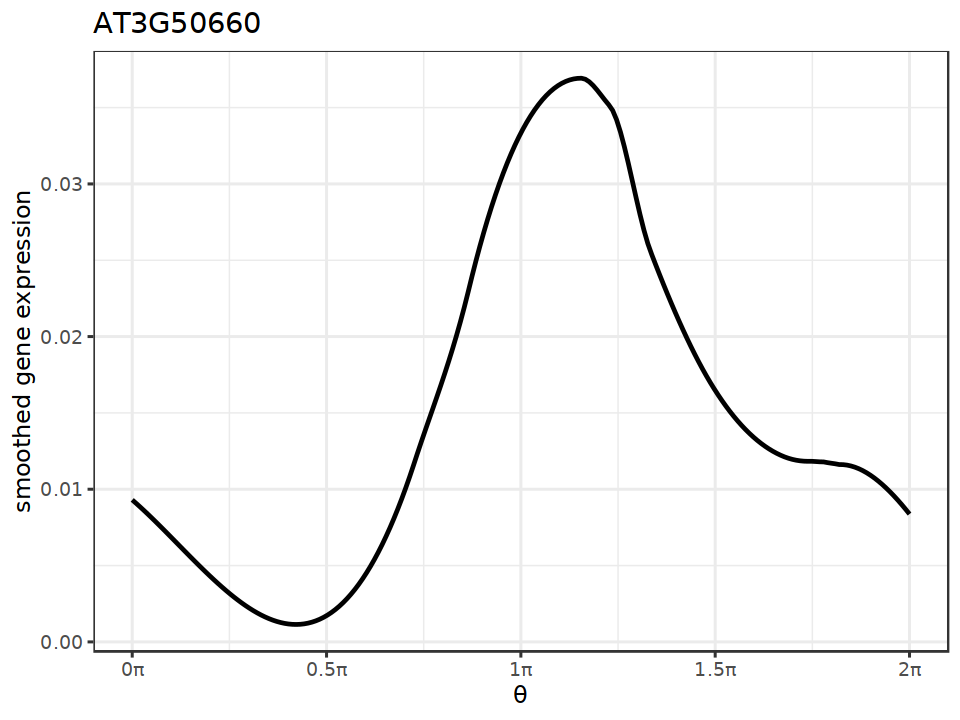

In [68]:
## DWF4
pltsg('AT3G50660')

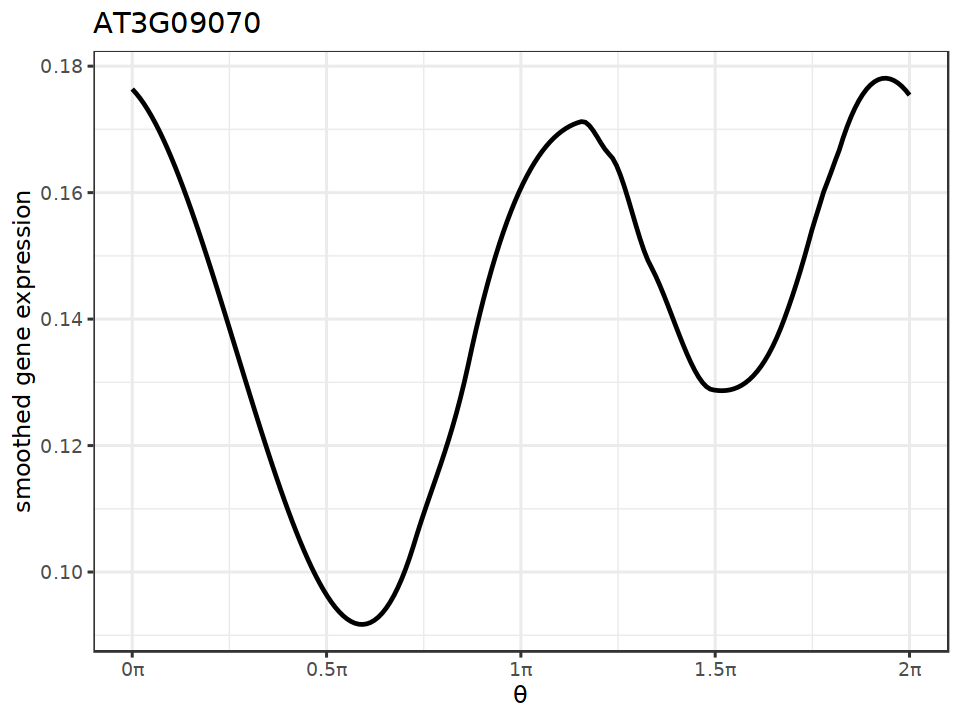

In [69]:
## OPS
pltsg('AT3G09070')

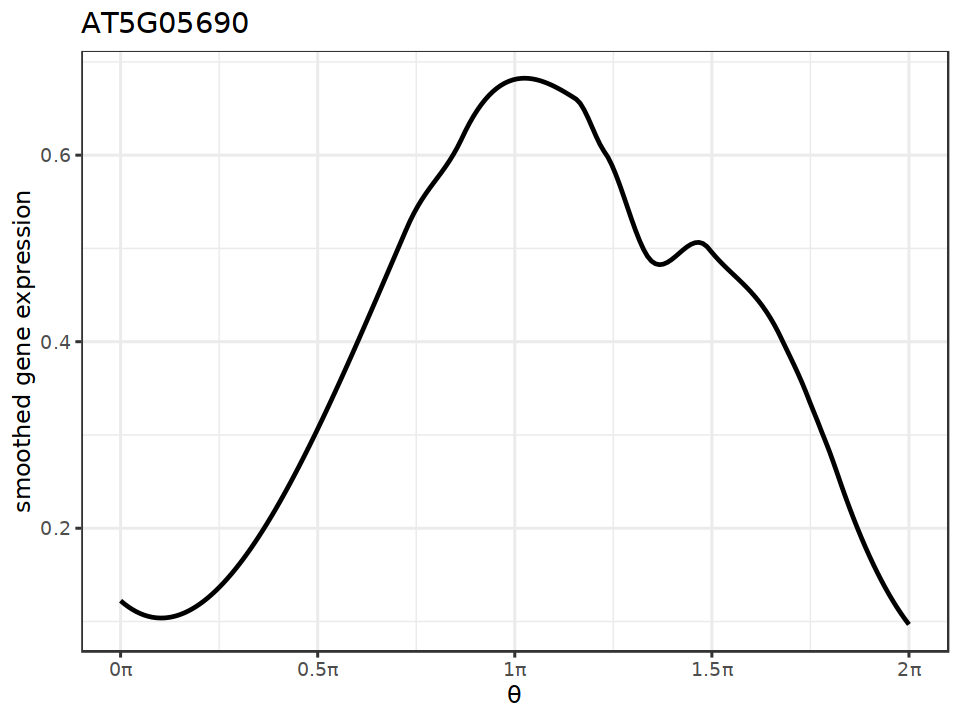

In [70]:
## CPD
pltsg('AT5G05690')

## Phloem Atlas (Nature Plants 2022, 10k cells)

In [71]:
sce <- readRDS("./scRNA-seq/Published_Data/phloem_atlas_sce.rds")

In [72]:
meta <- read.csv('./scRNA-seq/Published_Data/phloem_atlas_cell_metadata.csv')

In [73]:
head(meta)

,cell_id,sample,barcode,total_counts,detected_genes,cluster,annotation,UMAP1,UMAP2
,<chr>,<chr>,<chr>,<int>,<int>,<int>,<chr>,<dbl>,<dbl>
1,APL_AAACCCAAGTAACGTA-1,APL,AAACCCAAGTAACGTA-1,35600,5210,9,early/undetermined,2.2210797,-3.4197492
2,APL_AAACCCACAACCAACT-1,APL,AAACCCACAACCAACT-1,6616,3058,2,PSE,6.6928352,5.7139691
3,APL_AAACCCACAGTTGAAA-1,APL,AAACCCACAGTTGAAA-1,12781,3669,1,MSE,0.9346761,0.6447128
4,APL_AAACCCAGTGCCTTTC-1,APL,AAACCCAGTGCCTTTC-1,7138,3100,4,PPP,-5.9457399,1.5383996
5,APL_AAACCCAGTTTCGACA-1,APL,AAACCCAGTTTCGACA-1,7364,2529,6,PSE,5.8819741,8.5710071
6,APL_AAACCCATCTGCGAGC-1,APL,AAACCCATCTGCGAGC-1,7114,2869,3,CC,-0.7623315,-0.4224323


In [74]:
rownames(meta) <- meta$cell_id

In [75]:
nrow(meta)

[1] 10204

In [76]:
sce

class: SingleCellExperiment 
dim: 17396 10204 
metadata(4): nucgenes genevar hvgs hvgs_vst
assays(4): counts logcounts vst logvst
rownames(17396): AT1G01010 AT1G01020 ... AT5G67630 AT5G67640
rowData names(10): ID chrom ... go_mitosis go_phloem_dev
colnames(10204): APL_AAACCCAAGTAACGTA-1 APL_AAACCCACAACCAACT-1 ...
  sAPL_TTCGGTCAGCGACAGT-1 sAPL_TTTACCATCCTCTGCA-1
colData names(38): Sample Barcode ... slingPseudotime_4
  slingPseudotime_5
reducedDimNames(36): MNN_logcounts MNN_logvst ... DIFFMAP_MNN_logcounts
  DIFFMAP_MNN_logvst
mainExpName: NULL
altExpNames(0):

In [77]:
seu <- as.Seurat(sce)

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from MNN_logcounts_ to MNNlogcounts_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to MNNlogcounts_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from MNN_logvst_ to MNNlogvst_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to MNNlogvst_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to PC_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC to PC_”
Warning message:
“All keys should be one or more alphanumeric characters foll

In [78]:
seu

An object of class Seurat 
17396 features across 10204 samples within 1 assay 
Active assay: originalexp (17396 features, 0 variable features)
 36 dimensional reductions calculated: MNN_logcounts, MNN_logvst, PCA_logcounts, PCA_logvst, UMAP7_logcounts, UMAP7_logvst, UMAP7_MNN_logcounts, UMAP7_MNN_logvst, UMAP15_logcounts, UMAP15_logvst, UMAP15_MNN_logcounts, UMAP15_MNN_logvst, UMAP30_logcounts, UMAP30_logvst, UMAP30_MNN_logcounts, UMAP30_MNN_logvst, UMAP100_logcounts, UMAP100_logvst, UMAP100_MNN_logcounts, UMAP100_MNN_logvst, TSNE15_logcounts, TSNE15_logvst, TSNE15_MNN_logcounts, TSNE15_MNN_logvst, TSNE30_logcounts, TSNE30_logvst, TSNE30_MNN_logcounts, TSNE30_MNN_logvst, TSNE60_logcounts, TSNE60_logvst, TSNE60_MNN_logcounts, TSNE60_MNN_logvst, DIFFMAP_logcounts, DIFFMAP_logvst, DIFFMAP_MNN_logcounts, DIFFMAP_MNN_logvst

In [79]:
saveRDS(seu,"./tricycle/phloem_atlas_seu4.rds")

In [80]:
seu <- CreateSeuratObject(seu@assays$originalexp@counts, meta.data=meta)

In [81]:
seu <- NormalizeData(seu)
seu <- FindVariableFeatures(seu, selection.method = "vst", nfeatures = nrow(seu))
all.genes <- rownames(seu)
seu <- ScaleData(seu, features = all.genes)
seu <- RunPCA(seu,features = VariableFeatures(object = seu))

Centering and scaling data matrix

PC_ 1 
Positive:  AT5G16130, AT1G27400, AT2G37190, AT3G45030, AT5G27850, AT4G29410, AT2G34480, AT3G16080, AT3G62870, AT5G22440 
	   AT1G22780, AT2G44120, AT3G11940, AT5G15200, AT1G09690, AT3G61110, AT5G20290, AT4G36130, AT2G39460, AT2G01250 
	   AT3G22230, AT5G59850, AT3G07110, AT5G60670, AT5G48760, AT1G69620, AT5G52650, AT5G39740, AT1G09590, AT5G45775 
Negative:  AT1G76180, AT1G62480, AT5G65020, AT1G65930, AT2G02130, AT1G49240, AT5G56540, AT2G19760, AT3G21770, AT3G13520 
	   AT1G10682, AT2G45820, AT1G20440, AT3G14310, AT1G05850, AT3G53420, AT5G17920, AT3G05890, AT1G12080, AT2G44790 
	   AT2G30870, AT5G11970, AT3G23820, AT3G11930, AT3G56240, AT5G28050, AT1G35720, AT2G47730, AT1G55330, AT4G26320 
PC_ 2 
Positive:  AT1G29470, AT3G58120, AT5G23860, AT2G45070, AT1G23490, AT5G14030, AT2G27030, AT1G70490, AT2G47170, AT5G15350 
	   AT3G12610, AT5G48580, AT1G78040, AT1G04680, AT1G04820, AT3G03160, AT1G10630, AT2G27130, AT2G21160, AT3G43810 
	   AT1G50010, AT5

In [82]:
seu <- FindNeighbors(seu, dims = 1:10)
seu <- FindClusters(seu, resolution = 0.5)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10204
Number of edges: 303357

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9067
Number of communities: 14
Elapsed time: 1 seconds


In [83]:
seu <- RunUMAP(seu, dims = 1:10)

10:59:20 UMAP embedding parameters a = 0.9922 b = 1.112

10:59:21 Read 10204 rows and found 10 numeric columns

10:59:21 Using Annoy for neighbor search, n_neighbors = 30

10:59:21 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:59:22 Writing NN index file to temp file /tmp/RtmpSzDebc/file16ca8b2cbb33de

10:59:22 Searching Annoy index using 1 thread, search_k = 3000

10:59:25 Annoy recall = 100%

10:59:27 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

10:59:30 Initializing from normalized Laplacian + noise (using RSpectra)

10:59:30 Commencing optimization for 200 epochs, with 388778 positive edges

10:59:37 Optimization finished



In [84]:
head(seu@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,cell_id,sample,barcode,total_counts,detected_genes,cluster,annotation,UMAP1,UMAP2,RNA_snn_res.0.5,seurat_clusters
,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<chr>,<dbl>,<dbl>,<fct>,<fct>
APL_AAACCCAAGTAACGTA-1,APL,35383,5176,APL_AAACCCAAGTAACGTA-1,APL,AAACCCAAGTAACGTA-1,35600,5210,9,early/undetermined,2.2210797,-3.4197492,8,8
APL_AAACCCACAACCAACT-1,APL,6456,3020,APL_AAACCCACAACCAACT-1,APL,AAACCCACAACCAACT-1,6616,3058,2,PSE,6.6928352,5.7139691,9,9
APL_AAACCCACAGTTGAAA-1,APL,12731,3650,APL_AAACCCACAGTTGAAA-1,APL,AAACCCACAGTTGAAA-1,12781,3669,1,MSE,0.9346761,0.6447128,8,8
APL_AAACCCAGTGCCTTTC-1,APL,6954,3072,APL_AAACCCAGTGCCTTTC-1,APL,AAACCCAGTGCCTTTC-1,7138,3100,4,PPP,-5.9457399,1.5383996,4,4
APL_AAACCCAGTTTCGACA-1,APL,7276,2483,APL_AAACCCAGTTTCGACA-1,APL,AAACCCAGTTTCGACA-1,7364,2529,6,PSE,5.8819741,8.5710071,11,11
APL_AAACCCATCTGCGAGC-1,APL,7045,2849,APL_AAACCCATCTGCGAGC-1,APL,AAACCCATCTGCGAGC-1,7114,2869,3,CC,-0.7623315,-0.4224323,1,1


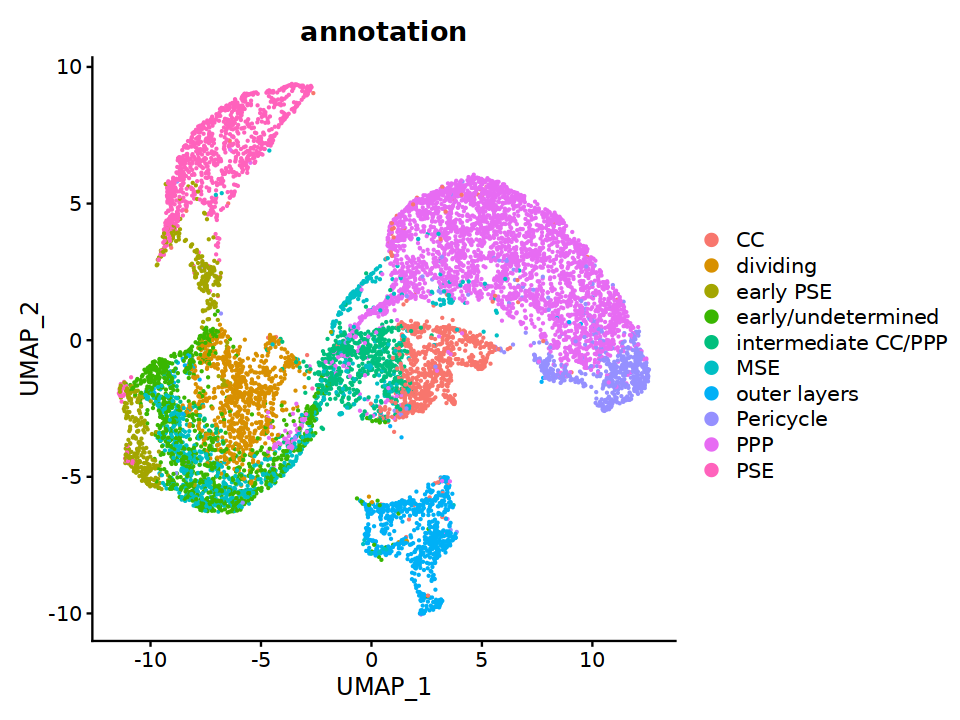

In [85]:
DimPlot(seu, reduction = "umap", group.by = "annotation")

In [86]:
sce <- as.SingleCellExperiment(seu)

## Tricycle estimation
sce <- project_cycle_space(sce,ref.m = new.ref)
sce <- estimate_cycle_position(sce)

The number of projection genes found in the new data is 242.



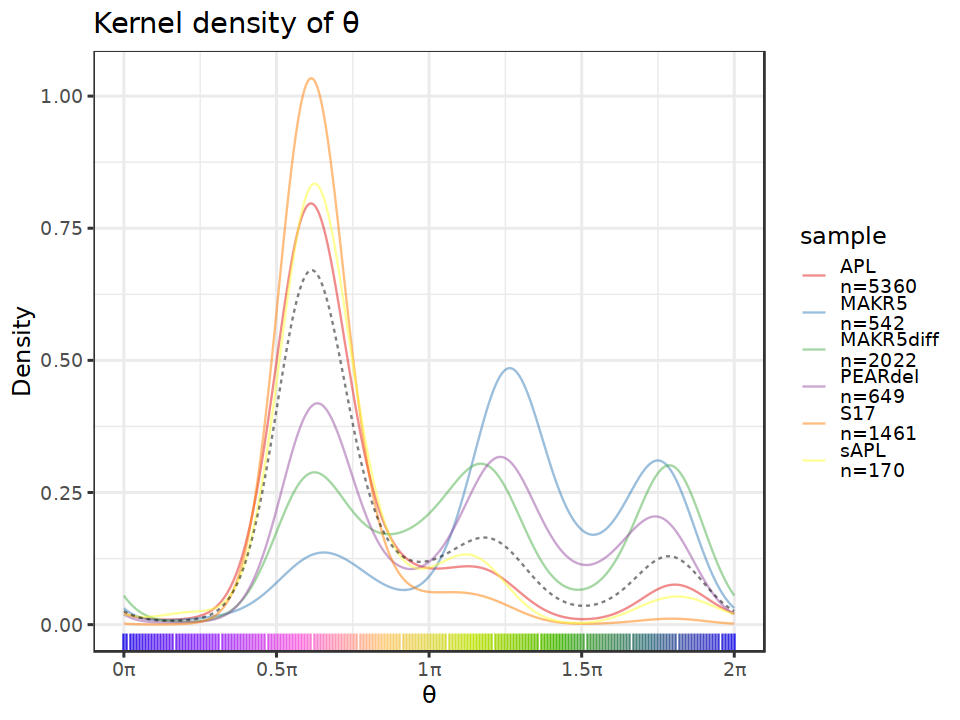

In [87]:
    sce$tricyclePosition <- (sce$tricyclePosition/pi) + 1.8
    sce$tricyclePosition[which(sce$tricyclePosition>=2)] <- sce$tricyclePosition[which(sce$tricyclePosition>=2)] - 2
    sce$tricyclePosition <- sce$tricyclePosition*pi
    
    ## Plot
    print(plot_ccposition_den(sce$tricyclePosition,
                    sce$orig.ident, 'sample',
                    bw = 10, fig.title = "Kernel density of \u03b8") +
      theme_bw(base_size = 14))
    
    ## Assign position to stage
    tricycleCCStage <- sce$tricyclePosition/pi

    G1_idx <- which(tricycleCCStage < 1 & tricycleCCStage >= 0)
    S_idx <- which(tricycleCCStage >= 1 & tricycleCCStage < 1.55)
    G2_idx <- which(tricycleCCStage >= 1.55 & tricycleCCStage <= 2)
                    
    tricycleCCStage[G1_idx]="G1/G0"
    tricycleCCStage[S_idx]="S"
    tricycleCCStage[G2_idx]="G2M"
    
    sce$tricycleCCStage <- tricycleCCStage
    
    ## Schwabe Stage
    #sce <- estimate_Schwabe_stage(sce,cycleGene.l = cc.gene.list)
    
    ## Table
    #seu$time.anno.Li <- gsub("_.*$","",seu$time.celltype.anno.Li)
    #print(table(seu$time.anno.Li, sce$tricycleCCStage))
    
    ## Prepare seu
    #seu <- prep(seu)
    #plot_anno(seu)
    
    ## Sce to seu
    seu$tricyclePosition <- sce$tricyclePosition/pi
    seu$tricycleCCStage <- sce$tricycleCCStage
    #seu$SchwabeCCStage <- sce$CCStage


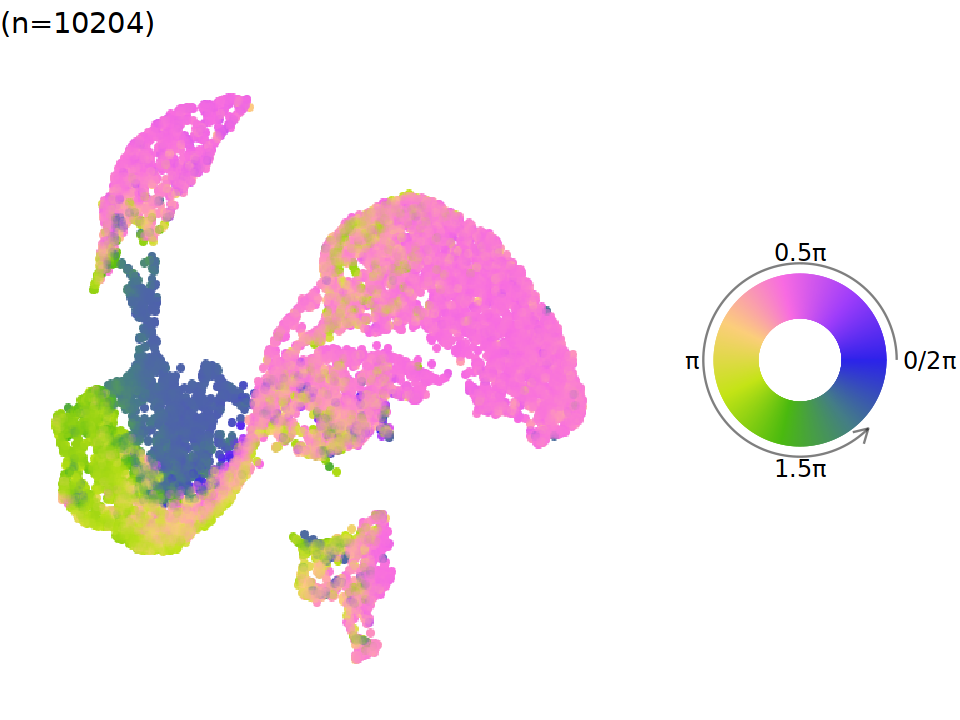

In [88]:
## Tricycle position on umap
p <- plot_emb_circle_scale(sce, dimred = "UMAP",
                       point.size = 4, point.alpha = 1) +
  theme_void(base_size = 14)
legend <- circle_scale_legend(text.size = 5, alpha = 1)
print(plot_grid(p, legend, ncol = 2, rel_widths = c(1, 0.5)))

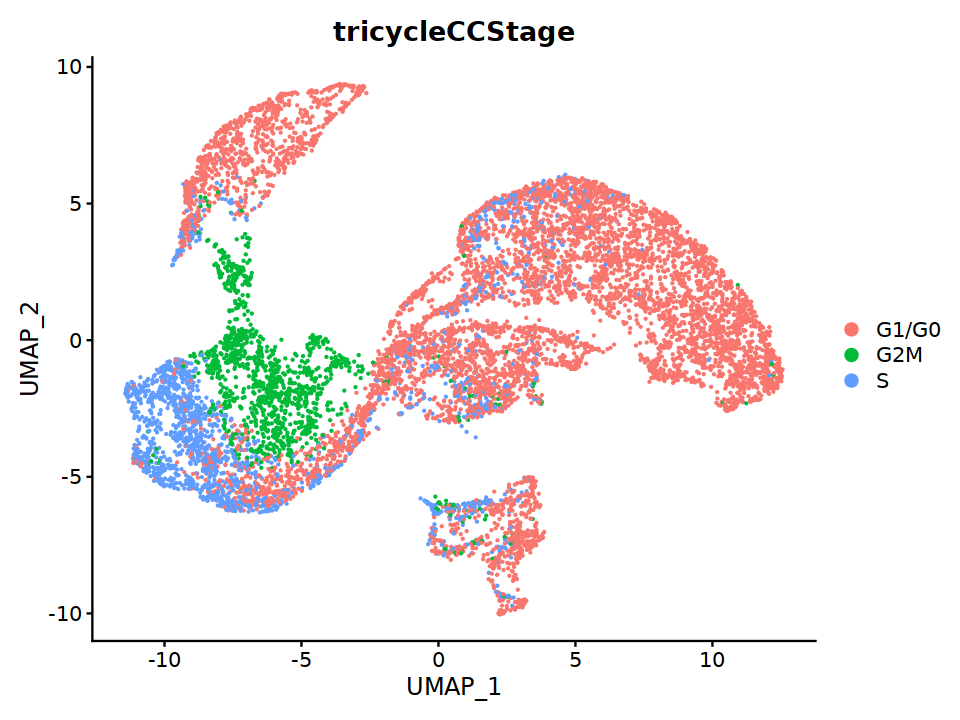

In [89]:
DimPlot(seu, reduction = "umap", group.by = "tricycleCCStage")

In [90]:
saveRDS(seu,"./tricycle/phloem_atlas_seu4_simplified.rds")

## DE analysis

In [ ]:
# Set the identity of interest to cell type
Idents(rc.integrated) <- "tricycleCCStage"
# Use SCT assay 
DefaultAssay(rc.integrated) <- "integrated"
de.list <- FindAllMarkers(rc.integrated,
                            max.cells.per.ident = 10000,
                            only.pos=T, 
                           test.use="wilcox")

Calculating cluster G2M



In [ ]:
de.list <- de.list %>% filter(p_val_adj < 0.01 & avg_log2FC > 0.25)

In [18]:
table(de.list$cluster)


  G2M G1/G0     S 
  133     9   103 

In [19]:
de.list %>% filter(cluster=="G1/G0")

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
AT5G02820,1.728994e-120,2.7087332,0.138,0.378,4.236034e-118,G1/G0,AT5G02820
AT1G04710,2.012929e-90,2.8375044,0.120,0.281,4.931675e-88,G1/G0,AT1G04710
AT2G03670,4.696481e-50,4.8883449,0.138,0.325,1.150638e-47,G1/G0,AT2G03670
AT3G13060,2.300513e-25,1.9837473,0.133,0.147,5.636256e-23,G1/G0,AT3G13060
AT2G42190,1.941702e-21,0.8564682,0.126,0.202,4.757170e-19,G1/G0,AT2G42190
AT4G14980,3.124803e-08,2.9606000,0.111,0.129,7.655767e-06,G1/G0,AT4G14980
AT1G05520,1.283976e-07,1.8709291,0.183,0.239,3.145741e-05,G1/G0,AT1G05520
AT1G128001,1.191791e-06,0.7292746,0.141,0.264,2.919888e-04,G1/G0,AT1G12800
AT5G63120,2.330971e-06,4.8604293,0.110,0.179,5.710880e-04,G1/G0,AT5G63120
